# ViEWS prediction competition LSTM notebook

## Author: Iris Malone

# Load Packages

In [24]:
import tensorflow as tf
from tensorflow.python.keras.layers import LSTM
from tensorflow.python.keras.layers import Input, Dense, Dropout, RepeatVector, TimeDistributed, Activation, Bidirectional
from tensorflow.python.keras.models import Sequential
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping

#plots
from plotnine import ggplot, aes
from plotnine import options
import plotnine as p9
from matplotlib import pyplot as plt

#random number generators since rnn is stochastic
from random import seed

In [25]:
import sys
import logging
import os
import pandas as pd
import numpy as np
import math
import csv
from datetime import datetime
from joblib import dump, load

# Import any other sklearn estimator you would like. 
# See https://scikit-learn.org/stable/user_guide.html#user-guide
#from sklearn.ensemble import RandomForestRegressor

from sklearn import metrics
from sklearn.preprocessing import MinMaxScaler

#import views package

import views
from views import Period, Model, Downsampling
from views.utils.data import assign_into_df
from views.apps.transforms import lib as translib
from views.apps.evaluation import lib as evallib, feature_importance as fi
from views.apps.model import api
from views.apps.extras import extras


In [26]:

logging.basicConfig(
    #level=logging.DEBUG,
    level=logging.INFO, # uncomment this and comment debug above for less yelling in red
    format=views.config.LOGFMT,
)

In [27]:
# Do you wish to fetch the latest public data? If so, change False to True and run this cell
# Cells below will fail if this is not run if you haven't imported data yourself yet.
if False:
    path_zip = views.apps.data.public.fetch_latest_zip_from_website(path_dir_destination=views.DIR_SCRATCH)
    views.apps.data.public.import_tables_and_geoms(tables=views.TABLES, geometries=views.GEOMETRIES, path_zip=path_zip)

In [28]:
# Enter the level of analysis, and whether to predict Africa-only.
level = "cm"
pred_africa = False

In [29]:
model_path = "./models/{sub}"
out_paths = {
    "evaluation": model_path.format(sub="evaluation"),
    "features": model_path.format(sub="features")
}
for k, v in out_paths.items():
    if not os.path.isdir(v):
        os.makedirs(v)

In [30]:
if level == "pgm":
    dataset = views.DATASETS["pgm_africa_imp_0"]
elif level == "cm":
    dataset = views.DATASETS["cm_global_imp_0"]
df = dataset.df

In [31]:
df.reset_index(inplace=True)

# Clean Data

In [32]:
df["time"] = df["month_id"]
df["gwno"] = df["country_id"]

df = df.dropna(subset=['country_id'], how='all')
df = df.set_index(["month_id", "country_id"]).sort_index()

In [33]:
df.head()

acled_count_ns  acled_count_os  acled_count_pr  \
month_id country_id                                                   
1        1                      0.0             0.0             0.0   
         2                      0.0             0.0             0.0   
         3                      0.0             0.0             0.0   
         4                      0.0             0.0             0.0   
         5                      0.0             0.0             0.0   

                     acled_count_sb  acled_dummy_ns  acled_dummy_os  \
month_id country_id                                                   
1        1                      0.0               0               0   
         2                      0.0               0               0   
         3                      0.0               0               0   
         4                      0.0               0               0   
         5                      0.0               0               0   

                     acled_dummy_pr  acled_dummy_sb  cdum_1  cdum_10  ...  \
month_id country_id                                                   ...   
1        1                        0               0       1        0  ...   
         2                        0               0       0        0  ...   
         3                        0               0       0        0  ...   
         4                        0               0       0        0  ...   
         5                        0               0       0        0  ...   

                     wdi_vc_idp_nwcv  wdi_vc_idp_nwds  wdi_vc_idp_tocv  \
month_id country_id                                                      
1        1              3.600000e+04            200.0          23000.0   
         2              2.667522e+05            300.0           2100.0   
         3              7.500000e+04             29.0         164000.0   
         4              1.672000e+06           4700.0         197000.0   
         5              1.500000e+02           5300.0           2100.0   

                     wdi_vc_ihr_psrc_fe_p5  wdi_vc_ihr_psrc_ma_p5  \
month_id country_id                                                 
1        1                             7.5                   30.3   
         2                             5.8                   11.9   
         3                             4.0                   36.6   
         4                             1.9                   22.9   
         5                             0.0                   10.0   

                     wdi_vc_ihr_psrc_p5  wdi_vc_pkp_totl_un  year  time  gwno  
month_id country_id                                                            
1        1                         12.1               141.0  1980     1     1  
         2                         14.4              9057.0  1980     1     2  
         3                          9.5               871.0  1980     1     3  
         4                         12.5              8536.0  1980     1     4  
         5                          8.7              1216.0  1980     1     5  

[5 rows x 3159 columns]

## Define Time Periods

In [34]:
# Define our 2017.01-2019.12 development period
# Keeping periods in a list lets us easily expand this as the 
# updated data becomes available
period_calib = {'train_start': 121,   # 1990-01
          'train_end': 408,     # 2016.12
          'predict_start': 409, # 2017.01
          'predict_end': 444}   # 2019.12

print(period_calib)


period_test = {'train_start': 121,   # 1990-01
          'train_end': 444,     # 2016.12
          'predict_start': 445, # 2017.01
          'predict_end': 480}   # 2019.12

print(period_test)

periods = [period_calib, period_test]


{'train_start': 121, 'train_end': 408, 'predict_start': 409, 'predict_end': 444}
{'train_start': 121, 'train_end': 444, 'predict_start': 445, 'predict_end': 480}


## Write Model Functions

In [35]:
scaler = MinMaxScaler()

#create training and test based on period predictions

def partition_dataset(dataset, period, look_back):
    #create delta/first diff
    from views.apps.transforms import lib as translib
    dataset['s_outcome'] = translib.delta(dataset['ln_ged_best_sb'], time=1)

    train_df = dataset[dataset['time'].between(period['train_start'] , period['train_end']-look_back, inclusive=True)].dropna()
    test_df = dataset[dataset['time'].between(period['predict_start'] - look_back, period['predict_end'], inclusive=True)].dropna()
    #print(train_df)
    #print(test_df) 
    #identify outcome of interest
    train_df = train_df[['s_outcome']]
    test_df = test_df[['s_outcome']]   
    
    return np.array(train_df), np.array(test_df)

def partition_delta(countryname, period, dataset, look_back):

    #s_actual = df.loc[:, self.model.col_outcome].copy()

    #if self.model.delta_outcome:
    #    s_actual = translib.delta(s_actual, time=step)
    
    dataset['s_outcome1'] = translib.delta(dataset['ln_ged_best_sb'], time=1)
    dataset['s_outcome2'] = translib.delta(dataset['ln_ged_best_sb'], time=2)
    dataset['s_outcome3'] = translib.delta(dataset['ln_ged_best_sb'], time=3)
    dataset['s_outcome4'] = translib.delta(dataset['ln_ged_best_sb'], time=4)
    dataset['s_outcome5'] = translib.delta(dataset['ln_ged_best_sb'], time=5)
    dataset['s_outcome6'] = translib.delta(dataset['ln_ged_best_sb'], time=6)
    dataset['s_outcome7'] = translib.delta(dataset['ln_ged_best_sb'], time=7)
    #translib.delta(dataset['ln_ged_best_sb'], time=1)
    
    train_df = dataset[dataset['time'].between(period['train_start'] , period['train_end']-look_back)].dropna()
    test_df = dataset[dataset['time'].between(period['predict_start'] - look_back , period['predict_end'])].dropna()
     
    #identify outcome of interest
    train_df = train_df[['s_outcome1', 's_outcome2', 's_outcome3', 's_outcome4', 's_outcome5', 's_outcome6', 's_outcome7']]
    test_df = test_df[['s_outcome1', 's_outcome2', 's_outcome3', 's_outcome4', 's_outcome5', 's_outcome6', 's_outcome7']]

    return train_df, test_df
    
     
# split a univariate sequence into samples
def create_dataset(dataset, look_back, look_forward):
    X, y = list(), list()
    for i in range(len(dataset)):
        # find the end of this pattern
        end_ix = i + look_back
        out_end_ix = end_ix + look_forward
        # check if we are beyond the sequence
        if out_end_ix > len(dataset):
            break
        # gather input and output parts of the pattern
        seq_x, seq_y = dataset[i:end_ix], dataset[end_ix:out_end_ix]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)
 

#VANILLA LSTM
def create_vanilla_model(X_train, y_train, epochs, num_neurons, batch_size, val_split):
    """BUILDING THE MODEL""" 
    print('Building vanilla Model...')
    # simple early stopping
    es = EarlyStopping(monitor='loss', mode='min', verbose=1)

    model = Sequential()

    #Input Layers
    model.add(LSTM(units = num_neurons, input_shape = (X_train.shape[1], 1), activation="tanh"))

    #model.add(LSTM(units = num_neurons, input_shape = (X_train.shape[1], 1), activation="tanh", stateful=True))
    #model.add(TimeDistributed(Dense(1)))

    # Dropout Regularization - randomly removes 20\%, helps with overfitting
    model.add(Dropout(0.2))
    #model.add(Dense(4)) 
    
    #Hidden Layers
    #
    model.add(Dense(num_neurons, activation="tanh")) # New hidden layer with 2 params, sigmoid function to constrainw weights
    #model.add(Dense(num_neurons, activation="tanh"))
    
    model.add(Dropout(0.2))
              
    # Output Layers
    model.add(Dense(units = y_train.shape[1]))

    #model.add(Activation('relu'))
    #model.add(Dropout(0.2))

    # Compiling the model
    model.compile(optimizer = 'adam', loss = 'mean_squared_error')

    #Summarize the model
    model.summary()

    # Fitting the model to the training set
    #model.fit(X_train, y_train, epochs = epochs, batch_size = batch_size, validation_split=val_split, callbacks=[es])
    #remove callback, train for more epochs (passes through the data)
    model.fit(X_train, y_train, epochs = epochs, batch_size = batch_size, validation_split=val_split)

    return model

#STATEFUL LSTM


def create_stateful_model(X_train, y_train, epochs, num_neurons, batch_size, val_split):
    """BUILDING THE MODEL""" 
    print('Building stateful model...')
    # simple early stopping
    #es = EarlyStopping(monitor='loss', mode='min', verbose=1)

    model = Sequential()

    #Input Layers
    model.add(LSTM(units = num_neurons, batch_input_shape = (batch_size, X_train.shape[1], 1), activation="tanh",  stateful=True))
    model.add(Dense(num_neurons, activation="tanh"))
    #model.add(LSTM(units = num_neurons, input_shape = (X_train.shape[1], 1), activation="tanh", stateful=True))
    #model.add(TimeDistributed(Dense(1)))

    # Dropout Regularization - randomly removes 20\%, helps with overfitting
    model.add(Dropout(0.2))
    #model.add(Dense(4)) 
    
    #Hidden Layers
    #
    model.add(Dense(num_neurons, activation="tanh")) # New hidden layer, tanh function to constrainw weights
    model.add(Dropout(0.2))
    model.add(Dense(num_neurons, activation="tanh"))
    #model.add(TimeDistributed(Dense(1, activation='sigmoid')))
    
    #model.add(Dropout(0.2))
              
    # Output Layers
    model.add(Dense(units = y_train.shape[1]))

    #model.add(Activation('relu'))
    #model.add(Dropout(0.2))

    # Compiling the model
    model.compile(optimizer = 'adam', loss = 'mean_squared_error')

    #Summarize the model
    model.summary()

    # Fitting the model to the training set
    model.fit(X_train, y_train, epochs = epochs, batch_size = batch_size, validation_split=val_split)
    #remove callback, train for more epochs (passes through the data)
    #model.fit(X_train, y_train, epochs = epochs, batch_size = batch_size, validation_split=val_split)

    return model

#BIDIRECTIONAL LSTM
def create_bidirectional_model(X_train, y_train, epochs, num_neurons, batch_size, val_split):
    """BUILDING THE MODEL""" 
    print('Building bidirectional model...')
    # simple early stopping
    es = EarlyStopping(monitor='loss', mode='min', verbose=1)

    model = Sequential()

    #Input Layers
    #model.add(LSTM(units = num_neurons, input_shape = (X_train.shape[1], 1), activation = 'tanh'))
    model.add(Bidirectional(LSTM(num_neurons, return_sequences=True), input_shape = (X_train.shape[1], 1)))
    model.add(TimeDistributed(Dense(1, activation='tanh')))

    # Compiling the model
    model.compile(optimizer = 'adam', loss = 'mean_squared_error')

    #Summarize the model
    model.summary()

    # Fitting the model to the training set
    model.fit(X_train, y_train, epochs = epochs, batch_size = batch_size, callbacks=[es])
    
    return model


def make_forecasts(model, period, batch_size, X_train, y_train, test_df, X_test, y_test, look_back, look_forward):
    """FORECASTING""" 
    print('Forecasting...')
    forecasts = []
    futures = []

    for i in range(0, len(X_test)):
        X = X_test[i, 0:look_back]
        y = y_test[i, look_back:]  

        # forecast steps       
        forecast = forecast_lstm(model, X, look_back, batch_size)
        #print(forecast)
        # store the forecast
        forecasts.append(forecast)
    
    print(forecast[-1:])
    currentStep = forecast[-1:]
    #Make one-step predictions for data beyond test_set
    for i in range(look_forward):
        if i == 0:
            X = X.reshape(1, look_back, 1)
            yhat = forecast_lstm(model, X, look_back, batch_size)
            #print(yhat)
        else:
            x0_input = np.append(X, [currentStep[i-1]])
            x0_input = x0_input.reshape((1, look_back+1, 1))
            x_input = x0_input[:,1:]
            yhat = forecast_lstm(model, x_input, look_back, batch_size)
            currentStep = np.append(currentStep, yhat)        
        #print(period['predict_end'] + i - look_forward + 1)
        futures.append(yhat)
    #print(futures)
        
    return forecasts, futures

def forecast_lstm(model, X, look_back, batch_size): 
    #make predictions
    X = X.reshape(1, look_back, 1)
    
    testPredict = model.predict(X, batch_size)
    # convert to array
    return [x for x in testPredict[0, :]]

def eval_model(countryname, model, X_train, y_train, X_test, y_test, futures, forecasts, look_back, look_forward):
    """EVALUATING THE MODEL"""
    print('Evaluating...')
    testScore_values = []
    testScore_valuespercountry = []
    for i in range(look_forward):
        #print(type(y_test))
        s_actual = [row[i] for row in y_test]
        #print(s_actual)
        s_prediction = [forecast[i] for forecast in forecasts]
        #print(type(forecasts))
        #print(s_prediction)
        scores = {}
        scores["Country"] = countryname.ravel().tolist()[0]
        scores["Step"] = 't+%d' % ((i))
        scores["mse"] = evallib.mean_squared_error(actuals=s_actual, preds=s_prediction)
        scores["mae"] = evallib.mean_absolute_error(actuals=s_actual, preds=s_prediction)
        scores["r2"] = evallib.r2_score(actuals=s_actual, preds=s_prediction)
        scores["tadda_score"] = evallib.tadda_score(y_deltas=np.array(s_actual), f_deltas=np.array(s_prediction), epsilon=0.048)
        #scores["Future Prediction"] = flat_future2[i]
        print(scores)
            # calculate root mean squared error for scaled data
        
        testScore_values.append(scores)
    testScore_valuespercountry.append(testScore_values)
    return testScore_valuespercountry


        
def plot_forecasts(period, test_df, y_test, forecasts, look_back, look_forward):
    print('Plotting forecasts...')
    """PLOTTING THE MODEL"""
    plt.plot(range(period['predict_start']- look_back, period['predict_start'] + len(test_df)- look_back), test_df, color='blue', label = 'Real Ln BD')
    # show the plot
    # plot the forecasts in red
    #print(test_df.shape)
    #print(len(forecasts))
    #print(len(tot))
    print(y_test.shape)
    for i in range(len(forecasts)):
        off_s = period['predict_start'] + i  
        off_e = off_s + len(forecasts[i]) 
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = forecasts[i:][0]
        #print(xaxis)
        #print(yaxis)
        plt.plot(xaxis, yaxis, color='red')
    plt.title('Change in Ln Battle-Death Prediction')
    plt.xlabel('Time')
    plt.ylabel('Change in Ln Battle-Death')
    plt.legend()
    plt.show()
    
def store_forecasts(period, countryname, y_test, futures, forecasts, look_back, look_forward):
    print('Storing forecasts...')
    """STORING MODEL RESULTS"""
    storage =[]
    storagepredictions = []
    storagepredictionspercountry = []
    for i in range(len(forecasts)):
        off_s = period['predict_start'] + i 
        off_e = off_s + len(forecasts[i]) 
        #print(off_s)      
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = forecasts[i:][0]

        storage = {}
        storage["Country"] = countryname.ravel().tolist()[0]
        storage["Month"] = off_s - 1
        storage["Future Months"] = xaxis
        storage["S=0"] = yaxis[0]
        storage["S=1"] = yaxis[1]
        storage["S=2"] = yaxis[2]
        storage["S=3"] = yaxis[3]
        storage["S=4"] = yaxis[4]
        storage["S=5"] = yaxis[5]
        storage["S=6"] = yaxis[6]
        storage["D=0"] = yaxis[0]
        storage["D=1"] = yaxis[0] + yaxis[1]
        storage["D=2"] = yaxis[0] + yaxis[1] + yaxis[2]
        storage["D=3"] = yaxis[0] + yaxis[1] + yaxis[2] + yaxis[3]
        storage["D=4"] = yaxis[0] + yaxis[1] + yaxis[2] + yaxis[3] + yaxis[4]
        storage["D=5"] = yaxis[0] + yaxis[1] + yaxis[2] + yaxis[3] + yaxis[4] + yaxis[5]
        storage["D=6"] = yaxis[0] + yaxis[1] + yaxis[2] + yaxis[3] + yaxis[4] + yaxis[5] + yaxis[6]
        storagepredictions.append(storage)
    #storagepredictionspercountry.append(storagepredictions)
    #print(storagepredictionspercountry)
    for i in range(len(futures)):
        off_s = period['predict_end'] + i - look_forward + 1   
        off_e = off_s + len(futures[i]) 
        #print(off_s)
        
        xaxis = [x for x in range(off_s +1, off_e)]
        yaxis = futures[i:][0]
        #print(countryname)
        #print(xaxis)
        #print(yaxis)
        storage = {}
        storage["Country"] = countryname.ravel().tolist()[0]
        storage["Month"] = off_s 
        storage["Future Month"] = xaxis
        storage["S=0"] = yaxis[0]
        storage["S=1"] = yaxis[1]
        storage["S=2"] = yaxis[2]
        storage["S=3"] = yaxis[3]
        storage["S=4"] = yaxis[4]
        storage["S=5"] = yaxis[5]
        storage["S=6"] = yaxis[6]
        storage["D=0"] = yaxis[0]
        storage["D=1"] = yaxis[0] + yaxis[1]
        storage["D=2"] = yaxis[0] + yaxis[1] + yaxis[2]
        storage["D=3"] = yaxis[0] + yaxis[1] + yaxis[2] + yaxis[3]
        storage["D=4"] = yaxis[0] + yaxis[1] + yaxis[2] + yaxis[3] + yaxis[4]
        storage["D=5"] = yaxis[0] + yaxis[1] + yaxis[2] + yaxis[3] + yaxis[4] + yaxis[5]
        storage["D=6"] = yaxis[0] + yaxis[1] + yaxis[2] + yaxis[3] + yaxis[4] + yaxis[5] + yaxis[6]
        #print(storage)
        storagepredictions.append(storage)
    storagepredictionspercountry.append(storagepredictions)
    #print(storagepredictionspercountry)
    return storagepredictionspercountry



def store_forecasts(period, countryname, gwno, train_step, test_step, y_test, futures, forecasts, look_back, look_forward):
    print('Storing forecasts...')
    """STORING MODEL RESULTS"""
    storage =[]
    storagepredictions = []
    storagepredictionspercountry = []
    for i in range(len(forecasts)):
        off_s = period['predict_start'] + i 
        off_e = off_s + len(forecasts[i]) 
        #print(off_s)      
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = forecasts[i:][0]

        storage = {}
        storage["Country"] = countryname.ravel().tolist()[0]
        storage["country_id"] = gwno.ravel().tolist()[0]
        storage["Last Month of Data"] = off_s 
        #storage["Future Month"] = xaxis
        storage["S=0"] = yaxis[0]
        storage["S=1"] = yaxis[1]
        storage["S=2"] = yaxis[2]
        storage["S=3"] = yaxis[3]
        storage["S=4"] = yaxis[4]
        storage["S=5"] = yaxis[5]
        storage["S=6"] = yaxis[6]
        storage["D=0"] = yaxis[0]
        storage["D=1"] = yaxis[0] + yaxis[1]
        storage["D=2"] = yaxis[0] + yaxis[1] + yaxis[2]
        storage["D=3"] = yaxis[0] + yaxis[1] + yaxis[2] + yaxis[3]
        storage["D=4"] = yaxis[0] + yaxis[1] + yaxis[2] + yaxis[3] + yaxis[4]
        storage["D=5"] = yaxis[0] + yaxis[1] + yaxis[2] + yaxis[3] + yaxis[4] + yaxis[5]
        storage["D=6"] = yaxis[0] + yaxis[1] + yaxis[2] + yaxis[3] + yaxis[4] + yaxis[5] + yaxis[6]
        storagepredictions.append(storage)
    #storagepredictionspercountry.append(storagepredictions)
    #print(storagepredictionspercountry)
    for i in range(1, len(futures)):
        off_s = period['predict_end'] + i - look_forward + 1   
        off_e = off_s + len(futures[i]) 
        #print(off_s)
        
        xaxis = [x for x in range(off_s +1, off_e)]
        yaxis = futures[i:][0]
        #print(countryname)
        #print(xaxis)
        #print(yaxis)
        storage = {}
        storage["Country"] = countryname.ravel().tolist()[0]
        storage["country_id"] = gwno.ravel().tolist()[0]
        storage["Last Month of Data"] = off_s 
        #storage["Future Month"] = xaxis
        storage["S=0"] = yaxis[0]
        storage["S=1"] = yaxis[1]
        storage["S=2"] = yaxis[2]
        storage["S=3"] = yaxis[3]
        storage["S=4"] = yaxis[4]
        storage["S=5"] = yaxis[5]
        storage["S=6"] = yaxis[6]
        storage["D=0"] = yaxis[0]
        storage["D=1"] = yaxis[0] + yaxis[1]
        storage["D=2"] = yaxis[0] + yaxis[1] + yaxis[2]
        storage["D=3"] = yaxis[0] + yaxis[1] + yaxis[2] + yaxis[3]
        storage["D=4"] = yaxis[0] + yaxis[1] + yaxis[2] + yaxis[3] + yaxis[4]
        storage["D=5"] = yaxis[0] + yaxis[1] + yaxis[2] + yaxis[3] + yaxis[4] + yaxis[5]
        storage["D=6"] = yaxis[0] + yaxis[1] + yaxis[2] + yaxis[3] + yaxis[4] + yaxis[5] + yaxis[6]
        #print(storage)
        storagepredictions.append(storage)

    storagepredictionspercountry.append(storagepredictions)
    #print(storagepredictionspercountry)
    return storagepredictionspercountry

def export_results(modelname, period, batch_size, epochs, num_neurons, look_back, look_forward, scoresglobal, storagepredictionsglobal, scoresdeltaglobal):
    print('Exporting results...')
    #Write Tables
    if period == period_calib:
        period_print = 'calibration'
    elif period == period_test:
        period_print = 'test'
    #Write .csv file with evaluation metrics, one per country-step
    flattenscores_list = [item for sublist in scoresglobal for item in sublist]
    
    flattenscores_list_final = [item for sublist in flattenscores_list for item in sublist]
    keys = flattenscores_list_final[0].keys()
    with open('country.csv', 'w') as output_file:
        dict_writer = csv.DictWriter(output_file, keys)
        dict_writer.writeheader()
        dict_writer.writerows(flattenscores_list_final)
    
    path_out = os.path.join(
        out_paths["evaluation"], 
        f"{modelname}_{period_print}_epochs{epochs}_batchsize{batch_size}_neurons{num_neurons}_lookback{look_back}_countryscores.csv"
        )
    with open(path_out, "w") as f:
        dict_writer = csv.DictWriter(f, keys)
        dict_writer.writeheader()
        dict_writer.writerows(flattenscores_list_final)
    print(f"Wrote country-level error tables to {path_out}.")
 
    #Write .csv file with evaluation metrics, one per country-step
    flattenscores_listdelta = [item for sublist in scoresdeltaglobal for item in sublist]
    
    flattenscores_list_final = [item for sublist in flattenscores_listdelta for item in sublist]
    keys = flattenscores_list_final[0].keys()
    with open('country.csv', 'w') as output_file:
        dict_writer = csv.DictWriter(output_file, keys)
        dict_writer.writeheader()
        dict_writer.writerows(flattenscores_list_final)
    
    path_out = os.path.join(
        out_paths["evaluation"], 
        f"{modelname}_{period_print}_epochs{epochs}_batchsize{batch_size}_neurons{num_neurons}_lookback{look_back}_countryscores_delta.csv"
        )
    with open(path_out, "w") as f:
        dict_writer = csv.DictWriter(f, keys)
        dict_writer.writeheader()
        dict_writer.writerows(flattenscores_list_final)
    print(f"Wrote country-level delta error tables to {path_out}.")
    
    #write country predictions
    flattenstorage_list = [item for sublist in storagepredictionsglobal for item in sublist]
    flattenstorage_list_final = [item for sublist in flattenstorage_list for item in sublist]
    keys = flattenstorage_list_final[0].keys()
    with open('country.csv', 'w') as output_file:
        dict_writer = csv.DictWriter(output_file, keys)
        dict_writer.writeheader()
        dict_writer.writerows(flattenstorage_list_final)
   
    path_out = os.path.join(
        out_paths["evaluation"], 
        f"predictions_{modelname}_{period_print}_epochs{epochs}_batchsize{batch_size}_neurons{num_neurons}_lookback{look_back}_countryscores.csv"
        )
    with open(path_out, "w") as f:
        dict_writer = csv.DictWriter(f, keys)
        dict_writer.writeheader()
        dict_writer.writerows(flattenstorage_list_final)
    print(f"Wrote country-level prediction tables to {path_out}.")

    #Write .tex file with evaluation metrics, averaged over countries    
    mselist = []
    mse2 = []
    scores2 = []
    sumscores = []
    scores = {
            "Step":[], 
            "MSE":[], 
            "MAE":[],
            "R2":[],
            "tadda_score":[]
        }
    
    for i in range(look_forward):
        evalmetrics = [a[i] for a in flattenscores_listdelta]
        mse = [d['mse'] for d in evalmetrics]
        mae = [d['mae'] for d in evalmetrics]
        r2 = [d['r2'] for d in evalmetrics]
        tadda = [d['tadda_score'] for d in evalmetrics]

        scores["Step"].append('t+%d' % ((i)))
        scores["MSE"].append(np.mean(mse))
        scores["MAE"].append(np.mean(mae))
        scores["R2"].append(np.mean(r2))
        scores["tadda_score"].append(np.mean(tadda))
        #print(scores)
        scores_summary = scores
        #print(scores2)
        
    out = pd.DataFrame([v for v in scores_summary.values()],
                    index = [k for k in scores_summary.keys()])
    #print(out)
    out_transpose = out.T
    tex = out_transpose.to_latex(index=False)
    
    now = datetime.now().strftime("%Y/%m/%d %H:%M:%S")
    meta = f"""
        %Output created by LSTM Multi-Step.ipynb.
        %Produced on {now}, written to {out_paths["evaluation"]}.
        \\
        """
    tex = meta + tex
    path_out = os.path.join(
        out_paths["evaluation"], 
        f"{modelname}_{period_print}_epochs{epochs}_batchsize{batch_size}_neurons{num_neurons}_lookback{look_back}_delta_scores.tex"
        )
    with open(path_out, "w") as f:
        f.write(tex)
    print(f"Wrote scores table to {path_out}.")
#Write .tex file with evaluation metrics, averaged over countries    
    mselist = []
    mse2 = []
    scores2 = []
    sumscores = []
    scores = {
            "Step":[], 
            "MSE":[], 
            "MAE":[],
            "R2":[],
            "tadda_score":[]
        }
    
    for i in range(look_forward):
        evalmetrics = [a[i] for a in flattenscores_list]
        mse = [d['mse'] for d in evalmetrics]
        mae = [d['mae'] for d in evalmetrics]
        r2 = [d['r2'] for d in evalmetrics]
        tadda = [d['tadda_score'] for d in evalmetrics]

        scores["Step"].append('t+%d' % ((i)))
        scores["MSE"].append(np.mean(mse))
        scores["MAE"].append(np.mean(mae))
        scores["R2"].append(np.mean(r2))
        scores["tadda_score"].append(np.mean(tadda))
        #print(scores)
        scores_summary = scores
        #print(scores2)
        
    out = pd.DataFrame([v for v in scores_summary.values()],
                    index = [k for k in scores_summary.keys()])
    #print(out)
    out_transpose = out.T
    tex = out_transpose.to_latex(index=False)
    
    now = datetime.now().strftime("%Y/%m/%d %H:%M:%S")
    meta = f"""
        %Output created by LSTM Multi-Step.ipynb.
        %Produced on {now}, written to {out_paths["evaluation"]}.
        \\
        """
    tex = meta + tex
    path_out = os.path.join(
        out_paths["evaluation"], 
        f"{modelname}_{period_print}_epochs{epochs}_batchsize{batch_size}_neurons{num_neurons}_lookback{look_back}_scores.tex"
        )
    with open(path_out, "w") as f:
        f.write(tex)
    print(f"Wrote scores table to {path_out}.")

def eval_delta_forecasts(period, countryname, gwno, train_step, test_step, y_test, futures, forecasts, look_back, look_forward):
    print('Evaluating delta multi-step forecasts...')
    storage_pred2 = []
    storage_actual2 = []
    testScore_values = []
    testScore_valuespercountry = []
    for i in range(len(forecasts)):
        
        yaxis = forecasts[i:][0]  
        storage_pred = (yaxis[0], yaxis[0] + yaxis[1], yaxis[0] + yaxis[1] + yaxis[2] ,yaxis[0] + yaxis[1] + yaxis[2] + yaxis[3],yaxis[0] + yaxis[2] + yaxis[3] + yaxis[4], yaxis[0] + yaxis[2] + yaxis[3] + yaxis[4] + yaxis[5], yaxis[0] + yaxis[2] + yaxis[3] +yaxis[4] + yaxis[5] + yaxis[6]) 
        storage_pred = list(storage_pred)
        storage_pred2.append(storage_pred)

    for index, row in test_step.iterrows(): 
        #yaxis = test_step[i:, 0]
        #print(yaxis)
        storage_actual = (row.loc['s_outcome1'], row.loc['s_outcome2'], row.loc['s_outcome3'], row.loc['s_outcome4'], row.loc['s_outcome5'], row.loc['s_outcome6'], row.loc['s_outcome7'])
        storage_actual = list(storage_actual)
        storage_actual2.append(storage_actual)
        #print(storage_actual2)
        
    for i in range(look_forward):
        s_actual = [item[i] for item in storage_actual2]
        s_prediction = [item[i] for item in storage_pred2]
        
        scores = {}
        scores["country"] = countryname.ravel().tolist()[0]
        scores["country_id"] = gwno.ravel().tolist()[0]
        scores["step"] = 't+%d' % ((i+1))
        scores["mse"] = evallib.mean_squared_error(actuals=s_actual, preds=s_prediction)
        scores["mae"] = evallib.mean_absolute_error(actuals=s_actual, preds=s_prediction)
        scores["r2"] = evallib.r2_score(actuals=s_actual, preds=s_prediction)
        scores["tadda_score"] = evallib.tadda_score(y_deltas=np.array(s_actual), f_deltas=np.array(s_prediction), epsilon=0.048)
        print(scores)
        # calculate root mean squared error for scaled data
        
        testScore_values.append(scores)
    testScore_valuespercountry.append(testScore_values)
    return testScore_valuespercountry

#print(storagepredictionspercountry)
    return storagepredictionspercountry

In [36]:

#list to store country-specific MSE

def summary_model(dataset, modelname, pred_africa, period, epochs, batch_size, look_back, look_forward, num_neurons, val_split):
    
    if pred_africa == False:
        dataset = dataset
    elif pred_africa == True:
        dataset = dataset[(dataset.in_africa==1)]

    if period == period_calib:
        period_print = 'calibration'
    elif period == period_test:
        period_print = 'test'
    elif period == period_task1:
        period_print = 'task1'    
    #create unique list of names
    gwnonames = dataset.gwno.unique()
    
    #create a data frame dictionary to store data frame for each unique country
    gwno_dict = {elem : pd.DataFrame for elem in gwnonames}

    for key in gwno_dict.keys():
        gwno_dict[key] = dataset[:][dataset.gwno == key]
    
    #model needs to be global
    forecasts = []
    predictions = []
    forecastsglobal = []
    storagepredictionsglobal = []
    scoresglobal = []
    
    scores = []
    scoresdelta = []
    scoresdeltaglobal = []
    futures = []
    storage = []
    for key in gwno_dict:
    #for key in range(53, 57):
        forecasts = []
        dfgwno = pd.DataFrame(gwno_dict[key])
        dfgwno = dfgwno[['gwno','time','ln_ged_best_sb','country_name']]
        countryname = dfgwno.country_name.unique()
        gwno = dfgwno.gwno.unique()

        print(countryname)
        #print(gwno)
        
        train_df, test_df = partition_dataset(dfgwno, period, look_back)
        
        train_step, test_step = partition_delta(countryname, period, dfgwno, look_back)        
        
        test_step = test_step.iloc[look_back: -look_forward+1]
        X_train, y_train = create_dataset(train_df, look_back, look_forward)
    
        # reshape it [samples, time steps, features]
        X_train = np.reshape(X_train, (X_train.shape[0], look_back, 1))
    
        # Create the data to test our model on:
        X_test, y_test = create_dataset(test_df, look_back, look_forward)
        
        # LSTM input shape: (samples, time steps, features)
        X_test = np.reshape(X_test, (X_test.shape[0], look_back, 1))
    
        #Create the model to predict:
        if modelname == "Vanilla":
            model = create_vanilla_model(X_train, y_train, epochs, num_neurons, batch_size, val_split)
        elif modelname == "Stateful":
            model = create_stateful_model(X_train, y_train, epochs, num_neurons, batch_size, val_split)
        elif modelname == "Bidirectional":
            model = create_bidirectional_model(X_train, y_train, epochs, num_neurons, batch_size, val_split)
        elif modelname == "Stacked":
            model = create_stacked_model(X_train, y_train, epochs, num_neurons, batch_size, val_split)
        
        #Make Multi-Step Predictions for Test Data 
        forecasts, futures = make_forecasts(model, period, batch_size, X_train, y_train, test_df, X_test, y_test, look_back, look_forward)

        forecastsglobal.append(forecasts)
        
        #Evaluate out-of-sample forecasting by different metrics

        scores = eval_model(countryname,model, X_train, y_train, X_test, y_test, futures, forecasts, look_back, look_forward)
        # plot the forecasts in red
        plot_forecasts(period, test_df, y_test, forecasts, look_back, look_forward)
        scoresglobal.append(scores)
        #eval_delta_model(countryname, dataset, model, train_step, test_step, X_train, y_train, X_test, y_test, futures, forecasts, look_back, look_forward)
        # Store the Predictions for Write-Out
        storage = store_forecasts(period, countryname, gwno, train_step, test_step, y_test, futures, forecasts, look_back, look_forward)
    
        storagepredictionsglobal.append(storage)
        scoresdelta = eval_delta_forecasts(period, countryname, gwno, train_step, test_step, y_test, futures, forecasts, look_back, look_forward)
        scoresdeltaglobal.append(scoresdelta)
    export_results(modelname, period, batch_size, epochs, num_neurons, look_back, look_forward, scoresglobal, storagepredictionsglobal, scoresdeltaglobal)
    #https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
    

# Vanilla LSTM

['Cape Verde']
Building vanilla Model...
Model: "sequential_434"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_424 (LSTM)              (None, 6)                 192       
_________________________________________________________________
dropout_848 (Dropout)        (None, 6)                 0         
_________________________________________________________________
dense_848 (Dense)            (None, 6)                 42        
_________________________________________________________________
dropout_849 (Dropout)        (None, 6)                 0         
_________________________________________________________________
dense_849 (Dense)            (None, 7)                 49        
Total params: 283
Trainable params: 283
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
61/61 [==============================] - 1s 11ms/step - loss: 0.000

61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 70/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 71/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 72/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 73/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 74/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 75/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 76/100
61/61 [=====================

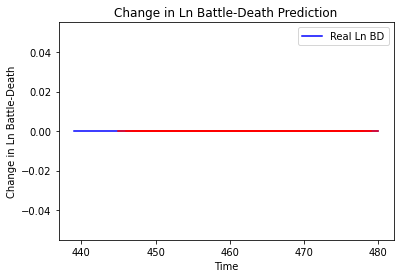

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
["Cote d'Ivoire"]
Building vanilla Model...
Model: "sequential_435"
_________________________________________________________________
Layer 

Epoch 64/100
61/61 [==============================] - 0s 6ms/step - loss: 0.5355 - val_loss: 0.2879
Epoch 65/100
61/61 [==============================] - 0s 4ms/step - loss: 0.5428 - val_loss: 0.2879
Epoch 66/100
61/61 [==============================] - 0s 5ms/step - loss: 0.5435 - val_loss: 0.2886
Epoch 67/100
61/61 [==============================] - 0s 6ms/step - loss: 0.5305 - val_loss: 0.2884
Epoch 68/100
61/61 [==============================] - 0s 6ms/step - loss: 0.5354 - val_loss: 0.2882
Epoch 69/100
61/61 [==============================] - 0s 6ms/step - loss: 0.5378 - val_loss: 0.2882
Epoch 70/100
61/61 [==============================] - 0s 5ms/step - loss: 0.5327 - val_loss: 0.2882
Epoch 71/100
61/61 [==============================] - 0s 5ms/step - loss: 0.5322 - val_loss: 0.2887
Epoch 72/100
61/61 [==============================] - 0s 4ms/step - loss: 0.5338 - val_loss: 0.2902
Epoch 73/100
61/61 [==============================] - 0s 5ms/step - loss: 0.5355 - val_loss: 0.2911


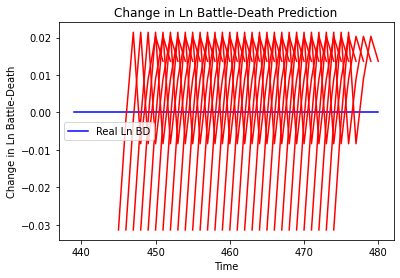

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+1', 'mse': 0.0009857732436672345, 'mae': 0.031397026032209396, 'r2': 0.0, 'tadda_score': 0.031397026032209396}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+2', 'mse': 0.0011155713897662012, 'mae': 0.033400170505046844, 'r2': 0.0, 'tadda_score': 0.033400170505046844}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+3', 'mse': 0.00014288792357887437, 'mae': 0.011953573673963547, 'r2': 0.0, 'tadda_score': 0.011953573673963547}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+4', 'mse': 0.00041241240672008905, 'mae': 0.020307939499616623, 'r2': 0.0, 'tadda_score': 0.020307939499616623}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+5', 'mse': 8.760870260983433e-05, 'mae': 0.009359952062368393, 'r2': 0.0, 'tadda_score': 0.009359952062368393}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+6', 'mse': 0.00012070423513534101

61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
61/61 [=====================

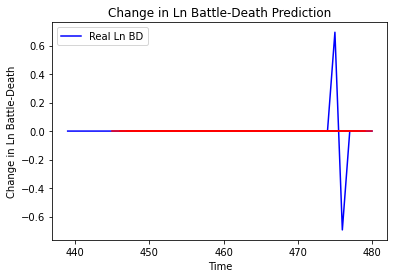

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ghana', 'country_id': 42, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Liberia']
Building vanilla Model...
Model: "sequential_437"
_________________________________________________________________
Layer (type)                 Output Shape      

Epoch 62/100
61/61 [==============================] - 0s 4ms/step - loss: 1.1933 - val_loss: 3.4224e-04
Epoch 63/100
61/61 [==============================] - 0s 4ms/step - loss: 1.1864 - val_loss: 5.0785e-04
Epoch 64/100
61/61 [==============================] - 0s 4ms/step - loss: 1.1720 - val_loss: 3.6673e-04
Epoch 65/100
61/61 [==============================] - 0s 4ms/step - loss: 1.1732 - val_loss: 0.0016
Epoch 66/100
61/61 [==============================] - 0s 4ms/step - loss: 1.1941 - val_loss: 1.8059e-04
Epoch 67/100
61/61 [==============================] - 0s 4ms/step - loss: 1.1940 - val_loss: 8.5557e-04
Epoch 68/100
61/61 [==============================] - 0s 4ms/step - loss: 1.1688 - val_loss: 2.1081e-04
Epoch 69/100
61/61 [==============================] - 0s 4ms/step - loss: 1.1620 - val_loss: 4.4537e-04
Epoch 70/100
61/61 [==============================] - 0s 4ms/step - loss: 1.1683 - val_loss: 4.1886e-04
Epoch 71/100
61/61 [==============================] - 0s 4ms/step - 

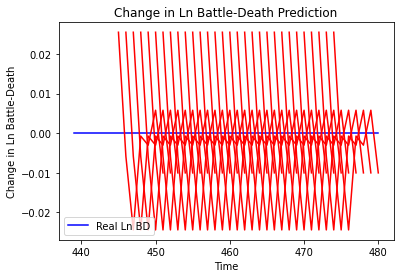

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Liberia', 'country_id': 43, 'step': 't+1', 'mse': 0.000650910547911332, 'mae': 0.025512948632240295, 'r2': 0.0, 'tadda_score': 0.025512948632240295}
{'country': 'Liberia', 'country_id': 43, 'step': 't+2', 'mse': 0.00038678310633878665, 'mae': 0.019666802138090134, 'r2': 0.0, 'tadda_score': 0.019666802138090134}
{'country': 'Liberia', 'country_id': 43, 'step': 't+3', 'mse': 2.2937432691563786e-05, 'mae': 0.0047893039882183075, 'r2': 0.0, 'tadda_score': 0.0047893039882183075}
{'country': 'Liberia', 'country_id': 43, 'step': 't+4', 'mse': 3.049957266064115e-05, 'mae': 0.005522641818970442, 'r2': 0.0, 'tadda_score': 0.005522641818970442}
{'country': 'Liberia', 'country_id': 43, 'step': 't+5', 'mse': 7.315520423747425e-06, 'mae': 0.002704721875488758, 'r2': 0.0, 'tadda_score': 0.002704721875488758}
{'country': 'Liberia', 'country_id': 43, 'step': 't+6', 'mse': 9.576281425846024e-06, 'mae': 0.0030945567414164543, 'r2'

Epoch 56/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
61/61 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
61/61 [========

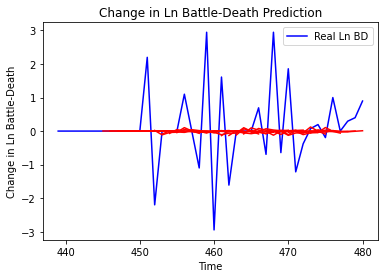

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+1', 'mse': 1.6742776543631133, 'mae': 0.8335248412330749, 'r2': -0.015278527382594831, 'tadda_score': 0.8465746639916477}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+2', 'mse': 1.2153790525381603, 'mae': 0.7374995573037526, 'r2': -0.027045985543387108, 'tadda_score': 0.749499747397866}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+3', 'mse': 2.079107497536221, 'mae': 0.9197378957385883, 'r2': -0.042883405759973625, 'tadda_score': 0.9401895886028871}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+4', 'mse': 2.449831263009633, 'mae': 1.0383192531516663, 'r2': -0.10361105329287468, 'tadda_score': 1.069929188651394}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+5', 'mse': 2.3406549435409576, 'mae': 0.950955364773219, 'r2': -0.12284161414109773, 'tadda_score': 0.968839185729171}
{'country': 'Burkina Faso', 'country_id': 47, 'step

61/61 [==============================] - 0s 4ms/step - loss: 0.2442 - val_loss: 1.6135e-04
Epoch 58/100
61/61 [==============================] - 0s 4ms/step - loss: 0.2410 - val_loss: 2.1168e-04
Epoch 59/100
61/61 [==============================] - 0s 4ms/step - loss: 0.2481 - val_loss: 2.9466e-04
Epoch 60/100
61/61 [==============================] - 0s 4ms/step - loss: 0.2542 - val_loss: 7.7404e-05
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 0.2564 - val_loss: 1.6132e-04
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 0.2459 - val_loss: 1.7136e-04
Epoch 63/100
61/61 [==============================] - 0s 4ms/step - loss: 0.2487 - val_loss: 1.4481e-05
Epoch 64/100
61/61 [==============================] - 0s 4ms/step - loss: 0.2576 - val_loss: 3.1385e-04
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 0.2451 - val_loss: 6.1341e-04
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 0.2

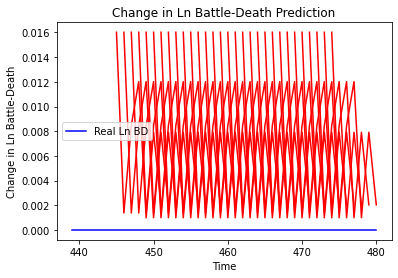

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea', 'country_id': 48, 'step': 't+1', 'mse': 0.0002566636747852874, 'mae': 0.016020726412534714, 'r2': 0.0, 'tadda_score': 0.016020726412534714}
{'country': 'Guinea', 'country_id': 48, 'step': 't+2', 'mse': 0.0003024646307859258, 'mae': 0.01739151030778885, 'r2': 0.0, 'tadda_score': 0.01739151030778885}
{'country': 'Guinea', 'country_id': 48, 'step': 't+3', 'mse': 0.0006682592793885202, 'mae': 0.02585071139037609, 'r2': 0.0, 'tadda_score': 0.02585071139037609}
{'country': 'Guinea', 'country_id': 48, 'step': 't+4', 'mse': 0.0014342653620774137, 'mae': 0.037871696054935455, 'r2': 0.0, 'tadda_score': 0.037871696054935455}
{'country': 'Guinea', 'country_id': 48, 'step': 't+5', 'mse': 0.001405306188478908, 'mae': 0.03748741373419762, 'r2': 0.0, 'tadda_score': 0.03748741373419762}
{'country': 'Guinea', 'country_id': 48, 'step': 't+6', 'mse': 0.002061184455195486, 'mae': 0.04540026932954788, 'r2': 0.0, 'tadda_score

61/61 [==============================] - 0s 3ms/step - loss: 0.5964 - val_loss: 1.7374e-04
Epoch 59/100
61/61 [==============================] - 0s 4ms/step - loss: 0.5973 - val_loss: 1.6635e-04
Epoch 60/100
61/61 [==============================] - 0s 4ms/step - loss: 0.5940 - val_loss: 2.1411e-04
Epoch 61/100
61/61 [==============================] - 0s 4ms/step - loss: 0.5678 - val_loss: 0.0015
Epoch 62/100
61/61 [==============================] - 0s 4ms/step - loss: 0.6273 - val_loss: 5.2900e-05
Epoch 63/100
61/61 [==============================] - 0s 3ms/step - loss: 0.5826 - val_loss: 2.1782e-05
Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 0.5617 - val_loss: 1.0468e-04
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 0.5965 - val_loss: 7.5850e-04
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 0.6045 - val_loss: 9.1616e-04
Epoch 67/100
61/61 [==============================] - 0s 4ms/step - loss: 0.5367 

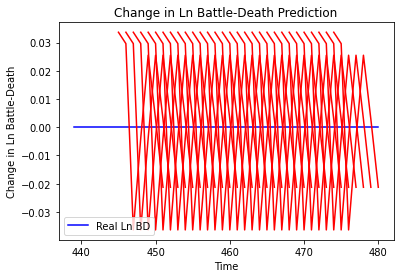

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+1', 'mse': 0.0011330955534418763, 'mae': 0.033661484718322754, 'r2': 0.0, 'tadda_score': 0.033661484718322754}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+2', 'mse': 0.004006670998452089, 'mae': 0.06329827010631561, 'r2': 0.0, 'tadda_score': 0.06329827010631561}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+3', 'mse': 0.0007255746989912049, 'mae': 0.026936493813991547, 'r2': 0.0, 'tadda_score': 0.026936493813991547}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+4', 'mse': 0.0005298608530736187, 'mae': 0.02301870658993721, 'r2': 0.0, 'tadda_score': 0.02301870658993721}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+5', 'mse': 0.0003572225160586445, 'mae': 0.018900331109762192, 'r2': 0.0, 'tadda_score': 0.018900331109762192}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+6', 'mse': 0.00047323701685564323, 'mae'

61/61 [==============================] - 0s 4ms/step - loss: 1.2663 - val_loss: 3.0105
Epoch 61/100
61/61 [==============================] - 0s 5ms/step - loss: 1.2791 - val_loss: 3.0110
Epoch 62/100
61/61 [==============================] - 0s 4ms/step - loss: 1.2713 - val_loss: 3.0132
Epoch 63/100
61/61 [==============================] - 0s 4ms/step - loss: 1.2582 - val_loss: 3.0155
Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 1.2671 - val_loss: 3.0162
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 1.2600 - val_loss: 3.0203
Epoch 66/100
61/61 [==============================] - 0s 4ms/step - loss: 1.2625 - val_loss: 3.0183
Epoch 67/100
61/61 [==============================] - 0s 3ms/step - loss: 1.2660 - val_loss: 3.0187
Epoch 68/100
61/61 [==============================] - 0s 4ms/step - loss: 1.2578 - val_loss: 3.0258
Epoch 69/100
61/61 [==============================] - 0s 3ms/step - loss: 1.2680 - val_loss: 3.0180
Epoch 70/100


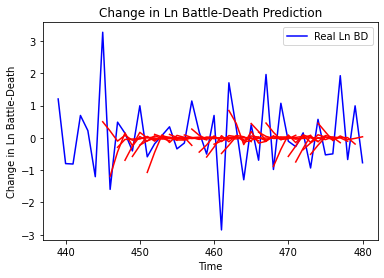

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mali', 'country_id': 50, 'step': 't+1', 'mse': 0.8652236089863127, 'mae': 0.6816972300128631, 'r2': 0.3146283539197221, 'tadda_score': 0.7680415868477515}
{'country': 'Mali', 'country_id': 50, 'step': 't+2', 'mse': 1.7394501715842798, 'mae': 1.05600860293681, 'r2': -0.7966205123219279, 'tadda_score': 1.4061515174902939}
{'country': 'Mali', 'country_id': 50, 'step': 't+3', 'mse': 1.6096687717314286, 'mae': 1.0716854700203808, 'r2': -0.4178605671670417, 'tadda_score': 1.3925091282781035}
{'country': 'Mali', 'country_id': 50, 'step': 't+4', 'mse': 2.359807233348313, 'mae': 1.272638736420233, 'r2': -0.5780057601955595, 'tadda_score': 1.677768847908436}
{'country': 'Mali', 'country_id': 50, 'step': 't+5', 'mse': 1.8071207192613459, 'mae': 1.1088871821969777, 'r2': -0.6689623585379292, 'tadda_score': 1.3690373139043683}
{'country': 'Mali', 'country_id': 50, 'step': 't+6', 'mse': 2.0851160812636573, 'mae': 1.1779936313

61/61 [==============================] - 0s 3ms/step - loss: 1.6269 - val_loss: 0.4302
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 1.6379 - val_loss: 0.4299
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 1.6227 - val_loss: 0.4302
Epoch 63/100
61/61 [==============================] - 0s 3ms/step - loss: 1.6300 - val_loss: 0.4311
Epoch 64/100
61/61 [==============================] - 0s 4ms/step - loss: 1.6285 - val_loss: 0.4320
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 1.6240 - val_loss: 0.4318
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 1.6258 - val_loss: 0.4302
Epoch 67/100
61/61 [==============================] - 0s 3ms/step - loss: 1.6242 - val_loss: 0.4318
Epoch 68/100
61/61 [==============================] - 0s 3ms/step - loss: 1.6247 - val_loss: 0.4312
Epoch 69/100
61/61 [==============================] - 0s 3ms/step - loss: 1.6285 - val_loss: 0.4316
Epoch 70/100


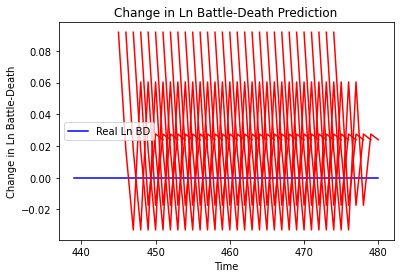

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Senegal', 'country_id': 52, 'step': 't+1', 'mse': 0.008422338843062427, 'mae': 0.09177330136299133, 'r2': 0.0, 'tadda_score': 0.09177330136299133}
{'country': 'Senegal', 'country_id': 52, 'step': 't+2', 'mse': 0.011910601506121887, 'mae': 0.109135702252388, 'r2': 0.0, 'tadda_score': 0.109135702252388}
{'country': 'Senegal', 'country_id': 52, 'step': 't+3', 'mse': 0.005810003790287566, 'mae': 0.07622338086366653, 'r2': 0.0, 'tadda_score': 0.07622338086366653}
{'country': 'Senegal', 'country_id': 52, 'step': 't+4', 'mse': 0.01867301779454067, 'mae': 0.1366492509841919, 'r2': 0.0, 'tadda_score': 0.1366492509841919}
{'country': 'Senegal', 'country_id': 52, 'step': 't+5', 'mse': 0.010392600307131739, 'mae': 0.10194410383701324, 'r2': 0.0, 'tadda_score': 0.10194410383701324}
{'country': 'Senegal', 'country_id': 52, 'step': 't+6', 'mse': 0.016772712820344537, 'mae': 0.12950950860977173, 'r2': 0.0, 'tadda_score': 0.1295

61/61 [==============================] - 0s 3ms/step - loss: 2.1202 - val_loss: 4.1198e-04
Epoch 59/100
61/61 [==============================] - 0s 3ms/step - loss: 2.1233 - val_loss: 0.0018
Epoch 60/100
61/61 [==============================] - 0s 3ms/step - loss: 2.1560 - val_loss: 8.4830e-04
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 2.1604 - val_loss: 4.2784e-04
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 2.1403 - val_loss: 6.7032e-04
Epoch 63/100
61/61 [==============================] - 0s 4ms/step - loss: 2.1437 - val_loss: 3.3094e-04
Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 2.1415 - val_loss: 0.0012
Epoch 65/100
61/61 [==============================] - 0s 4ms/step - loss: 2.1457 - val_loss: 5.4166e-04
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 2.1165 - val_loss: 6.5532e-04
Epoch 67/100
61/61 [==============================] - 0s 3ms/step - loss: 2.1135 - va

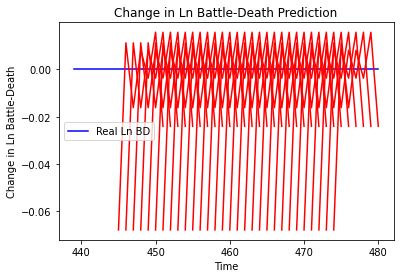

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+1', 'mse': 0.004615835055151507, 'mae': 0.06793993711471558, 'r2': 0.0, 'tadda_score': 0.06793993711471558}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+2', 'mse': 0.0032124536321132546, 'mae': 0.05667851120233536, 'r2': 0.0, 'tadda_score': 0.05667851120233536}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+3', 'mse': 0.005311261981193249, 'mae': 0.0728784054517746, 'r2': 0.0, 'tadda_score': 0.0728784054517746}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+4', 'mse': 0.004190497118242098, 'mae': 0.06473404914140701, 'r2': 0.0, 'tadda_score': 0.06473404914140701}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+5', 'mse': 0.006350974964475009, 'mae': 0.07969300448894501, 'r2': 0.0, 'tadda_score': 0.07969300448894501}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+6', 'mse': 0.004088202094438609, 'mae': 0.063939049839973

Epoch 56/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
61/61 [========

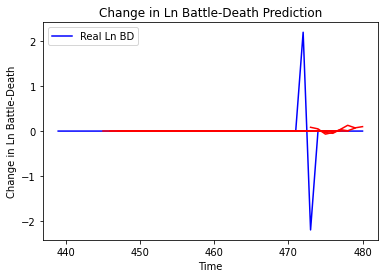

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'The Gambia', 'country_id': 54, 'step': 't+1', 'mse': 0.3344635006101058, 'mae': 0.14996411150983358, 'r2': -0.03918075081110084, 'tadda_score': 0.1527766746410865}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+2', 'mse': 0.3206260668255155, 'mae': 0.15051594397715115, 'r2': 0.00381226577617777, 'tadda_score': 0.15051594397715115}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+3', 'mse': 0.16120023594117155, 'mae': 0.07751101607477359, 'r2': -0.03624223256999781, 'tadda_score': 0.07751101607477359}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+4', 'mse': 0.16098918190446462, 'mae': 0.0752661927729417, 'r2': -0.03488551553473296, 'tadda_score': 0.0752661927729417}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+5', 'mse': 0.16154135505451395, 'mae': 0.07832870462929896, 'r2': -0.0384350459335665, 'tadda_score': 0.07832870462929896}
{'country': 'The Gambia', 'country_id': 54, 'step'

61/61 [==============================] - 0s 4ms/step - loss: 0.6197 - val_loss: 0.0014
Epoch 58/100
61/61 [==============================] - 0s 4ms/step - loss: 0.6166 - val_loss: 0.0013
Epoch 59/100
61/61 [==============================] - 0s 4ms/step - loss: 0.6194 - val_loss: 8.3134e-04
Epoch 60/100
61/61 [==============================] - 0s 5ms/step - loss: 0.6158 - val_loss: 0.0017
Epoch 61/100
61/61 [==============================] - 0s 5ms/step - loss: 0.6146 - val_loss: 0.0010
Epoch 62/100
61/61 [==============================] - 0s 6ms/step - loss: 0.6112 - val_loss: 4.4322e-04
Epoch 63/100
61/61 [==============================] - 0s 5ms/step - loss: 0.6238 - val_loss: 6.3381e-04
Epoch 64/100
61/61 [==============================] - 0s 4ms/step - loss: 0.6145 - val_loss: 0.0011
Epoch 65/100
61/61 [==============================] - 0s 7ms/step - loss: 0.6111 - val_loss: 0.0012
Epoch 66/100
61/61 [==============================] - 0s 6ms/step - loss: 0.6163 - val_loss: 0.0019
E

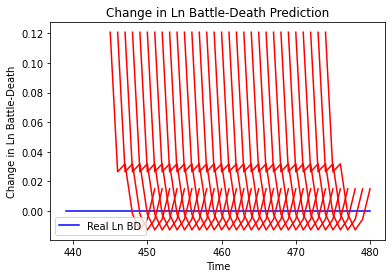

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Djibouti', 'country_id': 55, 'step': 't+1', 'mse': 0.014600347899301147, 'mae': 0.12083189934492111, 'r2': 0.0, 'tadda_score': 0.12083189934492111}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+2', 'mse': 0.02168269755736163, 'mae': 0.1472504585981369, 'r2': 0.0, 'tadda_score': 0.1472504585981369}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+3', 'mse': 0.032063379119709134, 'mae': 0.17906250059604645, 'r2': 0.0, 'tadda_score': 0.17906250059604645}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+4', 'mse': 0.03129296659622938, 'mae': 0.17689818143844604, 'r2': 0.0, 'tadda_score': 0.17689818143844604}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+5', 'mse': 0.018926835668749087, 'mae': 0.13757483661174774, 'r2': 0.0, 'tadda_score': 0.13757483661174774}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+6', 'mse': 0.017391281149059745, 'mae': 0.13187600672245026, 'r2': 0.0, 'tadda_score

53/53 [==============================] - 0s 3ms/step - loss: 1.9367 - val_loss: 0.0296
Epoch 61/100
53/53 [==============================] - 0s 4ms/step - loss: 1.9034 - val_loss: 0.0291
Epoch 62/100
53/53 [==============================] - 0s 3ms/step - loss: 1.9433 - val_loss: 0.0291
Epoch 63/100
53/53 [==============================] - 0s 3ms/step - loss: 1.9360 - val_loss: 0.0307
Epoch 64/100
53/53 [==============================] - 0s 3ms/step - loss: 1.8955 - val_loss: 0.0293
Epoch 65/100
53/53 [==============================] - 0s 3ms/step - loss: 1.9339 - val_loss: 0.0290
Epoch 66/100
53/53 [==============================] - 0s 3ms/step - loss: 1.9282 - val_loss: 0.0299
Epoch 67/100
53/53 [==============================] - 0s 3ms/step - loss: 1.9207 - val_loss: 0.0299
Epoch 68/100
53/53 [==============================] - 0s 3ms/step - loss: 1.8987 - val_loss: 0.0329
Epoch 69/100
53/53 [==============================] - 0s 3ms/step - loss: 1.9355 - val_loss: 0.0325
Epoch 70/100


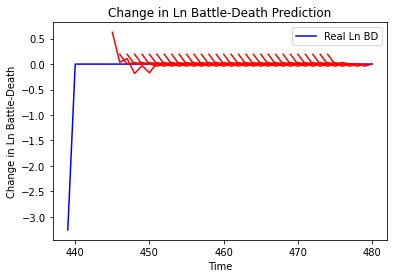

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Eritrea', 'country_id': 56, 'step': 't+1', 'mse': 0.0487016075531441, 'mae': 0.20650306195020676, 'r2': 0.0, 'tadda_score': 0.20650306195020676}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+2', 'mse': 0.049354955069336064, 'mae': 0.2054176022609075, 'r2': 0.0, 'tadda_score': 0.2054176022609075}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+3', 'mse': 0.06658120077976373, 'mae': 0.23855291108290355, 'r2': 0.0, 'tadda_score': 0.23855291108290355}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+4', 'mse': 0.05688742705568725, 'mae': 0.22932355056206385, 'r2': 0.0, 'tadda_score': 0.22932355056206385}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+5', 'mse': 0.05736805901245109, 'mae': 0.23374217847983042, 'r2': 0.0, 'tadda_score': 0.23374217847983042}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+6', 'mse': 0.0363579847383132, 'mae': 0.188482699294885, 'r2': 0.0, 'tadda_score': 0.18848269

53/53 [==============================] - 0s 4ms/step - loss: 4.4574 - val_loss: 2.5921
Epoch 61/100
53/53 [==============================] - 0s 4ms/step - loss: 4.5187 - val_loss: 2.5897
Epoch 62/100
53/53 [==============================] - 0s 4ms/step - loss: 4.5190 - val_loss: 2.5879
Epoch 63/100
53/53 [==============================] - 0s 4ms/step - loss: 4.4808 - val_loss: 2.5859
Epoch 64/100
53/53 [==============================] - 0s 4ms/step - loss: 4.4746 - val_loss: 2.5874
Epoch 65/100
53/53 [==============================] - 0s 4ms/step - loss: 4.4658 - val_loss: 2.5838
Epoch 66/100
53/53 [==============================] - 0s 4ms/step - loss: 4.5507 - val_loss: 2.5847
Epoch 67/100
53/53 [==============================] - 0s 4ms/step - loss: 4.4587 - val_loss: 2.5840
Epoch 68/100
53/53 [==============================] - 0s 6ms/step - loss: 4.5044 - val_loss: 2.5856
Epoch 69/100
53/53 [==============================] - 0s 5ms/step - loss: 4.4674 - val_loss: 2.5830
Epoch 70/100


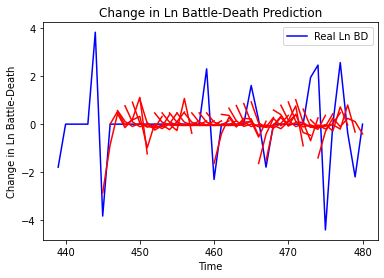

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+1', 'mse': 1.2078134475175155, 'mae': 0.8384042194600905, 'r2': 0.11466276834903977, 'tadda_score': 0.9399324308947727}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+2', 'mse': 4.1542681873091984, 'mae': 1.4671147295516438, 'r2': -1.0820941186009305, 'tadda_score': 1.6691450068038411}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+3', 'mse': 4.016091240103126, 'mae': 1.4783323102873276, 'r2': -1.0128406674195944, 'tadda_score': 1.689487893748453}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+4', 'mse': 4.177964155764296, 'mae': 1.4918802014173775, 'r2': -1.0939703948378936, 'tadda_score': 1.7157952828885823}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+5', 'mse': 3.2722636904071005, 'mae': 1.2532850326281497, 'r2': -0.6400387931432565, 'tadda_score': 1.4143912964743088}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+6', 'mse': 2.7335523250

Epoch 60/100
61/61 [==============================] - 0s 5ms/step - loss: 0.9126 - val_loss: 1.0019
Epoch 61/100
61/61 [==============================] - 0s 4ms/step - loss: 0.9110 - val_loss: 1.0028
Epoch 62/100
61/61 [==============================] - 0s 4ms/step - loss: 0.9226 - val_loss: 1.0017
Epoch 63/100
61/61 [==============================] - 0s 4ms/step - loss: 0.9133 - val_loss: 1.0032
Epoch 64/100
61/61 [==============================] - 0s 4ms/step - loss: 0.9241 - val_loss: 1.0023
Epoch 65/100
61/61 [==============================] - 0s 4ms/step - loss: 0.9239 - val_loss: 1.0029
Epoch 66/100
61/61 [==============================] - 0s 4ms/step - loss: 0.9167 - val_loss: 1.0015
Epoch 67/100
61/61 [==============================] - 0s 5ms/step - loss: 0.9141 - val_loss: 1.0020
Epoch 68/100
61/61 [==============================] - 0s 6ms/step - loss: 0.9188 - val_loss: 1.0025
Epoch 69/100
61/61 [==============================] - 0s 4ms/step - loss: 0.9191 - val_loss: 1.0017


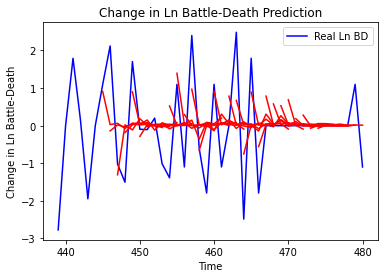

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Algeria', 'country_id': 67, 'step': 't+1', 'mse': 1.0655849611687587, 'mae': 0.8048241307536798, 'r2': 0.33186693208785945, 'tadda_score': 0.8387874596019622}
{'country': 'Algeria', 'country_id': 67, 'step': 't+2', 'mse': 2.3816773462483822, 'mae': 1.178257777504263, 'r2': -0.41412961871936993, 'tadda_score': 1.4362783060964326}
{'country': 'Algeria', 'country_id': 67, 'step': 't+3', 'mse': 2.6991967820770375, 'mae': 1.2917492808422457, 'r2': -0.504680384289911, 'tadda_score': 1.5916538885753364}
{'country': 'Algeria', 'country_id': 67, 'step': 't+4', 'mse': 2.8467932657878774, 'mae': 1.2964402686004866, 'r2': -0.394469242636865, 'tadda_score': 1.5526013290330796}
{'country': 'Algeria', 'country_id': 67, 'step': 't+5', 'mse': 2.163015545692745, 'mae': 1.0856122733982736, 'r2': -0.6072692257625851, 'tadda_score': 1.305995121904446}
{'country': 'Algeria', 'country_id': 67, 'step': 't+6', 'mse': 2.2565613024257947,

Epoch 60/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1820 - val_loss: 1.4580
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1832 - val_loss: 1.4597
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1812 - val_loss: 1.4564
Epoch 63/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1825 - val_loss: 1.4563
Epoch 64/100
61/61 [==============================] - 0s 4ms/step - loss: 0.1842 - val_loss: 1.4534
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1830 - val_loss: 1.4537
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1841 - val_loss: 1.4530
Epoch 67/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1844 - val_loss: 1.4519
Epoch 68/100
61/61 [==============================] - 0s 5ms/step - loss: 0.1815 - val_loss: 1.4513
Epoch 69/100
61/61 [==============================] - 0s 5ms/step - loss: 0.1850 - val_loss: 1.4502


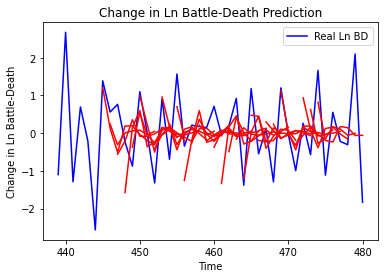

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cameroon', 'country_id': 69, 'step': 't+1', 'mse': 0.608437251884104, 'mae': 0.6365996052187967, 'r2': 0.1738325236112298, 'tadda_score': 0.7420654559495338}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+2', 'mse': 1.7966214460104808, 'mae': 1.1577953643979189, 'r2': -1.4340320226947294, 'tadda_score': 1.6091492675127148}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+3', 'mse': 1.459931706175278, 'mae': 0.9955942284994267, 'r2': -0.4897216683893024, 'tadda_score': 1.2065740027212046}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+4', 'mse': 1.6023528326763943, 'mae': 0.9720004657917464, 'r2': -0.8194297448813341, 'tadda_score': 1.2319117764645067}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+5', 'mse': 2.0335614190867535, 'mae': 1.1912052106718884, 'r2': -1.0444272002971289, 'tadda_score': 1.5532126153494583}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+6', 'mse': 2.0860276240

61/61 [==============================] - 0s 4ms/step - loss: 0.7188 - val_loss: 2.3918
Epoch 60/100
61/61 [==============================] - 0s 3ms/step - loss: 0.7190 - val_loss: 2.3893
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 0.7241 - val_loss: 2.3871
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 0.7126 - val_loss: 2.3887
Epoch 63/100
61/61 [==============================] - 0s 4ms/step - loss: 0.7102 - val_loss: 2.3920
Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 0.7120 - val_loss: 2.3917
Epoch 65/100
61/61 [==============================] - 0s 4ms/step - loss: 0.7050 - val_loss: 2.3867
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 0.7218 - val_loss: 2.3881
Epoch 67/100
61/61 [==============================] - 0s 3ms/step - loss: 0.7095 - val_loss: 2.3871
Epoch 68/100
61/61 [==============================] - 0s 3ms/step - loss: 0.7120 - val_loss: 2.3845
Epoch 69/100


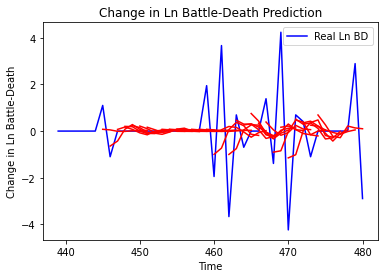

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+1', 'mse': 1.9086856352554118, 'mae': 0.8395995954403207, 'r2': 0.278307400512692, 'tadda_score': 0.8567103594272261}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+2', 'mse': 2.435990029559339, 'mae': 1.137335273307738, 'r2': -0.6639580786541774, 'tadda_score': 1.2843241971554133}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+3', 'mse': 2.7180979702549406, 'mae': 1.1031330985108165, 'r2': -0.1596874151224168, 'tadda_score': 1.2015892741361407}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+4', 'mse': 3.109576535615115, 'mae': 1.1630409929483752, 'r2': -0.28619966860404866, 'tadda_score': 1.2902726663479822}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+5', 'mse': 2.7585382290581846, 'mae': 0.9232227872118826, 'r2': -0.0885438541843604, 'tadda_score': 0.963124312242416

61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 57/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 58/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 59/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 60/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 62/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 63/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 65/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0

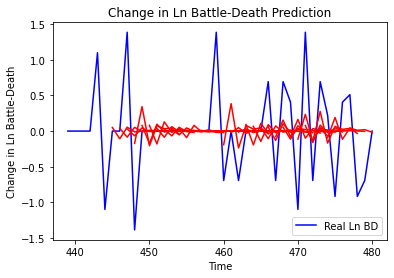

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tunisia', 'country_id': 73, 'step': 't+1', 'mse': 0.3649384011527977, 'mae': 0.39834876279585935, 'r2': 0.11603089817663537, 'tadda_score': 0.4041252351855574}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+2', 'mse': 0.3930873097815621, 'mae': 0.426775848610437, 'r2': 0.044736481344820445, 'tadda_score': 0.4388514028794925}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+3', 'mse': 0.48776451344712574, 'mae': 0.47029963307192185, 'r2': -0.02084588504496665, 'tadda_score': 0.47488972337405144}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+4', 'mse': 0.49442527304955186, 'mae': 0.4590380735742362, 'r2': -0.023931869145592533, 'tadda_score': 0.4608115183546952}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+5', 'mse': 0.5035340868003977, 'mae': 0.5061849248203899, 'r2': -0.1445553108840325, 'tadda_score': 0.5466983739826347}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+6', 'mse': 0.59789

61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
61/61 [=====================

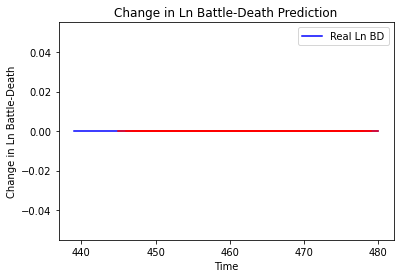

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Benin', 'country_id': 74, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Equatorial Guinea']
Building vanilla Model...
Model: "sequential_453"
_________________________________________________________________
Layer (type)                 Output S

61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
61/61 [=====================

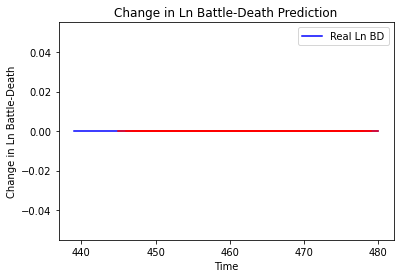

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Niger']
Building vanilla Model...
Model: "sequential_454"
_______________________________

61/61 [==============================] - 0s 4ms/step - loss: 0.8474 - val_loss: 1.6266
Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 0.8386 - val_loss: 1.6253
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 0.8495 - val_loss: 1.6273
Epoch 66/100
61/61 [==============================] - 0s 5ms/step - loss: 0.8558 - val_loss: 1.6265
Epoch 67/100
61/61 [==============================] - 0s 4ms/step - loss: 0.8622 - val_loss: 1.6273
Epoch 68/100
61/61 [==============================] - 0s 3ms/step - loss: 0.8424 - val_loss: 1.6263
Epoch 69/100
61/61 [==============================] - 0s 4ms/step - loss: 0.8458 - val_loss: 1.6260
Epoch 70/100
61/61 [==============================] - 0s 4ms/step - loss: 0.8409 - val_loss: 1.6279
Epoch 71/100
61/61 [==============================] - 0s 3ms/step - loss: 0.8518 - val_loss: 1.6274
Epoch 72/100
61/61 [==============================] - 0s 3ms/step - loss: 0.8436 - val_loss: 1.6265
Epoch 73/100


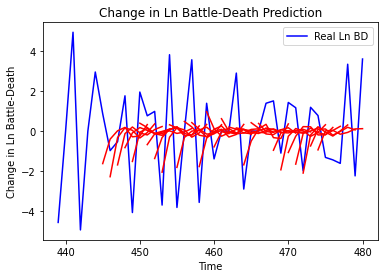

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Niger', 'country_id': 78, 'step': 't+1', 'mse': 3.457292648804431, 'mae': 1.6029305564790102, 'r2': 0.2018933092070362, 'tadda_score': 1.930974156402462}
{'country': 'Niger', 'country_id': 78, 'step': 't+2', 'mse': 7.016940146461735, 'mae': 2.228248242104209, 'r2': -0.7869327093016389, 'tadda_score': 2.768634169860836}
{'country': 'Niger', 'country_id': 78, 'step': 't+3', 'mse': 6.44888013855268, 'mae': 2.000395006706748, 'r2': -0.6650716573350939, 'tadda_score': 2.5515958823466627}
{'country': 'Niger', 'country_id': 78, 'step': 't+4', 'mse': 6.76286322861377, 'mae': 2.169828109757074, 'r2': -0.49052759971966053, 'tadda_score': 2.644827769017188}
{'country': 'Niger', 'country_id': 78, 'step': 't+5', 'mse': 8.13668944675607, 'mae': 2.3086301329619063, 'r2': -0.4791753552489044, 'tadda_score': 2.823977594985204}
{'country': 'Niger', 'country_id': 78, 'step': 't+6', 'mse': 7.774309384746769, 'mae': 2.16094998400370

61/61 [==============================] - 0s 4ms/step - loss: 0.5342 - val_loss: 1.2071
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 0.5251 - val_loss: 1.2093
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 0.5340 - val_loss: 1.2102
Epoch 63/100
61/61 [==============================] - 0s 3ms/step - loss: 0.5313 - val_loss: 1.2129
Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 0.5326 - val_loss: 1.2104
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 0.5248 - val_loss: 1.2156
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 0.5318 - val_loss: 1.2144
Epoch 67/100
61/61 [==============================] - 0s 3ms/step - loss: 0.5350 - val_loss: 1.2170
Epoch 68/100
61/61 [==============================] - 0s 3ms/step - loss: 0.5291 - val_loss: 1.2218
Epoch 69/100
61/61 [==============================] - 0s 3ms/step - loss: 0.5428 - val_loss: 1.2142
Epoch 70/100


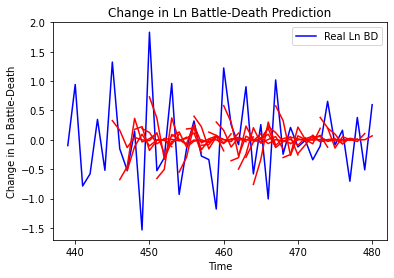

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Nigeria', 'country_id': 79, 'step': 't+1', 'mse': 0.46321073272495616, 'mae': 0.504188778308447, 'r2': 0.1894914216255298, 'tadda_score': 0.5768802779986619}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+2', 'mse': 1.297511506091809, 'mae': 0.9287237583321681, 'r2': -1.3980464982882244, 'tadda_score': 1.2665307468396771}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+3', 'mse': 1.0444628857742524, 'mae': 0.8091389998797948, 'r2': -0.7047170725057421, 'tadda_score': 1.0380291855587935}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+4', 'mse': 1.1973548761556398, 'mae': 0.8600877594101828, 'r2': -0.6096165058097283, 'tadda_score': 1.1325370889056126}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+5', 'mse': 0.7638578139110377, 'mae': 0.6875646460303073, 'r2': -0.4920173634168008, 'tadda_score': 0.8478266221283283}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+6', 'mse': 0.782426788719352

61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
61/61 [=====================

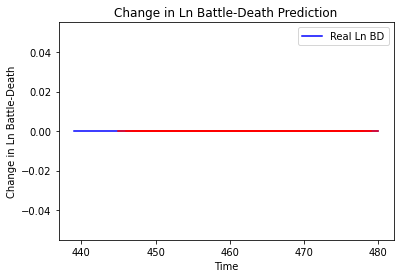

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Togo']
Building vanilla Model...
Model: "sequential_457"
____

61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
61/61 [=====================

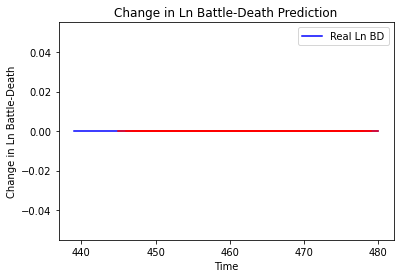

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Togo', 'country_id': 81, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Somalia']
Building vanilla Model...
Model: "sequential_458"
_________________________________________________________________
Layer (type)                 Output Shape             

61/61 [==============================] - 0s 3ms/step - loss: 2.5549 - val_loss: 0.3700
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 2.5439 - val_loss: 0.3704
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 2.5499 - val_loss: 0.3695
Epoch 67/100
61/61 [==============================] - 0s 3ms/step - loss: 2.5243 - val_loss: 0.3692
Epoch 68/100
61/61 [==============================] - 0s 3ms/step - loss: 2.5614 - val_loss: 0.3697
Epoch 69/100
61/61 [==============================] - 0s 3ms/step - loss: 2.5268 - val_loss: 0.3694
Epoch 70/100
61/61 [==============================] - 0s 3ms/step - loss: 2.5558 - val_loss: 0.3716
Epoch 71/100
61/61 [==============================] - 0s 3ms/step - loss: 2.5707 - val_loss: 0.3705
Epoch 72/100
61/61 [==============================] - 0s 3ms/step - loss: 2.5414 - val_loss: 0.3700
Epoch 73/100
61/61 [==============================] - 0s 3ms/step - loss: 2.5639 - val_loss: 0.3704
Epoch 74/100


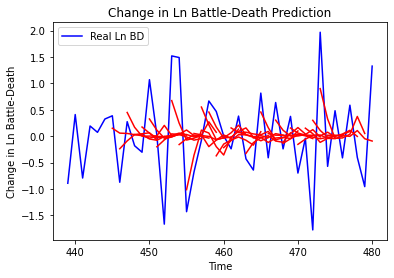

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Somalia', 'country_id': 120, 'step': 't+1', 'mse': 0.5529695412756427, 'mae': 0.5738531922863167, 'r2': 0.27411399770259004, 'tadda_score': 0.6547147003875418}
{'country': 'Somalia', 'country_id': 120, 'step': 't+2', 'mse': 1.3875558335944798, 'mae': 0.9013278424610062, 'r2': -0.4149610202067653, 'tadda_score': 1.1114590773850046}
{'country': 'Somalia', 'country_id': 120, 'step': 't+3', 'mse': 1.3366394836020257, 'mae': 0.8451739855615945, 'r2': -0.6747905561995964, 'tadda_score': 1.0666080014664583}
{'country': 'Somalia', 'country_id': 120, 'step': 't+4', 'mse': 1.0234594513692596, 'mae': 0.8209524252033802, 'r2': -0.4764728949495587, 'tadda_score': 0.9840570762024892}
{'country': 'Somalia', 'country_id': 120, 'step': 't+5', 'mse': 0.8747824115093076, 'mae': 0.6969445772093452, 'r2': -0.13476148831531032, 'tadda_score': 0.8421742535751976}
{'country': 'Somalia', 'country_id': 120, 'step': 't+6', 'mse': 1.033606

61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
61/61 [=====================

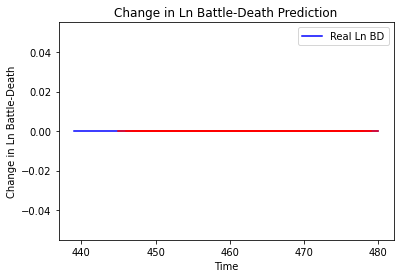

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Botswana', 'country_id': 154, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Burundi']
Building vanilla Model...
Model: "sequential_460"
_________________________________________________________________
Layer (type)       

Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 1.8976 - val_loss: 1.6173
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 1.9130 - val_loss: 1.6166
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 1.9155 - val_loss: 1.6166
Epoch 67/100
61/61 [==============================] - 0s 4ms/step - loss: 1.9243 - val_loss: 1.6175
Epoch 68/100
61/61 [==============================] - 0s 4ms/step - loss: 1.9047 - val_loss: 1.6155
Epoch 69/100
61/61 [==============================] - 0s 3ms/step - loss: 1.9246 - val_loss: 1.6154
Epoch 70/100
61/61 [==============================] - 0s 3ms/step - loss: 1.9278 - val_loss: 1.6153
Epoch 71/100
61/61 [==============================] - 0s 3ms/step - loss: 1.9197 - val_loss: 1.6160
Epoch 72/100
61/61 [==============================] - 0s 3ms/step - loss: 1.9144 - val_loss: 1.6156
Epoch 73/100
61/61 [==============================] - 0s 3ms/step - loss: 1.9140 - val_loss: 1.6148


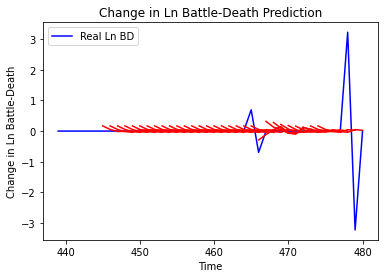

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burundi', 'country_id': 155, 'step': 't+1', 'mse': 0.045431024270019375, 'mae': 0.19712354180433433, 'r2': -0.4183808703639691, 'tadda_score': 0.19712354180433433}
{'country': 'Burundi', 'country_id': 155, 'step': 't+2', 'mse': 0.10367652728915717, 'mae': 0.2717087903342454, 'r2': -2.236836619370498, 'tadda_score': 0.28659957634625916}
{'country': 'Burundi', 'country_id': 155, 'step': 't+3', 'mse': 0.09141837248413005, 'mae': 0.2547826730928628, 'r2': -1.8541304717372733, 'tadda_score': 0.2658689641676156}
{'country': 'Burundi', 'country_id': 155, 'step': 't+4', 'mse': 0.07597045286284228, 'mae': 0.23636948130744778, 'r2': -1.3718381609250292, 'tadda_score': 0.2431889728925435}
{'country': 'Burundi', 'country_id': 155, 'step': 't+5', 'mse': 0.044375620006126264, 'mae': 0.14793817015705588, 'r2': -0.38543058490464643, 'tadda_score': 0.1513024174890725}
{'country': 'Burundi', 'country_id': 155, 'step': 't+6', 'mse

61/61 [==============================] - 0s 3ms/step - loss: 2.4098 - val_loss: 0.1813
Epoch 60/100
61/61 [==============================] - 0s 3ms/step - loss: 2.3984 - val_loss: 0.1838
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 2.4032 - val_loss: 0.1820
Epoch 62/100
61/61 [==============================] - 0s 6ms/step - loss: 2.3975 - val_loss: 0.1825
Epoch 63/100
61/61 [==============================] - 0s 3ms/step - loss: 2.3951 - val_loss: 0.1844
Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 2.4039 - val_loss: 0.1852
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 2.3974 - val_loss: 0.1832
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 2.3851 - val_loss: 0.1814
Epoch 67/100
61/61 [==============================] - 0s 3ms/step - loss: 2.4081 - val_loss: 0.1837
Epoch 68/100
61/61 [==============================] - 0s 3ms/step - loss: 2.4032 - val_loss: 0.1861
Epoch 69/100


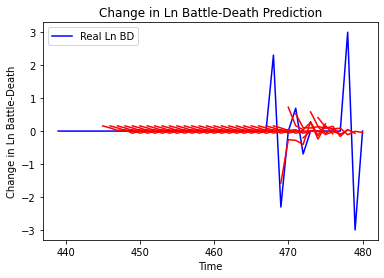

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Rwanda', 'country_id': 156, 'step': 't+1', 'mse': 0.23325097679776868, 'mae': 0.2964352282150046, 'r2': 0.3949235221630314, 'tadda_score': 0.2964352282150046}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+2', 'mse': 0.718331734453726, 'mae': 0.5044699159526285, 'r2': -0.863424718596673, 'tadda_score': 0.5580880152447478}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+3', 'mse': 0.632709585202513, 'mae': 0.5344376855633307, 'r2': -1.2670608211774006, 'tadda_score': 0.5782562189838935}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+4', 'mse': 0.6503485376827158, 'mae': 0.5586168248634282, 'r2': -0.762743351247297, 'tadda_score': 0.5586168248634282}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+5', 'mse': 0.622467589914358, 'mae': 0.40512274731224296, 'r2': -0.6871731724009456, 'tadda_score': 0.42675939628507215}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+6', 'mse': 0.623629980651187,

61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
61/61 [=====================

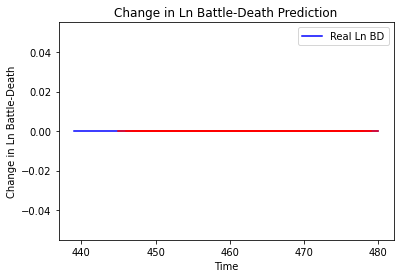

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zambia', 'country_id': 157, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Zimbabwe']
Building vanilla Model...
Model: "sequential_463"
_________________________________________________________________
Layer (type)                 Out

61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
61/61 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
61/61 [=====================

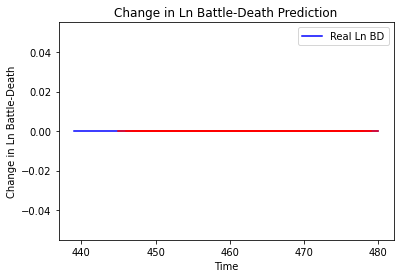

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Comoros']
Building vanilla Model...
Model: "sequential_464"
_________________________________________________________________
Layer (type)       

61/61 [==============================] - 0s 3ms/step - loss: 0.1265 - val_loss: 1.4146e-04
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1252 - val_loss: 5.2943e-06
Epoch 63/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1249 - val_loss: 1.2001e-04
Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1247 - val_loss: 8.7036e-05
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1250 - val_loss: 1.1811e-04
Epoch 66/100
61/61 [==============================] - 0s 4ms/step - loss: 0.1251 - val_loss: 1.1406e-04
Epoch 67/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1248 - val_loss: 8.8980e-06
Epoch 68/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1255 - val_loss: 8.2721e-05
Epoch 69/100
61/61 [==============================] - 0s 4ms/step - loss: 0.1257 - val_loss: 1.1389e-04
Epoch 70/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1

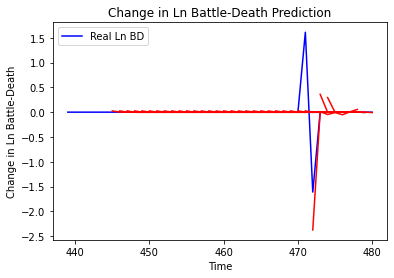

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Comoros', 'country_id': 159, 'step': 't+1', 'mse': 0.11076947228231046, 'mae': 0.12166936732828618, 'r2': 0.35854987993005105, 'tadda_score': 0.12166936732828618}
{'country': 'Comoros', 'country_id': 159, 'step': 't+2', 'mse': 0.4014805839219516, 'mae': 0.22856248006918425, 'r2': -1.3249164544734926, 'tadda_score': 0.24041944330631093}
{'country': 'Comoros', 'country_id': 159, 'step': 't+3', 'mse': 0.40291794801439834, 'mae': 0.23099696510233875, 'r2': -1.3332400236905997, 'tadda_score': 0.2408608125964641}
{'country': 'Comoros', 'country_id': 159, 'step': 't+4', 'mse': 0.2862307608035078, 'mae': 0.17537044161656695, 'r2': -2.4293543425815316, 'tadda_score': 0.17537044161656695}
{'country': 'Comoros', 'country_id': 159, 'step': 't+5', 'mse': 0.2972202402383202, 'mae': 0.17424428847033976, 'r2': -2.561020201683083, 'tadda_score': 0.17424428847033976}
{'country': 'Comoros', 'country_id': 159, 'step': 't+6', 'mse':

61/61 [==============================] - 0s 3ms/step - loss: 0.1368 - val_loss: 1.0934e-05
Epoch 58/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1370 - val_loss: 5.0556e-05
Epoch 59/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1373 - val_loss: 5.4118e-05
Epoch 60/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1411 - val_loss: 8.9434e-06
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1371 - val_loss: 8.7724e-05
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1390 - val_loss: 1.1832e-04
Epoch 63/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1372 - val_loss: 3.4050e-05
Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1368 - val_loss: 3.6238e-05
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1369 - val_loss: 1.3569e-06
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 0.1

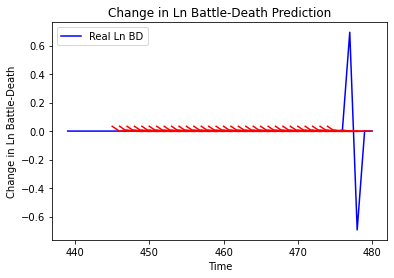

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Lesotho', 'country_id': 160, 'step': 't+1', 'mse': 0.001133408570467509, 'mae': 0.033666133880615234, 'r2': 0.0, 'tadda_score': 0.033666133880615234}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+2', 'mse': 0.001028301145593824, 'mae': 0.032067134976387024, 'r2': 0.0, 'tadda_score': 0.032067134976387024}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+3', 'mse': 0.0015832663954729598, 'mae': 0.039790280163288116, 'r2': 0.0, 'tadda_score': 0.039790280163288116}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+4', 'mse': 0.0015019866680350408, 'mae': 0.038755472749471664, 'r2': 0.0, 'tadda_score': 0.038755472749471664}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+5', 'mse': 0.001415305643774914, 'mae': 0.03762054815888405, 'r2': 0.0, 'tadda_score': 0.03762054815888405}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+6', 'mse': 0.0014843108374463926, 'mae': 0.0385267548263073, 'r2': 0.0

61/61 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
61/61 [=====================

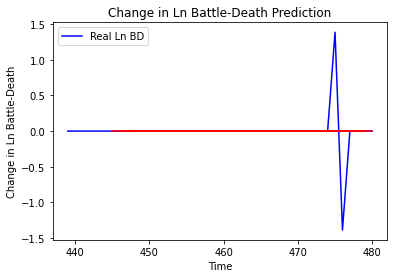

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Malawi', 'country_id': 161, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mozambique']
Building vanilla Model...
Model: "sequential_467"
_________________________________________________________________
Layer (type)                 O

61/61 [==============================] - 0s 3ms/step - loss: 0.9409 - val_loss: 0.6971
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 0.9480 - val_loss: 0.6984
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 0.9891 - val_loss: 0.6995
Epoch 67/100
61/61 [==============================] - 0s 3ms/step - loss: 0.9909 - val_loss: 0.7009
Epoch 68/100
61/61 [==============================] - 0s 3ms/step - loss: 1.0180 - val_loss: 0.6986
Epoch 69/100
61/61 [==============================] - 0s 3ms/step - loss: 0.9738 - val_loss: 0.6992
Epoch 70/100
61/61 [==============================] - 0s 3ms/step - loss: 1.0075 - val_loss: 0.7025
Epoch 71/100
61/61 [==============================] - 0s 3ms/step - loss: 1.0163 - val_loss: 0.7005
Epoch 72/100
61/61 [==============================] - 0s 3ms/step - loss: 0.9824 - val_loss: 0.7039
Epoch 73/100
61/61 [==============================] - 0s 3ms/step - loss: 0.9739 - val_loss: 0.7059
Epoch 74/100


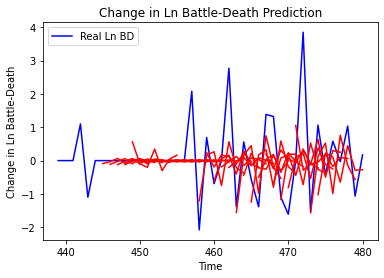

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mozambique', 'country_id': 162, 'step': 't+1', 'mse': 1.3605177075144421, 'mae': 0.7093288656733766, 'r2': 0.13538509359396989, 'tadda_score': 0.7887738546145295}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+2', 'mse': 2.607501379769636, 'mae': 1.0857485119168337, 'r2': -0.3628146930941851, 'tadda_score': 1.2693662337873755}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+3', 'mse': 2.652528179493387, 'mae': 1.1374153585827826, 'r2': -0.3859806037503608, 'tadda_score': 1.3138137288114906}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+4', 'mse': 3.072181437580842, 'mae': 1.265834267391658, 'r2': -1.0385687272772066, 'tadda_score': 1.6467956363696816}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+5', 'mse': 1.6468683116415836, 'mae': 0.8987249812414171, 'r2': -1.0108381809657936, 'tadda_score': 1.0888415703852892}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+6', 'm

61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
61/61 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
61/61 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
61/61 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
61/61 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
61/61 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
61/61 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
61/61 [=====================

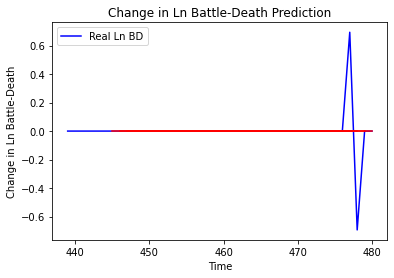

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Africa', 'country_id': 163, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Swaziland']
Building vanilla Model...
Model: "sequential_469"
_______________________________________________________

61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
61/61 [=====================

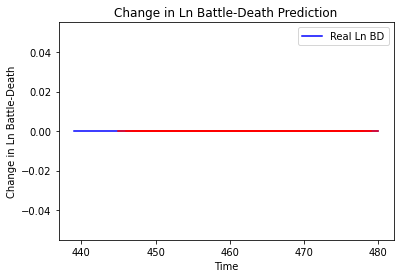

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Swaziland', 'country_id': 164, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Angola']
Building vanilla Model...
Model: "sequential_470"
_________________________________________________________________
Layer (type) 

Epoch 64/100
61/61 [==============================] - 0s 4ms/step - loss: 3.2883 - val_loss: 0.0869
Epoch 65/100
61/61 [==============================] - 0s 4ms/step - loss: 3.2563 - val_loss: 0.0868
Epoch 66/100
61/61 [==============================] - 0s 4ms/step - loss: 3.2639 - val_loss: 0.0865
Epoch 67/100
61/61 [==============================] - 0s 3ms/step - loss: 3.2537 - val_loss: 0.0869
Epoch 68/100
61/61 [==============================] - 0s 3ms/step - loss: 3.2504 - val_loss: 0.0870
Epoch 69/100
61/61 [==============================] - 0s 3ms/step - loss: 3.2610 - val_loss: 0.0868
Epoch 70/100
61/61 [==============================] - 0s 4ms/step - loss: 3.2818 - val_loss: 0.0870
Epoch 71/100
61/61 [==============================] - 0s 3ms/step - loss: 3.2351 - val_loss: 0.0872
Epoch 72/100
61/61 [==============================] - 0s 3ms/step - loss: 3.2568 - val_loss: 0.0873
Epoch 73/100
61/61 [==============================] - 0s 3ms/step - loss: 3.2333 - val_loss: 0.0876


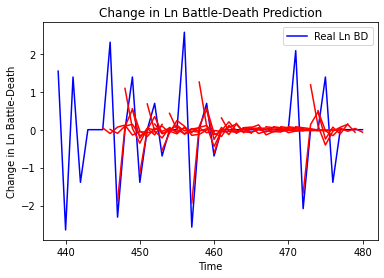

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Angola', 'country_id': 165, 'step': 't+1', 'mse': 0.7519164827991051, 'mae': 0.547803768323068, 'r2': 0.40910786795229925, 'tadda_score': 0.547803768323068}
{'country': 'Angola', 'country_id': 165, 'step': 't+2', 'mse': 2.448284019536828, 'mae': 1.0841648641290307, 'r2': -0.9239793211833989, 'tadda_score': 1.2571710234445375}
{'country': 'Angola', 'country_id': 165, 'step': 't+3', 'mse': 1.2314368831913827, 'mae': 0.8202343933954644, 'r2': -0.4039543914894945, 'tadda_score': 0.8559993415499536}
{'country': 'Angola', 'country_id': 165, 'step': 't+4', 'mse': 1.0936256355598817, 'mae': 0.8079957541057794, 'r2': -0.01886593809650816, 'tadda_score': 0.8219030565251241}
{'country': 'Angola', 'country_id': 165, 'step': 't+5', 'mse': 1.3175630051483276, 'mae': 0.8093498662149621, 'r2': -0.3456917568057434, 'tadda_score': 0.8442954798574956}
{'country': 'Angola', 'country_id': 165, 'step': 't+6', 'mse': 1.595080505952124

Epoch 60/100
61/61 [==============================] - 0s 4ms/step - loss: 1.8493 - val_loss: 0.2226
Epoch 61/100
61/61 [==============================] - 0s 4ms/step - loss: 1.8698 - val_loss: 0.2216
Epoch 62/100
61/61 [==============================] - 0s 4ms/step - loss: 1.8726 - val_loss: 0.2209
Epoch 63/100
61/61 [==============================] - 0s 4ms/step - loss: 1.8660 - val_loss: 0.2232
Epoch 64/100
61/61 [==============================] - 0s 4ms/step - loss: 1.8645 - val_loss: 0.2280
Epoch 65/100
61/61 [==============================] - 0s 4ms/step - loss: 1.8694 - val_loss: 0.2245
Epoch 66/100
61/61 [==============================] - 0s 4ms/step - loss: 1.8644 - val_loss: 0.2255
Epoch 67/100
61/61 [==============================] - 0s 4ms/step - loss: 1.8485 - val_loss: 0.2230
Epoch 68/100
61/61 [==============================] - 0s 4ms/step - loss: 1.8521 - val_loss: 0.2213
Epoch 69/100
61/61 [==============================] - 0s 4ms/step - loss: 1.8415 - val_loss: 0.2216


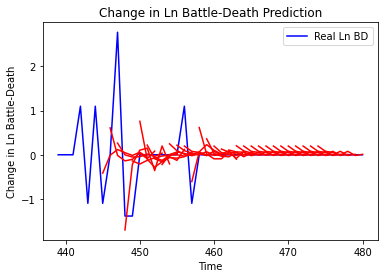

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo', 'country_id': 166, 'step': 't+1', 'mse': 0.38892330933341984, 'mae': 0.4091811376291484, 'r2': 0.22789207781166376, 'tadda_score': 0.4091811376291484}
{'country': 'Congo', 'country_id': 166, 'step': 't+2', 'mse': 1.1914844783518779, 'mae': 0.6970016437138322, 'r2': -0.5678296662117575, 'tadda_score': 0.8236379104222062}
{'country': 'Congo', 'country_id': 166, 'step': 't+3', 'mse': 1.0008410636892906, 'mae': 0.6535566758633077, 'r2': -0.6874753634744222, 'tadda_score': 0.7383482060353378}
{'country': 'Congo', 'country_id': 166, 'step': 't+4', 'mse': 0.8768017247547938, 'mae': 0.6423008296907364, 'r2': -0.2622517673352083, 'tadda_score': 0.7176419450859645}
{'country': 'Congo', 'country_id': 166, 'step': 't+5', 'mse': 0.869819928068671, 'mae': 0.6151745964110312, 'r2': -0.4665662236763022, 'tadda_score': 0.682898877960485}
{'country': 'Congo', 'country_id': 166, 'step': 't+6', 'mse': 0.8771787674200371, 'm

Epoch 60/100
61/61 [==============================] - 0s 3ms/step - loss: 2.9233 - val_loss: 3.3293
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 2.9061 - val_loss: 3.3337
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 2.9164 - val_loss: 3.3411
Epoch 63/100
61/61 [==============================] - 0s 4ms/step - loss: 2.9523 - val_loss: 3.3370
Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 2.9332 - val_loss: 3.3369
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 2.9350 - val_loss: 3.3374
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 2.9317 - val_loss: 3.3426
Epoch 67/100
61/61 [==============================] - 0s 3ms/step - loss: 2.9375 - val_loss: 3.3376
Epoch 68/100
61/61 [==============================] - 0s 3ms/step - loss: 2.9191 - val_loss: 3.3375
Epoch 69/100
61/61 [==============================] - 0s 4ms/step - loss: 2.9338 - val_loss: 3.3361


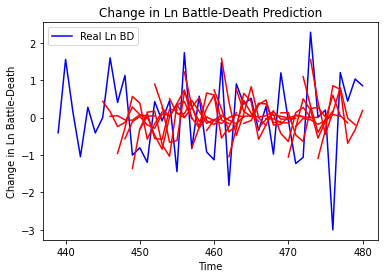

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+1', 'mse': 0.9553282591920416, 'mae': 0.7930537202837397, 'r2': 0.12714016957579777, 'tadda_score': 0.9700617419066359}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+2', 'mse': 3.1798081892338526, 'mae': 1.4453962388333266, 'r2': -1.2489241550253718, 'tadda_score': 1.9002295022404778}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+3', 'mse': 2.6818378605137516, 'mae': 1.3408255905317021, 'r2': -0.5547463909617745, 'tadda_score': 1.7452724186486757}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+4', 'mse': 3.393567376110604, 'mae': 1.5369223902063565, 'r2': -0.9478872353377548, 'tadda_score': 2.0597742092546816}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+5', 'mse': 4.332507707164372, 'mae': 1.632895218905171, 'r2': -1.3601032827355555, 'tadda_score': 2.2544615520302065}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+6', '

61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
61/61 [=====================

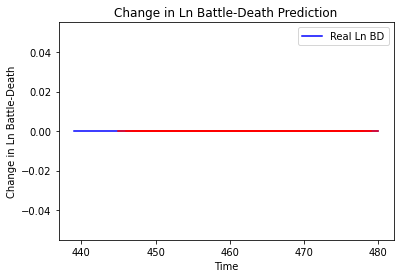

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Gabon', 'country_id': 169, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Namibia']
Building vanilla Model...
Model: "sequential_474"
_________________________________________________________________
Layer (type)                 Output Shap

Epoch 62/100
61/61 [==============================] - 0s 7ms/step - loss: 0.1386 - val_loss: 1.0716e-05
Epoch 63/100
61/61 [==============================] - 0s 6ms/step - loss: 0.1381 - val_loss: 9.3175e-05
Epoch 64/100
61/61 [==============================] - 0s 6ms/step - loss: 0.1381 - val_loss: 8.6097e-05
Epoch 65/100
61/61 [==============================] - 0s 7ms/step - loss: 0.1377 - val_loss: 4.6922e-05
Epoch 66/100
61/61 [==============================] - 0s 7ms/step - loss: 0.1388 - val_loss: 2.2251e-04
Epoch 67/100
61/61 [==============================] - 0s 7ms/step - loss: 0.1399 - val_loss: 1.2996e-04
Epoch 68/100
61/61 [==============================] - 0s 7ms/step - loss: 0.1399 - val_loss: 2.1617e-05
Epoch 69/100
61/61 [==============================] - 0s 6ms/step - loss: 0.1363 - val_loss: 2.7208e-04
Epoch 70/100
61/61 [==============================] - 0s 6ms/step - loss: 0.1369 - val_loss: 1.2238e-04
Epoch 71/100
61/61 [==============================] - 0s 6ms/ste

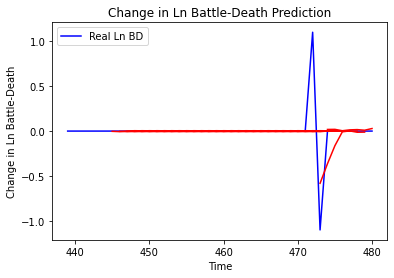

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Namibia', 'country_id': 170, 'step': 't+1', 'mse': 0.049413118814964824, 'mae': 0.05716845829060368, 'r2': 0.38589219073070047, 'tadda_score': 0.057263720707862995}
{'country': 'Namibia', 'country_id': 170, 'step': 't+2', 'mse': 0.11361963162964756, 'mae': 0.11440334970152073, 'r2': -0.41206838878861274, 'tadda_score': 0.11595471813053582}
{'country': 'Namibia', 'country_id': 170, 'step': 't+3', 'mse': 0.08168376984762442, 'mae': 0.0828875448152209, 'r2': -1.1003485891305083, 'tadda_score': 0.0831753956993207}
{'country': 'Namibia', 'country_id': 170, 'step': 't+4', 'mse': 0.08197030428579268, 'mae': 0.07966065502114938, 'r2': -1.1077162976002164, 'tadda_score': 0.07980734717421578}
{'country': 'Namibia', 'country_id': 170, 'step': 't+5', 'mse': 0.05868728508364645, 'mae': 0.06749249276715365, 'r2': -0.5090360870375721, 'tadda_score': 0.06749249276715365}
{'country': 'Namibia', 'country_id': 170, 'step': 't+6', 

61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
61/61 [=====================

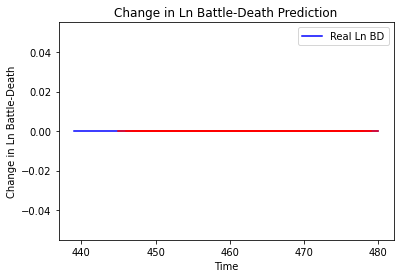

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Madagascar', 'country_id': 172, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mauritius']
Building vanilla Model...
Model: "sequential_476"
_________________________________________________________________
Lay

61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
61/61 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
61/61 [=====================

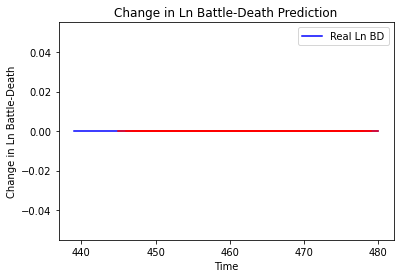

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritius', 'country_id': 173, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Seychelles']
Building vanilla Model...
Model: "sequential_477"
_________________________________________________________________
Layer (ty

61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
61/61 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
61/61 [=====================

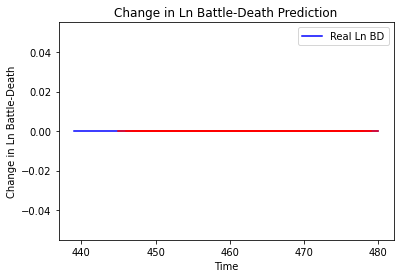

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Seychelles', 'country_id': 174, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Libya']
Building vanilla Model...
Model: "sequential_478"
_________________________________________________________________
Layer (

Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0315 - val_loss: 2.3072
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0315 - val_loss: 2.3070
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0315 - val_loss: 2.3070
Epoch 67/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0315 - val_loss: 2.3068
Epoch 68/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0315 - val_loss: 2.3065
Epoch 69/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0315 - val_loss: 2.3067
Epoch 70/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0314 - val_loss: 2.3067
Epoch 71/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0314 - val_loss: 2.3066
Epoch 72/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0314 - val_loss: 2.3065
Epoch 73/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0315 - val_loss: 2.3066


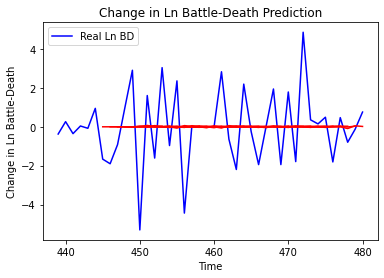

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Libya', 'country_id': 213, 'step': 't+1', 'mse': 4.845906951516812, 'mae': 1.6886359088759613, 'r2': -5.5960133676258295e-05, 'tadda_score': 1.6886359144841097}
{'country': 'Libya', 'country_id': 213, 'step': 't+2', 'mse': 5.417268381322645, 'mae': 1.7837059121372056, 'r2': -7.273701358778695e-06, 'tadda_score': 1.7837059185119502}
{'country': 'Libya', 'country_id': 213, 'step': 't+3', 'mse': 7.422652624069449, 'mae': 2.1080548482574826, 'r2': -1.5131285360237001e-05, 'tadda_score': 2.1080548548720146}
{'country': 'Libya', 'country_id': 213, 'step': 't+4', 'mse': 5.817738877361332, 'mae': 1.975104284506606, 'r2': -0.00534019273442099, 'tadda_score': 1.9751042918087793}
{'country': 'Libya', 'country_id': 213, 'step': 't+5', 'mse': 7.403814917323072, 'mae': 2.281017611121104, 'r2': -0.01754152316899993, 'tadda_score': 2.2947483141359846}
{'country': 'Libya', 'country_id': 213, 'step': 't+6', 'mse': 6.2677988908636

Epoch 60/100
61/61 [==============================] - 0s 6ms/step - loss: 4.9372 - val_loss: 0.8587
Epoch 61/100
61/61 [==============================] - 0s 5ms/step - loss: 4.9329 - val_loss: 0.8565
Epoch 62/100
61/61 [==============================] - 0s 5ms/step - loss: 4.9447 - val_loss: 0.8647
Epoch 63/100
61/61 [==============================] - 0s 5ms/step - loss: 4.9736 - val_loss: 0.8620
Epoch 64/100
61/61 [==============================] - 0s 7ms/step - loss: 4.9759 - val_loss: 0.8616
Epoch 65/100
61/61 [==============================] - 0s 7ms/step - loss: 4.9221 - val_loss: 0.8638
Epoch 66/100
61/61 [==============================] - 0s 5ms/step - loss: 4.9890 - val_loss: 0.8603
Epoch 67/100
61/61 [==============================] - 0s 8ms/step - loss: 4.9665 - val_loss: 0.8623
Epoch 68/100
61/61 [==============================] - 0s 6ms/step - loss: 4.9195 - val_loss: 0.8574
Epoch 69/100
61/61 [==============================] - 0s 7ms/step - loss: 4.9462 - val_loss: 0.8565


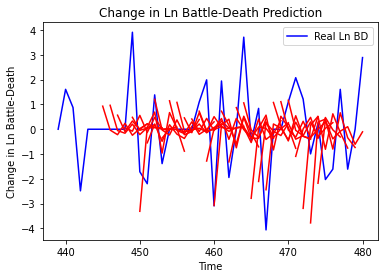

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Chad', 'country_id': 214, 'step': 't+1', 'mse': 3.5238404202339404, 'mae': 1.4818738090975396, 'r2': -0.2004490051992267, 'tadda_score': 1.8103094844006808}
{'country': 'Chad', 'country_id': 214, 'step': 't+2', 'mse': 8.481572329645312, 'mae': 2.2522343124612916, 'r2': -0.9981319687376564, 'tadda_score': 2.9851901973947634}
{'country': 'Chad', 'country_id': 214, 'step': 't+3', 'mse': 9.71288052268904, 'mae': 2.450933843207363, 'r2': -0.8597493227709274, 'tadda_score': 3.092744298132265}
{'country': 'Chad', 'country_id': 214, 'step': 't+4', 'mse': 13.967846398907268, 'mae': 3.0989860482780314, 'r2': -1.2905874569479185, 'tadda_score': 4.023885284639217}
{'country': 'Chad', 'country_id': 214, 'step': 't+5', 'mse': 11.96139347699621, 'mae': 2.792326087461995, 'r2': -1.5177320373733747, 'tadda_score': 3.598057663149721}
{'country': 'Chad', 'country_id': 214, 'step': 't+6', 'mse': 10.457446483629933, 'mae': 2.5326600

61/61 [==============================] - 0s 4ms/step - loss: 0.5713 - val_loss: 2.1150
Epoch 61/100
61/61 [==============================] - 0s 4ms/step - loss: 0.5785 - val_loss: 2.1170
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 0.5690 - val_loss: 2.1118
Epoch 63/100
61/61 [==============================] - 0s 3ms/step - loss: 0.5778 - val_loss: 2.1101
Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 0.5743 - val_loss: 2.1133
Epoch 65/100
61/61 [==============================] - 0s 6ms/step - loss: 0.5678 - val_loss: 2.1164
Epoch 66/100
61/61 [==============================] - 0s 5ms/step - loss: 0.5722 - val_loss: 2.1136
Epoch 67/100
61/61 [==============================] - 0s 5ms/step - loss: 0.5676 - val_loss: 2.1142
Epoch 68/100
61/61 [==============================] - 0s 6ms/step - loss: 0.5630 - val_loss: 2.1066
Epoch 69/100
61/61 [==============================] - 0s 4ms/step - loss: 0.5772 - val_loss: 2.1104
Epoch 70/100


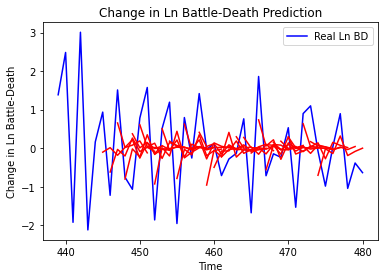

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Egypt', 'country_id': 222, 'step': 't+1', 'mse': 0.6914403342174867, 'mae': 0.6890605834112817, 'r2': 0.3865014263636325, 'tadda_score': 0.7442192686832204}
{'country': 'Egypt', 'country_id': 222, 'step': 't+2', 'mse': 1.5525398105944506, 'mae': 1.0576032744370603, 'r2': -0.435602069398461, 'tadda_score': 1.2916511388766472}
{'country': 'Egypt', 'country_id': 222, 'step': 't+3', 'mse': 1.39094581512733, 'mae': 0.9619008705178719, 'r2': -0.4997950634400652, 'tadda_score': 1.1884209641724646}
{'country': 'Egypt', 'country_id': 222, 'step': 't+4', 'mse': 1.3120078143052802, 'mae': 0.9464642913014402, 'r2': -0.06513476864275636, 'tadda_score': 1.110679200440219}
{'country': 'Egypt', 'country_id': 222, 'step': 't+5', 'mse': 1.6102673147679238, 'mae': 1.0853925939665738, 'r2': -0.35731955456464815, 'tadda_score': 1.358920214730402}
{'country': 'Egypt', 'country_id': 222, 'step': 't+6', 'mse': 1.3510468363055057, 'mae'

61/61 [==============================] - 0s 3ms/step - loss: 2.6274 - val_loss: 0.0018
Epoch 60/100
61/61 [==============================] - 0s 3ms/step - loss: 2.6659 - val_loss: 0.0019
Epoch 61/100
61/61 [==============================] - 0s 4ms/step - loss: 2.6491 - val_loss: 0.0017
Epoch 62/100
61/61 [==============================] - 0s 5ms/step - loss: 2.6333 - val_loss: 0.0019
Epoch 63/100
61/61 [==============================] - 0s 4ms/step - loss: 2.6142 - val_loss: 0.0034
Epoch 64/100
61/61 [==============================] - 0s 5ms/step - loss: 2.6666 - val_loss: 0.0041
Epoch 65/100
61/61 [==============================] - 0s 4ms/step - loss: 2.6261 - val_loss: 0.0033
Epoch 66/100
61/61 [==============================] - 0s 4ms/step - loss: 2.6334 - val_loss: 0.0029
Epoch 67/100
61/61 [==============================] - 0s 5ms/step - loss: 2.6506 - val_loss: 0.0011
Epoch 68/100
61/61 [==============================] - 0s 5ms/step - loss: 2.6251 - val_loss: 0.0018
Epoch 69/100


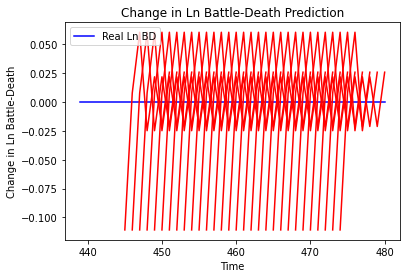

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Uganda', 'country_id': 235, 'step': 't+1', 'mse': 0.012304225907507294, 'mae': 0.11092441529035568, 'r2': 0.0, 'tadda_score': 0.11092441529035568}
{'country': 'Uganda', 'country_id': 235, 'step': 't+2', 'mse': 0.01062846892613406, 'mae': 0.10309446603059769, 'r2': 0.0, 'tadda_score': 0.10309446603059769}
{'country': 'Uganda', 'country_id': 235, 'step': 't+3', 'mse': 0.0018096508715781945, 'mae': 0.042539991438388824, 'r2': 0.0, 'tadda_score': 0.042539991438388824}
{'country': 'Uganda', 'country_id': 235, 'step': 't+4', 'mse': 0.004541057939477788, 'mae': 0.06738737225532532, 'r2': 0.0, 'tadda_score': 0.06738737225532532}
{'country': 'Uganda', 'country_id': 235, 'step': 't+5', 'mse': 0.0028433650458192933, 'mae': 0.05332321301102638, 'r2': 0.0, 'tadda_score': 0.05332321301102638}
{'country': 'Uganda', 'country_id': 235, 'step': 't+6', 'mse': 0.005552111037843643, 'mae': 0.07451248914003372, 'r2': 0.0, 'tadda_scor

61/61 [==============================] - 0s 4ms/step - loss: 0.1140 - val_loss: 1.6606
Epoch 61/100
61/61 [==============================] - 0s 4ms/step - loss: 0.1144 - val_loss: 1.6563
Epoch 62/100
61/61 [==============================] - 0s 5ms/step - loss: 0.1141 - val_loss: 1.6575
Epoch 63/100
61/61 [==============================] - 0s 5ms/step - loss: 0.1147 - val_loss: 1.6565
Epoch 64/100
61/61 [==============================] - 0s 4ms/step - loss: 0.1143 - val_loss: 1.6576
Epoch 65/100
61/61 [==============================] - 0s 4ms/step - loss: 0.1148 - val_loss: 1.6659
Epoch 66/100
61/61 [==============================] - 0s 4ms/step - loss: 0.1144 - val_loss: 1.6644
Epoch 67/100
61/61 [==============================] - 0s 4ms/step - loss: 0.1145 - val_loss: 1.6608
Epoch 68/100
61/61 [==============================] - 0s 6ms/step - loss: 0.1148 - val_loss: 1.6663
Epoch 69/100
61/61 [==============================] - 0s 7ms/step - loss: 0.1140 - val_loss: 1.6639
Epoch 70/100


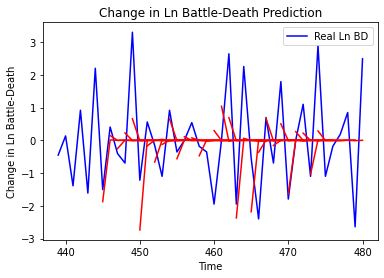

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Kenya', 'country_id': 237, 'step': 't+1', 'mse': 1.463443529341388, 'mae': 0.9024277635131411, 'r2': 0.2937486122224988, 'tadda_score': 0.925431567700121}
{'country': 'Kenya', 'country_id': 237, 'step': 't+2', 'mse': 3.662312994523231, 'mae': 1.5490560893910603, 'r2': -0.9185457342884757, 'tadda_score': 2.0186742558774826}
{'country': 'Kenya', 'country_id': 237, 'step': 't+3', 'mse': 3.286627105595476, 'mae': 1.4051897033281373, 'r2': -0.5051540975642859, 'tadda_score': 1.6969837312129388}
{'country': 'Kenya', 'country_id': 237, 'step': 't+4', 'mse': 4.04289853324085, 'mae': 1.64984539208524, 'r2': -0.43962005519071057, 'tadda_score': 1.9312132607669887}
{'country': 'Kenya', 'country_id': 237, 'step': 't+5', 'mse': 2.7957309378931368, 'mae': 1.2275957854619342, 'r2': -0.8458207259416051, 'tadda_score': 1.548649678581031}
{'country': 'Kenya', 'country_id': 237, 'step': 't+6', 'mse': 2.604846619732112, 'mae': 1.28

47/47 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
47/47 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
47/47 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
47/47 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
47/47 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
47/47 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
47/47 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
47/47 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
47/47 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
47/47 [=====================

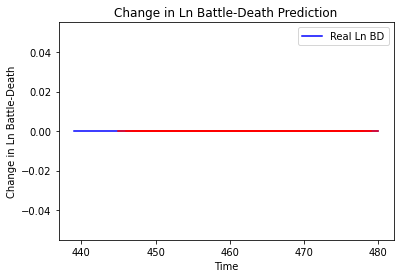

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tanzania', 'country_id': 242, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Morocco']
Building vanilla Model...
Model: "sequential_484"
_________________________________________________________________
Layer (type)       

61/61 [==============================] - 0s 3ms/step - loss: 0.0687 - val_loss: 8.6101e-05
Epoch 62/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0687 - val_loss: 7.1526e-06
Epoch 63/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0691 - val_loss: 6.9120e-06
Epoch 64/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0687 - val_loss: 1.7943e-06
Epoch 65/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0687 - val_loss: 2.0055e-04
Epoch 66/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0687 - val_loss: 1.1423e-05
Epoch 67/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0687 - val_loss: 5.5229e-06
Epoch 68/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0697 - val_loss: 7.9120e-06
Epoch 69/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0686 - val_loss: 1.0118e-05
Epoch 70/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0

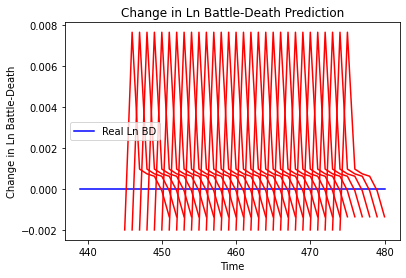

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Morocco', 'country_id': 243, 'step': 't+1', 'mse': 3.907418503510535e-06, 'mae': 0.0019767191261053085, 'r2': 0.0, 'tadda_score': 0.0019767191261053085}
{'country': 'Morocco', 'country_id': 243, 'step': 't+2', 'mse': 3.240948335016258e-05, 'mae': 0.00569293275475502, 'r2': 0.0, 'tadda_score': 0.00569293275475502}
{'country': 'Morocco', 'country_id': 243, 'step': 't+3', 'mse': 4.468819657033941e-05, 'mae': 0.006684923078864813, 'r2': 0.0, 'tadda_score': 0.006684923078864813}
{'country': 'Morocco', 'country_id': 243, 'step': 't+4', 'mse': 5.5423492123647146e-05, 'mae': 0.007444695569574833, 'r2': 0.0, 'tadda_score': 0.007444695569574833}
{'country': 'Morocco', 'country_id': 243, 'step': 't+5', 'mse': 1.7390514409056578e-07, 'mae': 0.00041701935697346926, 'r2': 0.0, 'tadda_score': 0.00041701935697346926}
{'country': 'Morocco', 'country_id': 243, 'step': 't+6', 'mse': 1.256623831458031e-07, 'mae': 0.0003544889041222

61/61 [==============================] - 0s 3ms/step - loss: 0.0623 - val_loss: 0.1151
Epoch 61/100
61/61 [==============================] - 0s 3ms/step - loss: 0.0631 - val_loss: 0.1150
Epoch 62/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0629 - val_loss: 0.1151
Epoch 63/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0630 - val_loss: 0.1154
Epoch 64/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0636 - val_loss: 0.1154
Epoch 65/100
61/61 [==============================] - 0s 5ms/step - loss: 0.0638 - val_loss: 0.1152
Epoch 66/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0622 - val_loss: 0.1159
Epoch 67/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0644 - val_loss: 0.1162
Epoch 68/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0647 - val_loss: 0.1166
Epoch 69/100
61/61 [==============================] - 0s 4ms/step - loss: 0.0628 - val_loss: 0.1167
Epoch 70/100


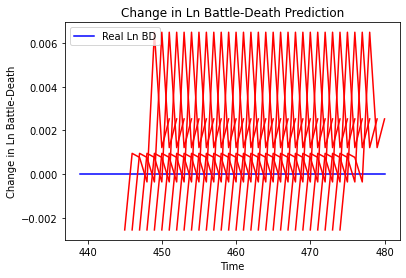

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritania', 'country_id': 244, 'step': 't+1', 'mse': 6.488696730925364e-06, 'mae': 0.002547292038798332, 'r2': 0.0, 'tadda_score': 0.002547292038798332}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+2', 'mse': 2.542014948729446e-06, 'mae': 0.0015943697653710842, 'r2': 0.0, 'tadda_score': 0.0015943697653710842}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+3', 'mse': 6.837049068572978e-07, 'mae': 0.0008268645033240318, 'r2': 0.0, 'tadda_score': 0.0008268645033240318}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+4', 'mse': 1.3944902326236408e-06, 'mae': 0.0011808853596448898, 'r2': 0.0, 'tadda_score': 0.0011808853596448898}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+5', 'mse': 1.896271435787079e-05, 'mae': 0.004354619886726141, 'r2': 0.0, 'tadda_score': 0.004354619886726141}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+6', 'mse': 3.1024703294892965e-05, 'mae'

Epoch 60/100
10/10 [==============================] - 0s 11ms/step - loss: 3.0884 - val_loss: 0.9617
Epoch 61/100
10/10 [==============================] - 0s 11ms/step - loss: 3.0963 - val_loss: 0.9636
Epoch 62/100
10/10 [==============================] - 0s 13ms/step - loss: 3.0301 - val_loss: 0.9670
Epoch 63/100
10/10 [==============================] - 0s 11ms/step - loss: 3.0390 - val_loss: 0.9688
Epoch 64/100
10/10 [==============================] - 0s 12ms/step - loss: 3.0610 - val_loss: 0.9718
Epoch 65/100
10/10 [==============================] - 0s 14ms/step - loss: 2.9997 - val_loss: 0.9745
Epoch 66/100
10/10 [==============================] - 0s 9ms/step - loss: 3.0840 - val_loss: 0.9770
Epoch 67/100
10/10 [==============================] - 0s 10ms/step - loss: 3.0577 - val_loss: 0.9798
Epoch 68/100
10/10 [==============================] - 0s 10ms/step - loss: 3.0540 - val_loss: 0.9814
Epoch 69/100
10/10 [==============================] - 0s 10ms/step - loss: 3.0888 - val_loss

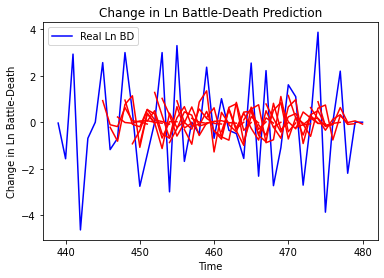

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sudan', 'country_id': 245, 'step': 't+1', 'mse': 2.743538369472881, 'mae': 1.4661329662892748, 'r2': 0.31434585167902374, 'tadda_score': 1.5571385778331288}
{'country': 'Sudan', 'country_id': 245, 'step': 't+2', 'mse': 5.434095865004292, 'mae': 1.9441504535062464, 'r2': -0.27359077270066234, 'tadda_score': 2.3540675835791585}
{'country': 'Sudan', 'country_id': 245, 'step': 't+3', 'mse': 4.240389154452499, 'mae': 1.6874867883715006, 'r2': -0.09343220219060333, 'tadda_score': 1.8624916014465662}
{'country': 'Sudan', 'country_id': 245, 'step': 't+4', 'mse': 4.092917836895396, 'mae': 1.569398139227239, 'r2': -0.23277285778937085, 'tadda_score': 1.8872443838008321}
{'country': 'Sudan', 'country_id': 245, 'step': 't+5', 'mse': 5.9551094554823605, 'mae': 2.0879352300310314, 'r2': -0.13586435073221348, 'tadda_score': 2.460616983368415}
{'country': 'Sudan', 'country_id': 245, 'step': 't+6', 'mse': 6.18823092732797, 'mae'

10/10 [==============================] - 0s 8ms/step - loss: 6.2814 - val_loss: 3.9844
Epoch 60/100
10/10 [==============================] - 0s 7ms/step - loss: 6.2399 - val_loss: 3.9836
Epoch 61/100
10/10 [==============================] - 0s 13ms/step - loss: 6.1565 - val_loss: 3.9855
Epoch 62/100
10/10 [==============================] - 0s 9ms/step - loss: 6.1823 - val_loss: 3.9873
Epoch 63/100
10/10 [==============================] - 0s 8ms/step - loss: 6.1342 - val_loss: 3.9804
Epoch 64/100
10/10 [==============================] - 0s 10ms/step - loss: 6.1542 - val_loss: 3.9799
Epoch 65/100
10/10 [==============================] - 0s 9ms/step - loss: 6.1761 - val_loss: 3.9778
Epoch 66/100
10/10 [==============================] - 0s 10ms/step - loss: 6.1806 - val_loss: 3.9761
Epoch 67/100
10/10 [==============================] - 0s 9ms/step - loss: 6.0500 - val_loss: 3.9747
Epoch 68/100
10/10 [==============================] - 0s 7ms/step - loss: 6.1890 - val_loss: 3.9734
Epoch 69/1

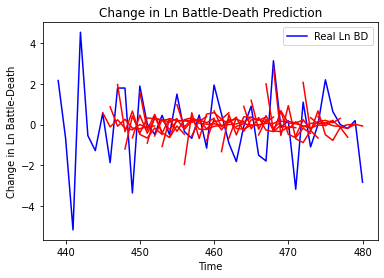

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Sudan', 'country_id': 246, 'step': 't+1', 'mse': 2.191817099989461, 'mae': 1.0905867530860633, 'r2': 0.014737350930761561, 'tadda_score': 1.407860595381074}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+2', 'mse': 4.34742123567653, 'mae': 1.563305921904185, 'r2': -0.6087329395415666, 'tadda_score': 1.9729739423115438}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+3', 'mse': 5.597062898887311, 'mae': 1.9528203075144974, 'r2': -1.140715629870615, 'tadda_score': 2.617007246614922}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+4', 'mse': 5.308877526962383, 'mae': 1.8997540316577262, 'r2': -0.684178073354218, 'tadda_score': 2.4086299947495764}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+5', 'mse': 4.0627460725267035, 'mae': 1.5465255208330886, 'r2': -0.610677995501925, 'tadda_score': 1.9254907347279326}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+6', 'm

In [37]:
np.random.seed(1)
tf.random.set_seed(1)
model = Sequential()
summary_model(dataset=df,
              modelname = "Vanilla",
              pred_africa=True,
              period=period_test, 
              epochs=100, 
              batch_size=4, 
              look_back=6, 
              look_forward=7,
              num_neurons=6, 
              val_split=0.2)

# Adjust Batch Size

['Cape Verde']
Building vanilla Model...
Model: "sequential_489"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_478 (LSTM)              (None, 6)                 192       
_________________________________________________________________
dropout_956 (Dropout)        (None, 6)                 0         
_________________________________________________________________
dense_956 (Dense)            (None, 6)                 42        
_________________________________________________________________
dropout_957 (Dropout)        (None, 6)                 0         
_________________________________________________________________
dense_957 (Dense)            (None, 7)                 49        
Total params: 283
Trainable params: 283
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
41/41 [==============================] - 1s 17ms/step - loss: 0.000

41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 70/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 71/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 72/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 73/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 74/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 75/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 76/100
41/41 [=====================

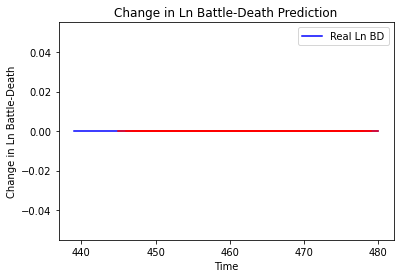

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
["Cote d'Ivoire"]
Building vanilla Model...
Model: "sequential_490"
_________________________________________________________________
Layer 

Epoch 64/100
41/41 [==============================] - 0s 7ms/step - loss: 0.5409 - val_loss: 0.2855
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5435 - val_loss: 0.2862
Epoch 66/100
41/41 [==============================] - 0s 6ms/step - loss: 0.5480 - val_loss: 0.2869
Epoch 67/100
41/41 [==============================] - 0s 7ms/step - loss: 0.5372 - val_loss: 0.2865
Epoch 68/100
41/41 [==============================] - 0s 6ms/step - loss: 0.5383 - val_loss: 0.2872
Epoch 69/100
41/41 [==============================] - 0s 6ms/step - loss: 0.5424 - val_loss: 0.2874
Epoch 70/100
41/41 [==============================] - 0s 6ms/step - loss: 0.5315 - val_loss: 0.2875
Epoch 71/100
41/41 [==============================] - 0s 7ms/step - loss: 0.5368 - val_loss: 0.2879
Epoch 72/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5342 - val_loss: 0.2878
Epoch 73/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5318 - val_loss: 0.2887


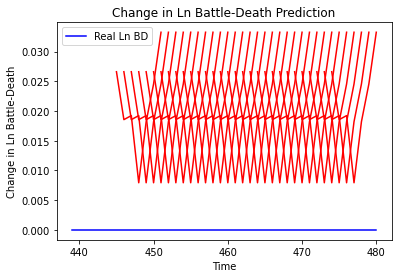

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+1', 'mse': 0.0007081920296804801, 'mae': 0.026611877605319023, 'r2': 0.0, 'tadda_score': 0.026611877605319023}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+2', 'mse': 0.0020397145715114195, 'mae': 0.04516319930553436, 'r2': 0.0, 'tadda_score': 0.04516319930553436}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+3', 'mse': 0.004146235688257116, 'mae': 0.06439127027988434, 'r2': 0.0, 'tadda_score': 0.06439127027988434}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+4', 'mse': 0.0052307168331646725, 'mae': 0.07232369482517242, 'r2': 0.0, 'tadda_score': 0.07232369482517242}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+5', 'mse': 0.0051805175585395435, 'mae': 0.07197581231594086, 'r2': 0.0, 'tadda_score': 0.07197581231594086}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+6', 'mse': 0.009316114561519706, 'mae': 0.09

Epoch 56/100
41/41 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
41/41 [========

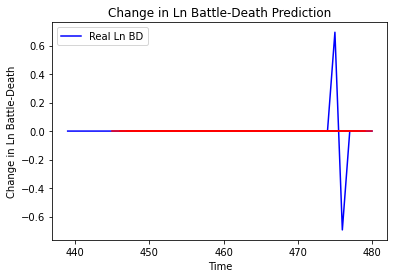

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ghana', 'country_id': 42, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Liberia']
Building vanilla Model...
Model: "sequential_492"
_________________________________________________________________
Layer (type)                 Output Shape      

Epoch 62/100
41/41 [==============================] - 0s 4ms/step - loss: 1.1832 - val_loss: 1.8372e-04
Epoch 63/100
41/41 [==============================] - 0s 4ms/step - loss: 1.1860 - val_loss: 1.7120e-04
Epoch 64/100
41/41 [==============================] - 0s 4ms/step - loss: 1.1902 - val_loss: 3.7811e-04
Epoch 65/100
41/41 [==============================] - 0s 4ms/step - loss: 1.1970 - val_loss: 7.5021e-04
Epoch 66/100
41/41 [==============================] - 0s 4ms/step - loss: 1.1751 - val_loss: 1.0473e-04
Epoch 67/100
41/41 [==============================] - 0s 4ms/step - loss: 1.1924 - val_loss: 2.2951e-04
Epoch 68/100
41/41 [==============================] - 0s 5ms/step - loss: 1.1764 - val_loss: 4.1269e-04
Epoch 69/100
41/41 [==============================] - 0s 5ms/step - loss: 1.1849 - val_loss: 3.0448e-04
Epoch 70/100
41/41 [==============================] - 0s 5ms/step - loss: 1.1693 - val_loss: 2.3333e-04
Epoch 71/100
41/41 [==============================] - 0s 5ms/ste

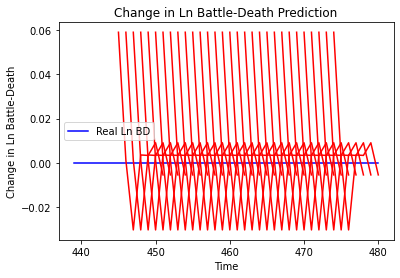

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Liberia', 'country_id': 43, 'step': 't+1', 'mse': 0.0034712077262577523, 'mae': 0.058916956186294556, 'r2': 0.0, 'tadda_score': 0.058916956186294556}
{'country': 'Liberia', 'country_id': 43, 'step': 't+2', 'mse': 0.003608821657769004, 'mae': 0.06007346883416176, 'r2': 0.0, 'tadda_score': 0.06007346883416176}
{'country': 'Liberia', 'country_id': 43, 'step': 't+3', 'mse': 0.0008897618587520029, 'mae': 0.02982887625694275, 'r2': 0.0, 'tadda_score': 0.02982887625694275}
{'country': 'Liberia', 'country_id': 43, 'step': 't+4', 'mse': 0.0011149055647723949, 'mae': 0.03339020162820816, 'r2': 0.0, 'tadda_score': 0.03339020162820816}
{'country': 'Liberia', 'country_id': 43, 'step': 't+5', 'mse': 0.0012668920966941166, 'mae': 0.0355934277176857, 'r2': 0.0, 'tadda_score': 0.0355934277176857}
{'country': 'Liberia', 'country_id': 43, 'step': 't+6', 'mse': 0.001994113844805412, 'mae': 0.04465550184249878, 'r2': 0.0, 'tadda_sco

41/41 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
41/41 [==============================] - 0s 11ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
41/41 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
41/41 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
41/41 [====================

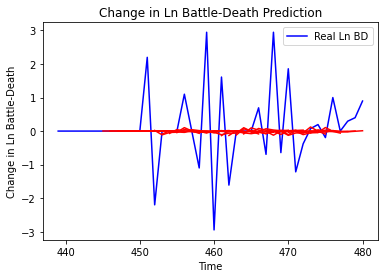

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+1', 'mse': 1.6742776543631133, 'mae': 0.8335248412330749, 'r2': -0.015278527382594831, 'tadda_score': 0.8465746639916477}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+2', 'mse': 1.2153790525381603, 'mae': 0.7374995573037526, 'r2': -0.027045985543387108, 'tadda_score': 0.749499747397866}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+3', 'mse': 2.079107497536221, 'mae': 0.9197378957385883, 'r2': -0.042883405759973625, 'tadda_score': 0.9401895886028871}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+4', 'mse': 2.449831263009633, 'mae': 1.0383192531516663, 'r2': -0.10361105329287468, 'tadda_score': 1.069929188651394}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+5', 'mse': 2.3406549435409576, 'mae': 0.950955364773219, 'r2': -0.12284161414109773, 'tadda_score': 0.968839185729171}
{'country': 'Burkina Faso', 'country_id': 47, 'step

41/41 [==============================] - 0s 4ms/step - loss: 0.2559 - val_loss: 2.5072e-04
Epoch 58/100
41/41 [==============================] - 0s 4ms/step - loss: 0.2500 - val_loss: 1.5432e-04
Epoch 59/100
41/41 [==============================] - 0s 6ms/step - loss: 0.2501 - val_loss: 9.3706e-05
Epoch 60/100
41/41 [==============================] - 0s 4ms/step - loss: 0.2579 - val_loss: 3.5919e-05
Epoch 61/100
41/41 [==============================] - 0s 4ms/step - loss: 0.2516 - val_loss: 1.4052e-04
Epoch 62/100
41/41 [==============================] - 0s 4ms/step - loss: 0.2535 - val_loss: 1.7969e-04
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.2523 - val_loss: 2.6166e-04
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 0.2469 - val_loss: 2.8982e-04
Epoch 65/100
41/41 [==============================] - 0s 4ms/step - loss: 0.2581 - val_loss: 1.8338e-04
Epoch 66/100
41/41 [==============================] - 0s 4ms/step - loss: 0.2

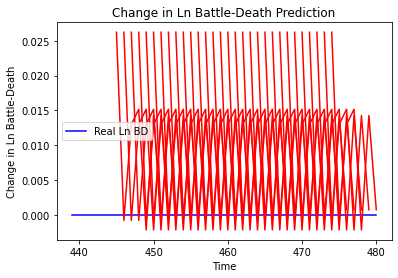

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea', 'country_id': 48, 'step': 't+1', 'mse': 0.0006875293944602102, 'mae': 0.026220781728625298, 'r2': 0.0, 'tadda_score': 0.026220781728625298}
{'country': 'Guinea', 'country_id': 48, 'step': 't+2', 'mse': 0.0006457552963944103, 'mae': 0.025411715731024742, 'r2': 0.0, 'tadda_score': 0.025411715731024742}
{'country': 'Guinea', 'country_id': 48, 'step': 't+3', 'mse': 0.0014732884035331129, 'mae': 0.03838343918323517, 'r2': 0.0, 'tadda_score': 0.03838343918323517}
{'country': 'Guinea', 'country_id': 48, 'step': 't+4', 'mse': 0.0028667281377310477, 'mae': 0.05354183539748192, 'r2': 0.0, 'tadda_score': 0.05354183539748192}
{'country': 'Guinea', 'country_id': 48, 'step': 't+5', 'mse': 0.002722418807871385, 'mae': 0.05217680335044861, 'r2': 0.0, 'tadda_score': 0.05217680335044861}
{'country': 'Guinea', 'country_id': 48, 'step': 't+6', 'mse': 0.004412640346572516, 'mae': 0.06642770767211914, 'r2': 0.0, 'tadda_score

41/41 [==============================] - 0s 5ms/step - loss: 0.5991 - val_loss: 3.8729e-04
Epoch 59/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5765 - val_loss: 3.8584e-04
Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 0.6022 - val_loss: 1.6826e-04
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 0.6211 - val_loss: 0.0016
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 0.6120 - val_loss: 4.6427e-04
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5905 - val_loss: 1.0127e-04
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5581 - val_loss: 1.0408e-04
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5965 - val_loss: 2.7981e-04
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 0.6172 - val_loss: 4.4937e-04
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5868 

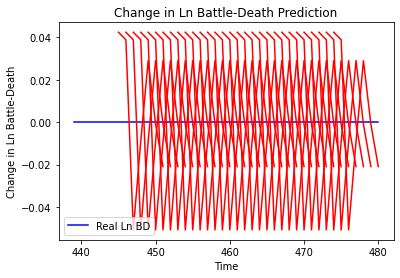

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+1', 'mse': 0.0018021267651558426, 'mae': 0.042451463639736176, 'r2': 0.0, 'tadda_score': 0.042451463639736176}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+2', 'mse': 0.006618168986971762, 'mae': 0.0813521295785904, 'r2': 0.0, 'tadda_score': 0.0813521295785904}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+3', 'mse': 0.0009307276327514963, 'mae': 0.030507829040288925, 'r2': 0.0, 'tadda_score': 0.030507829040288925}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+4', 'mse': 0.00045491609586023607, 'mae': 0.02132876217365265, 'r2': 0.0, 'tadda_score': 0.02132876217365265}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+5', 'mse': 0.0001316328929358429, 'mae': 0.011473137885332108, 'r2': 0.0, 'tadda_score': 0.011473137885332108}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+6', 'mse': 0.00011095082571816253, 'mae':

41/41 [==============================] - 0s 5ms/step - loss: 1.2744 - val_loss: 3.0088
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 1.2819 - val_loss: 3.0097
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 1.2698 - val_loss: 3.0096
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 1.2580 - val_loss: 3.0106
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 1.2609 - val_loss: 3.0122
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 1.2640 - val_loss: 3.0157
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 1.2594 - val_loss: 3.0129
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 1.2805 - val_loss: 3.0131
Epoch 68/100
41/41 [==============================] - 0s 5ms/step - loss: 1.2605 - val_loss: 3.0147
Epoch 69/100
41/41 [==============================] - 0s 5ms/step - loss: 1.2729 - val_loss: 3.0134
Epoch 70/100


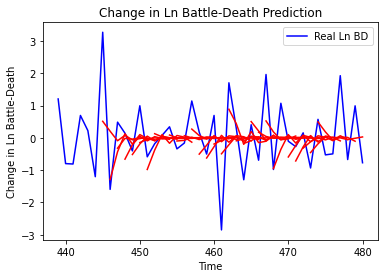

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mali', 'country_id': 50, 'step': 't+1', 'mse': 0.8414304227908791, 'mae': 0.6694368528541418, 'r2': 0.33347570738868737, 'tadda_score': 0.7561733660316956}
{'country': 'Mali', 'country_id': 50, 'step': 't+2', 'mse': 1.7700675584421082, 'mae': 1.0535623836738326, 'r2': -0.8282441978756045, 'tadda_score': 1.4073455929232104}
{'country': 'Mali', 'country_id': 50, 'step': 't+3', 'mse': 1.6015016879676451, 'mae': 1.0647700167577538, 'r2': -0.4106666734786133, 'tadda_score': 1.3888936998949517}
{'country': 'Mali', 'country_id': 50, 'step': 't+4', 'mse': 2.3297648875232553, 'mae': 1.2653893279565958, 'r2': -0.5579164096368434, 'tadda_score': 1.6636301178518522}
{'country': 'Mali', 'country_id': 50, 'step': 't+5', 'mse': 1.836074181921634, 'mae': 1.11404322369248, 'r2': -0.6957022651829625, 'tadda_score': 1.3870145408024424}
{'country': 'Mali', 'country_id': 50, 'step': 't+6', 'mse': 2.094206778974553, 'mae': 1.17996119

41/41 [==============================] - 0s 5ms/step - loss: 1.6244 - val_loss: 0.4302
Epoch 61/100
41/41 [==============================] - 0s 4ms/step - loss: 1.6341 - val_loss: 0.4299
Epoch 62/100
41/41 [==============================] - 0s 4ms/step - loss: 1.6275 - val_loss: 0.4300
Epoch 63/100
41/41 [==============================] - 0s 4ms/step - loss: 1.6369 - val_loss: 0.4302
Epoch 64/100
41/41 [==============================] - 0s 4ms/step - loss: 1.6336 - val_loss: 0.4313
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 1.6346 - val_loss: 0.4310
Epoch 66/100
41/41 [==============================] - 0s 4ms/step - loss: 1.6276 - val_loss: 0.4297
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 1.6317 - val_loss: 0.4308
Epoch 68/100
41/41 [==============================] - 0s 4ms/step - loss: 1.6223 - val_loss: 0.4297
Epoch 69/100
41/41 [==============================] - 0s 5ms/step - loss: 1.6269 - val_loss: 0.4297
Epoch 70/100


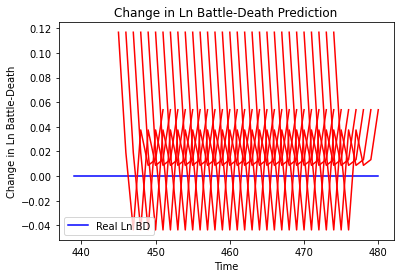

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Senegal', 'country_id': 52, 'step': 't+1', 'mse': 0.013632069576374528, 'mae': 0.11675645411014557, 'r2': 0.0, 'tadda_score': 0.11675645411014557}
{'country': 'Senegal', 'country_id': 52, 'step': 't+2', 'mse': 0.01841886264053816, 'mae': 0.13571611046791077, 'r2': 0.0, 'tadda_score': 0.13571611046791077}
{'country': 'Senegal', 'country_id': 52, 'step': 't+3', 'mse': 0.008464375665541424, 'mae': 0.09200204163789749, 'r2': 0.0, 'tadda_score': 0.09200204163789749}
{'country': 'Senegal', 'country_id': 52, 'step': 't+4', 'mse': 0.016755572484691506, 'mae': 0.12944331765174866, 'r2': 0.0, 'tadda_score': 0.12944331765174866}
{'country': 'Senegal', 'country_id': 52, 'step': 't+5', 'mse': 0.014205854710581944, 'mae': 0.11918831616640091, 'r2': 0.0, 'tadda_score': 0.11918831616640091}
{'country': 'Senegal', 'country_id': 52, 'step': 't+6', 'mse': 0.017563810885228515, 'mae': 0.13252852857112885, 'r2': 0.0, 'tadda_score': 

41/41 [==============================] - 0s 7ms/step - loss: 2.1578 - val_loss: 4.8565e-04
Epoch 59/100
41/41 [==============================] - 0s 6ms/step - loss: 2.1454 - val_loss: 0.0012
Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 2.1713 - val_loss: 5.0378e-04
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 2.1434 - val_loss: 4.5292e-04
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 2.1302 - val_loss: 7.7353e-04
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 2.1519 - val_loss: 4.2720e-04
Epoch 64/100
41/41 [==============================] - 0s 4ms/step - loss: 2.1363 - val_loss: 4.8098e-04
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 2.1557 - val_loss: 4.5477e-04
Epoch 66/100
41/41 [==============================] - 0s 4ms/step - loss: 2.1178 - val_loss: 3.7132e-04
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 2.1426 

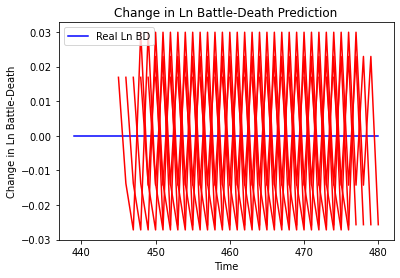

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+1', 'mse': 0.00028548130357421153, 'mae': 0.016896191984415054, 'r2': 0.0, 'tadda_score': 0.016896191984415054}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+2', 'mse': 9.718126075156965e-06, 'mae': 0.0031173909083008766, 'r2': 0.0, 'tadda_score': 0.0031173909083008766}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+3', 'mse': 0.0005809896645312534, 'mae': 0.02410372719168663, 'r2': 0.0, 'tadda_score': 0.02410372719168663}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+4', 'mse': 3.391632497419528e-05, 'mae': 0.0058237724006175995, 'r2': 0.0, 'tadda_score': 0.0058237724006175995}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+5', 'mse': 2.836811176274226e-05, 'mae': 0.005326172336935997, 'r2': 0.0, 'tadda_score': 0.005326172336935997}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+6', 'mse': 0.0007984439055458738, 'mae

41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
41/41 [=====================

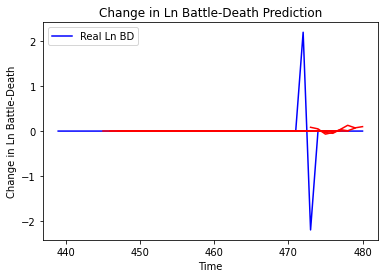

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'The Gambia', 'country_id': 54, 'step': 't+1', 'mse': 0.3344635006101058, 'mae': 0.14996411150983358, 'r2': -0.03918075081110084, 'tadda_score': 0.1527766746410865}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+2', 'mse': 0.3206260668255155, 'mae': 0.15051594397715115, 'r2': 0.00381226577617777, 'tadda_score': 0.15051594397715115}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+3', 'mse': 0.16120023594117155, 'mae': 0.07751101607477359, 'r2': -0.03624223256999781, 'tadda_score': 0.07751101607477359}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+4', 'mse': 0.16098918190446462, 'mae': 0.0752661927729417, 'r2': -0.03488551553473296, 'tadda_score': 0.0752661927729417}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+5', 'mse': 0.16154135505451395, 'mae': 0.07832870462929896, 'r2': -0.0384350459335665, 'tadda_score': 0.07832870462929896}
{'country': 'The Gambia', 'country_id': 54, 'step'

41/41 [==============================] - 0s 7ms/step - loss: 0.6210 - val_loss: 4.8541e-04
Epoch 58/100
41/41 [==============================] - 0s 7ms/step - loss: 0.6221 - val_loss: 7.6698e-04
Epoch 59/100
41/41 [==============================] - 0s 7ms/step - loss: 0.6296 - val_loss: 2.9351e-04
Epoch 60/100
41/41 [==============================] - 0s 7ms/step - loss: 0.6244 - val_loss: 7.4293e-04
Epoch 61/100
41/41 [==============================] - 0s 7ms/step - loss: 0.6196 - val_loss: 7.2310e-04
Epoch 62/100
41/41 [==============================] - 0s 6ms/step - loss: 0.6150 - val_loss: 8.7170e-04
Epoch 63/100
41/41 [==============================] - 0s 6ms/step - loss: 0.6194 - val_loss: 5.2157e-04
Epoch 64/100
41/41 [==============================] - 0s 7ms/step - loss: 0.6223 - val_loss: 5.1216e-04
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 0.6154 - val_loss: 8.2250e-04
Epoch 66/100
41/41 [==============================] - 0s 6ms/step - loss: 0.6

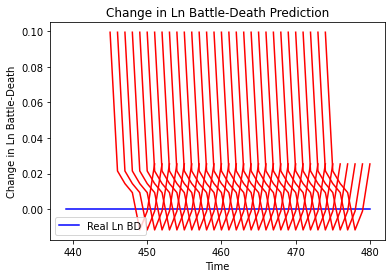

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Djibouti', 'country_id': 55, 'step': 't+1', 'mse': 0.009887808511571672, 'mae': 0.09943746030330658, 'r2': 0.0, 'tadda_score': 0.09943746030330658}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+2', 'mse': 0.014616105034449767, 'mae': 0.1208970844745636, 'r2': 0.0, 'tadda_score': 0.1208970844745636}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+3', 'mse': 0.01829432053581659, 'mae': 0.13525649905204773, 'r2': 0.0, 'tadda_score': 0.13525649905204773}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+4', 'mse': 0.020901099004664525, 'mae': 0.14457212388515472, 'r2': 0.0, 'tadda_score': 0.14457212388515472}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+5', 'mse': 0.012419837408651269, 'mae': 0.11144432425498962, 'r2': 0.0, 'tadda_score': 0.11144432425498962}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+6', 'mse': 0.012172270058598278, 'mae': 0.11032801121473312, 'r2': 0.0, 'tadda_scor

36/36 [==============================] - 0s 5ms/step - loss: 1.9474 - val_loss: 0.0296
Epoch 61/100
36/36 [==============================] - 0s 5ms/step - loss: 1.9522 - val_loss: 0.0294
Epoch 62/100
36/36 [==============================] - 0s 5ms/step - loss: 1.9315 - val_loss: 0.0300
Epoch 63/100
36/36 [==============================] - 0s 5ms/step - loss: 1.9247 - val_loss: 0.0310
Epoch 64/100
36/36 [==============================] - 0s 6ms/step - loss: 1.9228 - val_loss: 0.0299
Epoch 65/100
36/36 [==============================] - 0s 7ms/step - loss: 1.9413 - val_loss: 0.0295
Epoch 66/100
36/36 [==============================] - 0s 6ms/step - loss: 1.9471 - val_loss: 0.0292
Epoch 67/100
36/36 [==============================] - 0s 6ms/step - loss: 1.9330 - val_loss: 0.0298
Epoch 68/100
36/36 [==============================] - 0s 6ms/step - loss: 1.9290 - val_loss: 0.0312
Epoch 69/100
36/36 [==============================] - 0s 7ms/step - loss: 1.9361 - val_loss: 0.0315
Epoch 70/100


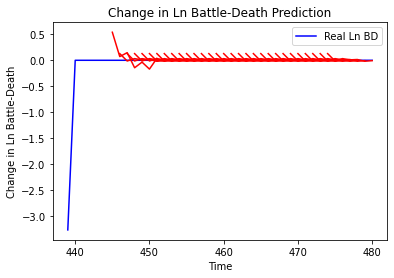

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Eritrea', 'country_id': 56, 'step': 't+1', 'mse': 0.02556587345831311, 'mae': 0.1419189597169558, 'r2': 0.0, 'tadda_score': 0.1419189597169558}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+2', 'mse': 0.025106969472437134, 'mae': 0.13118425458669664, 'r2': 0.0, 'tadda_score': 0.13118425458669664}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+3', 'mse': 0.03990868538867387, 'mae': 0.1671811670064926, 'r2': 0.0, 'tadda_score': 0.1671811670064926}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+4', 'mse': 0.03576667644980221, 'mae': 0.1703577682375908, 'r2': 0.0, 'tadda_score': 0.1703577682375908}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+5', 'mse': 0.041129306117968036, 'mae': 0.19437064280112584, 'r2': 0.0, 'tadda_score': 0.19437064280112584}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+6', 'mse': 0.030148958244799868, 'mae': 0.17088179389635721, 'r2': 0.0, 'tadda_score': 0.170881

36/36 [==============================] - 0s 6ms/step - loss: 4.5309 - val_loss: 2.6130
Epoch 61/100
36/36 [==============================] - 0s 5ms/step - loss: 4.5690 - val_loss: 2.6101
Epoch 62/100
36/36 [==============================] - 0s 5ms/step - loss: 4.5263 - val_loss: 2.6100
Epoch 63/100
36/36 [==============================] - 0s 6ms/step - loss: 4.5186 - val_loss: 2.6103
Epoch 64/100
36/36 [==============================] - 0s 6ms/step - loss: 4.5075 - val_loss: 2.6106
Epoch 65/100
36/36 [==============================] - 0s 6ms/step - loss: 4.5194 - val_loss: 2.6133
Epoch 66/100
36/36 [==============================] - 0s 6ms/step - loss: 4.5569 - val_loss: 2.6095
Epoch 67/100
36/36 [==============================] - 0s 5ms/step - loss: 4.5098 - val_loss: 2.6102
Epoch 68/100
36/36 [==============================] - 0s 6ms/step - loss: 4.5072 - val_loss: 2.6098
Epoch 69/100
36/36 [==============================] - 0s 7ms/step - loss: 4.5192 - val_loss: 2.6072
Epoch 70/100


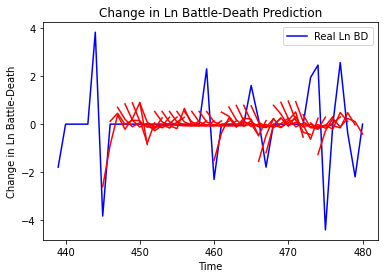

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+1', 'mse': 1.230299603382609, 'mae': 0.8826482751584058, 'r2': 0.09818023039999513, 'tadda_score': 0.9763737418866163}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+2', 'mse': 4.144389996670908, 'mae': 1.5101963523707496, 'r2': -1.0771432291294145, 'tadda_score': 1.7204387827398089}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+3', 'mse': 4.078516107029171, 'mae': 1.5015048219444063, 'r2': -1.0441276336001173, 'tadda_score': 1.7362433904093213}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+4', 'mse': 4.266952482105916, 'mae': 1.5316834416172613, 'r2': -1.138570806401606, 'tadda_score': 1.7773648039680432}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+5', 'mse': 3.234455259581194, 'mae': 1.2608717425348073, 'r2': -0.6210894360226371, 'tadda_score': 1.4224929147642562}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+6', 'mse': 2.6525160379105

Epoch 60/100
41/41 [==============================] - 0s 6ms/step - loss: 0.9169 - val_loss: 1.0003
Epoch 61/100
41/41 [==============================] - 0s 6ms/step - loss: 0.9183 - val_loss: 1.0017
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 0.9186 - val_loss: 1.0004
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.9202 - val_loss: 1.0025
Epoch 64/100
41/41 [==============================] - 0s 6ms/step - loss: 0.9206 - val_loss: 1.0006
Epoch 65/100
41/41 [==============================] - 0s 7ms/step - loss: 0.9182 - val_loss: 1.0007
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 0.9222 - val_loss: 1.0011
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 0.9184 - val_loss: 1.0005
Epoch 68/100
41/41 [==============================] - 0s 7ms/step - loss: 0.9154 - val_loss: 1.0005
Epoch 69/100
41/41 [==============================] - 0s 7ms/step - loss: 0.9277 - val_loss: 1.0016


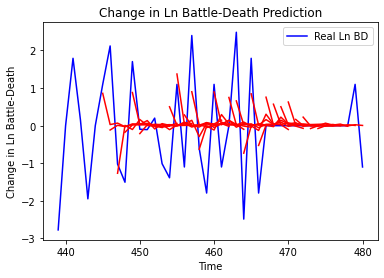

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Algeria', 'country_id': 67, 'step': 't+1', 'mse': 1.0657131908342248, 'mae': 0.8003156980077463, 'r2': 0.3317865307281299, 'tadda_score': 0.8346396933198011}
{'country': 'Algeria', 'country_id': 67, 'step': 't+2', 'mse': 2.3346478567425963, 'mae': 1.1667843312890704, 'r2': -0.3862056876427513, 'tadda_score': 1.4171184502165892}
{'country': 'Algeria', 'country_id': 67, 'step': 't+3', 'mse': 2.6521613799277635, 'mae': 1.274454976458948, 'r2': -0.4784602704207992, 'tadda_score': 1.5639258204297235}
{'country': 'Algeria', 'country_id': 67, 'step': 't+4', 'mse': 2.8454142796522977, 'mae': 1.2980166287913946, 'r2': -0.39379376199160787, 'tadda_score': 1.553535217090947}
{'country': 'Algeria', 'country_id': 67, 'step': 't+5', 'mse': 2.1379695151606026, 'mae': 1.0739453493885531, 'r2': -0.5886583035332074, 'tadda_score': 1.2899508682968552}
{'country': 'Algeria', 'country_id': 67, 'step': 't+6', 'mse': 2.227586614995957

Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1849 - val_loss: 1.4658
Epoch 61/100
41/41 [==============================] - 0s 7ms/step - loss: 0.1822 - val_loss: 1.4673
Epoch 62/100
41/41 [==============================] - 0s 8ms/step - loss: 0.1858 - val_loss: 1.4677
Epoch 63/100
41/41 [==============================] - 0s 7ms/step - loss: 0.1833 - val_loss: 1.4656
Epoch 64/100
41/41 [==============================] - 0s 7ms/step - loss: 0.1832 - val_loss: 1.4647
Epoch 65/100
41/41 [==============================] - 0s 6ms/step - loss: 0.1840 - val_loss: 1.4623
Epoch 66/100
41/41 [==============================] - 0s 6ms/step - loss: 0.1810 - val_loss: 1.4621
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1823 - val_loss: 1.4629
Epoch 68/100
41/41 [==============================] - 0s 6ms/step - loss: 0.1839 - val_loss: 1.4607
Epoch 69/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1860 - val_loss: 1.4612


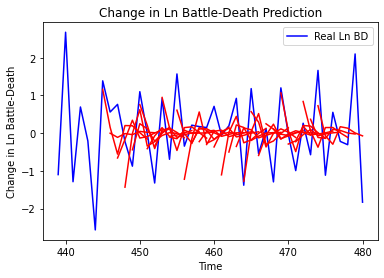

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cameroon', 'country_id': 69, 'step': 't+1', 'mse': 0.5811415910833545, 'mae': 0.6463381698013889, 'r2': 0.21089597942411398, 'tadda_score': 0.7514730665181127}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+2', 'mse': 1.7921669236445965, 'mae': 1.1672785915316697, 'r2': -1.4279971119412989, 'tadda_score': 1.6320254805069723}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+3', 'mse': 1.4277526481049692, 'mae': 0.9754718455020439, 'r2': -0.4568859954102671, 'tadda_score': 1.1782311923646778}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+4', 'mse': 1.6302084771385987, 'mae': 0.9957932688173166, 'r2': -0.8510591008283144, 'tadda_score': 1.2747099327421698}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+5', 'mse': 1.9569198332616535, 'mae': 1.1574222562199499, 'r2': -0.9673761010462845, 'tadda_score': 1.5098515915359723}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+6', 'mse': 2.1631583

41/41 [==============================] - 0s 4ms/step - loss: 0.7180 - val_loss: 2.3940
Epoch 60/100
41/41 [==============================] - 0s 4ms/step - loss: 0.7159 - val_loss: 2.3919
Epoch 61/100
41/41 [==============================] - 0s 4ms/step - loss: 0.7242 - val_loss: 2.3903
Epoch 62/100
41/41 [==============================] - 0s 4ms/step - loss: 0.7225 - val_loss: 2.3883
Epoch 63/100
41/41 [==============================] - 0s 4ms/step - loss: 0.7065 - val_loss: 2.3953
Epoch 64/100
41/41 [==============================] - 0s 4ms/step - loss: 0.7187 - val_loss: 2.3985
Epoch 65/100
41/41 [==============================] - 0s 4ms/step - loss: 0.7159 - val_loss: 2.3951
Epoch 66/100
41/41 [==============================] - 0s 4ms/step - loss: 0.7312 - val_loss: 2.3930
Epoch 67/100
41/41 [==============================] - 0s 4ms/step - loss: 0.7150 - val_loss: 2.3950
Epoch 68/100
41/41 [==============================] - 0s 4ms/step - loss: 0.7157 - val_loss: 2.3931
Epoch 69/100


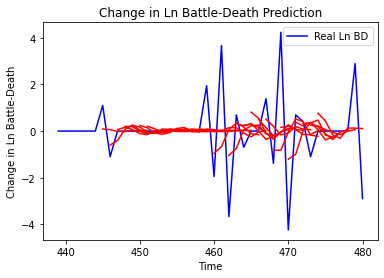

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+1', 'mse': 1.9197083770911796, 'mae': 0.8626020033884968, 'r2': 0.2741395946351838, 'tadda_score': 0.8790062124261185}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+2', 'mse': 2.37221705336453, 'mae': 1.1462234295230878, 'r2': -0.6203965050633495, 'tadda_score': 1.2925665395281487}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+3', 'mse': 2.71347964819762, 'mae': 1.1063619889099547, 'r2': -0.15771698946908597, 'tadda_score': 1.2202632772206414}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+4', 'mse': 3.1610180106808365, 'mae': 1.1723685069212935, 'r2': -0.30747716649620016, 'tadda_score': 1.2915840917159733}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+5', 'mse': 2.8354376134011683, 'mae': 0.9543521407053347, 'r2': -0.11888903894030811, 'tadda_score': 1.0026504936621

41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 57/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 58/100
41/41 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 59/100
41/41 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 60/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 61/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 62/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 63/100
41/41 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 64/100
41/41 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 65/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0

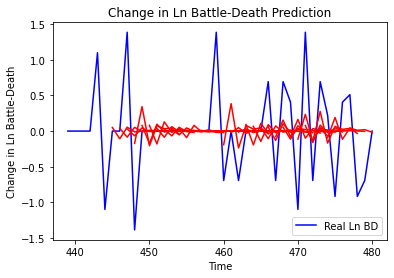

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tunisia', 'country_id': 73, 'step': 't+1', 'mse': 0.3649384011527977, 'mae': 0.39834876279585935, 'r2': 0.11603089817663537, 'tadda_score': 0.4041252351855574}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+2', 'mse': 0.3930873097815621, 'mae': 0.426775848610437, 'r2': 0.044736481344820445, 'tadda_score': 0.4388514028794925}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+3', 'mse': 0.48776451344712574, 'mae': 0.47029963307192185, 'r2': -0.02084588504496665, 'tadda_score': 0.47488972337405144}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+4', 'mse': 0.49442527304955186, 'mae': 0.4590380735742362, 'r2': -0.023931869145592533, 'tadda_score': 0.4608115183546952}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+5', 'mse': 0.5035340868003977, 'mae': 0.5061849248203899, 'r2': -0.1445553108840325, 'tadda_score': 0.5466983739826347}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+6', 'mse': 0.59789

41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
41/41 [=====================

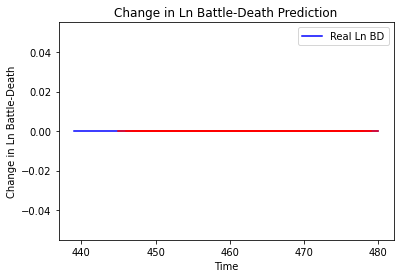

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Benin', 'country_id': 74, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Equatorial Guinea']
Building vanilla Model...
Model: "sequential_508"
_________________________________________________________________
Layer (type)                 Output S

41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
41/41 [=====================

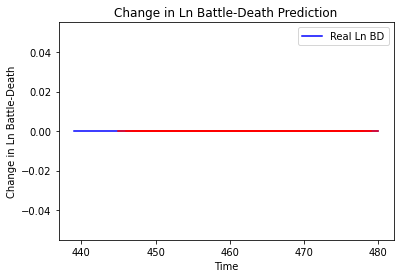

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Niger']
Building vanilla Model...
Model: "sequential_509"
_______________________________

41/41 [==============================] - 0s 5ms/step - loss: 0.8459 - val_loss: 1.6300
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 0.8481 - val_loss: 1.6291
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 0.8487 - val_loss: 1.6300
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 0.8599 - val_loss: 1.6291
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 0.8507 - val_loss: 1.6290
Epoch 68/100
41/41 [==============================] - 0s 5ms/step - loss: 0.8339 - val_loss: 1.6291
Epoch 69/100
41/41 [==============================] - 0s 6ms/step - loss: 0.8537 - val_loss: 1.6274
Epoch 70/100
41/41 [==============================] - 0s 6ms/step - loss: 0.8447 - val_loss: 1.6283
Epoch 71/100
41/41 [==============================] - 0s 7ms/step - loss: 0.8537 - val_loss: 1.6281
Epoch 72/100
41/41 [==============================] - 0s 7ms/step - loss: 0.8454 - val_loss: 1.6260
Epoch 73/100


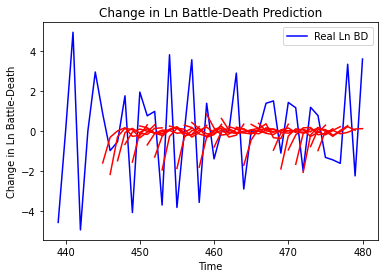

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Niger', 'country_id': 78, 'step': 't+1', 'mse': 3.390486033002794, 'mae': 1.5794937846490873, 'r2': 0.21731543642526852, 'tadda_score': 1.8969547209569944}
{'country': 'Niger', 'country_id': 78, 'step': 't+2', 'mse': 6.723209316292701, 'mae': 2.173669704361912, 'r2': -0.7121312691861723, 'tadda_score': 2.675481143160816}
{'country': 'Niger', 'country_id': 78, 'step': 't+3', 'mse': 6.261024175923262, 'mae': 1.9651527914111153, 'r2': -0.6165680982185731, 'tadda_score': 2.4964161935154925}
{'country': 'Niger', 'country_id': 78, 'step': 't+4', 'mse': 6.5202090863023106, 'mae': 2.1293368193665825, 'r2': -0.4370468942735932, 'tadda_score': 2.57514032653567}
{'country': 'Niger', 'country_id': 78, 'step': 't+5', 'mse': 7.963117798108856, 'mae': 2.2729832211893166, 'r2': -0.44762162486151214, 'tadda_score': 2.7660617061964046}
{'country': 'Niger', 'country_id': 78, 'step': 't+6', 'mse': 7.5766088545323536, 'mae': 2.14440

41/41 [==============================] - 0s 5ms/step - loss: 0.5331 - val_loss: 1.1992
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5304 - val_loss: 1.2010
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5366 - val_loss: 1.1992
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5250 - val_loss: 1.2001
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5269 - val_loss: 1.2043
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5314 - val_loss: 1.2051
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5276 - val_loss: 1.2053
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5308 - val_loss: 1.2074
Epoch 68/100
41/41 [==============================] - 0s 4ms/step - loss: 0.5356 - val_loss: 1.2083
Epoch 69/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5306 - val_loss: 1.2006
Epoch 70/100


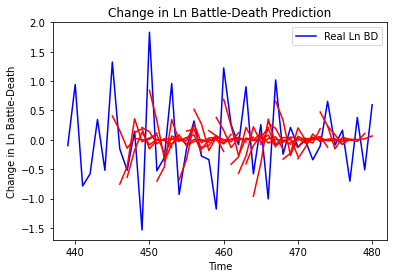

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Nigeria', 'country_id': 79, 'step': 't+1', 'mse': 0.48593430314343566, 'mae': 0.5269412441827662, 'r2': 0.14973057962792014, 'tadda_score': 0.6139838715421961}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+2', 'mse': 1.4173731043251423, 'mae': 0.9758567045128821, 'r2': -1.6195733861602588, 'tadda_score': 1.3482999864962177}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+3', 'mse': 1.168905159547842, 'mae': 0.8693430232883235, 'r2': -0.9078251690524324, 'tadda_score': 1.1370435430736088}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+4', 'mse': 1.3218412409159557, 'mae': 0.9000776963450713, 'r2': -0.77696480952216, 'tadda_score': 1.2098409998062456}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+5', 'mse': 0.8309312160305372, 'mae': 0.712101644693405, 'r2': -0.6230295475736101, 'tadda_score': 0.9040668180334971}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+6', 'mse': 0.8403524450417248

41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
41/41 [=====================

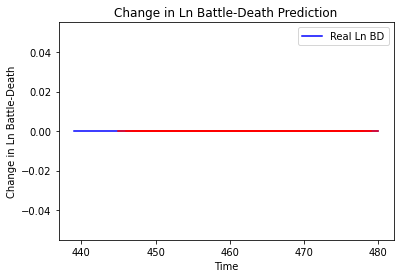

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Togo']
Building vanilla Model...
Model: "sequential_512"
____

41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
41/41 [=====================

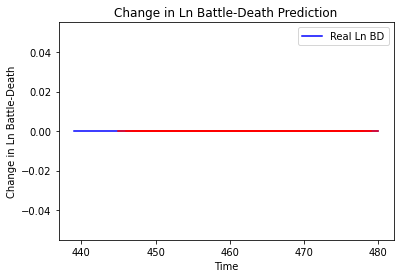

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Togo', 'country_id': 81, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Somalia']
Building vanilla Model...
Model: "sequential_513"
_________________________________________________________________
Layer (type)                 Output Shape             

41/41 [==============================] - 0s 5ms/step - loss: 2.5338 - val_loss: 0.3691
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 2.5814 - val_loss: 0.3705
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 2.5604 - val_loss: 0.3694
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 2.5521 - val_loss: 0.3699
Epoch 68/100
41/41 [==============================] - 0s 5ms/step - loss: 2.5631 - val_loss: 0.3690
Epoch 69/100
41/41 [==============================] - 0s 5ms/step - loss: 2.5606 - val_loss: 0.3690
Epoch 70/100
41/41 [==============================] - 0s 5ms/step - loss: 2.5566 - val_loss: 0.3691
Epoch 71/100
41/41 [==============================] - 0s 5ms/step - loss: 2.5470 - val_loss: 0.3685
Epoch 72/100
41/41 [==============================] - 0s 5ms/step - loss: 2.5803 - val_loss: 0.3694
Epoch 73/100
41/41 [==============================] - 0s 5ms/step - loss: 2.5585 - val_loss: 0.3691
Epoch 74/100


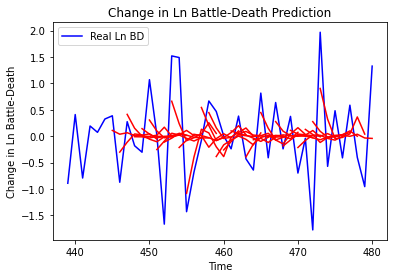

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Somalia', 'country_id': 120, 'step': 't+1', 'mse': 0.5416433043896378, 'mae': 0.5628242236193262, 'r2': 0.2889820079645826, 'tadda_score': 0.6411825740651531}
{'country': 'Somalia', 'country_id': 120, 'step': 't+2', 'mse': 1.4076336988278244, 'mae': 0.9042088922449065, 'r2': -0.4354354371536875, 'tadda_score': 1.119487938194286}
{'country': 'Somalia', 'country_id': 120, 'step': 't+3', 'mse': 1.345526325674044, 'mae': 0.8451501907665185, 'r2': -0.6859256448747748, 'tadda_score': 1.0636423742283039}
{'country': 'Somalia', 'country_id': 120, 'step': 't+4', 'mse': 1.0349107168238856, 'mae': 0.8356275336171286, 'r2': -0.49299282940715505, 'tadda_score': 1.0022007567783293}
{'country': 'Somalia', 'country_id': 120, 'step': 't+5', 'mse': 0.8890367176969358, 'mae': 0.6985135335720496, 'r2': -0.1532520723640538, 'tadda_score': 0.8446696697048264}
{'country': 'Somalia', 'country_id': 120, 'step': 't+6', 'mse': 1.052908026

41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
41/41 [=====================

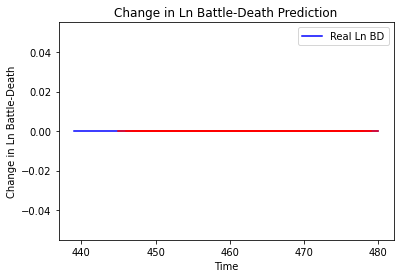

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Botswana', 'country_id': 154, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Burundi']
Building vanilla Model...
Model: "sequential_515"
_________________________________________________________________
Layer (type)       

Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 1.9176 - val_loss: 1.6184
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 1.9177 - val_loss: 1.6179
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 1.9143 - val_loss: 1.6176
Epoch 67/100
41/41 [==============================] - 0s 6ms/step - loss: 1.9188 - val_loss: 1.6176
Epoch 68/100
41/41 [==============================] - 0s 5ms/step - loss: 1.9047 - val_loss: 1.6169
Epoch 69/100
41/41 [==============================] - 0s 5ms/step - loss: 1.9213 - val_loss: 1.6177
Epoch 70/100
41/41 [==============================] - 0s 5ms/step - loss: 1.9202 - val_loss: 1.6183
Epoch 71/100
41/41 [==============================] - 0s 5ms/step - loss: 1.9029 - val_loss: 1.6177
Epoch 72/100
41/41 [==============================] - 0s 5ms/step - loss: 1.9132 - val_loss: 1.6186
Epoch 73/100
41/41 [==============================] - 0s 5ms/step - loss: 1.9093 - val_loss: 1.6178


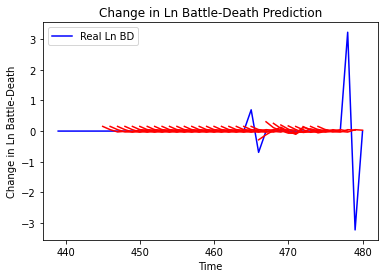

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burundi', 'country_id': 155, 'step': 't+1', 'mse': 0.04126519646354942, 'mae': 0.18411492046930475, 'r2': -0.2883214987150111, 'tadda_score': 0.18411492046930475}
{'country': 'Burundi', 'country_id': 155, 'step': 't+2', 'mse': 0.09364822692296422, 'mae': 0.2526957341752259, 'r2': -1.9237477196544797, 'tadda_score': 0.26653124677358153}
{'country': 'Burundi', 'country_id': 155, 'step': 't+3', 'mse': 0.07789951992870442, 'mae': 0.22499445018388908, 'r2': -1.4320646662225034, 'tadda_score': 0.23481581049380781}
{'country': 'Burundi', 'country_id': 155, 'step': 't+4', 'mse': 0.06503222640238097, 'mae': 0.20861173309105716, 'r2': -1.030340881994745, 'tadda_score': 0.21482625243284387}
{'country': 'Burundi', 'country_id': 155, 'step': 't+5', 'mse': 0.04068704037763393, 'mae': 0.1304325104973523, 'r2': -0.2702711565639495, 'tadda_score': 0.1332673146050978}
{'country': 'Burundi', 'country_id': 155, 'step': 't+6', 'mse'

41/41 [==============================] - 0s 5ms/step - loss: 2.4188 - val_loss: 0.1817
Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 2.4159 - val_loss: 0.1829
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 2.4020 - val_loss: 0.1835
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 2.4186 - val_loss: 0.1825
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 2.4133 - val_loss: 0.1830
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 2.3960 - val_loss: 0.1834
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 2.4010 - val_loss: 0.1833
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 2.3962 - val_loss: 0.1816
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 2.4302 - val_loss: 0.1856
Epoch 68/100
41/41 [==============================] - 0s 5ms/step - loss: 2.4087 - val_loss: 0.1842
Epoch 69/100


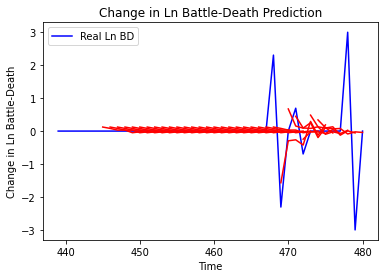

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Rwanda', 'country_id': 156, 'step': 't+1', 'mse': 0.22327377411292496, 'mae': 0.26402680548662505, 'r2': 0.4208053887347839, 'tadda_score': 0.26402680548662505}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+2', 'mse': 0.6865149432995689, 'mae': 0.4649229533735371, 'r2': -0.7808887644414919, 'tadda_score': 0.5127748814486918}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+3', 'mse': 0.5968672912467904, 'mae': 0.4973951775373665, 'r2': -1.1386343483239285, 'tadda_score': 0.5352325676422962}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+4', 'mse': 0.6139416213017557, 'mae': 0.5089389760475103, 'r2': -0.6640638800538625, 'tadda_score': 0.5089389760475103}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+5', 'mse': 0.6068712957018292, 'mae': 0.3907918083570949, 'r2': -0.6449000490920336, 'tadda_score': 0.4101716466647935}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+6', 'mse': 0.59875568307

41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
41/41 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
41/41 [=====================

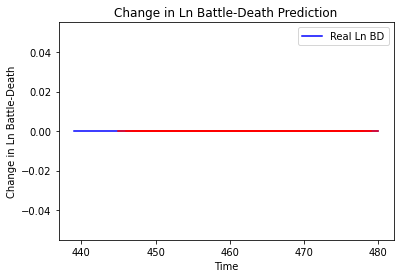

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zambia', 'country_id': 157, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Zimbabwe']
Building vanilla Model...
Model: "sequential_518"
_________________________________________________________________
Layer (type)                 Out

41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
41/41 [=====================

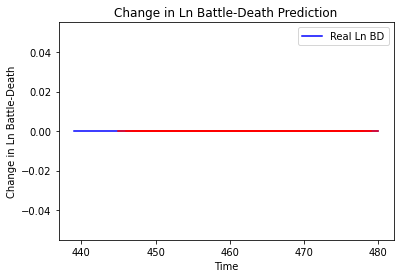

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Comoros']
Building vanilla Model...
Model: "sequential_519"
_________________________________________________________________
Layer (type)       

41/41 [==============================] - 0s 4ms/step - loss: 0.1275 - val_loss: 3.2555e-05
Epoch 62/100
41/41 [==============================] - 0s 6ms/step - loss: 0.1271 - val_loss: 1.7581e-05
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1247 - val_loss: 1.0029e-04
Epoch 64/100
41/41 [==============================] - 0s 6ms/step - loss: 0.1277 - val_loss: 3.4605e-05
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1254 - val_loss: 3.1721e-05
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1248 - val_loss: 1.3509e-04
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1254 - val_loss: 4.2614e-06
Epoch 68/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1252 - val_loss: 1.1411e-04
Epoch 69/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1247 - val_loss: 4.8306e-05
Epoch 70/100
41/41 [==============================] - 0s 4ms/step - loss: 0.1

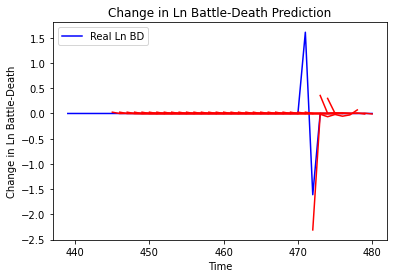

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Comoros', 'country_id': 159, 'step': 't+1', 'mse': 0.10763462685722072, 'mae': 0.12000415921211242, 'r2': 0.376703319978945, 'tadda_score': 0.12000415921211242}
{'country': 'Comoros', 'country_id': 159, 'step': 't+2', 'mse': 0.3960986911790929, 'mae': 0.22676806988267498, 'r2': -1.2937506858282122, 'tadda_score': 0.23873235128271972}
{'country': 'Comoros', 'country_id': 159, 'step': 't+3', 'mse': 0.40151845230760885, 'mae': 0.23099386671630934, 'r2': -1.3251357448612344, 'tadda_score': 0.24135271389731164}
{'country': 'Comoros', 'country_id': 159, 'step': 't+4', 'mse': 0.2851647191795397, 'mae': 0.1770973771721045, 'r2': -2.416582009998322, 'tadda_score': 0.1770973771721045}
{'country': 'Comoros', 'country_id': 159, 'step': 't+5', 'mse': 0.29171285783445433, 'mae': 0.17635435144453443, 'r2': -2.4950357990635474, 'tadda_score': 0.17635435144453443}
{'country': 'Comoros', 'country_id': 159, 'step': 't+6', 'mse': 0

41/41 [==============================] - 0s 5ms/step - loss: 0.1399 - val_loss: 1.5398e-05
Epoch 58/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1422 - val_loss: 6.6962e-05
Epoch 59/100
41/41 [==============================] - 0s 6ms/step - loss: 0.1380 - val_loss: 7.3045e-05
Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1372 - val_loss: 6.8533e-05
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1373 - val_loss: 1.8088e-05
Epoch 62/100
41/41 [==============================] - 0s 6ms/step - loss: 0.1378 - val_loss: 1.2792e-04
Epoch 63/100
41/41 [==============================] - 0s 6ms/step - loss: 0.1369 - val_loss: 4.4615e-06
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1371 - val_loss: 5.1326e-05
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1376 - val_loss: 8.2978e-06
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1

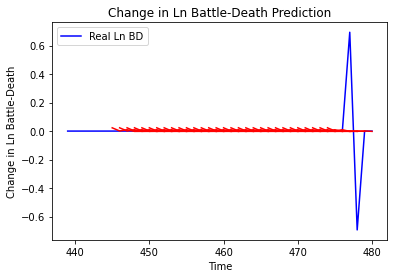

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Lesotho', 'country_id': 160, 'step': 't+1', 'mse': 0.0005271164277869667, 'mae': 0.022959016263484955, 'r2': 0.0, 'tadda_score': 0.022959016263484955}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+2', 'mse': 0.0005672448299493121, 'mae': 0.023816902190446854, 'r2': 0.0, 'tadda_score': 0.023816902190446854}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+3', 'mse': 0.0011062012666325366, 'mae': 0.03325960412621498, 'r2': 0.0, 'tadda_score': 0.03325960412621498}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+4', 'mse': 0.0009634749963858269, 'mae': 0.031039893627166748, 'r2': 0.0, 'tadda_score': 0.031039893627166748}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+5', 'mse': 0.0008001449390521304, 'mae': 0.028286833316087723, 'r2': 0.0, 'tadda_score': 0.028286833316087723}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+6', 'mse': 0.0008701768213099786, 'mae': 0.029498759657144547, 'r2'

41/41 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
41/41 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
41/41 [=====================

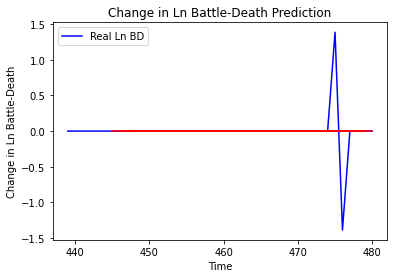

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Malawi', 'country_id': 161, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mozambique']
Building vanilla Model...
Model: "sequential_522"
_________________________________________________________________
Layer (type)                 O

41/41 [==============================] - 0s 6ms/step - loss: 0.9880 - val_loss: 0.6940
Epoch 65/100
41/41 [==============================] - 0s 6ms/step - loss: 0.9667 - val_loss: 0.6951
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 0.9892 - val_loss: 0.6976
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 1.0245 - val_loss: 0.6967
Epoch 68/100
41/41 [==============================] - 0s 5ms/step - loss: 1.0750 - val_loss: 0.6981
Epoch 69/100
41/41 [==============================] - 0s 6ms/step - loss: 1.0070 - val_loss: 0.6984
Epoch 70/100
41/41 [==============================] - 0s 5ms/step - loss: 1.0165 - val_loss: 0.6997
Epoch 71/100
41/41 [==============================] - 0s 5ms/step - loss: 1.0296 - val_loss: 0.6971
Epoch 72/100
41/41 [==============================] - 0s 5ms/step - loss: 1.0222 - val_loss: 0.7003
Epoch 73/100
41/41 [==============================] - 0s 6ms/step - loss: 1.0166 - val_loss: 0.7005
Epoch 74/100


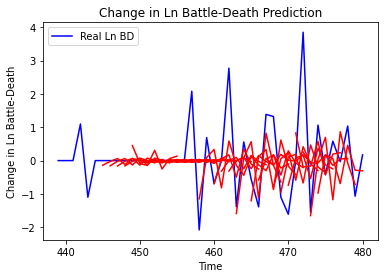

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mozambique', 'country_id': 162, 'step': 't+1', 'mse': 1.4238146990938925, 'mae': 0.7399686001466617, 'r2': 0.09515958079984932, 'tadda_score': 0.8256767115470673}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+2', 'mse': 2.6998951499202253, 'mae': 1.0991234005654233, 'r2': -0.4111044422343044, 'tadda_score': 1.2909627756639697}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+3', 'mse': 2.619580201994974, 'mae': 1.139511740366268, 'r2': -0.3687648553565679, 'tadda_score': 1.307579976478863}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+4', 'mse': 3.16150663010802, 'mae': 1.295842882882949, 'r2': -1.097841119791664, 'tadda_score': 1.6949857288513543}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+5', 'mse': 1.6327526051300667, 'mae': 0.911674180470896, 'r2': -0.9936028006964552, 'tadda_score': 1.0991483568827232}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+6', 'mse':

41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
41/41 [=====================

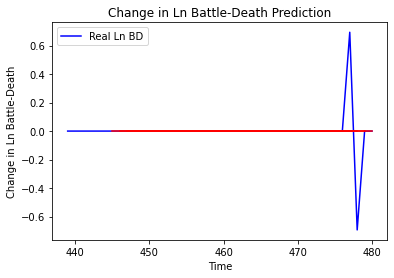

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Africa', 'country_id': 163, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Swaziland']
Building vanilla Model...
Model: "sequential_524"
_______________________________________________________

41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
41/41 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
41/41 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
41/41 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
41/41 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
41/41 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
41/41 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
41/41 [=====================

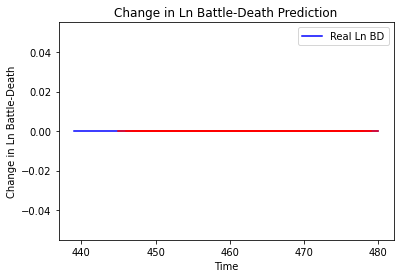

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Swaziland', 'country_id': 164, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Angola']
Building vanilla Model...
Model: "sequential_525"
_________________________________________________________________
Layer (type) 

Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 3.2501 - val_loss: 0.0858
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 3.2606 - val_loss: 0.0854
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 3.2709 - val_loss: 0.0855
Epoch 67/100
41/41 [==============================] - 0s 6ms/step - loss: 3.2448 - val_loss: 0.0860
Epoch 68/100
41/41 [==============================] - 0s 6ms/step - loss: 3.2568 - val_loss: 0.0857
Epoch 69/100
41/41 [==============================] - 0s 6ms/step - loss: 3.2472 - val_loss: 0.0859
Epoch 70/100
41/41 [==============================] - 0s 6ms/step - loss: 3.2563 - val_loss: 0.0858
Epoch 71/100
41/41 [==============================] - 0s 5ms/step - loss: 3.2360 - val_loss: 0.0859
Epoch 72/100
41/41 [==============================] - 0s 5ms/step - loss: 3.2798 - val_loss: 0.0861
Epoch 73/100
41/41 [==============================] - 0s 5ms/step - loss: 3.2397 - val_loss: 0.0863


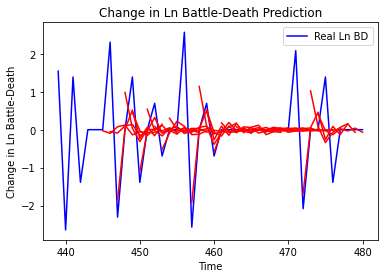

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Angola', 'country_id': 165, 'step': 't+1', 'mse': 0.7470457634361626, 'mae': 0.5218563075425269, 'r2': 0.4129355134618924, 'tadda_score': 0.5238512526514174}
{'country': 'Angola', 'country_id': 165, 'step': 't+2', 'mse': 2.3710489743545935, 'mae': 1.0530444412429671, 'r2': -0.8632843084252808, 'tadda_score': 1.2020712262888293}
{'country': 'Angola', 'country_id': 165, 'step': 't+3', 'mse': 1.2299731708186108, 'mae': 0.7894685827866006, 'r2': -0.40228562109477894, 'tadda_score': 0.819310818803788}
{'country': 'Angola', 'country_id': 165, 'step': 't+4', 'mse': 1.1082700018154534, 'mae': 0.7711987428967485, 'r2': -0.03250922285288027, 'tadda_score': 0.7803581752483377}
{'country': 'Angola', 'country_id': 165, 'step': 't+5', 'mse': 1.2735254566027976, 'mae': 0.7785922100802971, 'r2': -0.30071404732536733, 'tadda_score': 0.8031849752526197}
{'country': 'Angola', 'country_id': 165, 'step': 't+6', 'mse': 1.568117752470

Epoch 60/100
41/41 [==============================] - 0s 6ms/step - loss: 1.8708 - val_loss: 0.2220
Epoch 61/100
41/41 [==============================] - 0s 6ms/step - loss: 1.8713 - val_loss: 0.2213
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 1.8742 - val_loss: 0.2215
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 1.8758 - val_loss: 0.2233
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 1.8672 - val_loss: 0.2226
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 1.8660 - val_loss: 0.2222
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 1.8876 - val_loss: 0.2227
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 1.8712 - val_loss: 0.2212
Epoch 68/100
41/41 [==============================] - 0s 5ms/step - loss: 1.8602 - val_loss: 0.2211
Epoch 69/100
41/41 [==============================] - 0s 5ms/step - loss: 1.8681 - val_loss: 0.2211


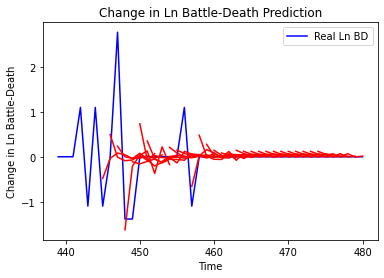

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo', 'country_id': 166, 'step': 't+1', 'mse': 0.3718405068866725, 'mae': 0.3558378783964088, 'r2': 0.26180562011109054, 'tadda_score': 0.3558378783964088}
{'country': 'Congo', 'country_id': 166, 'step': 't+2', 'mse': 1.1556797801622727, 'mae': 0.6467507495721383, 'r2': -0.520715608889692, 'tadda_score': 0.7627987309535545}
{'country': 'Congo', 'country_id': 166, 'step': 't+3', 'mse': 0.9971828134140862, 'mae': 0.5974646936749833, 'r2': -0.6813073439588404, 'tadda_score': 0.6880484522278525}
{'country': 'Congo', 'country_id': 166, 'step': 't+4', 'mse': 0.8983985026870012, 'mae': 0.6116221845418631, 'r2': -0.29334268600476077, 'tadda_score': 0.6883969361852029}
{'country': 'Congo', 'country_id': 166, 'step': 't+5', 'mse': 0.8810399445639575, 'mae': 0.5905762061745343, 'r2': -0.48548381419140374, 'tadda_score': 0.657495096352738}
{'country': 'Congo', 'country_id': 166, 'step': 't+6', 'mse': 0.8643820897733313, '

Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 2.9432 - val_loss: 3.3271
Epoch 61/100
41/41 [==============================] - 0s 4ms/step - loss: 2.9541 - val_loss: 3.3281
Epoch 62/100
41/41 [==============================] - 0s 4ms/step - loss: 2.9246 - val_loss: 3.3302
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 2.9360 - val_loss: 3.3240
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 2.9359 - val_loss: 3.3287
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 2.9117 - val_loss: 3.3338
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 2.9448 - val_loss: 3.3391
Epoch 67/100
41/41 [==============================] - 0s 7ms/step - loss: 2.9259 - val_loss: 3.3329
Epoch 68/100
41/41 [==============================] - 0s 7ms/step - loss: 2.8959 - val_loss: 3.3362
Epoch 69/100
41/41 [==============================] - 0s 7ms/step - loss: 2.9224 - val_loss: 3.3365


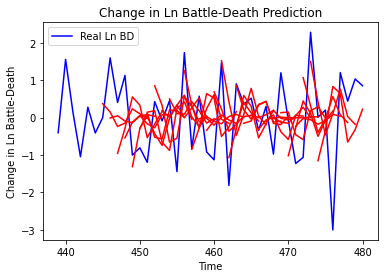

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+1', 'mse': 0.9461706195473797, 'mae': 0.7784778820051513, 'r2': 0.135507278692915, 'tadda_score': 0.9529839599826695}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+2', 'mse': 3.2062337416252054, 'mae': 1.4526320193158175, 'r2': -1.2676136669538005, 'tadda_score': 1.9077840108619717}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+3', 'mse': 2.6538736964338185, 'mae': 1.3287537670502034, 'r2': -0.5385346789042789, 'tadda_score': 1.7216397026051053}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+4', 'mse': 3.2641852976162737, 'mae': 1.5053149916914101, 'r2': -0.8736227015157041, 'tadda_score': 2.006329175153076}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+5', 'mse': 4.1563939321129775, 'mae': 1.603416188098584, 'r2': -1.26416653507636, 'tadda_score': 2.200114875075812}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+6', 'mse'

41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
41/41 [=====================

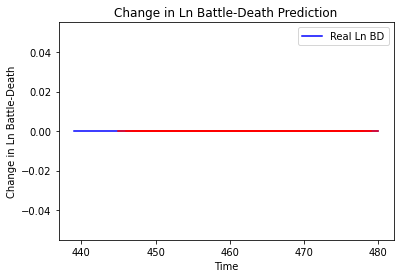

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Gabon', 'country_id': 169, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Namibia']
Building vanilla Model...
Model: "sequential_529"
_________________________________________________________________
Layer (type)                 Output Shap

Epoch 62/100
41/41 [==============================] - 0s 4ms/step - loss: 0.1397 - val_loss: 1.3580e-05
Epoch 63/100
41/41 [==============================] - 0s 4ms/step - loss: 0.1375 - val_loss: 6.7512e-05
Epoch 64/100
41/41 [==============================] - 0s 4ms/step - loss: 0.1380 - val_loss: 1.5028e-05
Epoch 65/100
41/41 [==============================] - 0s 4ms/step - loss: 0.1398 - val_loss: 7.4555e-05
Epoch 66/100
41/41 [==============================] - 0s 4ms/step - loss: 0.1382 - val_loss: 3.8266e-05
Epoch 67/100
41/41 [==============================] - 0s 4ms/step - loss: 0.1419 - val_loss: 2.0555e-04
Epoch 68/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1426 - val_loss: 2.5397e-05
Epoch 69/100
41/41 [==============================] - 0s 4ms/step - loss: 0.1363 - val_loss: 9.7547e-05
Epoch 70/100
41/41 [==============================] - 0s 4ms/step - loss: 0.1355 - val_loss: 9.1733e-05
Epoch 71/100
41/41 [==============================] - 0s 4ms/ste

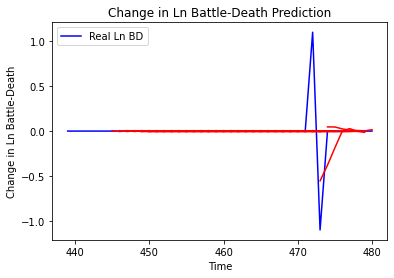

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Namibia', 'country_id': 170, 'step': 't+1', 'mse': 0.049869040370886415, 'mae': 0.06059248520081929, 'r2': 0.3802259831603161, 'tadda_score': 0.06059248520081929}
{'country': 'Namibia', 'country_id': 170, 'step': 't+2', 'mse': 0.11644595815142961, 'mae': 0.10745685828249349, 'r2': -0.4471940645240542, 'tadda_score': 0.1105201500904629}
{'country': 'Namibia', 'country_id': 170, 'step': 't+3', 'mse': 0.08213494480017794, 'mae': 0.08017070899417347, 'r2': -1.1119497269919778, 'tadda_score': 0.08017070899417347}
{'country': 'Namibia', 'country_id': 170, 'step': 't+4', 'mse': 0.08203199109251923, 'mae': 0.0812527802059834, 'r2': -1.109302460894562, 'tadda_score': 0.0812527802059834}
{'country': 'Namibia', 'country_id': 170, 'step': 't+5', 'mse': 0.05701454595412414, 'mae': 0.06654655625122632, 'r2': -0.4660246628926106, 'tadda_score': 0.06654655625122632}
{'country': 'Namibia', 'country_id': 170, 'step': 't+6', 'mse'

41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
41/41 [=====================

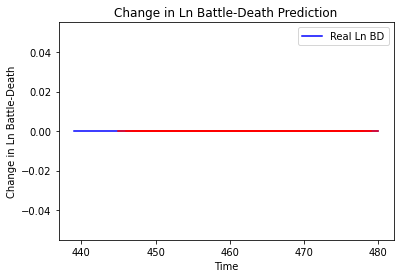

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Madagascar', 'country_id': 172, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mauritius']
Building vanilla Model...
Model: "sequential_531"
_________________________________________________________________
Lay

41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
41/41 [=====================

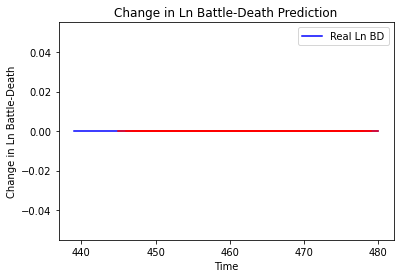

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritius', 'country_id': 173, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Seychelles']
Building vanilla Model...
Model: "sequential_532"
_________________________________________________________________
Layer (ty

41/41 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
41/41 [=====================

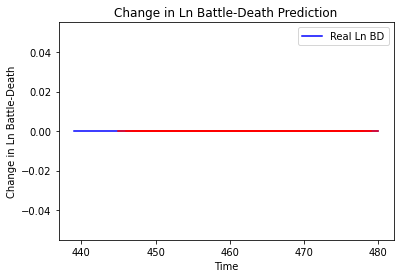

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Seychelles', 'country_id': 174, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Libya']
Building vanilla Model...
Model: "sequential_533"
_________________________________________________________________
Layer (

Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.3044
Epoch 65/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3045
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0315 - val_loss: 2.3045
Epoch 67/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0314 - val_loss: 2.3045
Epoch 68/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0315 - val_loss: 2.3047
Epoch 69/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3048
Epoch 70/100
41/41 [==============================] - 0s 4ms/step - loss: 0.0315 - val_loss: 2.3047
Epoch 71/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0315 - val_loss: 2.3046
Epoch 72/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.3047
Epoch 73/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0315 - val_loss: 2.3047


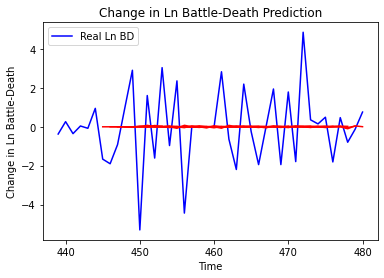

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Libya', 'country_id': 213, 'step': 't+1', 'mse': 4.845920273846891, 'mae': 1.6886389794024423, 'r2': -5.870947982189456e-05, 'tadda_score': 1.6886429505976968}
{'country': 'Libya', 'country_id': 213, 'step': 't+2', 'mse': 5.417242204158541, 'mae': 1.7837046327676618, 'r2': -2.441495777105729e-06, 'tadda_score': 1.783705984017795}
{'country': 'Libya', 'country_id': 213, 'step': 't+3', 'mse': 7.422629498877669, 'mae': 2.108056667630359, 'r2': -1.2015749329297165e-05, 'tadda_score': 2.108066652561189}
{'country': 'Libya', 'country_id': 213, 'step': 't+4', 'mse': 5.817767956451005, 'mae': 1.975106676569524, 'r2': -0.005345217775632571, 'tadda_score': 1.9751215517651595}
{'country': 'Libya', 'country_id': 213, 'step': 't+5', 'mse': 7.408021253870581, 'mae': 2.281475896584884, 'r2': -0.01811962002113754, 'tadda_score': 2.2965017566832295}
{'country': 'Libya', 'country_id': 213, 'step': 't+6', 'mse': 6.279217506370881,

Epoch 60/100
41/41 [==============================] - 0s 8ms/step - loss: 4.9450 - val_loss: 0.8576
Epoch 61/100
41/41 [==============================] - 0s 7ms/step - loss: 4.9435 - val_loss: 0.8570
Epoch 62/100
41/41 [==============================] - 0s 6ms/step - loss: 4.9271 - val_loss: 0.8575
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 4.9521 - val_loss: 0.8581
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 4.9520 - val_loss: 0.8557
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 4.9571 - val_loss: 0.8559
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 4.9372 - val_loss: 0.8578
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 4.9381 - val_loss: 0.8586
Epoch 68/100
41/41 [==============================] - 0s 5ms/step - loss: 4.9538 - val_loss: 0.8534
Epoch 69/100
41/41 [==============================] - 0s 5ms/step - loss: 4.9463 - val_loss: 0.8541


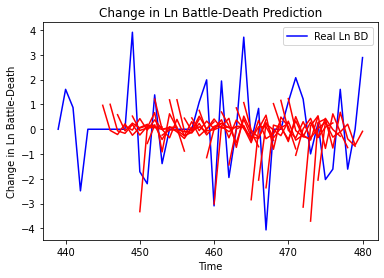

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Chad', 'country_id': 214, 'step': 't+1', 'mse': 3.453823126161662, 'mae': 1.4822946755074773, 'r2': -0.17659656553334968, 'tadda_score': 1.7970232653601281}
{'country': 'Chad', 'country_id': 214, 'step': 't+2', 'mse': 8.437163271150515, 'mae': 2.2599850588207193, 'r2': -0.9876698567575652, 'tadda_score': 2.9862752808297426}
{'country': 'Chad', 'country_id': 214, 'step': 't+3', 'mse': 9.589718813352642, 'mae': 2.4294317586739895, 'r2': -0.8361672448286912, 'tadda_score': 3.058862108341857}
{'country': 'Chad', 'country_id': 214, 'step': 't+4', 'mse': 13.732566877056353, 'mae': 3.0926409997312403, 'r2': -1.2520039626684736, 'tadda_score': 3.994835765934803}
{'country': 'Chad', 'country_id': 214, 'step': 't+5', 'mse': 11.553720557139007, 'mae': 2.739096385942983, 'r2': -1.4319217032289466, 'tadda_score': 3.512682947225458}
{'country': 'Chad', 'country_id': 214, 'step': 't+6', 'mse': 10.079476102099742, 'mae': 2.4822

41/41 [==============================] - 0s 5ms/step - loss: 0.5689 - val_loss: 2.1195
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5725 - val_loss: 2.1182
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5748 - val_loss: 2.1156
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5757 - val_loss: 2.1142
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5672 - val_loss: 2.1161
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5696 - val_loss: 2.1167
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5703 - val_loss: 2.1135
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5632 - val_loss: 2.1148
Epoch 68/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5716 - val_loss: 2.1117
Epoch 69/100
41/41 [==============================] - 0s 5ms/step - loss: 0.5717 - val_loss: 2.1151
Epoch 70/100


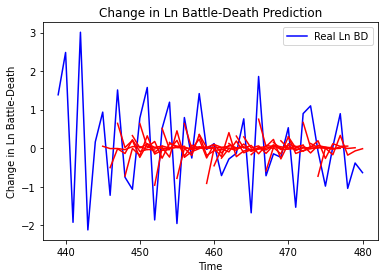

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Egypt', 'country_id': 222, 'step': 't+1', 'mse': 0.6770403832663969, 'mae': 0.6819554005676853, 'r2': 0.39927816056865273, 'tadda_score': 0.7339766253644573}
{'country': 'Egypt', 'country_id': 222, 'step': 't+2', 'mse': 1.5589127944585492, 'mae': 1.0557786372761133, 'r2': -0.4414950383008429, 'tadda_score': 1.2879855893823209}
{'country': 'Egypt', 'country_id': 222, 'step': 't+3', 'mse': 1.414835800418231, 'mae': 0.9719503781571253, 'r2': -0.5255545729876527, 'tadda_score': 1.2033973220859233}
{'country': 'Egypt', 'country_id': 222, 'step': 't+4', 'mse': 1.2862059073779837, 'mae': 0.952073274193835, 'r2': -0.04418785974031181, 'tadda_score': 1.1116475756105104}
{'country': 'Egypt', 'country_id': 222, 'step': 't+5', 'mse': 1.5846385276782367, 'mae': 1.069192572933088, 'r2': -0.3357166482909033, 'tadda_score': 1.3337645277397336}
{'country': 'Egypt', 'country_id': 222, 'step': 't+6', 'mse': 1.349800838369689, 'mae

Epoch 59/100
41/41 [==============================] - 0s 5ms/step - loss: 2.6433 - val_loss: 0.0018
Epoch 60/100
41/41 [==============================] - 0s 5ms/step - loss: 2.6491 - val_loss: 0.0013
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 2.6528 - val_loss: 8.5950e-04
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 2.6741 - val_loss: 0.0011
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 2.6305 - val_loss: 0.0026
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 2.6516 - val_loss: 0.0036
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 2.6291 - val_loss: 0.0021
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 2.6468 - val_loss: 0.0030
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 2.6703 - val_loss: 0.0011
Epoch 68/100
41/41 [==============================] - 0s 5ms/step - loss: 2.6269 - val_loss: 4.7

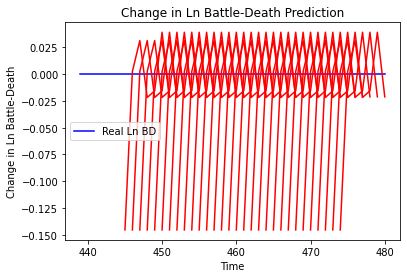

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Uganda', 'country_id': 235, 'step': 't+1', 'mse': 0.021170554786587026, 'mae': 0.145501047372818, 'r2': 0.0, 'tadda_score': 0.145501047372818}
{'country': 'Uganda', 'country_id': 235, 'step': 't+2', 'mse': 0.020438455481974538, 'mae': 0.14296312630176544, 'r2': 0.0, 'tadda_score': 0.14296312630176544}
{'country': 'Uganda', 'country_id': 235, 'step': 't+3', 'mse': 0.012447973108907162, 'mae': 0.11157048493623734, 'r2': 0.0, 'tadda_score': 0.11157048493623734}
{'country': 'Uganda', 'country_id': 235, 'step': 't+4', 'mse': 0.01776827594809327, 'mae': 0.13329769670963287, 'r2': 0.0, 'tadda_score': 0.13329769670963287}
{'country': 'Uganda', 'country_id': 235, 'step': 't+5', 'mse': 0.022921526799856373, 'mae': 0.15139856934547424, 'r2': 0.0, 'tadda_score': 0.15139856934547424}
{'country': 'Uganda', 'country_id': 235, 'step': 't+6', 'mse': 0.012584896136141888, 'mae': 0.11218242347240448, 'r2': 0.0, 'tadda_score': 0.11

41/41 [==============================] - 0s 5ms/step - loss: 0.1149 - val_loss: 1.6532
Epoch 61/100
41/41 [==============================] - 0s 6ms/step - loss: 0.1182 - val_loss: 1.6561
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1138 - val_loss: 1.6544
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1152 - val_loss: 1.6532
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1138 - val_loss: 1.6525
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1172 - val_loss: 1.6613
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1149 - val_loss: 1.6566
Epoch 67/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1149 - val_loss: 1.6528
Epoch 68/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1143 - val_loss: 1.6567
Epoch 69/100
41/41 [==============================] - 0s 5ms/step - loss: 0.1138 - val_loss: 1.6575
Epoch 70/100


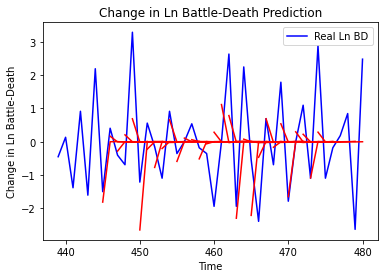

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Kenya', 'country_id': 237, 'step': 't+1', 'mse': 1.4241871605199052, 'mae': 0.8888042276937894, 'r2': 0.31269356254234837, 'tadda_score': 0.9127046133914721}
{'country': 'Kenya', 'country_id': 237, 'step': 't+2', 'mse': 3.6408658542427617, 'mae': 1.5464662717975652, 'r2': -0.907310397614818, 'tadda_score': 2.0239557814794256}
{'country': 'Kenya', 'country_id': 237, 'step': 't+3', 'mse': 3.2824756514598823, 'mae': 1.4014950299516757, 'r2': -0.5032528845570661, 'tadda_score': 1.695615263705993}
{'country': 'Kenya', 'country_id': 237, 'step': 't+4', 'mse': 4.083485873089477, 'mae': 1.6590166807940858, 'r2': -0.45407264358799737, 'tadda_score': 1.953948493378486}
{'country': 'Kenya', 'country_id': 237, 'step': 't+5', 'mse': 2.879953150869499, 'mae': 1.246376890394163, 'r2': -0.9014266156892043, 'tadda_score': 1.5841584148040133}
{'country': 'Kenya', 'country_id': 237, 'step': 't+6', 'mse': 2.663201140380906, 'mae': 

31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
31/31 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
31/31 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [=====================

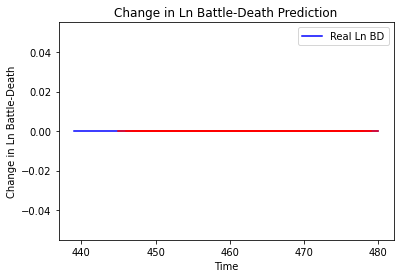

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tanzania', 'country_id': 242, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Morocco']
Building vanilla Model...
Model: "sequential_539"
_________________________________________________________________
Layer (type)       

41/41 [==============================] - 0s 6ms/step - loss: 0.0685 - val_loss: 8.7393e-05
Epoch 62/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0687 - val_loss: 4.5230e-06
Epoch 63/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0693 - val_loss: 1.9251e-05
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0694 - val_loss: 1.4366e-06
Epoch 65/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0705 - val_loss: 1.0084e-04
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0696 - val_loss: 2.8872e-06
Epoch 67/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0691 - val_loss: 1.0317e-05
Epoch 68/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0691 - val_loss: 4.8466e-06
Epoch 69/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0695 - val_loss: 1.2339e-05
Epoch 70/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0

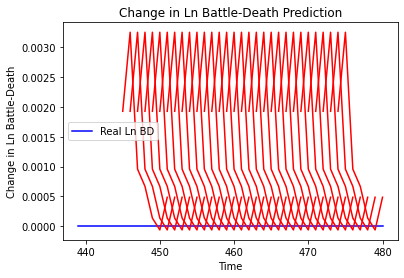

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Morocco', 'country_id': 243, 'step': 't+1', 'mse': 3.712508904796241e-06, 'mae': 0.0019267871975898743, 'r2': 0.0, 'tadda_score': 0.0019267871975898743}
{'country': 'Morocco', 'country_id': 243, 'step': 't+2', 'mse': 2.6837811651317595e-05, 'mae': 0.005180522333830595, 'r2': 0.0, 'tadda_score': 0.005180522333830595}
{'country': 'Morocco', 'country_id': 243, 'step': 't+3', 'mse': 3.7658418765234604e-05, 'mae': 0.006136645562946796, 'r2': 0.0, 'tadda_score': 0.006136645562946796}
{'country': 'Morocco', 'country_id': 243, 'step': 't+4', 'mse': 4.628706100289013e-05, 'mae': 0.006803459487855434, 'r2': 0.0, 'tadda_score': 0.006803459487855434}
{'country': 'Morocco', 'country_id': 243, 'step': 't+5', 'mse': 1.3568462071335502e-05, 'mae': 0.003683539340272546, 'r2': 0.0, 'tadda_score': 0.003683539340272546}
{'country': 'Morocco', 'country_id': 243, 'step': 't+6', 'mse': 1.3098799692627292e-05, 'mae': 0.0036192263942211

41/41 [==============================] - 0s 5ms/step - loss: 0.0626 - val_loss: 0.1137
Epoch 61/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0636 - val_loss: 0.1141
Epoch 62/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0624 - val_loss: 0.1143
Epoch 63/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0632 - val_loss: 0.1146
Epoch 64/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0622 - val_loss: 0.1151
Epoch 65/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0631 - val_loss: 0.1155
Epoch 66/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0643 - val_loss: 0.1163
Epoch 67/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0624 - val_loss: 0.1161
Epoch 68/100
41/41 [==============================] - 0s 5ms/step - loss: 0.0636 - val_loss: 0.1165
Epoch 69/100
41/41 [==============================] - 0s 6ms/step - loss: 0.0629 - val_loss: 0.1168
Epoch 70/100


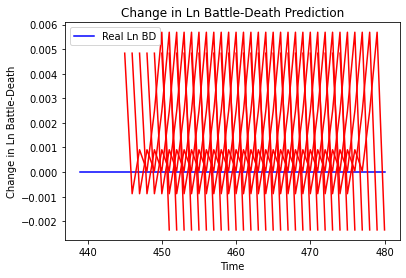

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritania', 'country_id': 244, 'step': 't+1', 'mse': 2.3379605145649324e-05, 'mae': 0.004835246130824089, 'r2': 0.0, 'tadda_score': 0.004835246130824089}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+2', 'mse': 1.5654912753629985e-05, 'mae': 0.00395662896335125, 'r2': 0.0, 'tadda_score': 0.00395662896335125}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+3', 'mse': 2.3667436870469273e-05, 'mae': 0.004864918999373913, 'r2': 0.0, 'tadda_score': 0.004864918999373913}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+4', 'mse': 2.4128806800582936e-05, 'mae': 0.0049121081829071045, 'r2': 0.0, 'tadda_score': 0.0049121081829071045}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+5', 'mse': 6.836457661782772e-05, 'mae': 0.008268287405371666, 'r2': 0.0, 'tadda_score': 0.008268287405371666}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+6', 'mse': 0.0001947586050219394, 'mae': 0.

7/7 [==============================] - 0s 9ms/step - loss: 3.1800 - val_loss: 0.9337
Epoch 62/100
7/7 [==============================] - 0s 10ms/step - loss: 3.1206 - val_loss: 0.9348
Epoch 63/100
7/7 [==============================] - 0s 9ms/step - loss: 3.1133 - val_loss: 0.9351
Epoch 64/100
7/7 [==============================] - 0s 9ms/step - loss: 3.1262 - val_loss: 0.9353
Epoch 65/100
7/7 [==============================] - 0s 9ms/step - loss: 3.0950 - val_loss: 0.9359
Epoch 66/100
7/7 [==============================] - 0s 12ms/step - loss: 3.1480 - val_loss: 0.9364
Epoch 67/100
7/7 [==============================] - 0s 10ms/step - loss: 3.1332 - val_loss: 0.9373
Epoch 68/100
7/7 [==============================] - 0s 9ms/step - loss: 3.1436 - val_loss: 0.9378
Epoch 69/100
7/7 [==============================] - 0s 10ms/step - loss: 3.1438 - val_loss: 0.9381
Epoch 70/100
7/7 [==============================] - 0s 8ms/step - loss: 3.0966 - val_loss: 0.9387
Epoch 71/100
7/7 [===========

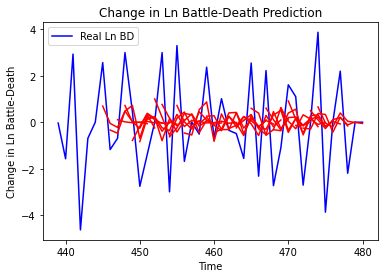

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sudan', 'country_id': 245, 'step': 't+1', 'mse': 2.8176931116085475, 'mae': 1.4625932201587686, 'r2': 0.29581339478731994, 'tadda_score': 1.5339769350830246}
{'country': 'Sudan', 'country_id': 245, 'step': 't+2', 'mse': 4.956913340252333, 'mae': 1.838439205734268, 'r2': -0.16175335291351245, 'tadda_score': 2.142527978815968}
{'country': 'Sudan', 'country_id': 245, 'step': 't+3', 'mse': 4.1247174252430865, 'mae': 1.6864319696916115, 'r2': -0.06360494129690974, 'tadda_score': 1.8261314183367263}
{'country': 'Sudan', 'country_id': 245, 'step': 't+4', 'mse': 3.7575751659306293, 'mae': 1.521945398853211, 'r2': -0.13176879191309787, 'tadda_score': 1.705696594894914}
{'country': 'Sudan', 'country_id': 245, 'step': 't+5', 'mse': 5.4486359585565785, 'mae': 1.9929117138379993, 'r2': -0.039260720849464414, 'tadda_score': 2.2148639415894134}
{'country': 'Sudan', 'country_id': 245, 'step': 't+6', 'mse': 5.536926224081236, 'm

7/7 [==============================] - 0s 6ms/step - loss: 6.3498 - val_loss: 4.0482
Epoch 62/100
7/7 [==============================] - 0s 6ms/step - loss: 6.2068 - val_loss: 4.0459
Epoch 63/100
7/7 [==============================] - 0s 6ms/step - loss: 6.2180 - val_loss: 4.0400
Epoch 64/100
7/7 [==============================] - 0s 6ms/step - loss: 6.3400 - val_loss: 4.0377
Epoch 65/100
7/7 [==============================] - 0s 6ms/step - loss: 6.2659 - val_loss: 4.0345
Epoch 66/100
7/7 [==============================] - 0s 6ms/step - loss: 6.3299 - val_loss: 4.0321
Epoch 67/100
7/7 [==============================] - 0s 6ms/step - loss: 6.1932 - val_loss: 4.0300
Epoch 68/100
7/7 [==============================] - 0s 7ms/step - loss: 6.2616 - val_loss: 4.0277
Epoch 69/100
7/7 [==============================] - 0s 6ms/step - loss: 6.3630 - val_loss: 4.0225
Epoch 70/100
7/7 [==============================] - 0s 6ms/step - loss: 6.2334 - val_loss: 4.0174
Epoch 71/100
7/7 [===============

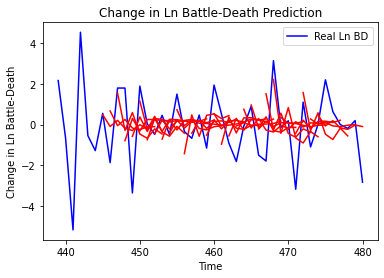

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Sudan', 'country_id': 246, 'step': 't+1', 'mse': 1.9181210358312972, 'mae': 1.0496388833615675, 'r2': 0.1377688343577287, 'tadda_score': 1.2833229239675896}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+2', 'mse': 3.8174727895129097, 'mae': 1.4768293064291185, 'r2': -0.4126292092184074, 'tadda_score': 1.7896056151841988}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+3', 'mse': 4.740691965379398, 'mae': 1.828389869020897, 'r2': -0.8131783705177271, 'tadda_score': 2.3544934465353866}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+4', 'mse': 4.641088404539209, 'mae': 1.7943418104760114, 'r2': -0.4723299393753053, 'tadda_score': 2.170282151233381}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+5', 'mse': 3.4607602340721, 'mae': 1.4124969403403107, 'r2': -0.37202036682084216, 'tadda_score': 1.6656060119924052}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+6',

In [38]:
np.random.seed(1)
tf.random.set_seed(1)
model = Sequential()
summary_model(dataset=df,
              modelname = "Vanilla",
              pred_africa=True,
              period=period_test, 
              epochs=100, 
              batch_size=6, 
              look_back=6, 
              look_forward=7,
              num_neurons=6, 
              val_split=0.2)

['Cape Verde']
Building vanilla Model...
Model: "sequential_544"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_532 (LSTM)              (None, 6)                 192       
_________________________________________________________________
dropout_1064 (Dropout)       (None, 6)                 0         
_________________________________________________________________
dense_1064 (Dense)           (None, 6)                 42        
_________________________________________________________________
dropout_1065 (Dropout)       (None, 6)                 0         
_________________________________________________________________
dense_1065 (Dense)           (None, 7)                 49        
Total params: 283
Trainable params: 283
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
31/31 [==============================] - 1s 18ms/step - loss: 0.000

31/31 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
31/31 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
31/31 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 70/100
31/31 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 71/100
31/31 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 72/100
31/31 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 73/100
31/31 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 74/100
31/31 [==============================] - 0s 11ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 75/100
31/31 [==============================] - 0s 11ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 76/100
31/31 [===================

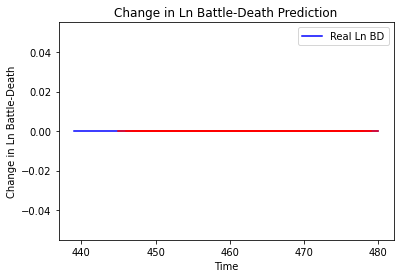

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
["Cote d'Ivoire"]
Building vanilla Model...
Model: "sequential_545"
_________________________________________________________________
Layer 

Epoch 64/100
31/31 [==============================] - 0s 7ms/step - loss: 0.5388 - val_loss: 0.2834
Epoch 65/100
31/31 [==============================] - 0s 7ms/step - loss: 0.5419 - val_loss: 0.2831
Epoch 66/100
31/31 [==============================] - 0s 11ms/step - loss: 0.5472 - val_loss: 0.2830
Epoch 67/100
31/31 [==============================] - 0s 9ms/step - loss: 0.5477 - val_loss: 0.2836
Epoch 68/100
31/31 [==============================] - 0s 9ms/step - loss: 0.5393 - val_loss: 0.2836
Epoch 69/100
31/31 [==============================] - 0s 9ms/step - loss: 0.5411 - val_loss: 0.2833
Epoch 70/100
31/31 [==============================] - 0s 9ms/step - loss: 0.5370 - val_loss: 0.2837
Epoch 71/100
31/31 [==============================] - 0s 9ms/step - loss: 0.5396 - val_loss: 0.2842
Epoch 72/100
31/31 [==============================] - 0s 7ms/step - loss: 0.5379 - val_loss: 0.2848
Epoch 73/100
31/31 [==============================] - 0s 8ms/step - loss: 0.5388 - val_loss: 0.2853

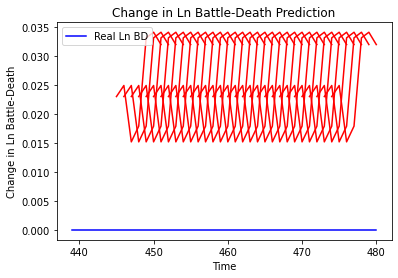

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+1', 'mse': 0.0005303095991838896, 'mae': 0.023028451949357986, 'r2': 0.0, 'tadda_score': 0.023028451949357986}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+2', 'mse': 0.0023011513422593333, 'mae': 0.04797031730413437, 'r2': 0.0, 'tadda_score': 0.04797031730413437}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+3', 'mse': 0.003991219040816674, 'mae': 0.06317609548568726, 'r2': 0.0, 'tadda_score': 0.06317609548568726}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+4', 'mse': 0.0065763366081786345, 'mae': 0.08109461516141891, 'r2': 0.0, 'tadda_score': 0.08109461516141891}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+5', 'mse': 0.007978646088411034, 'mae': 0.0893232673406601, 'r2': 0.0, 'tadda_score': 0.0893232673406601}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+6', 'mse': 0.015242534047770262, 'mae': 0.12346

Epoch 56/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
31/31 [========

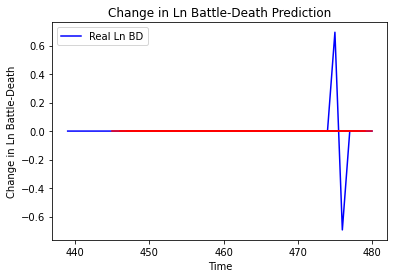

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ghana', 'country_id': 42, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Liberia']
Building vanilla Model...
Model: "sequential_547"
_________________________________________________________________
Layer (type)                 Output Shape      

Epoch 62/100
31/31 [==============================] - 0s 6ms/step - loss: 1.1930 - val_loss: 2.7886e-04
Epoch 63/100
31/31 [==============================] - 0s 8ms/step - loss: 1.1883 - val_loss: 4.5217e-04
Epoch 64/100
31/31 [==============================] - 0s 6ms/step - loss: 1.1818 - val_loss: 5.2458e-04
Epoch 65/100
31/31 [==============================] - 0s 6ms/step - loss: 1.1772 - val_loss: 3.4719e-04
Epoch 66/100
31/31 [==============================] - 0s 6ms/step - loss: 1.1937 - val_loss: 2.6796e-04
Epoch 67/100
31/31 [==============================] - 0s 6ms/step - loss: 1.2025 - val_loss: 6.6536e-04
Epoch 68/100
31/31 [==============================] - 0s 9ms/step - loss: 1.1849 - val_loss: 4.8830e-04
Epoch 69/100
31/31 [==============================] - 0s 9ms/step - loss: 1.1912 - val_loss: 7.0892e-04
Epoch 70/100
31/31 [==============================] - 0s 10ms/step - loss: 1.1951 - val_loss: 2.3691e-04
Epoch 71/100
31/31 [==============================] - 1s 18ms/s

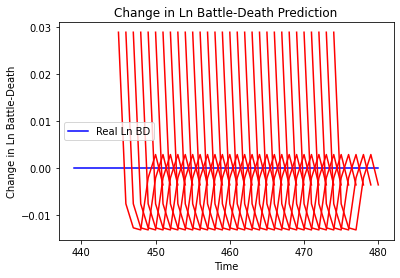

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Liberia', 'country_id': 43, 'step': 't+1', 'mse': 0.0008317655725039209, 'mae': 0.02884034626185894, 'r2': 0.0, 'tadda_score': 0.02884034626185894}
{'country': 'Liberia', 'country_id': 43, 'step': 't+2', 'mse': 0.0004540154335173942, 'mae': 0.02130763791501522, 'r2': 0.0, 'tadda_score': 0.02130763791501522}
{'country': 'Liberia', 'country_id': 43, 'step': 't+3', 'mse': 7.537310518127352e-05, 'mae': 0.00868176855146885, 'r2': 0.0, 'tadda_score': 0.00868176855146885}
{'country': 'Liberia', 'country_id': 43, 'step': 't+4', 'mse': 1.9255523795760378e-05, 'mae': 0.0043881116434931755, 'r2': 0.0, 'tadda_score': 0.0043881116434931755}
{'country': 'Liberia', 'country_id': 43, 'step': 't+5', 'mse': 1.2390133294836684e-06, 'mae': 0.0011131097562611103, 'r2': 0.0, 'tadda_score': 0.0011131097562611103}
{'country': 'Liberia', 'country_id': 43, 'step': 't+6', 'mse': 1.6176018656721908e-05, 'mae': 0.004021942149847746, 'r2': 0

Epoch 56/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
31/31 [========

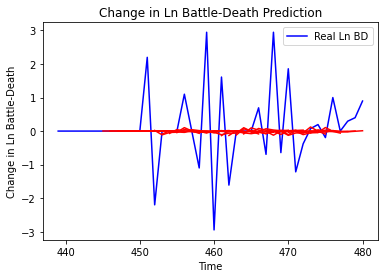

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+1', 'mse': 1.6742776543631133, 'mae': 0.8335248412330749, 'r2': -0.015278527382594831, 'tadda_score': 0.8465746639916477}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+2', 'mse': 1.2153790525381603, 'mae': 0.7374995573037526, 'r2': -0.027045985543387108, 'tadda_score': 0.749499747397866}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+3', 'mse': 2.079107497536221, 'mae': 0.9197378957385883, 'r2': -0.042883405759973625, 'tadda_score': 0.9401895886028871}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+4', 'mse': 2.449831263009633, 'mae': 1.0383192531516663, 'r2': -0.10361105329287468, 'tadda_score': 1.069929188651394}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+5', 'mse': 2.3406549435409576, 'mae': 0.950955364773219, 'r2': -0.12284161414109773, 'tadda_score': 0.968839185729171}
{'country': 'Burkina Faso', 'country_id': 47, 'step

31/31 [==============================] - 0s 6ms/step - loss: 0.2513 - val_loss: 8.7006e-05
Epoch 58/100
31/31 [==============================] - 0s 6ms/step - loss: 0.2519 - val_loss: 1.6842e-04
Epoch 59/100
31/31 [==============================] - 0s 6ms/step - loss: 0.2541 - val_loss: 1.0116e-04
Epoch 60/100
31/31 [==============================] - 0s 6ms/step - loss: 0.2604 - val_loss: 8.9302e-05
Epoch 61/100
31/31 [==============================] - 0s 6ms/step - loss: 0.2562 - val_loss: 5.3659e-05
Epoch 62/100
31/31 [==============================] - 0s 7ms/step - loss: 0.2537 - val_loss: 1.0575e-04
Epoch 63/100
31/31 [==============================] - 0s 6ms/step - loss: 0.2550 - val_loss: 1.5371e-04
Epoch 64/100
31/31 [==============================] - 0s 7ms/step - loss: 0.2590 - val_loss: 1.3319e-04
Epoch 65/100
31/31 [==============================] - 0s 6ms/step - loss: 0.2530 - val_loss: 1.9740e-04
Epoch 66/100
31/31 [==============================] - 0s 6ms/step - loss: 0.2

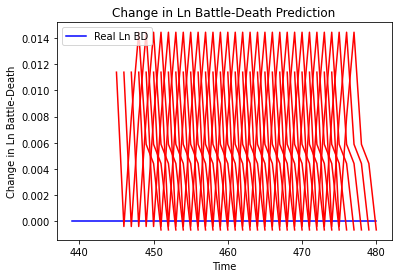

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea', 'country_id': 48, 'step': 't+1', 'mse': 0.00012999058336457623, 'mae': 0.011401341296732426, 'r2': 0.0, 'tadda_score': 0.011401341296732426}
{'country': 'Guinea', 'country_id': 48, 'step': 't+2', 'mse': 0.00012061875151584203, 'mae': 0.010982656851410866, 'r2': 0.0, 'tadda_score': 0.010982656851410866}
{'country': 'Guinea', 'country_id': 48, 'step': 't+3', 'mse': 0.00035799109361184245, 'mae': 0.0189206525683403, 'r2': 0.0, 'tadda_score': 0.0189206525683403}
{'country': 'Guinea', 'country_id': 48, 'step': 't+4', 'mse': 0.0011143941391811851, 'mae': 0.03338254243135452, 'r2': 0.0, 'tadda_score': 0.03338254243135452}
{'country': 'Guinea', 'country_id': 48, 'step': 't+5', 'mse': 0.0015743445640235137, 'mae': 0.03967801108956337, 'r2': 0.0, 'tadda_score': 0.03967801108956337}
{'country': 'Guinea', 'country_id': 48, 'step': 't+6', 'mse': 0.0019434448284991745, 'mae': 0.044084519147872925, 'r2': 0.0, 'tadda_s

31/31 [==============================] - 0s 5ms/step - loss: 0.6171 - val_loss: 3.1268e-04
Epoch 59/100
31/31 [==============================] - 0s 5ms/step - loss: 0.6141 - val_loss: 7.9758e-05
Epoch 60/100
31/31 [==============================] - 0s 5ms/step - loss: 0.5925 - val_loss: 1.1318e-04
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 0.5946 - val_loss: 5.5185e-04
Epoch 62/100
31/31 [==============================] - 0s 5ms/step - loss: 0.6183 - val_loss: 7.3267e-05
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 0.5933 - val_loss: 4.8558e-05
Epoch 64/100
31/31 [==============================] - 0s 5ms/step - loss: 0.6023 - val_loss: 1.5981e-04
Epoch 65/100
31/31 [==============================] - 0s 5ms/step - loss: 0.6102 - val_loss: 3.1029e-04
Epoch 66/100
31/31 [==============================] - 0s 5ms/step - loss: 0.6056 - val_loss: 6.6686e-04
Epoch 67/100
31/31 [==============================] - 0s 5ms/step - loss: 0.5

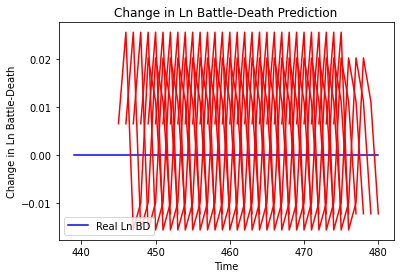

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+1', 'mse': 4.3044862145361074e-05, 'mae': 0.006560858339071274, 'r2': 0.0, 'tadda_score': 0.006560858339071274}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+2', 'mse': 0.0010327491176383014, 'mae': 0.03213641420006752, 'r2': 0.0, 'tadda_score': 0.03213641420006752}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+3', 'mse': 0.0002761696359380311, 'mae': 0.016618352383375168, 'r2': 0.0, 'tadda_score': 0.016618352383375168}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+4', 'mse': 4.5856482061571585e-05, 'mae': 0.006771741434931755, 'r2': 0.0, 'tadda_score': 0.006771741434931755}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+5', 'mse': 2.0191374262706896e-06, 'mae': 0.0014209635555744171, 'r2': 0.0, 'tadda_score': 0.0014209635555744171}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+6', 'mse': 0.0001587783070173135

Epoch 60/100
31/31 [==============================] - 0s 7ms/step - loss: 1.2698 - val_loss: 3.0042
Epoch 61/100
31/31 [==============================] - 0s 8ms/step - loss: 1.2836 - val_loss: 3.0019
Epoch 62/100
31/31 [==============================] - 0s 8ms/step - loss: 1.2686 - val_loss: 3.0040
Epoch 63/100
31/31 [==============================] - 0s 8ms/step - loss: 1.2668 - val_loss: 3.0062
Epoch 64/100
31/31 [==============================] - 0s 11ms/step - loss: 1.2694 - val_loss: 3.0063
Epoch 65/100
31/31 [==============================] - 0s 9ms/step - loss: 1.2756 - val_loss: 3.0103
Epoch 66/100
31/31 [==============================] - 0s 9ms/step - loss: 1.2680 - val_loss: 3.0093
Epoch 67/100
31/31 [==============================] - 0s 9ms/step - loss: 1.2829 - val_loss: 3.0092
Epoch 68/100
31/31 [==============================] - 0s 8ms/step - loss: 1.2569 - val_loss: 3.0114
Epoch 69/100
31/31 [==============================] - 0s 8ms/step - loss: 1.2692 - val_loss: 3.0115

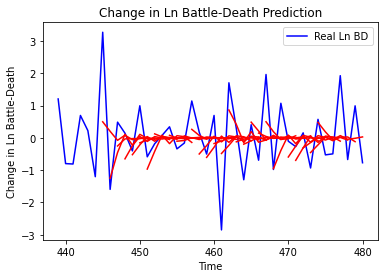

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mali', 'country_id': 50, 'step': 't+1', 'mse': 0.8423253270764588, 'mae': 0.6678257658796004, 'r2': 0.3327668247172927, 'tadda_score': 0.7512103660371394}
{'country': 'Mali', 'country_id': 50, 'step': 't+2', 'mse': 1.781559727690806, 'mae': 1.058198559666421, 'r2': -0.8401140791407176, 'tadda_score': 1.4129885254524612}
{'country': 'Mali', 'country_id': 50, 'step': 't+3', 'mse': 1.6083486915673073, 'mae': 1.0704666088651689, 'r2': -0.4166977878157383, 'tadda_score': 1.3992682015529345}
{'country': 'Mali', 'country_id': 50, 'step': 't+4', 'mse': 2.367717472719728, 'mae': 1.2714552020021321, 'r2': -0.583295346190644, 'tadda_score': 1.6793265847477357}
{'country': 'Mali', 'country_id': 50, 'step': 't+5', 'mse': 1.8442154871567171, 'mae': 1.1160037203590107, 'r2': -0.7032211496946046, 'tadda_score': 1.3917574876507155}
{'country': 'Mali', 'country_id': 50, 'step': 't+6', 'mse': 2.0770999961621346, 'mae': 1.178914586

31/31 [==============================] - 0s 6ms/step - loss: 1.6239 - val_loss: 0.4296
Epoch 61/100
31/31 [==============================] - 0s 7ms/step - loss: 1.6393 - val_loss: 0.4297
Epoch 62/100
31/31 [==============================] - 0s 6ms/step - loss: 1.6347 - val_loss: 0.4289
Epoch 63/100
31/31 [==============================] - 0s 6ms/step - loss: 1.6354 - val_loss: 0.4300
Epoch 64/100
31/31 [==============================] - 0s 6ms/step - loss: 1.6357 - val_loss: 0.4301
Epoch 65/100
31/31 [==============================] - 0s 6ms/step - loss: 1.6372 - val_loss: 0.4301
Epoch 66/100
31/31 [==============================] - 0s 7ms/step - loss: 1.6257 - val_loss: 0.4290
Epoch 67/100
31/31 [==============================] - 0s 7ms/step - loss: 1.6367 - val_loss: 0.4293
Epoch 68/100
31/31 [==============================] - 0s 7ms/step - loss: 1.6264 - val_loss: 0.4295
Epoch 69/100
31/31 [==============================] - 0s 8ms/step - loss: 1.6384 - val_loss: 0.4301
Epoch 70/100


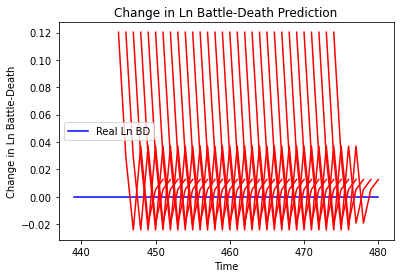

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Senegal', 'country_id': 52, 'step': 't+1', 'mse': 0.014455667762727276, 'mae': 0.12023172527551651, 'r2': 0.0, 'tadda_score': 0.12023172527551651}
{'country': 'Senegal', 'country_id': 52, 'step': 't+2', 'mse': 0.022188334101485907, 'mae': 0.1489574909210205, 'r2': 0.0, 'tadda_score': 0.1489574909210205}
{'country': 'Senegal', 'country_id': 52, 'step': 't+3', 'mse': 0.015552058461049123, 'mae': 0.124707892537117, 'r2': 0.0, 'tadda_score': 0.124707892537117}
{'country': 'Senegal', 'country_id': 52, 'step': 't+4', 'mse': 0.026153871760371317, 'mae': 0.1617215871810913, 'r2': 0.0, 'tadda_score': 0.1617215871810913}
{'country': 'Senegal', 'country_id': 52, 'step': 't+5', 'mse': 0.012937803886146959, 'mae': 0.11374446749687195, 'r2': 0.0, 'tadda_score': 0.11374446749687195}
{'country': 'Senegal', 'country_id': 52, 'step': 't+6', 'mse': 0.014185013376073252, 'mae': 0.11910085380077362, 'r2': 0.0, 'tadda_score': 0.11910

31/31 [==============================] - 0s 5ms/step - loss: 2.1510 - val_loss: 0.0012
Epoch 60/100
31/31 [==============================] - 0s 5ms/step - loss: 2.1753 - val_loss: 6.4982e-04
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 2.1599 - val_loss: 0.0011
Epoch 62/100
31/31 [==============================] - 0s 5ms/step - loss: 2.1515 - val_loss: 0.0012
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 2.1711 - val_loss: 6.6569e-04
Epoch 64/100
31/31 [==============================] - 0s 6ms/step - loss: 2.1406 - val_loss: 9.4464e-04
Epoch 65/100
31/31 [==============================] - 0s 5ms/step - loss: 2.1630 - val_loss: 9.6647e-04
Epoch 66/100
31/31 [==============================] - 0s 6ms/step - loss: 2.1357 - val_loss: 9.1943e-04
Epoch 67/100
31/31 [==============================] - 0s 5ms/step - loss: 2.1358 - val_loss: 6.5034e-04
Epoch 68/100
31/31 [==============================] - 0s 5ms/step - loss: 2.1683 - val_lo

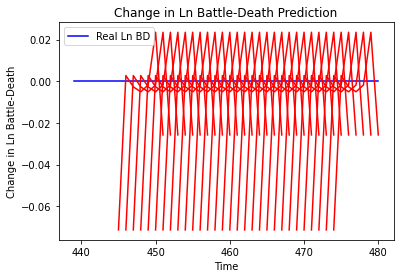

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+1', 'mse': 0.005096147437342546, 'mae': 0.07138730585575104, 'r2': 0.0, 'tadda_score': 0.07138730585575104}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+2', 'mse': 0.004713691009229137, 'mae': 0.068656325340271, 'r2': 0.0, 'tadda_score': 0.068656325340271}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+3', 'mse': 0.005088903722688665, 'mae': 0.07133655250072479, 'r2': 0.0, 'tadda_score': 0.07133655250072479}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+4', 'mse': 0.005836491629736484, 'mae': 0.07639693468809128, 'r2': 0.0, 'tadda_score': 0.07639693468809128}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+5', 'mse': 0.006549779795022914, 'mae': 0.08093070983886719, 'r2': 0.0, 'tadda_score': 0.08093070983886719}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+6', 'mse': 0.0032940876729688068, 'mae': 0.05739414319396019

Epoch 56/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
31/31 [========

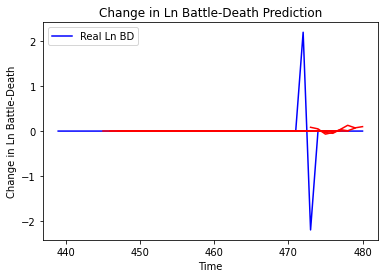

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'The Gambia', 'country_id': 54, 'step': 't+1', 'mse': 0.3344635006101058, 'mae': 0.14996411150983358, 'r2': -0.03918075081110084, 'tadda_score': 0.1527766746410865}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+2', 'mse': 0.3206260668255155, 'mae': 0.15051594397715115, 'r2': 0.00381226577617777, 'tadda_score': 0.15051594397715115}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+3', 'mse': 0.16120023594117155, 'mae': 0.07751101607477359, 'r2': -0.03624223256999781, 'tadda_score': 0.07751101607477359}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+4', 'mse': 0.16098918190446462, 'mae': 0.0752661927729417, 'r2': -0.03488551553473296, 'tadda_score': 0.0752661927729417}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+5', 'mse': 0.16154135505451395, 'mae': 0.07832870462929896, 'r2': -0.0384350459335665, 'tadda_score': 0.07832870462929896}
{'country': 'The Gambia', 'country_id': 54, 'step'

31/31 [==============================] - 0s 6ms/step - loss: 0.6187 - val_loss: 3.0946e-04
Epoch 58/100
31/31 [==============================] - 0s 7ms/step - loss: 0.6263 - val_loss: 6.5920e-04
Epoch 59/100
31/31 [==============================] - 0s 7ms/step - loss: 0.6164 - val_loss: 2.4539e-04
Epoch 60/100
31/31 [==============================] - 0s 6ms/step - loss: 0.6245 - val_loss: 4.7797e-04
Epoch 61/100
31/31 [==============================] - 0s 6ms/step - loss: 0.6184 - val_loss: 5.7967e-04
Epoch 62/100
31/31 [==============================] - 0s 6ms/step - loss: 0.6103 - val_loss: 3.2445e-04
Epoch 63/100
31/31 [==============================] - 0s 7ms/step - loss: 0.6277 - val_loss: 3.1888e-04
Epoch 64/100
31/31 [==============================] - 0s 6ms/step - loss: 0.6192 - val_loss: 3.5229e-04
Epoch 65/100
31/31 [==============================] - 0s 5ms/step - loss: 0.6161 - val_loss: 6.2788e-04
Epoch 66/100
31/31 [==============================] - 0s 6ms/step - loss: 0.6

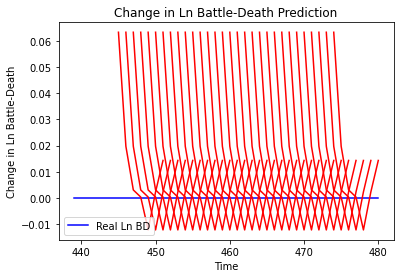

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Djibouti', 'country_id': 55, 'step': 't+1', 'mse': 0.004019174600245812, 'mae': 0.06339696049690247, 'r2': 0.0, 'tadda_score': 0.06339696049690247}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+2', 'mse': 0.00690938456919149, 'mae': 0.08312270790338516, 'r2': 0.0, 'tadda_score': 0.08312270790338516}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+3', 'mse': 0.0074194410195629334, 'mae': 0.08613617718219757, 'r2': 0.0, 'tadda_score': 0.08613617718219757}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+4', 'mse': 0.007469370590183433, 'mae': 0.08642552047967911, 'r2': 0.0, 'tadda_score': 0.08642552047967911}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+5', 'mse': 0.002959741488962886, 'mae': 0.054403506219387054, 'r2': 0.0, 'tadda_score': 0.054403506219387054}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+6', 'mse': 0.003211789407717172, 'mae': 0.05667265132069588, 'r2': 0.0, 'tadda

27/27 [==============================] - 0s 5ms/step - loss: 1.9328 - val_loss: 0.0303
Epoch 61/100
27/27 [==============================] - 0s 5ms/step - loss: 1.9292 - val_loss: 0.0293
Epoch 62/100
27/27 [==============================] - 0s 5ms/step - loss: 1.9589 - val_loss: 0.0300
Epoch 63/100
27/27 [==============================] - 0s 5ms/step - loss: 1.9333 - val_loss: 0.0297
Epoch 64/100
27/27 [==============================] - 0s 5ms/step - loss: 1.9332 - val_loss: 0.0295
Epoch 65/100
27/27 [==============================] - 0s 5ms/step - loss: 1.9467 - val_loss: 0.0298
Epoch 66/100
27/27 [==============================] - 0s 5ms/step - loss: 1.9610 - val_loss: 0.0298
Epoch 67/100
27/27 [==============================] - 0s 5ms/step - loss: 1.9436 - val_loss: 0.0294
Epoch 68/100
27/27 [==============================] - 0s 5ms/step - loss: 1.9275 - val_loss: 0.0315
Epoch 69/100
27/27 [==============================] - 0s 5ms/step - loss: 1.9392 - val_loss: 0.0311
Epoch 70/100


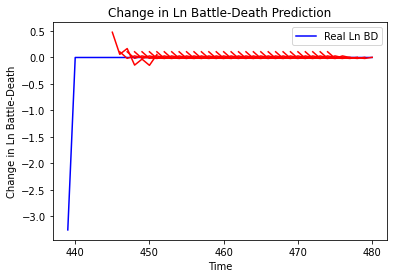

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Eritrea', 'country_id': 56, 'step': 't+1', 'mse': 0.018775599677690692, 'mae': 0.11991484438379606, 'r2': 0.0, 'tadda_score': 0.11991484438379606}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+2', 'mse': 0.017616950535617366, 'mae': 0.10595602815349897, 'r2': 0.0, 'tadda_score': 0.10595602815349897}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+3', 'mse': 0.03065731860065879, 'mae': 0.14017023891210556, 'r2': 0.0, 'tadda_score': 0.14017023891210556}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+4', 'mse': 0.02427809122363141, 'mae': 0.1340847708284855, 'r2': 0.0, 'tadda_score': 0.1340847708284855}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+5', 'mse': 0.024038984928353723, 'mae': 0.14255353510379792, 'r2': 0.0, 'tadda_score': 0.14255353510379792}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+6', 'mse': 0.0158378100902934, 'mae': 0.12009937216838201, 'r2': 0.0, 'tadda_score': 0.120

27/27 [==============================] - 0s 7ms/step - loss: 4.5646 - val_loss: 2.6150
Epoch 61/100
27/27 [==============================] - 0s 7ms/step - loss: 4.5504 - val_loss: 2.6151
Epoch 62/100
27/27 [==============================] - 0s 8ms/step - loss: 4.5773 - val_loss: 2.6136
Epoch 63/100
27/27 [==============================] - 0s 7ms/step - loss: 4.5213 - val_loss: 2.6126
Epoch 64/100
27/27 [==============================] - 0s 7ms/step - loss: 4.5423 - val_loss: 2.6134
Epoch 65/100
27/27 [==============================] - 0s 7ms/step - loss: 4.5283 - val_loss: 2.6138
Epoch 66/100
27/27 [==============================] - 0s 6ms/step - loss: 4.5465 - val_loss: 2.6128
Epoch 67/100
27/27 [==============================] - 0s 6ms/step - loss: 4.5553 - val_loss: 2.6116
Epoch 68/100
27/27 [==============================] - 0s 6ms/step - loss: 4.5426 - val_loss: 2.6113
Epoch 69/100
27/27 [==============================] - 0s 6ms/step - loss: 4.4983 - val_loss: 2.6110
Epoch 70/100


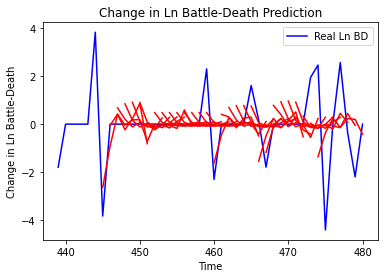

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+1', 'mse': 1.2399189742093142, 'mae': 0.8659349107360845, 'r2': 0.09112915214329631, 'tadda_score': 0.9628940446790064}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+2', 'mse': 4.151752725289031, 'mae': 1.4919831567686506, 'r2': -1.0808333842329003, 'tadda_score': 1.6968501601300345}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+3', 'mse': 4.1296775926980125, 'mae': 1.4870654616437067, 'r2': -1.0697694611391761, 'tadda_score': 1.7237110613467006}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+4', 'mse': 4.338969840120433, 'mae': 1.5121782790801634, 'r2': -1.1746654711652522, 'tadda_score': 1.7623324037772128}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+5', 'mse': 3.2775745204808486, 'mae': 1.2452771726927867, 'r2': -0.6427005490922875, 'tadda_score': 1.4095318167092115}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+6', 'mse': 2.698574064

Epoch 60/100
31/31 [==============================] - 0s 6ms/step - loss: 0.9096 - val_loss: 1.0006
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 0.9209 - val_loss: 1.0007
Epoch 62/100
31/31 [==============================] - 0s 5ms/step - loss: 0.9176 - val_loss: 1.0006
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 0.9283 - val_loss: 1.0021
Epoch 64/100
31/31 [==============================] - 0s 5ms/step - loss: 0.9243 - val_loss: 1.0007
Epoch 65/100
31/31 [==============================] - 0s 5ms/step - loss: 0.9200 - val_loss: 1.0012
Epoch 66/100
31/31 [==============================] - 0s 5ms/step - loss: 0.9217 - val_loss: 1.0006
Epoch 67/100
31/31 [==============================] - 0s 5ms/step - loss: 0.9177 - val_loss: 1.0006
Epoch 68/100
31/31 [==============================] - 0s 5ms/step - loss: 0.9216 - val_loss: 1.0013
Epoch 69/100
31/31 [==============================] - 0s 5ms/step - loss: 0.9250 - val_loss: 1.0019


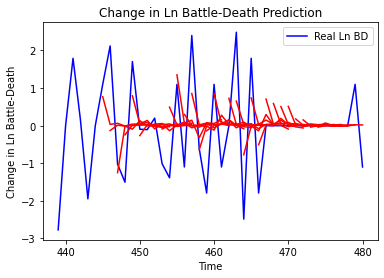

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Algeria', 'country_id': 67, 'step': 't+1', 'mse': 1.057898392770141, 'mae': 0.7963365196759539, 'r2': 0.3366864919662683, 'tadda_score': 0.8306395826439099}
{'country': 'Algeria', 'country_id': 67, 'step': 't+2', 'mse': 2.2987026013831215, 'mae': 1.1533172815662003, 'r2': -0.3648630610538335, 'tadda_score': 1.400352542313077}
{'country': 'Algeria', 'country_id': 67, 'step': 't+3', 'mse': 2.65352195134002, 'mae': 1.2714456957723708, 'r2': -0.47921872757703254, 'tadda_score': 1.5598014033979188}
{'country': 'Algeria', 'country_id': 67, 'step': 't+4', 'mse': 2.819005604399641, 'mae': 1.2901234880531856, 'r2': -0.3808577733403833, 'tadda_score': 1.539652466321491}
{'country': 'Algeria', 'country_id': 67, 'step': 't+5', 'mse': 2.1006263783628585, 'mae': 1.061465733618273, 'r2': -0.5609097861043906, 'tadda_score': 1.2762381939795946}
{'country': 'Algeria', 'country_id': 67, 'step': 't+6', 'mse': 2.199222201457362, 'ma

31/31 [==============================] - 0s 10ms/step - loss: 0.1851 - val_loss: 1.4626
Epoch 60/100
31/31 [==============================] - 0s 7ms/step - loss: 0.1822 - val_loss: 1.4609
Epoch 61/100
31/31 [==============================] - 0s 7ms/step - loss: 0.1807 - val_loss: 1.4624
Epoch 62/100
31/31 [==============================] - 0s 7ms/step - loss: 0.1859 - val_loss: 1.4604
Epoch 63/100
31/31 [==============================] - 0s 7ms/step - loss: 0.1861 - val_loss: 1.4597
Epoch 64/100
31/31 [==============================] - 0s 7ms/step - loss: 0.1865 - val_loss: 1.4585
Epoch 65/100
31/31 [==============================] - 0s 7ms/step - loss: 0.1847 - val_loss: 1.4593
Epoch 66/100
31/31 [==============================] - 0s 6ms/step - loss: 0.1818 - val_loss: 1.4590
Epoch 67/100
31/31 [==============================] - 0s 7ms/step - loss: 0.1881 - val_loss: 1.4584
Epoch 68/100
31/31 [==============================] - 0s 7ms/step - loss: 0.1836 - val_loss: 1.4589
Epoch 69/100

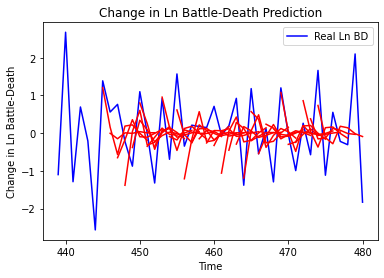

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cameroon', 'country_id': 69, 'step': 't+1', 'mse': 0.559405988911639, 'mae': 0.6319241086049332, 'r2': 0.2404097009104128, 'tadda_score': 0.728151074582433}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+2', 'mse': 1.7822523581249032, 'mae': 1.1627359412492868, 'r2': -1.4145650280598412, 'tadda_score': 1.6132092224937238}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+3', 'mse': 1.3923357031307804, 'mae': 0.9602857141289961, 'r2': -0.42074636632143503, 'tadda_score': 1.147765514984116}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+4', 'mse': 1.5354110909502898, 'mae': 0.9608803628510745, 'r2': -0.7434191474730192, 'tadda_score': 1.210917915888281}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+5', 'mse': 1.920576539964332, 'mae': 1.1484076593056982, 'r2': -0.9308386172663314, 'tadda_score': 1.4887692057823803}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+6', 'mse': 2.096793393622

31/31 [==============================] - 0s 5ms/step - loss: 0.7274 - val_loss: 2.3863
Epoch 60/100
31/31 [==============================] - 0s 5ms/step - loss: 0.7273 - val_loss: 2.3844
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 0.7176 - val_loss: 2.3804
Epoch 62/100
31/31 [==============================] - 0s 6ms/step - loss: 0.7176 - val_loss: 2.3789
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 0.7100 - val_loss: 2.3851
Epoch 64/100
31/31 [==============================] - 0s 5ms/step - loss: 0.7155 - val_loss: 2.3844
Epoch 65/100
31/31 [==============================] - 0s 5ms/step - loss: 0.7131 - val_loss: 2.3828
Epoch 66/100
31/31 [==============================] - 0s 5ms/step - loss: 0.7229 - val_loss: 2.3827
Epoch 67/100
31/31 [==============================] - 0s 5ms/step - loss: 0.7104 - val_loss: 2.3845
Epoch 68/100
31/31 [==============================] - 0s 5ms/step - loss: 0.7153 - val_loss: 2.3844
Epoch 69/100


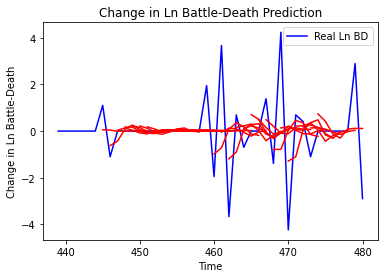

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+1', 'mse': 1.8854760777516972, 'mae': 0.8525097557384694, 'r2': 0.28708315990355904, 'tadda_score': 0.8621322107542481}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+2', 'mse': 2.344671036549316, 'mae': 1.1338187000971807, 'r2': -0.6015805753352994, 'tadda_score': 1.254948066355961}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+3', 'mse': 2.6208256806585575, 'mae': 1.0651166916399428, 'r2': -0.11818580211231322, 'tadda_score': 1.1643370400378334}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+4', 'mse': 3.126707998708811, 'mae': 1.1655519593089443, 'r2': -0.2932856759434548, 'tadda_score': 1.2642379500796017}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+5', 'mse': 2.835805075644313, 'mae': 0.9595259953593687, 'r2': -0.11903404282758667, 'tadda_score': 1.0066410207803

31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 57/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 58/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 59/100
31/31 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 60/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 62/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 64/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 65/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0

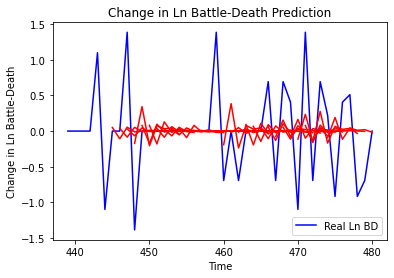

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tunisia', 'country_id': 73, 'step': 't+1', 'mse': 0.3649384011527977, 'mae': 0.39834876279585935, 'r2': 0.11603089817663537, 'tadda_score': 0.4041252351855574}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+2', 'mse': 0.3930873097815621, 'mae': 0.426775848610437, 'r2': 0.044736481344820445, 'tadda_score': 0.4388514028794925}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+3', 'mse': 0.48776451344712574, 'mae': 0.47029963307192185, 'r2': -0.02084588504496665, 'tadda_score': 0.47488972337405144}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+4', 'mse': 0.49442527304955186, 'mae': 0.4590380735742362, 'r2': -0.023931869145592533, 'tadda_score': 0.4608115183546952}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+5', 'mse': 0.5035340868003977, 'mae': 0.5061849248203899, 'r2': -0.1445553108840325, 'tadda_score': 0.5466983739826347}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+6', 'mse': 0.59789

31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [=====================

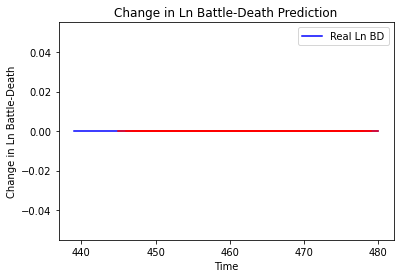

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Benin', 'country_id': 74, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Equatorial Guinea']
Building vanilla Model...
Model: "sequential_563"
_________________________________________________________________
Layer (type)                 Output S

31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
31/31 [=====================

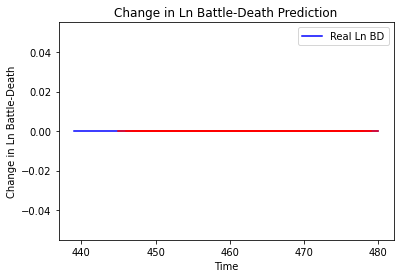

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Niger']
Building vanilla Model...
Model: "sequential_564"
_______________________________

31/31 [==============================] - 0s 6ms/step - loss: 0.8519 - val_loss: 1.6309
Epoch 64/100
31/31 [==============================] - 0s 9ms/step - loss: 0.8430 - val_loss: 1.6301
Epoch 65/100
31/31 [==============================] - 0s 10ms/step - loss: 0.8517 - val_loss: 1.6311
Epoch 66/100
31/31 [==============================] - 0s 10ms/step - loss: 0.8574 - val_loss: 1.6307
Epoch 67/100
31/31 [==============================] - 0s 8ms/step - loss: 0.8599 - val_loss: 1.6310
Epoch 68/100
31/31 [==============================] - 0s 6ms/step - loss: 0.8438 - val_loss: 1.6312
Epoch 69/100
31/31 [==============================] - 0s 6ms/step - loss: 0.8561 - val_loss: 1.6301
Epoch 70/100
31/31 [==============================] - 0s 6ms/step - loss: 0.8383 - val_loss: 1.6300
Epoch 71/100
31/31 [==============================] - 0s 6ms/step - loss: 0.8577 - val_loss: 1.6303
Epoch 72/100
31/31 [==============================] - 0s 5ms/step - loss: 0.8408 - val_loss: 1.6292
Epoch 73/10

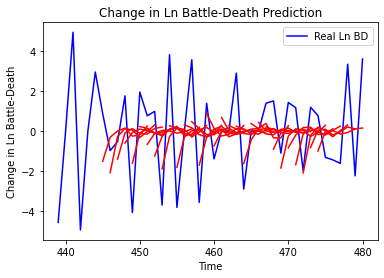

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Niger', 'country_id': 78, 'step': 't+1', 'mse': 3.341958427742063, 'mae': 1.5757092726656927, 'r2': 0.22851790332090216, 'tadda_score': 1.883824904007627}
{'country': 'Niger', 'country_id': 78, 'step': 't+2', 'mse': 6.595482057051196, 'mae': 2.1453321526744857, 'r2': -0.6796042684359687, 'tadda_score': 2.6378284514247268}
{'country': 'Niger', 'country_id': 78, 'step': 't+3', 'mse': 6.137554148761895, 'mae': 1.9454727423890765, 'r2': -0.5846886961611912, 'tadda_score': 2.4664197576745677}
{'country': 'Niger', 'country_id': 78, 'step': 't+4', 'mse': 6.436214890188497, 'mae': 2.113718536313343, 'r2': -0.4185346660513516, 'tadda_score': 2.5494235106467884}
{'country': 'Niger', 'country_id': 78, 'step': 't+5', 'mse': 7.851491580705832, 'mae': 2.2522629186273977, 'r2': -0.4273290045197051, 'tadda_score': 2.733635033891735}
{'country': 'Niger', 'country_id': 78, 'step': 't+6', 'mse': 7.460002628739654, 'mae': 2.1372614

31/31 [==============================] - 0s 7ms/step - loss: 0.5282 - val_loss: 1.1910
Epoch 61/100
31/31 [==============================] - 0s 8ms/step - loss: 0.5274 - val_loss: 1.1926
Epoch 62/100
31/31 [==============================] - 0s 8ms/step - loss: 0.5238 - val_loss: 1.1946
Epoch 63/100
31/31 [==============================] - 0s 7ms/step - loss: 0.5300 - val_loss: 1.1958
Epoch 64/100
31/31 [==============================] - 0s 8ms/step - loss: 0.5328 - val_loss: 1.1933
Epoch 65/100
31/31 [==============================] - 0s 7ms/step - loss: 0.5259 - val_loss: 1.1949
Epoch 66/100
31/31 [==============================] - 0s 7ms/step - loss: 0.5353 - val_loss: 1.1943
Epoch 67/100
31/31 [==============================] - 0s 9ms/step - loss: 0.5368 - val_loss: 1.1950
Epoch 68/100
31/31 [==============================] - 0s 9ms/step - loss: 0.5320 - val_loss: 1.1993
Epoch 69/100
31/31 [==============================] - 0s 12ms/step - loss: 0.5362 - val_loss: 1.1944
Epoch 70/100

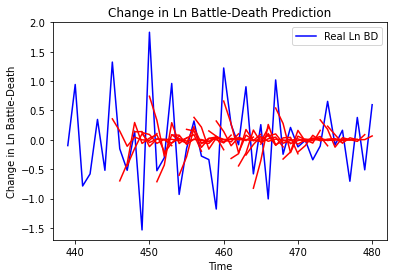

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Nigeria', 'country_id': 79, 'step': 't+1', 'mse': 0.4344005080677634, 'mae': 0.49681206579192266, 'r2': 0.23990246044620323, 'tadda_score': 0.5608694859860717}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+2', 'mse': 1.2313870615736866, 'mae': 0.896028146051849, 'r2': -1.2758360270257691, 'tadda_score': 1.1996334964382}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+3', 'mse': 1.0117057227089525, 'mae': 0.808178210786668, 'r2': -0.6512525637282223, 'tadda_score': 1.0247680728948985}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+4', 'mse': 1.1860904266082735, 'mae': 0.8570981581284008, 'r2': -0.5944735901367102, 'tadda_score': 1.1199906655796767}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+5', 'mse': 0.7728302140984468, 'mae': 0.6792549947212113, 'r2': -0.509542846075145, 'tadda_score': 0.8391973629218811}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+6', 'mse': 0.7647950424170797, 

31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [=====================

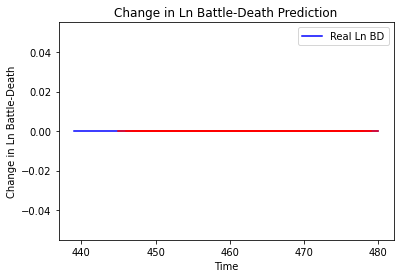

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Togo']
Building vanilla Model...
Model: "sequential_567"
____

31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
31/31 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
31/31 [=====================

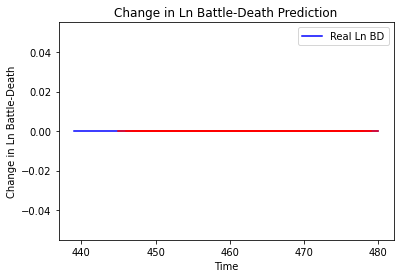

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Togo', 'country_id': 81, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Somalia']
Building vanilla Model...
Model: "sequential_568"
_________________________________________________________________
Layer (type)                 Output Shape             

31/31 [==============================] - 0s 6ms/step - loss: 2.5379 - val_loss: 0.3699
Epoch 65/100
31/31 [==============================] - 0s 6ms/step - loss: 2.5781 - val_loss: 0.3701
Epoch 66/100
31/31 [==============================] - 0s 7ms/step - loss: 2.5655 - val_loss: 0.3699
Epoch 67/100
31/31 [==============================] - 0s 6ms/step - loss: 2.5569 - val_loss: 0.3697
Epoch 68/100
31/31 [==============================] - 0s 7ms/step - loss: 2.5833 - val_loss: 0.3688
Epoch 69/100
31/31 [==============================] - 0s 6ms/step - loss: 2.5598 - val_loss: 0.3686
Epoch 70/100
31/31 [==============================] - 0s 6ms/step - loss: 2.5514 - val_loss: 0.3700
Epoch 71/100
31/31 [==============================] - 0s 8ms/step - loss: 2.5855 - val_loss: 0.3691
Epoch 72/100
31/31 [==============================] - 0s 8ms/step - loss: 2.5442 - val_loss: 0.3692
Epoch 73/100
31/31 [==============================] - 0s 9ms/step - loss: 2.5927 - val_loss: 0.3692
Epoch 74/100


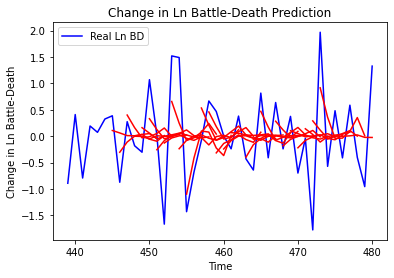

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Somalia', 'country_id': 120, 'step': 't+1', 'mse': 0.5349695037051154, 'mae': 0.5559041369648021, 'r2': 0.29774274094788966, 'tadda_score': 0.6313165899928652}
{'country': 'Somalia', 'country_id': 120, 'step': 't+2', 'mse': 1.4033614209876601, 'mae': 0.9036728295678261, 'r2': -0.4310787788737349, 'tadda_score': 1.1163695351401333}
{'country': 'Somalia', 'country_id': 120, 'step': 't+3', 'mse': 1.3653907678355328, 'mae': 0.8551658115126287, 'r2': -0.7108155127444422, 'tadda_score': 1.0788885168197349}
{'country': 'Somalia', 'country_id': 120, 'step': 't+4', 'mse': 1.0576495070700305, 'mae': 0.8471919688060976, 'r2': -0.5257964811956646, 'tadda_score': 1.017949919958919}
{'country': 'Somalia', 'country_id': 120, 'step': 't+5', 'mse': 0.9216627874927039, 'mae': 0.7140767620546009, 'r2': -0.19557437678195755, 'tadda_score': 0.8711198517101393}
{'country': 'Somalia', 'country_id': 120, 'step': 't+6', 'mse': 1.0687945

31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [=====================

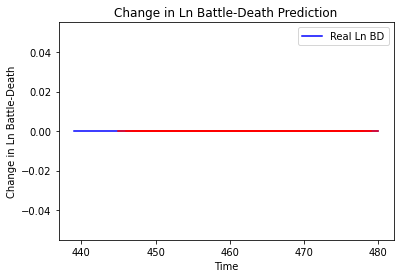

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Botswana', 'country_id': 154, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Burundi']
Building vanilla Model...
Model: "sequential_570"
_________________________________________________________________
Layer (type)       

Epoch 64/100
31/31 [==============================] - 0s 7ms/step - loss: 1.9145 - val_loss: 1.6147
Epoch 65/100
31/31 [==============================] - 0s 6ms/step - loss: 1.9224 - val_loss: 1.6141
Epoch 66/100
31/31 [==============================] - 0s 6ms/step - loss: 1.9155 - val_loss: 1.6135
Epoch 67/100
31/31 [==============================] - 0s 6ms/step - loss: 1.9230 - val_loss: 1.6137
Epoch 68/100
31/31 [==============================] - 0s 6ms/step - loss: 1.9050 - val_loss: 1.6139
Epoch 69/100
31/31 [==============================] - 0s 6ms/step - loss: 1.9286 - val_loss: 1.6136
Epoch 70/100
31/31 [==============================] - 0s 6ms/step - loss: 1.9262 - val_loss: 1.6142
Epoch 71/100
31/31 [==============================] - 0s 6ms/step - loss: 1.9298 - val_loss: 1.6128
Epoch 72/100
31/31 [==============================] - 0s 6ms/step - loss: 1.9279 - val_loss: 1.6140
Epoch 73/100
31/31 [==============================] - 0s 7ms/step - loss: 1.9219 - val_loss: 1.6133


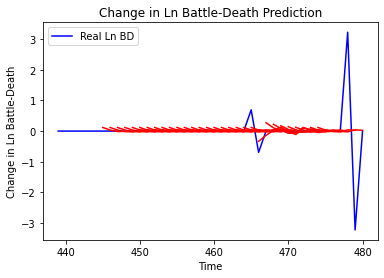

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burundi', 'country_id': 155, 'step': 't+1', 'mse': 0.032298124043882485, 'mae': 0.1526079410038201, 'r2': -0.008364702944126279, 'tadda_score': 0.1526079410038201}
{'country': 'Burundi', 'country_id': 155, 'step': 't+2', 'mse': 0.07983300616822753, 'mae': 0.2147663885078637, 'r2': -1.4924291404846723, 'tadda_score': 0.22737402853586358}
{'country': 'Burundi', 'country_id': 155, 'step': 't+3', 'mse': 0.07007482704326576, 'mae': 0.19755130000132404, 'r2': -1.1877735703577939, 'tadda_score': 0.20672568070111755}
{'country': 'Burundi', 'country_id': 155, 'step': 't+4', 'mse': 0.0572953788092198, 'mae': 0.1810897771241077, 'r2': -0.7887923631271421, 'tadda_score': 0.1866521536034155}
{'country': 'Burundi', 'country_id': 155, 'step': 't+5', 'mse': 0.039267730013898376, 'mae': 0.11884906105417095, 'r2': -0.2259595280814648, 'tadda_score': 0.12138877026456676}
{'country': 'Burundi', 'country_id': 155, 'step': 't+6', 'ms

31/31 [==============================] - 0s 7ms/step - loss: 2.4028 - val_loss: 0.1824
Epoch 60/100
31/31 [==============================] - 0s 6ms/step - loss: 2.4166 - val_loss: 0.1818
Epoch 61/100
31/31 [==============================] - 0s 7ms/step - loss: 2.4204 - val_loss: 0.1831
Epoch 62/100
31/31 [==============================] - 0s 6ms/step - loss: 2.4019 - val_loss: 0.1825
Epoch 63/100
31/31 [==============================] - 0s 6ms/step - loss: 2.4145 - val_loss: 0.1824
Epoch 64/100
31/31 [==============================] - 0s 7ms/step - loss: 2.4170 - val_loss: 0.1844
Epoch 65/100
31/31 [==============================] - 0s 7ms/step - loss: 2.4189 - val_loss: 0.1843
Epoch 66/100
31/31 [==============================] - 0s 7ms/step - loss: 2.4067 - val_loss: 0.1827
Epoch 67/100
31/31 [==============================] - 0s 7ms/step - loss: 2.4088 - val_loss: 0.1835
Epoch 68/100
31/31 [==============================] - 0s 6ms/step - loss: 2.4074 - val_loss: 0.1826
Epoch 69/100


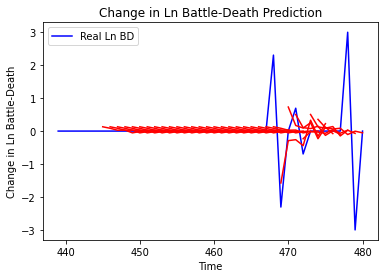

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Rwanda', 'country_id': 156, 'step': 't+1', 'mse': 0.22670467567232996, 'mae': 0.2715110120438989, 'r2': 0.41190528525024395, 'tadda_score': 0.2715110120438989}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+2', 'mse': 0.7060291938747774, 'mae': 0.4745128281179524, 'r2': -0.8315106918082209, 'tadda_score': 0.5255300350252248}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+3', 'mse': 0.6134595844573381, 'mae': 0.5078059791069873, 'r2': -1.1980861706937138, 'tadda_score': 0.5479598202846099}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+4', 'mse': 0.6297620871583949, 'mae': 0.521784571725204, 'r2': -0.7069446115179361, 'tadda_score': 0.521784571725204}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+5', 'mse': 0.6057624117810626, 'mae': 0.38917766987309377, 'r2': -0.6418944641704449, 'tadda_score': 0.40852043409174205}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+6', 'mse': 0.607452101755

31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [=====================

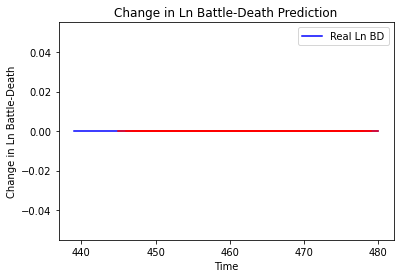

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zambia', 'country_id': 157, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Zimbabwe']
Building vanilla Model...
Model: "sequential_573"
_________________________________________________________________
Layer (type)                 Out

31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
31/31 [=====================

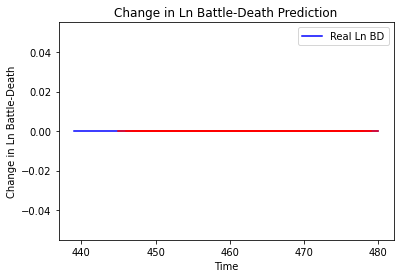

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Comoros']
Building vanilla Model...
Model: "sequential_574"
_________________________________________________________________
Layer (type)       

31/31 [==============================] - 0s 5ms/step - loss: 0.1280 - val_loss: 8.7634e-05
Epoch 62/100
31/31 [==============================] - 0s 5ms/step - loss: 0.1281 - val_loss: 3.6003e-06
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 0.1261 - val_loss: 1.3846e-04
Epoch 64/100
31/31 [==============================] - 0s 5ms/step - loss: 0.1248 - val_loss: 4.1630e-05
Epoch 65/100
31/31 [==============================] - 0s 5ms/step - loss: 0.1251 - val_loss: 2.3778e-05
Epoch 66/100
31/31 [==============================] - 0s 5ms/step - loss: 0.1254 - val_loss: 2.6274e-05
Epoch 67/100
31/31 [==============================] - 0s 5ms/step - loss: 0.1250 - val_loss: 3.7621e-05
Epoch 68/100
31/31 [==============================] - 0s 5ms/step - loss: 0.1249 - val_loss: 1.3045e-04
Epoch 69/100
31/31 [==============================] - 0s 4ms/step - loss: 0.1264 - val_loss: 2.7552e-05
Epoch 70/100
31/31 [==============================] - 0s 5ms/step - loss: 0.1

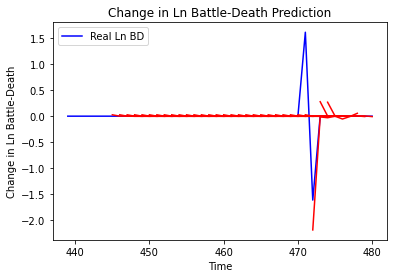

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Comoros', 'country_id': 159, 'step': 't+1', 'mse': 0.09998789237446432, 'mae': 0.11280809572587411, 'r2': 0.42098446216590146, 'tadda_score': 0.11280809572587411}
{'country': 'Comoros', 'country_id': 159, 'step': 't+2', 'mse': 0.3660675070901487, 'mae': 0.22092031319388147, 'r2': -1.1198444078367413, 'tadda_score': 0.230206209216996}
{'country': 'Comoros', 'country_id': 159, 'step': 't+3', 'mse': 0.3705594014930325, 'mae': 0.22440876362918213, 'r2': -1.145856323797918, 'tadda_score': 0.2336625446696917}
{'country': 'Comoros', 'country_id': 159, 'step': 't+4', 'mse': 0.2546589696297815, 'mae': 0.16805514350880382, 'r2': -2.0510901096921064, 'tadda_score': 0.16805514350880382}
{'country': 'Comoros', 'country_id': 159, 'step': 't+5', 'mse': 0.2608717271150988, 'mae': 0.1665257586076776, 'r2': -2.125525669314941, 'tadda_score': 0.1665257586076776}
{'country': 'Comoros', 'country_id': 159, 'step': 't+6', 'mse': 0.261

31/31 [==============================] - 0s 8ms/step - loss: 0.1376 - val_loss: 1.3135e-05
Epoch 58/100
31/31 [==============================] - 0s 7ms/step - loss: 0.1378 - val_loss: 2.5865e-05
Epoch 59/100
31/31 [==============================] - 0s 8ms/step - loss: 0.1386 - val_loss: 2.0260e-05
Epoch 60/100
31/31 [==============================] - 0s 9ms/step - loss: 0.1377 - val_loss: 4.0992e-05
Epoch 61/100
31/31 [==============================] - 0s 7ms/step - loss: 0.1377 - val_loss: 6.2422e-05
Epoch 62/100
31/31 [==============================] - 0s 7ms/step - loss: 0.1381 - val_loss: 1.3053e-05
Epoch 63/100
31/31 [==============================] - 0s 6ms/step - loss: 0.1379 - val_loss: 1.7116e-05
Epoch 64/100
31/31 [==============================] - 0s 7ms/step - loss: 0.1426 - val_loss: 1.3060e-05
Epoch 65/100
31/31 [==============================] - 0s 6ms/step - loss: 0.1367 - val_loss: 1.9354e-05
Epoch 66/100
31/31 [==============================] - 0s 8ms/step - loss: 0.1

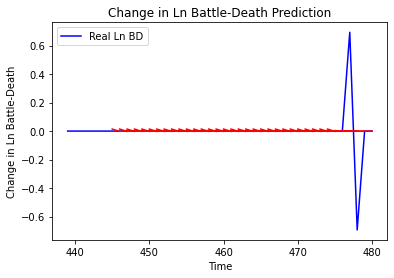

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Lesotho', 'country_id': 160, 'step': 't+1', 'mse': 0.0002003790137111161, 'mae': 0.01415552943944931, 'r2': 0.0, 'tadda_score': 0.01415552943944931}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+2', 'mse': 0.00013903712837853854, 'mae': 0.011791400611400604, 'r2': 0.0, 'tadda_score': 0.011791400611400604}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+3', 'mse': 0.00023143904230694956, 'mae': 0.015213120728731155, 'r2': 0.0, 'tadda_score': 0.015213120728731155}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+4', 'mse': 0.00024214360441907404, 'mae': 0.015560964122414589, 'r2': 0.0, 'tadda_score': 0.015560964122414589}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+5', 'mse': 0.0003367781305081176, 'mae': 0.018351515755057335, 'r2': 0.0, 'tadda_score': 0.018351515755057335}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+6', 'mse': 0.0002843209937265813, 'mae': 0.016861820593476295, '

31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
31/31 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
31/31 [====================

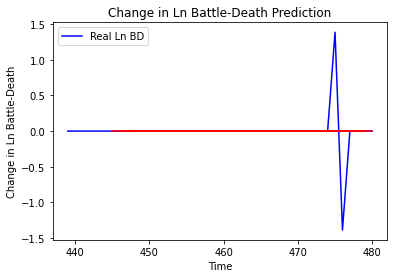

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Malawi', 'country_id': 161, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mozambique']
Building vanilla Model...
Model: "sequential_577"
_________________________________________________________________
Layer (type)                 O

31/31 [==============================] - 0s 4ms/step - loss: 1.0047 - val_loss: 0.6917
Epoch 65/100
31/31 [==============================] - 0s 4ms/step - loss: 0.9968 - val_loss: 0.6920
Epoch 66/100
31/31 [==============================] - 0s 4ms/step - loss: 0.9954 - val_loss: 0.6935
Epoch 67/100
31/31 [==============================] - 0s 4ms/step - loss: 1.0282 - val_loss: 0.6925
Epoch 68/100
31/31 [==============================] - 0s 4ms/step - loss: 0.9946 - val_loss: 0.6927
Epoch 69/100
31/31 [==============================] - 0s 4ms/step - loss: 1.0436 - val_loss: 0.6927
Epoch 70/100
31/31 [==============================] - 0s 4ms/step - loss: 1.0341 - val_loss: 0.6940
Epoch 71/100
31/31 [==============================] - 0s 4ms/step - loss: 1.0347 - val_loss: 0.6934
Epoch 72/100
31/31 [==============================] - 0s 4ms/step - loss: 1.0010 - val_loss: 0.6949
Epoch 73/100
31/31 [==============================] - 0s 4ms/step - loss: 1.0320 - val_loss: 0.6946
Epoch 74/100


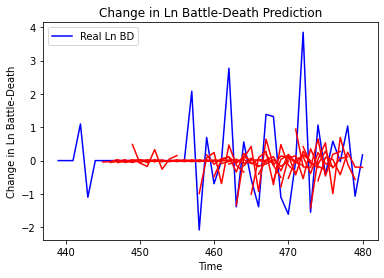

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mozambique', 'country_id': 162, 'step': 't+1', 'mse': 1.263338654747621, 'mae': 0.6824137231884884, 'r2': 0.19714280328678524, 'tadda_score': 0.7313419320859995}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+2', 'mse': 2.51034326965737, 'mae': 1.0410462740723667, 'r2': -0.31203485418727106, 'tadda_score': 1.2035647514501588}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+3', 'mse': 2.476789065806646, 'mae': 1.1045426751520713, 'r2': -0.29415462249476354, 'tadda_score': 1.2449521924402795}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+4', 'mse': 2.703314943512418, 'mae': 1.1773070844053193, 'r2': -0.793804635498697, 'tadda_score': 1.496385414976772}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+5', 'mse': 1.4178569395035086, 'mae': 0.831009564144405, 'r2': -0.7312136307116324, 'tadda_score': 0.9777679452975513}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+6', 'mse

31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [=====================

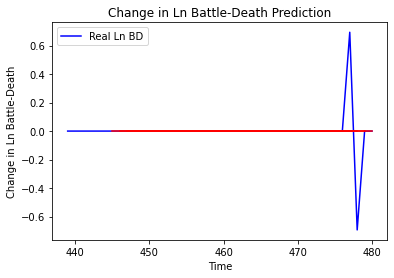

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Africa', 'country_id': 163, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Swaziland']
Building vanilla Model...
Model: "sequential_579"
_______________________________________________________

31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
31/31 [=====================

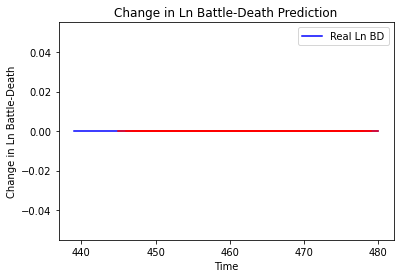

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Swaziland', 'country_id': 164, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Angola']
Building vanilla Model...
Model: "sequential_580"
_________________________________________________________________
Layer (type) 

Epoch 64/100
31/31 [==============================] - 0s 4ms/step - loss: 3.2470 - val_loss: 0.0862
Epoch 65/100
31/31 [==============================] - 0s 5ms/step - loss: 3.2705 - val_loss: 0.0853
Epoch 66/100
31/31 [==============================] - 0s 5ms/step - loss: 3.2729 - val_loss: 0.0851
Epoch 67/100
31/31 [==============================] - 0s 5ms/step - loss: 3.2432 - val_loss: 0.0856
Epoch 68/100
31/31 [==============================] - 0s 5ms/step - loss: 3.2775 - val_loss: 0.0854
Epoch 69/100
31/31 [==============================] - 0s 4ms/step - loss: 3.2745 - val_loss: 0.0854
Epoch 70/100
31/31 [==============================] - 0s 4ms/step - loss: 3.2715 - val_loss: 0.0852
Epoch 71/100
31/31 [==============================] - 0s 5ms/step - loss: 3.2624 - val_loss: 0.0853
Epoch 72/100
31/31 [==============================] - 0s 5ms/step - loss: 3.2869 - val_loss: 0.0852
Epoch 73/100
31/31 [==============================] - 0s 5ms/step - loss: 3.2604 - val_loss: 0.0857


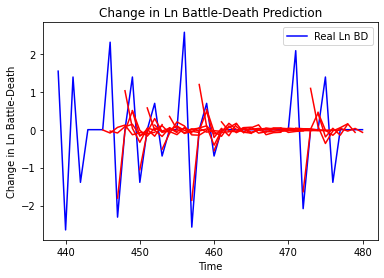

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Angola', 'country_id': 165, 'step': 't+1', 'mse': 0.7524629400951345, 'mae': 0.5377648679477018, 'r2': 0.4086784355298022, 'tadda_score': 0.5389940545521221}
{'country': 'Angola', 'country_id': 165, 'step': 't+2', 'mse': 2.3938698761697936, 'mae': 1.0598088054234327, 'r2': -0.8812180705349186, 'tadda_score': 1.2169869751606923}
{'country': 'Angola', 'country_id': 165, 'step': 't+3', 'mse': 1.255501989027968, 'mae': 0.8068784035170881, 'r2': -0.43139088578498197, 'tadda_score': 0.8428978369310307}
{'country': 'Angola', 'country_id': 165, 'step': 't+4', 'mse': 1.1028535882612394, 'mae': 0.7873004414120643, 'r2': -0.027463072600369287, 'tadda_score': 0.7967333455859948}
{'country': 'Angola', 'country_id': 165, 'step': 't+5', 'mse': 1.273786684921293, 'mae': 0.7818965666652434, 'r2': -0.3009808526268747, 'tadda_score': 0.8096665263832323}
{'country': 'Angola', 'country_id': 165, 'step': 't+6', 'mse': 1.5737185760265

Epoch 60/100
31/31 [==============================] - 0s 5ms/step - loss: 1.8763 - val_loss: 0.2215
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 1.8872 - val_loss: 0.2217
Epoch 62/100
31/31 [==============================] - 0s 5ms/step - loss: 1.8741 - val_loss: 0.2219
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 1.8648 - val_loss: 0.2224
Epoch 64/100
31/31 [==============================] - 0s 5ms/step - loss: 1.8900 - val_loss: 0.2223
Epoch 65/100
31/31 [==============================] - 0s 6ms/step - loss: 1.8875 - val_loss: 0.2221
Epoch 66/100
31/31 [==============================] - 0s 5ms/step - loss: 1.8667 - val_loss: 0.2218
Epoch 67/100
31/31 [==============================] - 0s 5ms/step - loss: 1.8774 - val_loss: 0.2215
Epoch 68/100
31/31 [==============================] - 0s 5ms/step - loss: 1.8721 - val_loss: 0.2221
Epoch 69/100
31/31 [==============================] - 0s 5ms/step - loss: 1.8816 - val_loss: 0.2211


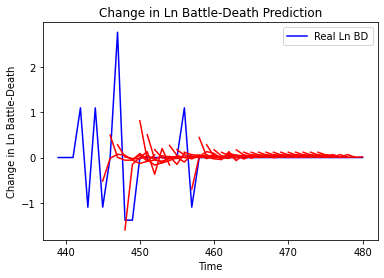

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo', 'country_id': 166, 'step': 't+1', 'mse': 0.37586702079741563, 'mae': 0.36797362317422727, 'r2': 0.25381200487981337, 'tadda_score': 0.36797362317422727}
{'country': 'Congo', 'country_id': 166, 'step': 't+2', 'mse': 1.1632517436577936, 'mae': 0.6626878898456894, 'r2': -0.5306792712079555, 'tadda_score': 0.7789542705928487}
{'country': 'Congo', 'country_id': 166, 'step': 't+3', 'mse': 1.0345730841267848, 'mae': 0.6131355480870027, 'r2': -0.7443494821668166, 'tadda_score': 0.7134252485156476}
{'country': 'Congo', 'country_id': 166, 'step': 't+4', 'mse': 0.9414679823993661, 'mae': 0.6330555293977677, 'r2': -0.35534590218267614, 'tadda_score': 0.7208849429111103}
{'country': 'Congo', 'country_id': 166, 'step': 't+5', 'mse': 0.9498569047758276, 'mae': 0.6350590786854842, 'r2': -0.6015131510759879, 'tadda_score': 0.710614384613476}
{'country': 'Congo', 'country_id': 166, 'step': 't+6', 'mse': 0.9176313800099725

Epoch 60/100
31/31 [==============================] - 0s 4ms/step - loss: 2.9406 - val_loss: 3.3080
Epoch 61/100
31/31 [==============================] - 0s 4ms/step - loss: 2.9326 - val_loss: 3.3084
Epoch 62/100
31/31 [==============================] - 0s 4ms/step - loss: 2.9547 - val_loss: 3.3078
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 2.9399 - val_loss: 3.3064
Epoch 64/100
31/31 [==============================] - 0s 5ms/step - loss: 2.9724 - val_loss: 3.3120
Epoch 65/100
31/31 [==============================] - 0s 4ms/step - loss: 2.9506 - val_loss: 3.3118
Epoch 66/100
31/31 [==============================] - 0s 4ms/step - loss: 2.9443 - val_loss: 3.3137
Epoch 67/100
31/31 [==============================] - 0s 4ms/step - loss: 2.9304 - val_loss: 3.3103
Epoch 68/100
31/31 [==============================] - 0s 4ms/step - loss: 2.9255 - val_loss: 3.3124
Epoch 69/100
31/31 [==============================] - 0s 4ms/step - loss: 2.9213 - val_loss: 3.3104


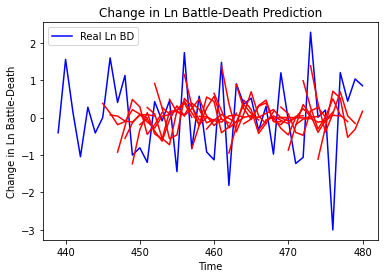

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+1', 'mse': 0.9316095440256291, 'mae': 0.7802349550333462, 'r2': 0.14881137368687913, 'tadda_score': 0.9526578910953643}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+2', 'mse': 3.0238183619656103, 'mae': 1.4089869268185509, 'r2': -1.1386001135723212, 'tadda_score': 1.8441178093300874}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+3', 'mse': 2.6300645711549104, 'mae': 1.3172229609880814, 'r2': -0.5247317745063793, 'tadda_score': 1.6900524896377294}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+4', 'mse': 3.161885872506598, 'mae': 1.4776273543697591, 'r2': -0.8149034476248589, 'tadda_score': 1.9445207856657103}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+5', 'mse': 3.966096562885688, 'mae': 1.5757020031165028, 'r2': -1.160503373654492, 'tadda_score': 2.12938056238005}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+6', 'ms

31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [=====================

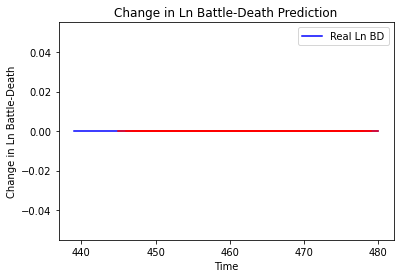

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Gabon', 'country_id': 169, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Namibia']
Building vanilla Model...
Model: "sequential_584"
_________________________________________________________________
Layer (type)                 Output Shap

Epoch 62/100
31/31 [==============================] - 0s 4ms/step - loss: 0.1402 - val_loss: 2.9913e-05
Epoch 63/100
31/31 [==============================] - 0s 4ms/step - loss: 0.1402 - val_loss: 5.0455e-05
Epoch 64/100
31/31 [==============================] - 0s 4ms/step - loss: 0.1387 - val_loss: 6.3052e-05
Epoch 65/100
31/31 [==============================] - 0s 4ms/step - loss: 0.1389 - val_loss: 5.4332e-05
Epoch 66/100
31/31 [==============================] - 0s 4ms/step - loss: 0.1384 - val_loss: 2.8948e-05
Epoch 67/100
31/31 [==============================] - 0s 4ms/step - loss: 0.1398 - val_loss: 1.1910e-04
Epoch 68/100
31/31 [==============================] - 0s 4ms/step - loss: 0.1380 - val_loss: 2.5292e-05
Epoch 69/100
31/31 [==============================] - 0s 4ms/step - loss: 0.1381 - val_loss: 1.7556e-04
Epoch 70/100
31/31 [==============================] - 0s 4ms/step - loss: 0.1388 - val_loss: 1.1778e-04
Epoch 71/100
31/31 [==============================] - 0s 4ms/ste

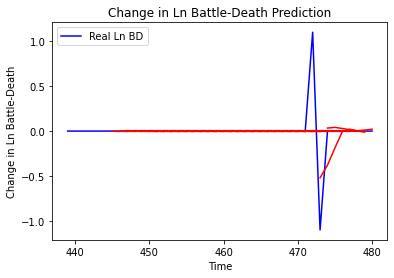

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Namibia', 'country_id': 170, 'step': 't+1', 'mse': 0.051607967380315076, 'mae': 0.0587765366896559, 'r2': 0.3586145430842843, 'tadda_score': 0.05883797285788449}
{'country': 'Namibia', 'country_id': 170, 'step': 't+2', 'mse': 0.11345295080747077, 'mae': 0.1112201851297984, 'r2': -0.4099968742392579, 'tadda_score': 0.11390319967662983}
{'country': 'Namibia', 'country_id': 170, 'step': 't+3', 'mse': 0.07992811987886911, 'mae': 0.07691208356070366, 'r2': -1.0552052645537784, 'tadda_score': 0.07693565328615752}
{'country': 'Namibia', 'country_id': 170, 'step': 't+4', 'mse': 0.08009417618825315, 'mae': 0.07943762307065573, 'r2': -1.0594750985217942, 'tadda_score': 0.07943762307065573}
{'country': 'Namibia', 'country_id': 170, 'step': 't+5', 'mse': 0.05600068114006154, 'mae': 0.06659120019225126, 'r2': -0.43995498545536926, 'tadda_score': 0.06659120019225126}
{'country': 'Namibia', 'country_id': 170, 'step': 't+6', 'm

31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
31/31 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [=====================

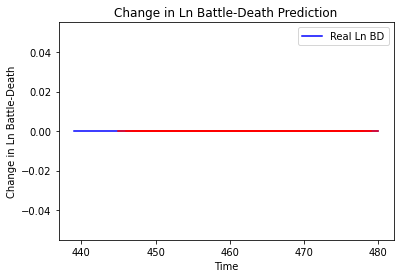

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Madagascar', 'country_id': 172, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mauritius']
Building vanilla Model...
Model: "sequential_586"
_________________________________________________________________
Lay

31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
31/31 [=====================

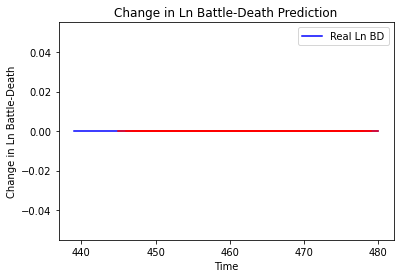

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritius', 'country_id': 173, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Seychelles']
Building vanilla Model...
Model: "sequential_587"
_________________________________________________________________
Layer (ty

31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
31/31 [=====================

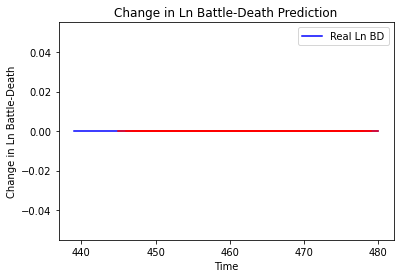

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Seychelles', 'country_id': 174, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Libya']
Building vanilla Model...
Model: "sequential_588"
_________________________________________________________________
Layer (

Epoch 64/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.3058
Epoch 65/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.3058
Epoch 66/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0315 - val_loss: 2.3059
Epoch 67/100
31/31 [==============================] - 0s 6ms/step - loss: 0.0314 - val_loss: 2.3060
Epoch 68/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0315 - val_loss: 2.3058
Epoch 69/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.3059
Epoch 70/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0315 - val_loss: 2.3061
Epoch 71/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.3062
Epoch 72/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.3062
Epoch 73/100
31/31 [==============================] - 0s 5ms/step - loss: 0.0315 - val_loss: 2.3062


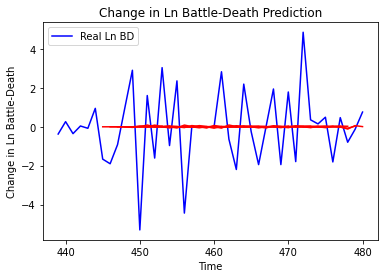

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Libya', 'country_id': 213, 'step': 't+1', 'mse': 4.845631288015822, 'mae': 1.6886085969139528, 'r2': 9.288924471828608e-07, 'tadda_score': 1.688632472610705}
{'country': 'Libya', 'country_id': 213, 'step': 't+2', 'mse': 5.41759932532472, 'mae': 1.7837544338265896, 'r2': -6.83647136490162e-05, 'tadda_score': 1.7838208852835402}
{'country': 'Libya', 'country_id': 213, 'step': 't+3', 'mse': 7.422786799946577, 'mae': 2.1080797387486863, 'r2': -3.320809888984755e-05, 'tadda_score': 2.108145801380281}
{'country': 'Libya', 'country_id': 213, 'step': 't+4', 'mse': 5.818039636038871, 'mae': 1.9751566577236064, 'r2': -0.005392165638880453, 'tadda_score': 1.9752344038039333}
{'country': 'Libya', 'country_id': 213, 'step': 't+5', 'mse': 7.421951006304761, 'mae': 2.2841770476532064, 'r2': -0.02003405219799803, 'tadda_score': 2.3036108096776733}
{'country': 'Libya', 'country_id': 213, 'step': 't+6', 'mse': 6.311895666752564, 

Epoch 60/100
31/31 [==============================] - 0s 5ms/step - loss: 4.9620 - val_loss: 0.8502
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 4.9317 - val_loss: 0.8503
Epoch 62/100
31/31 [==============================] - 0s 5ms/step - loss: 4.9722 - val_loss: 0.8529
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 4.9278 - val_loss: 0.8566
Epoch 64/100
31/31 [==============================] - 0s 5ms/step - loss: 4.9994 - val_loss: 0.8560
Epoch 65/100
31/31 [==============================] - 0s 4ms/step - loss: 4.9343 - val_loss: 0.8572
Epoch 66/100
31/31 [==============================] - 0s 5ms/step - loss: 4.9575 - val_loss: 0.8552
Epoch 67/100
31/31 [==============================] - 0s 5ms/step - loss: 4.9718 - val_loss: 0.8556
Epoch 68/100
31/31 [==============================] - 0s 6ms/step - loss: 4.8939 - val_loss: 0.8539
Epoch 69/100
31/31 [==============================] - 0s 5ms/step - loss: 4.9363 - val_loss: 0.8526


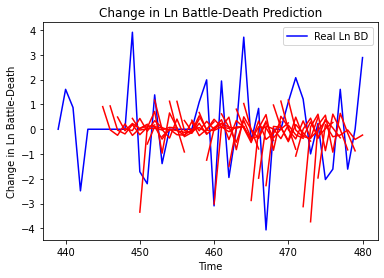

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Chad', 'country_id': 214, 'step': 't+1', 'mse': 3.4639718059059894, 'mae': 1.4650325680010827, 'r2': -0.1800538652547583, 'tadda_score': 1.7780381504926397}
{'country': 'Chad', 'country_id': 214, 'step': 't+2', 'mse': 8.448931603441018, 'mae': 2.247770017575696, 'r2': -0.9904423003628848, 'tadda_score': 2.971800277820701}
{'country': 'Chad', 'country_id': 214, 'step': 't+3', 'mse': 9.512963315903704, 'mae': 2.4113931639512414, 'r2': -0.821470679369438, 'tadda_score': 3.0329207702000978}
{'country': 'Chad', 'country_id': 214, 'step': 't+4', 'mse': 13.931725489636728, 'mae': 3.1089224147566337, 'r2': -1.2846639881936284, 'tadda_score': 4.0193170992303076}
{'country': 'Chad', 'country_id': 214, 'step': 't+5', 'mse': 11.791016141113165, 'mae': 2.7631880103201625, 'r2': -1.4818696206892281, 'tadda_score': 3.5404323040098897}
{'country': 'Chad', 'country_id': 214, 'step': 't+6', 'mse': 9.95067682077056, 'mae': 2.46546

31/31 [==============================] - 0s 5ms/step - loss: 0.5767 - val_loss: 2.1279
Epoch 61/100
31/31 [==============================] - 0s 4ms/step - loss: 0.5809 - val_loss: 2.1303
Epoch 62/100
31/31 [==============================] - 0s 4ms/step - loss: 0.5713 - val_loss: 2.1277
Epoch 63/100
31/31 [==============================] - 0s 4ms/step - loss: 0.5756 - val_loss: 2.1252
Epoch 64/100
31/31 [==============================] - 0s 4ms/step - loss: 0.5694 - val_loss: 2.1254
Epoch 65/100
31/31 [==============================] - 0s 4ms/step - loss: 0.5646 - val_loss: 2.1254
Epoch 66/100
31/31 [==============================] - 0s 4ms/step - loss: 0.5746 - val_loss: 2.1235
Epoch 67/100
31/31 [==============================] - 0s 4ms/step - loss: 0.5623 - val_loss: 2.1232
Epoch 68/100
31/31 [==============================] - 0s 4ms/step - loss: 0.5645 - val_loss: 2.1175
Epoch 69/100
31/31 [==============================] - 0s 4ms/step - loss: 0.5734 - val_loss: 2.1191
Epoch 70/100


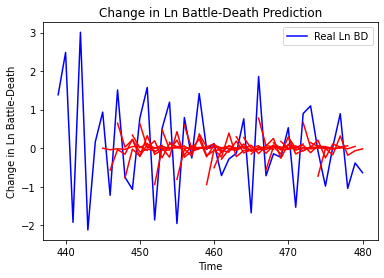

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Egypt', 'country_id': 222, 'step': 't+1', 'mse': 0.6777686254215748, 'mae': 0.6818277273748075, 'r2': 0.39863200861402437, 'tadda_score': 0.7326949890347823}
{'country': 'Egypt', 'country_id': 222, 'step': 't+2', 'mse': 1.5617928849138376, 'mae': 1.0613178412036308, 'r2': -0.44415819952186397, 'tadda_score': 1.2939357969826668}
{'country': 'Egypt', 'country_id': 222, 'step': 't+3', 'mse': 1.4294187165310948, 'mae': 0.9739625325895669, 'r2': -0.5412786834158014, 'tadda_score': 1.2082409197933792}
{'country': 'Egypt', 'country_id': 222, 'step': 't+4', 'mse': 1.3106100964435738, 'mae': 0.9545682183293794, 'r2': -0.0640000513986787, 'tadda_score': 1.1256679650533494}
{'country': 'Egypt', 'country_id': 222, 'step': 't+5', 'mse': 1.624012901121289, 'mae': 1.0879550363574428, 'r2': -0.3689059247128048, 'tadda_score': 1.3632562062098583}
{'country': 'Egypt', 'country_id': 222, 'step': 't+6', 'mse': 1.3619597591360604, '

31/31 [==============================] - 0s 4ms/step - loss: 2.6631 - val_loss: 8.0051e-04
Epoch 59/100
31/31 [==============================] - 0s 4ms/step - loss: 2.6248 - val_loss: 0.0016
Epoch 60/100
31/31 [==============================] - 0s 4ms/step - loss: 2.6507 - val_loss: 8.8815e-04
Epoch 61/100
31/31 [==============================] - 0s 5ms/step - loss: 2.6501 - val_loss: 0.0011
Epoch 62/100
31/31 [==============================] - 0s 4ms/step - loss: 2.6549 - val_loss: 0.0015
Epoch 63/100
31/31 [==============================] - 0s 5ms/step - loss: 2.6382 - val_loss: 0.0014
Epoch 64/100
31/31 [==============================] - 0s 5ms/step - loss: 2.6509 - val_loss: 0.0027
Epoch 65/100
31/31 [==============================] - 0s 5ms/step - loss: 2.6513 - val_loss: 0.0015
Epoch 66/100
31/31 [==============================] - 0s 5ms/step - loss: 2.6753 - val_loss: 0.0016
Epoch 67/100
31/31 [==============================] - 0s 4ms/step - loss: 2.6663 - val_loss: 0.0022
Epoch

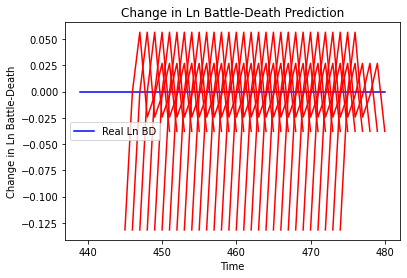

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Uganda', 'country_id': 235, 'step': 't+1', 'mse': 0.017362712394881408, 'mae': 0.1317676454782486, 'r2': 0.0, 'tadda_score': 0.1317676454782486}
{'country': 'Uganda', 'country_id': 235, 'step': 't+2', 'mse': 0.017483775559924197, 'mae': 0.13222622871398926, 'r2': 0.0, 'tadda_score': 0.13222622871398926}
{'country': 'Uganda', 'country_id': 235, 'step': 't+3', 'mse': 0.005742831502624723, 'mae': 0.07578147202730179, 'r2': 0.0, 'tadda_score': 0.07578147202730179}
{'country': 'Uganda', 'country_id': 235, 'step': 't+4', 'mse': 0.010034079928132655, 'mae': 0.10017025470733643, 'r2': 0.0, 'tadda_score': 0.10017025470733643}
{'country': 'Uganda', 'country_id': 235, 'step': 't+5', 'mse': 0.010700772651099977, 'mae': 0.10344453901052475, 'r2': 0.0, 'tadda_score': 0.10344453901052475}
{'country': 'Uganda', 'country_id': 235, 'step': 't+6', 'mse': 0.005870797579154763, 'mae': 0.07662113010883331, 'r2': 0.0, 'tadda_score': 0

31/31 [==============================] - 0s 4ms/step - loss: 0.1144 - val_loss: 1.6571
Epoch 61/100
31/31 [==============================] - 0s 4ms/step - loss: 0.1180 - val_loss: 1.6570
Epoch 62/100
31/31 [==============================] - 0s 4ms/step - loss: 0.1150 - val_loss: 1.6567
Epoch 63/100
31/31 [==============================] - 0s 4ms/step - loss: 0.1143 - val_loss: 1.6576
Epoch 64/100
31/31 [==============================] - 0s 4ms/step - loss: 0.1143 - val_loss: 1.6562
Epoch 65/100
31/31 [==============================] - 0s 4ms/step - loss: 0.1147 - val_loss: 1.6610
Epoch 66/100
31/31 [==============================] - 0s 5ms/step - loss: 0.1171 - val_loss: 1.6599
Epoch 67/100
31/31 [==============================] - 0s 5ms/step - loss: 0.1142 - val_loss: 1.6603
Epoch 68/100
31/31 [==============================] - 0s 4ms/step - loss: 0.1147 - val_loss: 1.6629
Epoch 69/100
31/31 [==============================] - 0s 4ms/step - loss: 0.1141 - val_loss: 1.6622
Epoch 70/100


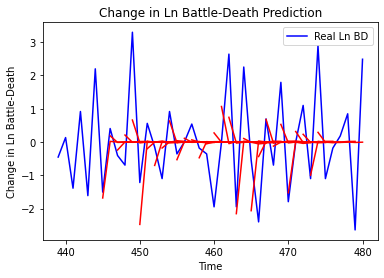

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Kenya', 'country_id': 237, 'step': 't+1', 'mse': 1.3919452374805807, 'mae': 0.8743766584335896, 'r2': 0.32825337228873885, 'tadda_score': 0.8971648989458016}
{'country': 'Kenya', 'country_id': 237, 'step': 't+2', 'mse': 3.430328920998269, 'mae': 1.5058677463181291, 'r2': -0.7970181490302639, 'tadda_score': 1.9476870170183456}
{'country': 'Kenya', 'country_id': 237, 'step': 't+3', 'mse': 3.126893757661982, 'mae': 1.3666480634755789, 'r2': -0.4320021106076761, 'tadda_score': 1.6409549468901652}
{'country': 'Kenya', 'country_id': 237, 'step': 't+4', 'mse': 3.8873006221072477, 'mae': 1.6217413036298014, 'r2': -0.38421379862207194, 'tadda_score': 1.8929886254937707}
{'country': 'Kenya', 'country_id': 237, 'step': 't+5', 'mse': 2.7012628344495213, 'mae': 1.2096107753148395, 'r2': -0.7834502091965185, 'tadda_score': 1.5226463041733422}
{'country': 'Kenya', 'country_id': 237, 'step': 't+6', 'mse': 2.5595381524666156, 'm

24/24 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
24/24 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
24/24 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
24/24 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
24/24 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
24/24 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
24/24 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
24/24 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
24/24 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
24/24 [=====================

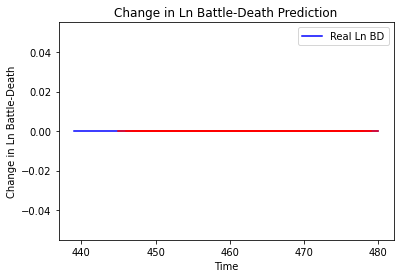

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tanzania', 'country_id': 242, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Morocco']
Building vanilla Model...
Model: "sequential_594"
_________________________________________________________________
Layer (type)       

31/31 [==============================] - 0s 4ms/step - loss: 0.0685 - val_loss: 3.5327e-05
Epoch 62/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0686 - val_loss: 8.1227e-06
Epoch 63/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0687 - val_loss: 3.3602e-05
Epoch 64/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0696 - val_loss: 7.8360e-07
Epoch 65/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0707 - val_loss: 7.5081e-05
Epoch 66/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0691 - val_loss: 6.7587e-07
Epoch 67/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0688 - val_loss: 2.8447e-05
Epoch 68/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0701 - val_loss: 5.9835e-06
Epoch 69/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0703 - val_loss: 3.4306e-05
Epoch 70/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0

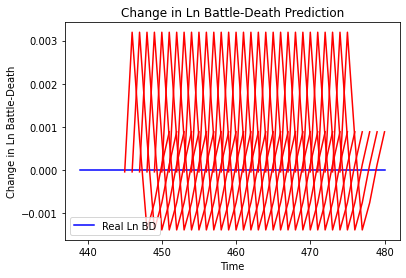

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Morocco', 'country_id': 243, 'step': 't+1', 'mse': 1.4598848831204325e-09, 'mae': 3.820843994617462e-05, 'r2': 0.0, 'tadda_score': 3.820843994617462e-05}
{'country': 'Morocco', 'country_id': 243, 'step': 't+2', 'mse': 9.961703114280565e-06, 'mae': 0.0031562165822833776, 'r2': 0.0, 'tadda_score': 0.0031562165822833776}
{'country': 'Morocco', 'country_id': 243, 'step': 't+3', 'mse': 1.5111754097367448e-05, 'mae': 0.0038873839657753706, 'r2': 0.0, 'tadda_score': 0.0038873839657753706}
{'country': 'Morocco', 'country_id': 243, 'step': 't+4', 'mse': 6.2756956555826485e-06, 'mae': 0.0025051338598132133, 'r2': 0.0, 'tadda_score': 0.0025051338598132133}
{'country': 'Morocco', 'country_id': 243, 'step': 't+5', 'mse': 2.0808409614393817e-06, 'mae': 0.0014425120316445827, 'r2': 0.0, 'tadda_score': 0.0014425120316445827}
{'country': 'Morocco', 'country_id': 243, 'step': 't+6', 'mse': 1.7243156522789315e-06, 'mae': 0.0013131

31/31 [==============================] - 0s 4ms/step - loss: 0.0624 - val_loss: 0.1135
Epoch 61/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0632 - val_loss: 0.1134
Epoch 62/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0624 - val_loss: 0.1137
Epoch 63/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0635 - val_loss: 0.1138
Epoch 64/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0628 - val_loss: 0.1140
Epoch 65/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0649 - val_loss: 0.1143
Epoch 66/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0647 - val_loss: 0.1147
Epoch 67/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0626 - val_loss: 0.1147
Epoch 68/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0641 - val_loss: 0.1144
Epoch 69/100
31/31 [==============================] - 0s 4ms/step - loss: 0.0628 - val_loss: 0.1142
Epoch 70/100


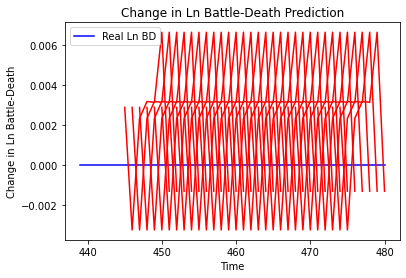

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritania', 'country_id': 244, 'step': 't+1', 'mse': 8.297723841380056e-06, 'mae': 0.0028805769979953766, 'r2': 0.0, 'tadda_score': 0.0028805769979953766}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+2', 'mse': 1.133512919082591e-07, 'mae': 0.00033667683601379395, 'r2': 0.0, 'tadda_score': 0.00033667683601379395}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+3', 'mse': 3.98869932283219e-06, 'mae': 0.0019971728324890137, 'r2': 0.0, 'tadda_score': 0.0019971728324890137}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+4', 'mse': 2.6735224986643852e-05, 'mae': 0.005170611664652824, 'r2': 0.0, 'tadda_score': 0.005170611664652824}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+5', 'mse': 0.0001327301887350668, 'mae': 0.011520858854055405, 'r2': 0.0, 'tadda_score': 0.011520858854055405}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+6', 'mse': 0.0003290493051873039, 'mae'

5/5 [==============================] - 0s 6ms/step - loss: 3.1488 - val_loss: 0.9306
Epoch 62/100
5/5 [==============================] - 0s 6ms/step - loss: 3.0906 - val_loss: 0.9313
Epoch 63/100
5/5 [==============================] - 0s 6ms/step - loss: 3.1023 - val_loss: 0.9320
Epoch 64/100
5/5 [==============================] - 0s 6ms/step - loss: 3.1172 - val_loss: 0.9326
Epoch 65/100
5/5 [==============================] - 0s 6ms/step - loss: 3.0750 - val_loss: 0.9335
Epoch 66/100
5/5 [==============================] - 0s 6ms/step - loss: 3.1269 - val_loss: 0.9343
Epoch 67/100
5/5 [==============================] - 0s 6ms/step - loss: 3.1193 - val_loss: 0.9352
Epoch 68/100
5/5 [==============================] - 0s 6ms/step - loss: 3.0844 - val_loss: 0.9361
Epoch 69/100
5/5 [==============================] - 0s 6ms/step - loss: 3.1496 - val_loss: 0.9370
Epoch 70/100
5/5 [==============================] - 0s 6ms/step - loss: 3.1289 - val_loss: 0.9377
Epoch 71/100
5/5 [===============

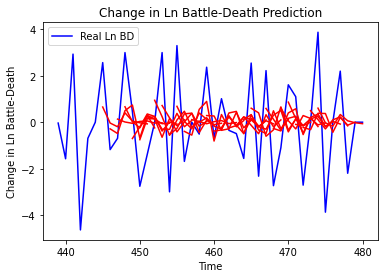

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sudan', 'country_id': 245, 'step': 't+1', 'mse': 2.90274714060813, 'mae': 1.4882808641685574, 'r2': 0.27455703166738976, 'tadda_score': 1.5569141960236954}
{'country': 'Sudan', 'country_id': 245, 'step': 't+2', 'mse': 4.962413909936727, 'mae': 1.836042065122063, 'r2': -0.16304252317636259, 'tadda_score': 2.1364064372562717}
{'country': 'Sudan', 'country_id': 245, 'step': 't+3', 'mse': 4.11169041245182, 'mae': 1.6878780034574838, 'r2': -0.06024577902064476, 'tadda_score': 1.8219505620393128}
{'country': 'Sudan', 'country_id': 245, 'step': 't+4', 'mse': 3.686403305926347, 'mae': 1.5080211099793397, 'r2': -0.11033207103374165, 'tadda_score': 1.6802953612615548}
{'country': 'Sudan', 'country_id': 245, 'step': 't+5', 'mse': 5.44175156374956, 'mae': 1.991404717412422, 'r2': -0.03794760667480235, 'tadda_score': 2.2003585445352694}
{'country': 'Sudan', 'country_id': 245, 'step': 't+6', 'mse': 5.4719795786404015, 'mae': 

5/5 [==============================] - 0s 6ms/step - loss: 6.1948 - val_loss: 4.0425
Epoch 62/100
5/5 [==============================] - 0s 6ms/step - loss: 6.2806 - val_loss: 4.0397
Epoch 63/100
5/5 [==============================] - 0s 6ms/step - loss: 6.2036 - val_loss: 4.0368
Epoch 64/100
5/5 [==============================] - 0s 6ms/step - loss: 6.2435 - val_loss: 4.0349
Epoch 65/100
5/5 [==============================] - 0s 6ms/step - loss: 6.2406 - val_loss: 4.0332
Epoch 66/100
5/5 [==============================] - 0s 6ms/step - loss: 6.2238 - val_loss: 4.0320
Epoch 67/100
5/5 [==============================] - 0s 6ms/step - loss: 6.2136 - val_loss: 4.0299
Epoch 68/100
5/5 [==============================] - 0s 6ms/step - loss: 6.3182 - val_loss: 4.0287
Epoch 69/100
5/5 [==============================] - 0s 7ms/step - loss: 6.2494 - val_loss: 4.0263
Epoch 70/100
5/5 [==============================] - 0s 6ms/step - loss: 6.2845 - val_loss: 4.0250
Epoch 71/100
5/5 [===============

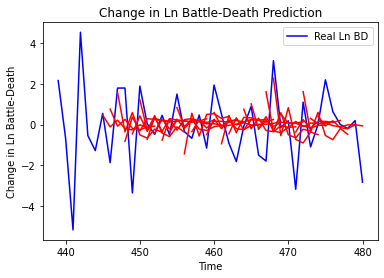

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Sudan', 'country_id': 246, 'step': 't+1', 'mse': 1.9994202339589373, 'mae': 1.0676138149841123, 'r2': 0.10122332911697263, 'tadda_score': 1.3124010977291563}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+2', 'mse': 3.7816189504406816, 'mae': 1.4754818738952187, 'r2': -0.3993617458653791, 'tadda_score': 1.7747372643604784}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+3', 'mse': 4.6844899466098155, 'mae': 1.8066199727470855, 'r2': -0.7916827142809097, 'tadda_score': 2.30907428948732}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+4', 'mse': 4.578273720255749, 'mae': 1.7721845639807248, 'r2': -0.45240273001370523, 'tadda_score': 2.122848971988982}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+5', 'mse': 3.4546914572033556, 'mae': 1.3977975379508836, 'r2': -0.3696143967730958, 'tadda_score': 1.6406379432561102}
{'country': 'South Sudan', 'country_id': 246, 'step': 't

In [39]:
np.random.seed(1)
tf.random.set_seed(1)
model = Sequential()
summary_model(dataset=df,
              modelname = "Vanilla",
              pred_africa=True,
              period=period_test, 
              epochs=100, 
              batch_size=8, 
              look_back=6, 
              look_forward=7,
              num_neurons=6, 
              val_split=0.2)

['Cape Verde']
Building vanilla Model...
Model: "sequential_599"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_586 (LSTM)              (None, 6)                 192       
_________________________________________________________________
dropout_1172 (Dropout)       (None, 6)                 0         
_________________________________________________________________
dense_1172 (Dense)           (None, 6)                 42        
_________________________________________________________________
dropout_1173 (Dropout)       (None, 6)                 0         
_________________________________________________________________
dense_1173 (Dense)           (None, 7)                 49        
Total params: 283
Trainable params: 283
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
25/25 [==============================] - 1s 26ms/step - loss: 0.000

25/25 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
25/25 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 70/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 71/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 72/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 73/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 74/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 75/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 76/100
25/25 [====================

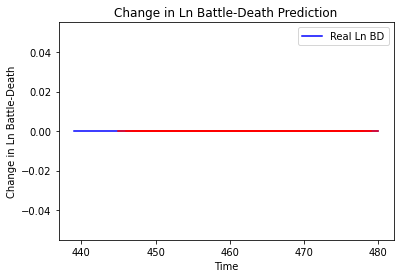

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
["Cote d'Ivoire"]
Building vanilla Model...
Model: "sequential_600"
_________________________________________________________________
Layer 

Epoch 64/100
25/25 [==============================] - 0s 5ms/step - loss: 0.5489 - val_loss: 0.2818
Epoch 65/100
25/25 [==============================] - 0s 6ms/step - loss: 0.5418 - val_loss: 0.2817
Epoch 66/100
25/25 [==============================] - 0s 6ms/step - loss: 0.5443 - val_loss: 0.2820
Epoch 67/100
25/25 [==============================] - 0s 6ms/step - loss: 0.5406 - val_loss: 0.2821
Epoch 68/100
25/25 [==============================] - 0s 5ms/step - loss: 0.5428 - val_loss: 0.2821
Epoch 69/100
25/25 [==============================] - 0s 6ms/step - loss: 0.5473 - val_loss: 0.2818
Epoch 70/100
25/25 [==============================] - 0s 5ms/step - loss: 0.5467 - val_loss: 0.2827
Epoch 71/100
25/25 [==============================] - 0s 5ms/step - loss: 0.5439 - val_loss: 0.2825
Epoch 72/100
25/25 [==============================] - 0s 5ms/step - loss: 0.5382 - val_loss: 0.2827
Epoch 73/100
25/25 [==============================] - 0s 6ms/step - loss: 0.5433 - val_loss: 0.2831


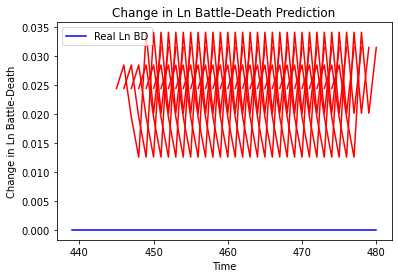

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+1', 'mse': 0.0005971168574637198, 'mae': 0.024435974657535553, 'r2': 0.0, 'tadda_score': 0.024435974657535553}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+2', 'mse': 0.0028001296329072667, 'mae': 0.05291625112295151, 'r2': 0.0, 'tadda_score': 0.05291625112295151}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+3', 'mse': 0.005241212493164227, 'mae': 0.07239621877670288, 'r2': 0.0, 'tadda_score': 0.07239621877670288}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+4', 'mse': 0.007220500627520332, 'mae': 0.0849735289812088, 'r2': 0.0, 'tadda_score': 0.0849735289812088}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+5', 'mse': 0.008215702975605588, 'mae': 0.09064051508903503, 'r2': 0.0, 'tadda_score': 0.09064051508903503}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+6', 'mse': 0.012273785069628895, 'mae': 0.110787

Epoch 56/100
25/25 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
25/25 [========

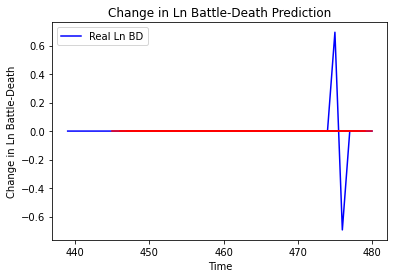

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ghana', 'country_id': 42, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Liberia']
Building vanilla Model...
Model: "sequential_602"
_________________________________________________________________
Layer (type)                 Output Shape      

Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 1.1917 - val_loss: 2.0733e-04
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 1.1982 - val_loss: 3.4492e-04
Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 1.1846 - val_loss: 4.5908e-04
Epoch 65/100
25/25 [==============================] - 0s 5ms/step - loss: 1.1863 - val_loss: 5.1633e-04
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 1.1891 - val_loss: 4.1515e-04
Epoch 67/100
25/25 [==============================] - 0s 4ms/step - loss: 1.1895 - val_loss: 3.9157e-04
Epoch 68/100
25/25 [==============================] - 0s 4ms/step - loss: 1.1976 - val_loss: 5.2438e-04
Epoch 69/100
25/25 [==============================] - 0s 5ms/step - loss: 1.1660 - val_loss: 3.4636e-04
Epoch 70/100
25/25 [==============================] - 0s 4ms/step - loss: 1.1756 - val_loss: 3.4323e-04
Epoch 71/100
25/25 [==============================] - 0s 5ms/ste

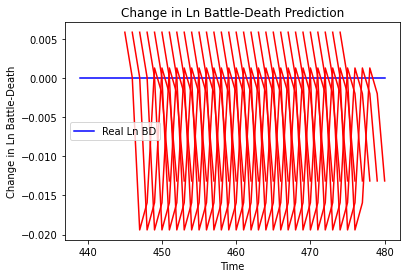

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Liberia', 'country_id': 43, 'step': 't+1', 'mse': 3.426030844874543e-05, 'mae': 0.005853230599313974, 'r2': 0.0, 'tadda_score': 0.005853230599313974}
{'country': 'Liberia', 'country_id': 43, 'step': 't+2', 'mse': 3.5099226439305265e-05, 'mae': 0.005924460012465715, 'r2': 0.0, 'tadda_score': 0.005924460012465715}
{'country': 'Liberia', 'country_id': 43, 'step': 't+3', 'mse': 0.0001815641027082121, 'mae': 0.013474572449922562, 'r2': 0.0, 'tadda_score': 0.013474572449922562}
{'country': 'Liberia', 'country_id': 43, 'step': 't+4', 'mse': 0.0008642466673595278, 'mae': 0.029398072510957718, 'r2': 0.0, 'tadda_score': 0.029398072510957718}
{'country': 'Liberia', 'country_id': 43, 'step': 't+5', 'mse': 0.000794227849234011, 'mae': 0.028182048350572586, 'r2': 0.0, 'tadda_score': 0.028182048350572586}
{'country': 'Liberia', 'country_id': 43, 'step': 't+6', 'mse': 0.0009103284353931297, 'mae': 0.030171649530529976, 'r2': 0.

25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
25/25 [=====================

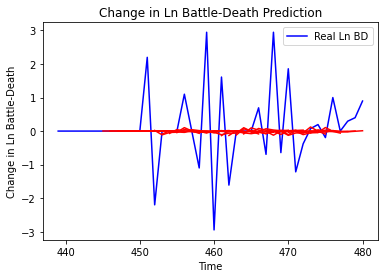

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+1', 'mse': 1.6742776543631133, 'mae': 0.8335248412330749, 'r2': -0.015278527382594831, 'tadda_score': 0.8465746639916477}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+2', 'mse': 1.2153790525381603, 'mae': 0.7374995573037526, 'r2': -0.027045985543387108, 'tadda_score': 0.749499747397866}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+3', 'mse': 2.079107497536221, 'mae': 0.9197378957385883, 'r2': -0.042883405759973625, 'tadda_score': 0.9401895886028871}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+4', 'mse': 2.449831263009633, 'mae': 1.0383192531516663, 'r2': -0.10361105329287468, 'tadda_score': 1.069929188651394}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+5', 'mse': 2.3406549435409576, 'mae': 0.950955364773219, 'r2': -0.12284161414109773, 'tadda_score': 0.968839185729171}
{'country': 'Burkina Faso', 'country_id': 47, 'step

25/25 [==============================] - 0s 7ms/step - loss: 0.2540 - val_loss: 1.2648e-05
Epoch 58/100
25/25 [==============================] - 0s 7ms/step - loss: 0.2560 - val_loss: 1.3389e-05
Epoch 59/100
25/25 [==============================] - 0s 6ms/step - loss: 0.2544 - val_loss: 9.3291e-05
Epoch 60/100
25/25 [==============================] - 0s 6ms/step - loss: 0.2567 - val_loss: 4.2841e-05
Epoch 61/100
25/25 [==============================] - 0s 6ms/step - loss: 0.2553 - val_loss: 5.9532e-05
Epoch 62/100
25/25 [==============================] - 0s 6ms/step - loss: 0.2533 - val_loss: 5.4142e-05
Epoch 63/100
25/25 [==============================] - 0s 5ms/step - loss: 0.2534 - val_loss: 6.3033e-05
Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 0.2637 - val_loss: 1.8559e-04
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 0.2568 - val_loss: 1.0374e-04
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 0.2

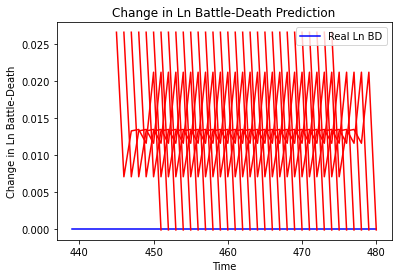

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea', 'country_id': 48, 'step': 't+1', 'mse': 0.0007065923676580349, 'mae': 0.02658180519938469, 'r2': 0.0, 'tadda_score': 0.02658180519938469}
{'country': 'Guinea', 'country_id': 48, 'step': 't+2', 'mse': 0.0011321690457655326, 'mae': 0.03364771977066994, 'r2': 0.0, 'tadda_score': 0.03364771977066994}
{'country': 'Guinea', 'country_id': 48, 'step': 't+3', 'mse': 0.0021999668244723214, 'mae': 0.04690380394458771, 'r2': 0.0, 'tadda_score': 0.04690380394458771}
{'country': 'Guinea', 'country_id': 48, 'step': 't+4', 'mse': 0.0036430286896736025, 'mae': 0.060357507318258286, 'r2': 0.0, 'tadda_score': 0.060357507318258286}
{'country': 'Guinea', 'country_id': 48, 'step': 't+5', 'mse': 0.004209467387228438, 'mae': 0.06488040834665298, 'r2': 0.0, 'tadda_score': 0.06488040834665298}
{'country': 'Guinea', 'country_id': 48, 'step': 't+6', 'mse': 0.007407183249913629, 'mae': 0.08606499433517456, 'r2': 0.0, 'tadda_score':

25/25 [==============================] - 0s 5ms/step - loss: 0.6276 - val_loss: 1.9249e-04
Epoch 59/100
25/25 [==============================] - 0s 6ms/step - loss: 0.6143 - val_loss: 2.8604e-04
Epoch 60/100
25/25 [==============================] - 0s 7ms/step - loss: 0.6148 - val_loss: 2.1427e-04
Epoch 61/100
25/25 [==============================] - 0s 8ms/step - loss: 0.6220 - val_loss: 5.6741e-04
Epoch 62/100
25/25 [==============================] - 0s 7ms/step - loss: 0.6282 - val_loss: 3.4923e-04
Epoch 63/100
25/25 [==============================] - 0s 8ms/step - loss: 0.6232 - val_loss: 3.7395e-05
Epoch 64/100
25/25 [==============================] - 0s 8ms/step - loss: 0.6364 - val_loss: 5.8245e-05
Epoch 65/100
25/25 [==============================] - 0s 6ms/step - loss: 0.6053 - val_loss: 1.7059e-04
Epoch 66/100
25/25 [==============================] - 0s 5ms/step - loss: 0.6151 - val_loss: 2.9031e-04
Epoch 67/100
25/25 [==============================] - 0s 6ms/step - loss: 0.5

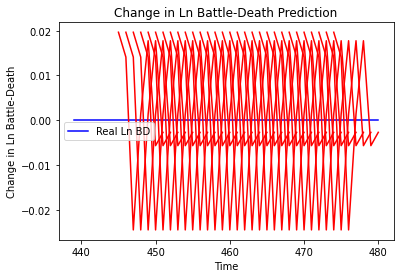

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+1', 'mse': 0.0003863394702608193, 'mae': 0.019655520096421242, 'r2': 0.0, 'tadda_score': 0.019655520096421242}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+2', 'mse': 0.0011401046155157246, 'mae': 0.033765435218811035, 'r2': 0.0, 'tadda_score': 0.033765435218811035}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+3', 'mse': 8.641717444138677e-05, 'mae': 0.009296083822846413, 'r2': 0.0, 'tadda_score': 0.009296083822846413}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+4', 'mse': 0.00011459889482680341, 'mae': 0.010705087333917618, 'r2': 0.0, 'tadda_score': 0.010705087333917618}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+5', 'mse': 0.00020605993183370197, 'mae': 0.014354787766933441, 'r2': 0.0, 'tadda_score': 0.014354787766933441}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+6', 'mse': 7.558985588364264e-05,

25/25 [==============================] - 0s 4ms/step - loss: 1.2663 - val_loss: 3.0076
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 1.2749 - val_loss: 3.0061
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 1.2815 - val_loss: 3.0068
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 1.2689 - val_loss: 3.0084
Epoch 64/100
25/25 [==============================] - 0s 5ms/step - loss: 1.2759 - val_loss: 3.0083
Epoch 65/100
25/25 [==============================] - 0s 5ms/step - loss: 1.2698 - val_loss: 3.0113
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 1.2643 - val_loss: 3.0097
Epoch 67/100
25/25 [==============================] - 0s 4ms/step - loss: 1.2766 - val_loss: 3.0110
Epoch 68/100
25/25 [==============================] - 0s 4ms/step - loss: 1.2682 - val_loss: 3.0095
Epoch 69/100
25/25 [==============================] - 0s 4ms/step - loss: 1.2715 - val_loss: 3.0115
Epoch 70/100


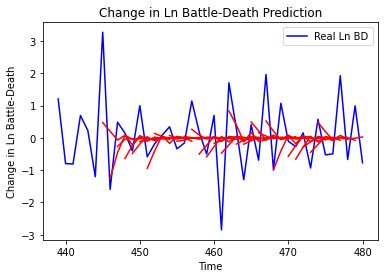

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mali', 'country_id': 50, 'step': 't+1', 'mse': 0.8450373024940698, 'mae': 0.6660735214989022, 'r2': 0.33061858114558185, 'tadda_score': 0.7500605742375688}
{'country': 'Mali', 'country_id': 50, 'step': 't+2', 'mse': 1.781800813711439, 'mae': 1.050335935450838, 'r2': -0.8403630889122988, 'tadda_score': 1.4044087988731726}
{'country': 'Mali', 'country_id': 50, 'step': 't+3', 'mse': 1.607403674990665, 'mae': 1.0622737427558573, 'r2': -0.4158653794576517, 'tadda_score': 1.3896461864939402}
{'country': 'Mali', 'country_id': 50, 'step': 't+4', 'mse': 2.357450074224165, 'mae': 1.2741589394075712, 'r2': -0.5764295252289746, 'tadda_score': 1.6786123908423425}
{'country': 'Mali', 'country_id': 50, 'step': 't+5', 'mse': 1.8578653178030493, 'mae': 1.1181078740293813, 'r2': -0.7158274207125461, 'tadda_score': 1.398289836467309}
{'country': 'Mali', 'country_id': 50, 'step': 't+6', 'mse': 2.0941790046807744, 'mae': 1.182852524

25/25 [==============================] - 0s 4ms/step - loss: 1.6428 - val_loss: 0.4289
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 1.6294 - val_loss: 0.4287
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 1.6467 - val_loss: 0.4293
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 1.6394 - val_loss: 0.4290
Epoch 64/100
25/25 [==============================] - 0s 5ms/step - loss: 1.6518 - val_loss: 0.4289
Epoch 65/100
25/25 [==============================] - 0s 5ms/step - loss: 1.6174 - val_loss: 0.4302
Epoch 66/100
25/25 [==============================] - 0s 5ms/step - loss: 1.6343 - val_loss: 0.4302
Epoch 67/100
25/25 [==============================] - 0s 4ms/step - loss: 1.6536 - val_loss: 0.4310
Epoch 68/100
25/25 [==============================] - 0s 5ms/step - loss: 1.6499 - val_loss: 0.4295
Epoch 69/100
25/25 [==============================] - 0s 5ms/step - loss: 1.6288 - val_loss: 0.4289
Epoch 70/100


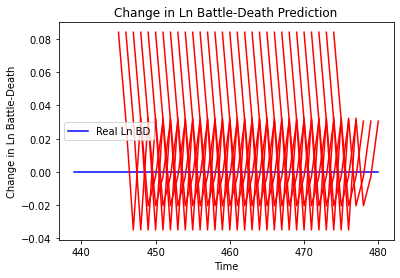

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Senegal', 'country_id': 52, 'step': 't+1', 'mse': 0.0070628332284888296, 'mae': 0.08404066413640976, 'r2': 0.0, 'tadda_score': 0.08404066413640976}
{'country': 'Senegal', 'country_id': 52, 'step': 't+2', 'mse': 0.013292980062083126, 'mae': 0.11529518663883209, 'r2': 0.0, 'tadda_score': 0.11529518663883209}
{'country': 'Senegal', 'country_id': 52, 'step': 't+3', 'mse': 0.006466452880624696, 'mae': 0.08041425794363022, 'r2': 0.0, 'tadda_score': 0.08041425794363022}
{'country': 'Senegal', 'country_id': 52, 'step': 't+4', 'mse': 0.01270538302348273, 'mae': 0.11271815747022629, 'r2': 0.0, 'tadda_score': 0.11271815747022629}
{'country': 'Senegal', 'country_id': 52, 'step': 't+5', 'mse': 0.0037376847253396545, 'mae': 0.06113660708069801, 'r2': 0.0, 'tadda_score': 0.06113660708069801}
{'country': 'Senegal', 'country_id': 52, 'step': 't+6', 'mse': 0.0034115509871599503, 'mae': 0.05840848386287689, 'r2': 0.0, 'tadda_score

25/25 [==============================] - 0s 4ms/step - loss: 2.1803 - val_loss: 0.0011
Epoch 59/100
25/25 [==============================] - 0s 4ms/step - loss: 2.1417 - val_loss: 0.0012
Epoch 60/100
25/25 [==============================] - 0s 4ms/step - loss: 2.1393 - val_loss: 5.0133e-04
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 2.1566 - val_loss: 5.3423e-04
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 2.1324 - val_loss: 8.4515e-04
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 2.1421 - val_loss: 9.2933e-04
Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 2.1370 - val_loss: 0.0014
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 2.1594 - val_loss: 0.0016
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 2.1249 - val_loss: 7.9967e-04
Epoch 67/100
25/25 [==============================] - 0s 4ms/step - loss: 2.1663 - val_loss: 

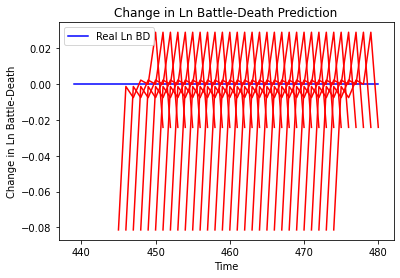

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+1', 'mse': 0.006627712763375371, 'mae': 0.08141076564788818, 'r2': 0.0, 'tadda_score': 0.08141076564788818}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+2', 'mse': 0.006855154165407384, 'mae': 0.08279585838317871, 'r2': 0.0, 'tadda_score': 0.08279585838317871}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+3', 'mse': 0.008174344261991706, 'mae': 0.09041208028793335, 'r2': 0.0, 'tadda_score': 0.09041208028793335}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+4', 'mse': 0.0077890876029071965, 'mae': 0.08825580775737762, 'r2': 0.0, 'tadda_score': 0.08825580775737762}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+5', 'mse': 0.007571940087386375, 'mae': 0.08701689541339874, 'r2': 0.0, 'tadda_score': 0.08701689541339874}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+6', 'mse': 0.0033820105487336743, 'mae': 0.058155056089

Epoch 56/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
25/25 [========

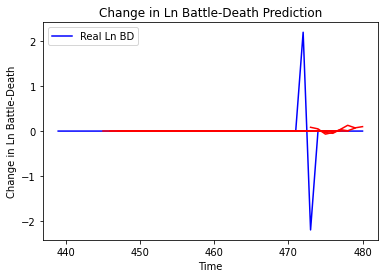

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'The Gambia', 'country_id': 54, 'step': 't+1', 'mse': 0.3344635006101058, 'mae': 0.14996411150983358, 'r2': -0.03918075081110084, 'tadda_score': 0.1527766746410865}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+2', 'mse': 0.3206260668255155, 'mae': 0.15051594397715115, 'r2': 0.00381226577617777, 'tadda_score': 0.15051594397715115}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+3', 'mse': 0.16120023594117155, 'mae': 0.07751101607477359, 'r2': -0.03624223256999781, 'tadda_score': 0.07751101607477359}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+4', 'mse': 0.16098918190446462, 'mae': 0.0752661927729417, 'r2': -0.03488551553473296, 'tadda_score': 0.0752661927729417}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+5', 'mse': 0.16154135505451395, 'mae': 0.07832870462929896, 'r2': -0.0384350459335665, 'tadda_score': 0.07832870462929896}
{'country': 'The Gambia', 'country_id': 54, 'step'

25/25 [==============================] - 0s 5ms/step - loss: 0.6218 - val_loss: 3.3744e-04
Epoch 58/100
25/25 [==============================] - 0s 7ms/step - loss: 0.6199 - val_loss: 3.9437e-04
Epoch 59/100
25/25 [==============================] - 0s 7ms/step - loss: 0.6200 - val_loss: 3.2961e-04
Epoch 60/100
25/25 [==============================] - 0s 6ms/step - loss: 0.6216 - val_loss: 4.1735e-04
Epoch 61/100
25/25 [==============================] - 0s 6ms/step - loss: 0.6203 - val_loss: 6.7896e-04
Epoch 62/100
25/25 [==============================] - 0s 6ms/step - loss: 0.6182 - val_loss: 3.6791e-04
Epoch 63/100
25/25 [==============================] - 0s 6ms/step - loss: 0.6272 - val_loss: 1.5020e-04
Epoch 64/100
25/25 [==============================] - ETA: 0s - loss: 0.616 - 0s 6ms/step - loss: 0.6197 - val_loss: 4.6167e-04
Epoch 65/100
25/25 [==============================] - 0s 6ms/step - loss: 0.6120 - val_loss: 8.5625e-04
Epoch 66/100
25/25 [==============================] -

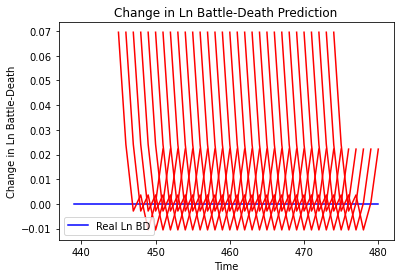

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Djibouti', 'country_id': 55, 'step': 't+1', 'mse': 0.004832876617023807, 'mae': 0.06951889395713806, 'r2': 0.0, 'tadda_score': 0.06951889395713806}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+2', 'mse': 0.00876224553011401, 'mae': 0.0936068668961525, 'r2': 0.0, 'tadda_score': 0.0936068668961525}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+3', 'mse': 0.008230188311345366, 'mae': 0.09072038531303406, 'r2': 0.0, 'tadda_score': 0.09072038531303406}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+4', 'mse': 0.008899734120604075, 'mae': 0.09433840215206146, 'r2': 0.0, 'tadda_score': 0.09433840215206146}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+5', 'mse': 0.0035659763232077785, 'mae': 0.05971579626202583, 'r2': 0.0, 'tadda_score': 0.05971579626202583}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+6', 'mse': 0.0036199279908990523, 'mae': 0.06016583740711212, 'r2': 0.0, 'tadda_sc

22/22 [==============================] - 0s 5ms/step - loss: 1.9342 - val_loss: 0.0309
Epoch 61/100
22/22 [==============================] - 0s 5ms/step - loss: 1.9346 - val_loss: 0.0297
Epoch 62/100
22/22 [==============================] - 0s 5ms/step - loss: 1.9410 - val_loss: 0.0298
Epoch 63/100
22/22 [==============================] - 0s 5ms/step - loss: 1.9597 - val_loss: 0.0304
Epoch 64/100
22/22 [==============================] - 0s 5ms/step - loss: 1.9385 - val_loss: 0.0296
Epoch 65/100
22/22 [==============================] - 0s 5ms/step - loss: 1.9450 - val_loss: 0.0301
Epoch 66/100
22/22 [==============================] - 0s 4ms/step - loss: 1.9448 - val_loss: 0.0295
Epoch 67/100
22/22 [==============================] - 0s 5ms/step - loss: 1.9281 - val_loss: 0.0297
Epoch 68/100
22/22 [==============================] - 0s 5ms/step - loss: 1.9174 - val_loss: 0.0302
Epoch 69/100
22/22 [==============================] - 0s 5ms/step - loss: 1.9424 - val_loss: 0.0316
Epoch 70/100


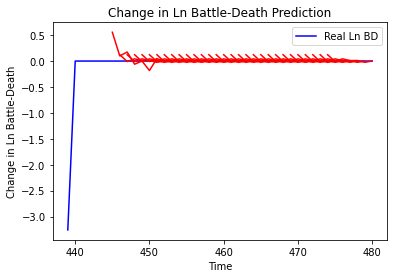

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Eritrea', 'country_id': 56, 'step': 't+1', 'mse': 0.02476697281703366, 'mae': 0.13680587609608968, 'r2': 0.0, 'tadda_score': 0.13680587609608968}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+2', 'mse': 0.026578862034956074, 'mae': 0.1307682991027832, 'r2': 0.0, 'tadda_score': 0.1307682991027832}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+3', 'mse': 0.04623264476948815, 'mae': 0.1777917633454005, 'r2': 0.0, 'tadda_score': 0.1777917633454005}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+4', 'mse': 0.04534693965300072, 'mae': 0.18324883182843527, 'r2': 0.0, 'tadda_score': 0.18324883182843527}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+5', 'mse': 0.047539630850124345, 'mae': 0.19997551838556926, 'r2': 0.0, 'tadda_score': 0.19997551838556926}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+6', 'mse': 0.032414134816887596, 'mae': 0.17026870846748351, 'r2': 0.0, 'tadda_score': 0.1702

22/22 [==============================] - 0s 4ms/step - loss: 4.5285 - val_loss: 2.6165
Epoch 61/100
22/22 [==============================] - 0s 4ms/step - loss: 4.5671 - val_loss: 2.6171
Epoch 62/100
22/22 [==============================] - 0s 4ms/step - loss: 4.6061 - val_loss: 2.6167
Epoch 63/100
22/22 [==============================] - 0s 5ms/step - loss: 4.5121 - val_loss: 2.6147
Epoch 64/100
22/22 [==============================] - 0s 4ms/step - loss: 4.5621 - val_loss: 2.6163
Epoch 65/100
22/22 [==============================] - 0s 4ms/step - loss: 4.5452 - val_loss: 2.6210
Epoch 66/100
22/22 [==============================] - 0s 4ms/step - loss: 4.5553 - val_loss: 2.6159
Epoch 67/100
22/22 [==============================] - 0s 5ms/step - loss: 4.5101 - val_loss: 2.6136
Epoch 68/100
22/22 [==============================] - 0s 5ms/step - loss: 4.5208 - val_loss: 2.6145
Epoch 69/100
22/22 [==============================] - 0s 5ms/step - loss: 4.5502 - val_loss: 2.6112
Epoch 70/100


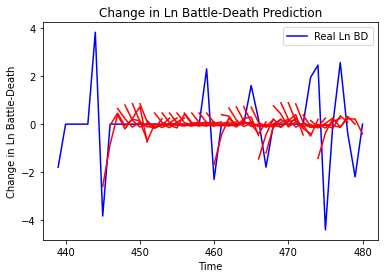

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+1', 'mse': 1.2067767897038355, 'mae': 0.8460442198928202, 'r2': 0.11542264708761407, 'tadda_score': 0.9419750068203613}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+2', 'mse': 4.091158897218593, 'mae': 1.461051169155211, 'r2': -1.050464123665086, 'tadda_score': 1.6611277094663885}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+3', 'mse': 4.053170108373089, 'mae': 1.4530757906468421, 'r2': -1.0314243721946283, 'tadda_score': 1.6789978248309798}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+4', 'mse': 4.238267361441988, 'mae': 1.4881123763751696, 'r2': -1.1241939972181796, 'tadda_score': 1.7229390354138325}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+5', 'mse': 3.2300482180962744, 'mae': 1.2270373636167953, 'r2': -0.618880653454335, 'tadda_score': 1.3815760288319696}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+6', 'mse': 2.7061595328497

Epoch 60/100
25/25 [==============================] - 0s 7ms/step - loss: 0.9201 - val_loss: 0.9997
Epoch 61/100
25/25 [==============================] - 0s 5ms/step - loss: 0.9217 - val_loss: 0.9999
Epoch 62/100
25/25 [==============================] - 0s 6ms/step - loss: 0.9226 - val_loss: 1.0006
Epoch 63/100
25/25 [==============================] - 0s 6ms/step - loss: 0.9216 - val_loss: 1.0024
Epoch 64/100
25/25 [==============================] - 0s 5ms/step - loss: 0.9230 - val_loss: 1.0008
Epoch 65/100
25/25 [==============================] - 0s 5ms/step - loss: 0.9102 - val_loss: 1.0010
Epoch 66/100
25/25 [==============================] - 0s 5ms/step - loss: 0.9259 - val_loss: 1.0012
Epoch 67/100
25/25 [==============================] - 0s 5ms/step - loss: 0.9072 - val_loss: 1.0012
Epoch 68/100
25/25 [==============================] - 0s 5ms/step - loss: 0.9183 - val_loss: 1.0018
Epoch 69/100
25/25 [==============================] - 0s 5ms/step - loss: 0.9173 - val_loss: 1.0026


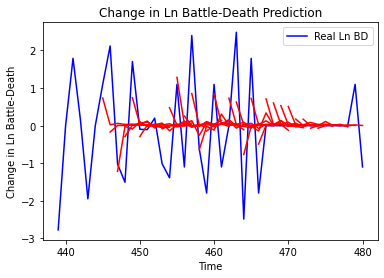

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Algeria', 'country_id': 67, 'step': 't+1', 'mse': 1.0634810919180802, 'mae': 0.7995659108161963, 'r2': 0.3331860804131136, 'tadda_score': 0.8324593134423134}
{'country': 'Algeria', 'country_id': 67, 'step': 't+2', 'mse': 2.288837148749281, 'mae': 1.1496223757909116, 'r2': -0.3590054125383606, 'tadda_score': 1.3931311635545274}
{'country': 'Algeria', 'country_id': 67, 'step': 't+3', 'mse': 2.6171104777981715, 'mae': 1.267050810868145, 'r2': -0.45892097442123947, 'tadda_score': 1.546239378764829}
{'country': 'Algeria', 'country_id': 67, 'step': 't+4', 'mse': 2.8088809113089552, 'mae': 1.2990797557378835, 'r2': -0.37589830779865485, 'tadda_score': 1.546490968559685}
{'country': 'Algeria', 'country_id': 67, 'step': 't+5', 'mse': 2.1072395576809755, 'mae': 1.0615755238217448, 'r2': -0.5658238328959753, 'tadda_score': 1.2802311696690654}
{'country': 'Algeria', 'country_id': 67, 'step': 't+6', 'mse': 2.2222791723276862

Epoch 60/100
25/25 [==============================] - 0s 5ms/step - loss: 0.1831 - val_loss: 1.4596
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1843 - val_loss: 1.4612
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1864 - val_loss: 1.4602
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1840 - val_loss: 1.4595
Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1863 - val_loss: 1.4587
Epoch 65/100
25/25 [==============================] - 0s 5ms/step - loss: 0.1877 - val_loss: 1.4596
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1880 - val_loss: 1.4597
Epoch 67/100
25/25 [==============================] - 0s 5ms/step - loss: 0.1870 - val_loss: 1.4589
Epoch 68/100
25/25 [==============================] - 0s 5ms/step - loss: 0.1799 - val_loss: 1.4581
Epoch 69/100
25/25 [==============================] - 0s 6ms/step - loss: 0.1847 - val_loss: 1.4572


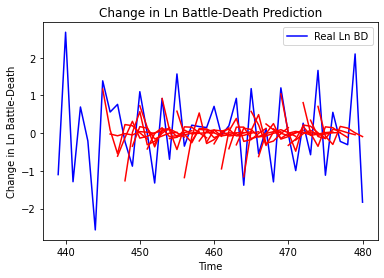

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cameroon', 'country_id': 69, 'step': 't+1', 'mse': 0.545503317885587, 'mae': 0.6326332815581607, 'r2': 0.25928746455997387, 'tadda_score': 0.7243197412509766}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+2', 'mse': 1.6549626964207624, 'mae': 1.123715259123003, 'r2': -1.2421151703372533, 'tadda_score': 1.5446073489766874}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+3', 'mse': 1.3441787805549414, 'mae': 0.9439991280281395, 'r2': -0.37160679990149714, 'tadda_score': 1.114798750464504}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+4', 'mse': 1.5052349219029815, 'mae': 0.9556571670995664, 'r2': -0.7091548965342696, 'tadda_score': 1.1984199002262463}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+5', 'mse': 1.8427737326718832, 'mae': 1.1212388670678601, 'r2': -0.85262009187771, 'tadda_score': 1.4467184803123938}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+6', 'mse': 2.06599512613

25/25 [==============================] - 0s 4ms/step - loss: 0.7266 - val_loss: 2.3857
Epoch 60/100
25/25 [==============================] - 0s 4ms/step - loss: 0.7264 - val_loss: 2.3863
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 0.7143 - val_loss: 2.3847
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 0.7279 - val_loss: 2.3839
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 0.7175 - val_loss: 2.3859
Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 0.7246 - val_loss: 2.3858
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 0.7228 - val_loss: 2.3845
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 0.7351 - val_loss: 2.3855
Epoch 67/100
25/25 [==============================] - 0s 4ms/step - loss: 0.7251 - val_loss: 2.3864
Epoch 68/100
25/25 [==============================] - 0s 4ms/step - loss: 0.7187 - val_loss: 2.3860
Epoch 69/100


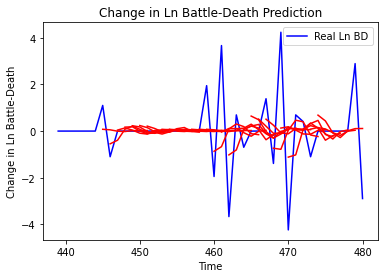

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+1', 'mse': 1.954695495722362, 'mae': 0.8779028399267719, 'r2': 0.2609106248524621, 'tadda_score': 0.8842273906845773}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+2', 'mse': 2.121451635105324, 'mae': 1.096300022485035, 'r2': -0.4491055151593468, 'tadda_score': 1.1974702980937335}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+3', 'mse': 2.525314411099837, 'mae': 1.056689232063568, 'r2': -0.07743553537368508, 'tadda_score': 1.1529250020506743}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+4', 'mse': 3.007640785695743, 'mae': 1.1366126292277992, 'r2': -0.2440364588346302, 'tadda_score': 1.2221229208836575}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+5', 'mse': 2.796071426807326, 'mae': 0.9445581692263956, 'r2': -0.10335478966726774, 'tadda_score': 0.993254464150019}


25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 57/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 58/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 59/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 60/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0

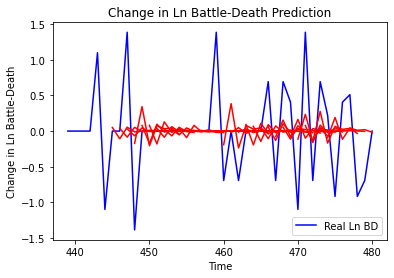

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tunisia', 'country_id': 73, 'step': 't+1', 'mse': 0.3649384011527977, 'mae': 0.39834876279585935, 'r2': 0.11603089817663537, 'tadda_score': 0.4041252351855574}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+2', 'mse': 0.3930873097815621, 'mae': 0.426775848610437, 'r2': 0.044736481344820445, 'tadda_score': 0.4388514028794925}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+3', 'mse': 0.48776451344712574, 'mae': 0.47029963307192185, 'r2': -0.02084588504496665, 'tadda_score': 0.47488972337405144}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+4', 'mse': 0.49442527304955186, 'mae': 0.4590380735742362, 'r2': -0.023931869145592533, 'tadda_score': 0.4608115183546952}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+5', 'mse': 0.5035340868003977, 'mae': 0.5061849248203899, 'r2': -0.1445553108840325, 'tadda_score': 0.5466983739826347}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+6', 'mse': 0.59789

25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
25/25 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
25/25 [=====================

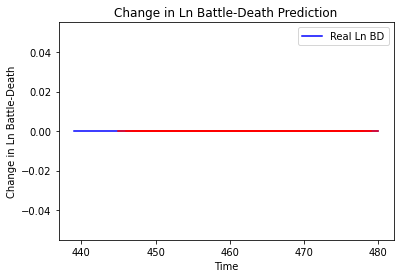

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Benin', 'country_id': 74, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Equatorial Guinea']
Building vanilla Model...
Model: "sequential_618"
_________________________________________________________________
Layer (type)                 Output S

25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
25/25 [=====================

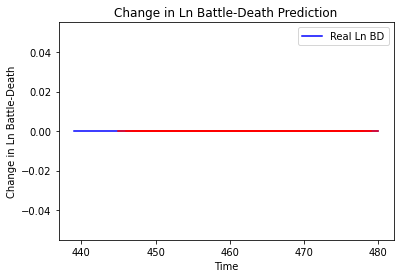

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Niger']
Building vanilla Model...
Model: "sequential_619"
_______________________________

25/25 [==============================] - 0s 4ms/step - loss: 0.8537 - val_loss: 1.6335
Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 0.8499 - val_loss: 1.6325
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 0.8560 - val_loss: 1.6334
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 0.8546 - val_loss: 1.6327
Epoch 67/100
25/25 [==============================] - 0s 4ms/step - loss: 0.8433 - val_loss: 1.6320
Epoch 68/100
25/25 [==============================] - 0s 4ms/step - loss: 0.8444 - val_loss: 1.6324
Epoch 69/100
25/25 [==============================] - 0s 4ms/step - loss: 0.8478 - val_loss: 1.6314
Epoch 70/100
25/25 [==============================] - 0s 5ms/step - loss: 0.8457 - val_loss: 1.6311
Epoch 71/100
25/25 [==============================] - 0s 5ms/step - loss: 0.8534 - val_loss: 1.6312
Epoch 72/100
25/25 [==============================] - 0s 4ms/step - loss: 0.8472 - val_loss: 1.6300
Epoch 73/100


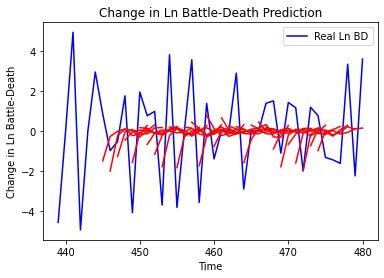

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Niger', 'country_id': 78, 'step': 't+1', 'mse': 3.280329789122159, 'mae': 1.5491426388076461, 'r2': 0.24274470846105023, 'tadda_score': 1.8366404135675747}
{'country': 'Niger', 'country_id': 78, 'step': 't+2', 'mse': 6.335586757331413, 'mae': 2.110240449537724, 'r2': -0.6134193783885291, 'tadda_score': 2.5612908254364024}
{'country': 'Niger', 'country_id': 78, 'step': 't+3', 'mse': 5.936131853112098, 'mae': 1.9056275867617196, 'r2': -0.5326823712743534, 'tadda_score': 2.3921443420843342}
{'country': 'Niger', 'country_id': 78, 'step': 't+4', 'mse': 6.256483242073506, 'mae': 2.0826991491675058, 'r2': -0.3789220089559031, 'tadda_score': 2.4957281359195393}
{'country': 'Niger', 'country_id': 78, 'step': 't+5', 'mse': 7.704360504592082, 'mae': 2.2272486491512624, 'r2': -0.4005819271975546, 'tadda_score': 2.688644360354679}
{'country': 'Niger', 'country_id': 78, 'step': 't+6', 'mse': 7.2215805298723215, 'mae': 2.10642

25/25 [==============================] - 0s 6ms/step - loss: 0.5310 - val_loss: 1.1841
Epoch 61/100
25/25 [==============================] - 0s 5ms/step - loss: 0.5280 - val_loss: 1.1861
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 0.5349 - val_loss: 1.1896
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 0.5306 - val_loss: 1.1879
Epoch 64/100
25/25 [==============================] - 0s 5ms/step - loss: 0.5368 - val_loss: 1.1900
Epoch 65/100
25/25 [==============================] - 0s 6ms/step - loss: 0.5289 - val_loss: 1.1949
Epoch 66/100
25/25 [==============================] - 0s 9ms/step - loss: 0.5350 - val_loss: 1.1949
Epoch 67/100
25/25 [==============================] - 0s 9ms/step - loss: 0.5329 - val_loss: 1.1929
Epoch 68/100
25/25 [==============================] - 0s 7ms/step - loss: 0.5319 - val_loss: 1.1936
Epoch 69/100
25/25 [==============================] - 0s 8ms/step - loss: 0.5449 - val_loss: 1.1911
Epoch 70/100


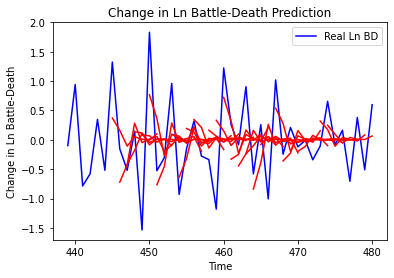

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Nigeria', 'country_id': 79, 'step': 't+1', 'mse': 0.41901888125946046, 'mae': 0.49134698486138173, 'r2': 0.26681664787045467, 'tadda_score': 0.5524127313947557}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+2', 'mse': 1.2594892887734717, 'mae': 0.8987878068012347, 'r2': -1.327774254327914, 'tadda_score': 1.203369373949602}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+3', 'mse': 1.0243627957878165, 'mae': 0.8215995726490394, 'r2': -0.6719107688778454, 'tadda_score': 1.0426683033510422}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+4', 'mse': 1.2101615082506612, 'mae': 0.8659140721423113, 'r2': -0.6268325933828327, 'tadda_score': 1.137499262686837}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+5', 'mse': 0.7882182017252664, 'mae': 0.6816012264785641, 'r2': -0.5395996764290878, 'tadda_score': 0.8496066733198835}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+6', 'mse': 0.75644121844275

25/25 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
25/25 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
25/25 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
25/25 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
25/25 [=====================

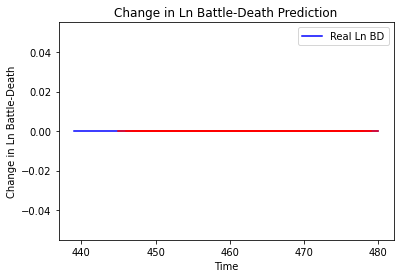

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Togo']
Building vanilla Model...
Model: "sequential_622"
____

25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
25/25 [=====================

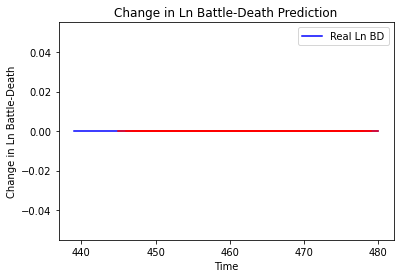

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Togo', 'country_id': 81, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Somalia']
Building vanilla Model...
Model: "sequential_623"
_________________________________________________________________
Layer (type)                 Output Shape             

25/25 [==============================] - 0s 4ms/step - loss: 2.5498 - val_loss: 0.3689
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 2.5576 - val_loss: 0.3693
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 2.5549 - val_loss: 0.3697
Epoch 67/100
25/25 [==============================] - 0s 4ms/step - loss: 2.5712 - val_loss: 0.3695
Epoch 68/100
25/25 [==============================] - 0s 5ms/step - loss: 2.5752 - val_loss: 0.3686
Epoch 69/100
25/25 [==============================] - 0s 5ms/step - loss: 2.5561 - val_loss: 0.3687
Epoch 70/100
25/25 [==============================] - 0s 4ms/step - loss: 2.5601 - val_loss: 0.3698
Epoch 71/100
25/25 [==============================] - 0s 5ms/step - loss: 2.5840 - val_loss: 0.3700
Epoch 72/100
25/25 [==============================] - 0s 5ms/step - loss: 2.5745 - val_loss: 0.3696
Epoch 73/100
25/25 [==============================] - 0s 5ms/step - loss: 2.5539 - val_loss: 0.3693
Epoch 74/100


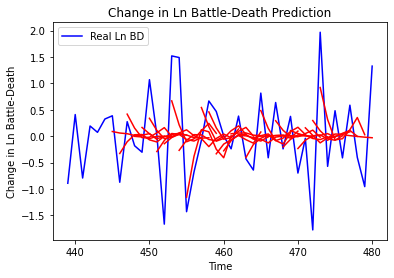

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Somalia', 'country_id': 120, 'step': 't+1', 'mse': 0.5362280374787798, 'mae': 0.5546354207462313, 'r2': 0.29609065709601234, 'tadda_score': 0.6343604097084445}
{'country': 'Somalia', 'country_id': 120, 'step': 't+2', 'mse': 1.4177732829700818, 'mae': 0.9068807834008697, 'r2': -0.44577528508992104, 'tadda_score': 1.1246722926566364}
{'country': 'Somalia', 'country_id': 120, 'step': 't+3', 'mse': 1.3506272588480468, 'mae': 0.8460409230329191, 'r2': -0.6923170427142307, 'tadda_score': 1.0663444523476158}
{'country': 'Somalia', 'country_id': 120, 'step': 't+4', 'mse': 1.0404584411012587, 'mae': 0.8415309128637212, 'r2': -0.5009961406406742, 'tadda_score': 1.0081725879858034}
{'country': 'Somalia', 'country_id': 120, 'step': 't+5', 'mse': 0.9310889755394207, 'mae': 0.7173975762270277, 'r2': -0.20780196050598, 'tadda_score': 0.8789153740100449}
{'country': 'Somalia', 'country_id': 120, 'step': 't+6', 'mse': 1.09522877

25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
25/25 [=====================

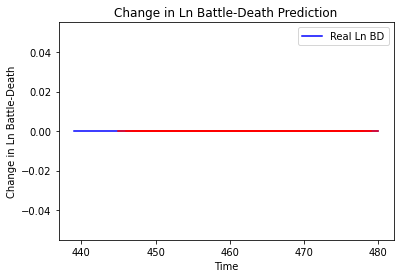

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Botswana', 'country_id': 154, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Burundi']
Building vanilla Model...
Model: "sequential_625"
_________________________________________________________________
Layer (type)       

Epoch 64/100
25/25 [==============================] - 0s 5ms/step - loss: 1.9342 - val_loss: 1.6151
Epoch 65/100
25/25 [==============================] - 0s 5ms/step - loss: 1.9198 - val_loss: 1.6140
Epoch 66/100
25/25 [==============================] - 0s 5ms/step - loss: 1.9170 - val_loss: 1.6135
Epoch 67/100
25/25 [==============================] - 0s 7ms/step - loss: 1.9229 - val_loss: 1.6146
Epoch 68/100
25/25 [==============================] - 0s 6ms/step - loss: 1.9299 - val_loss: 1.6143
Epoch 69/100
25/25 [==============================] - 0s 5ms/step - loss: 1.9183 - val_loss: 1.6136
Epoch 70/100
25/25 [==============================] - 0s 5ms/step - loss: 1.9215 - val_loss: 1.6148
Epoch 71/100
25/25 [==============================] - 0s 5ms/step - loss: 1.9115 - val_loss: 1.6137
Epoch 72/100
25/25 [==============================] - 0s 5ms/step - loss: 1.9335 - val_loss: 1.6137
Epoch 73/100
25/25 [==============================] - 0s 4ms/step - loss: 1.9255 - val_loss: 1.6125


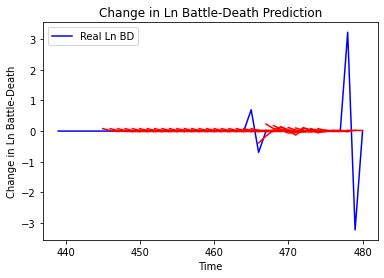

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burundi', 'country_id': 155, 'step': 't+1', 'mse': 0.025109967721370568, 'mae': 0.1193494393151808, 'r2': 0.21605338106030858, 'tadda_score': 0.1193494393151808}
{'country': 'Burundi', 'country_id': 155, 'step': 't+2', 'mse': 0.06785974124184957, 'mae': 0.17401877330956939, 'r2': -1.1186174071977901, 'tadda_score': 0.18438451774138293}
{'country': 'Burundi', 'country_id': 155, 'step': 't+3', 'mse': 0.06081270825547684, 'mae': 0.1584989062171984, 'r2': -0.8986052692083975, 'tadda_score': 0.16601071568546774}
{'country': 'Burundi', 'country_id': 155, 'step': 't+4', 'mse': 0.0501240246793461, 'mae': 0.14689328235604446, 'r2': -0.5648988525612582, 'tadda_score': 0.15145209791479589}
{'country': 'Burundi', 'country_id': 155, 'step': 't+5', 'mse': 0.03749836826696717, 'mae': 0.10163895164646787, 'r2': -0.1707191082378572, 'tadda_score': 0.1037184522769658}
{'country': 'Burundi', 'country_id': 155, 'step': 't+6', 'mse'

25/25 [==============================] - 0s 6ms/step - loss: 2.4290 - val_loss: 0.1823
Epoch 60/100
25/25 [==============================] - 0s 6ms/step - loss: 2.4041 - val_loss: 0.1826
Epoch 61/100
25/25 [==============================] - 0s 8ms/step - loss: 2.4047 - val_loss: 0.1824
Epoch 62/100
25/25 [==============================] - 0s 8ms/step - loss: 2.4224 - val_loss: 0.1825
Epoch 63/100
25/25 [==============================] - 0s 7ms/step - loss: 2.3981 - val_loss: 0.1833
Epoch 64/100
25/25 [==============================] - 0s 6ms/step - loss: 2.4041 - val_loss: 0.1828
Epoch 65/100
25/25 [==============================] - 0s 6ms/step - loss: 2.4327 - val_loss: 0.1848
Epoch 66/100
25/25 [==============================] - 0s 5ms/step - loss: 2.4100 - val_loss: 0.1820
Epoch 67/100
25/25 [==============================] - 0s 5ms/step - loss: 2.4249 - val_loss: 0.1849
Epoch 68/100
25/25 [==============================] - 0s 5ms/step - loss: 2.4170 - val_loss: 0.1836
Epoch 69/100


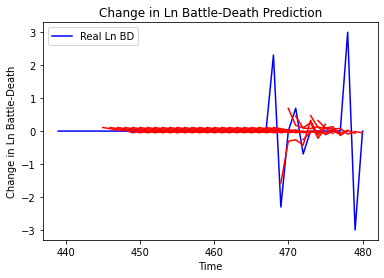

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Rwanda', 'country_id': 156, 'step': 't+1', 'mse': 0.22191311704646288, 'mae': 0.2516889405512269, 'r2': 0.4243350699246409, 'tadda_score': 0.2516889405512269}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+2', 'mse': 0.6897451468318949, 'mae': 0.44915590457751914, 'r2': -0.7892682370716582, 'tadda_score': 0.4972961740954177}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+3', 'mse': 0.592609401762657, 'mae': 0.4793904760024595, 'r2': -1.1233779105266528, 'tadda_score': 0.5157434521656878}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+4', 'mse': 0.6081550121508557, 'mae': 0.49093053531455433, 'r2': -0.6483795104951009, 'tadda_score': 0.49093053531455433}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+5', 'mse': 0.5978736780076859, 'mae': 0.3763871146145018, 'r2': -0.6205123710264702, 'tadda_score': 0.394939096063629}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+6', 'mse': 0.590428403480

25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
25/25 [=====================

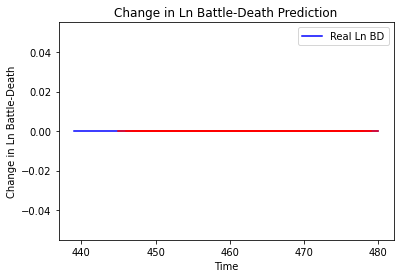

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zambia', 'country_id': 157, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Zimbabwe']
Building vanilla Model...
Model: "sequential_628"
_________________________________________________________________
Layer (type)                 Out

25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
25/25 [=====================

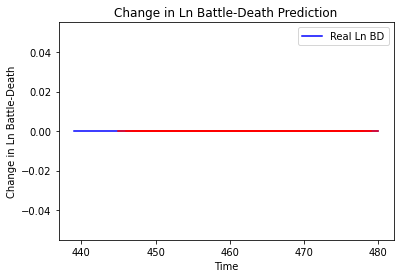

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Comoros']
Building vanilla Model...
Model: "sequential_629"
_________________________________________________________________
Layer (type)       

25/25 [==============================] - 0s 4ms/step - loss: 0.1265 - val_loss: 2.7000e-05
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1265 - val_loss: 7.9066e-06
Epoch 63/100
25/25 [==============================] - 0s 5ms/step - loss: 0.1264 - val_loss: 1.7271e-04
Epoch 64/100
25/25 [==============================] - 0s 5ms/step - loss: 0.1247 - val_loss: 4.4751e-05
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1280 - val_loss: 6.4364e-06
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1254 - val_loss: 4.9501e-05
Epoch 67/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1261 - val_loss: 4.3866e-05
Epoch 68/100
25/25 [==============================] - 0s 5ms/step - loss: 0.1271 - val_loss: 4.3977e-05
Epoch 69/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1263 - val_loss: 2.7601e-05
Epoch 70/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1

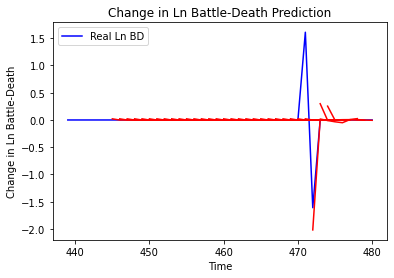

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Comoros', 'country_id': 159, 'step': 't+1', 'mse': 0.09513315286490774, 'mae': 0.10314648610850176, 'r2': 0.44909756207646856, 'tadda_score': 0.10314648610850176}
{'country': 'Comoros', 'country_id': 159, 'step': 't+2', 'mse': 0.34028593693427056, 'mae': 0.2082531550099293, 'r2': -0.9705470343696945, 'tadda_score': 0.217951654252394}
{'country': 'Comoros', 'country_id': 159, 'step': 't+3', 'mse': 0.3369616426606154, 'mae': 0.20967572025406753, 'r2': -0.9512965232220985, 'tadda_score': 0.21793780418185787}
{'country': 'Comoros', 'country_id': 159, 'step': 't+4', 'mse': 0.22882036883711374, 'mae': 0.15627675775785443, 'r2': -1.7415157034129898, 'tadda_score': 0.15627675775785443}
{'country': 'Comoros', 'country_id': 159, 'step': 't+5', 'mse': 0.23858232936081036, 'mae': 0.16151981731602746, 'r2': -1.8584745572415269, 'tadda_score': 0.16151981731602746}
{'country': 'Comoros', 'country_id': 159, 'step': 't+6', 'mse'

25/25 [==============================] - 0s 4ms/step - loss: 0.1386 - val_loss: 3.5225e-05
Epoch 58/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1384 - val_loss: 4.2689e-05
Epoch 59/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1447 - val_loss: 3.3586e-05
Epoch 60/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1381 - val_loss: 6.4651e-05
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1386 - val_loss: 1.0246e-05
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1398 - val_loss: 2.1348e-05
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1384 - val_loss: 4.6624e-05
Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1369 - val_loss: 2.4760e-05
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1374 - val_loss: 4.6355e-05
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1

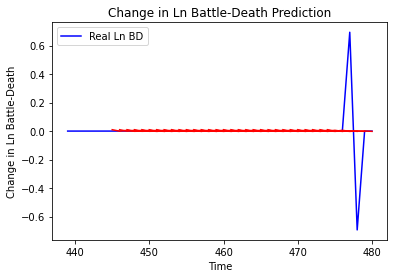

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Lesotho', 'country_id': 160, 'step': 't+1', 'mse': 9.254930355842919e-05, 'mae': 0.00962025485932827, 'r2': 0.0, 'tadda_score': 0.00962025485932827}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+2', 'mse': 7.99537279488555e-05, 'mae': 0.00894168484956026, 'r2': 0.0, 'tadda_score': 0.00894168484956026}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+3', 'mse': 0.00020391807425485745, 'mae': 0.014279988594353199, 'r2': 0.0, 'tadda_score': 0.014279988594353199}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+4', 'mse': 0.00016092351916331682, 'mae': 0.012685563415288925, 'r2': 0.0, 'tadda_score': 0.012685563415288925}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+5', 'mse': 0.0001710494413094711, 'mae': 0.013078587129712105, 'r2': 0.0, 'tadda_score': 0.013078587129712105}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+6', 'mse': 0.00018987371002568768, 'mae': 0.013779466971755028, 'r2'

25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
25/25 [=====================

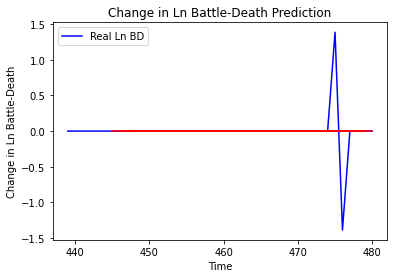

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Malawi', 'country_id': 161, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mozambique']
Building vanilla Model...
Model: "sequential_632"
_________________________________________________________________
Layer (type)                 O

25/25 [==============================] - 0s 4ms/step - loss: 0.9927 - val_loss: 0.6911
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 0.9724 - val_loss: 0.6920
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 1.0058 - val_loss: 0.6927
Epoch 67/100
25/25 [==============================] - 0s 5ms/step - loss: 1.0261 - val_loss: 0.6932
Epoch 68/100
25/25 [==============================] - 0s 5ms/step - loss: 1.0555 - val_loss: 0.6933
Epoch 69/100
25/25 [==============================] - 0s 4ms/step - loss: 0.9784 - val_loss: 0.6933
Epoch 70/100
25/25 [==============================] - 0s 4ms/step - loss: 1.0581 - val_loss: 0.6938
Epoch 71/100
25/25 [==============================] - 0s 5ms/step - loss: 0.9971 - val_loss: 0.6945
Epoch 72/100
25/25 [==============================] - 0s 6ms/step - loss: 1.0326 - val_loss: 0.6956
Epoch 73/100
25/25 [==============================] - 0s 6ms/step - loss: 1.0034 - val_loss: 0.6947
Epoch 74/100


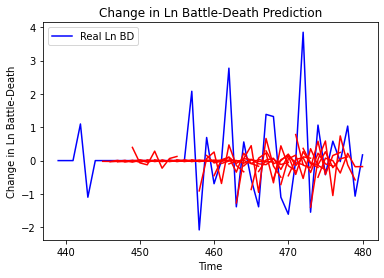

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mozambique', 'country_id': 162, 'step': 't+1', 'mse': 1.2499008441873691, 'mae': 0.6768374222104486, 'r2': 0.2056825902044288, 'tadda_score': 0.7202190275077757}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+2', 'mse': 2.476605343041567, 'mae': 1.02581907299379, 'r2': -0.2944016738318258, 'tadda_score': 1.1789398956395134}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+3', 'mse': 2.412078965628504, 'mae': 1.0929382740553697, 'r2': -0.26034275033181586, 'tadda_score': 1.2191015017252647}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+4', 'mse': 2.6000558114844576, 'mae': 1.1523145513771935, 'r2': -0.72528627431631, 'tadda_score': 1.4507855693041247}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+5', 'mse': 1.346626334090182, 'mae': 0.8049555521140418, 'r2': -0.6442405436676222, 'tadda_score': 0.9381043747059923}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+6', 'mse'

25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
25/25 [=====================

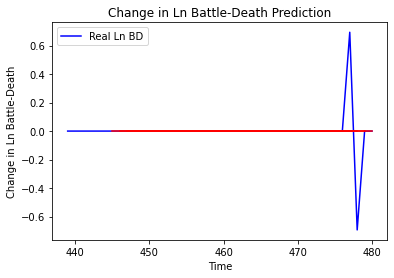

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Africa', 'country_id': 163, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Swaziland']
Building vanilla Model...
Model: "sequential_634"
_______________________________________________________

25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
25/25 [=====================

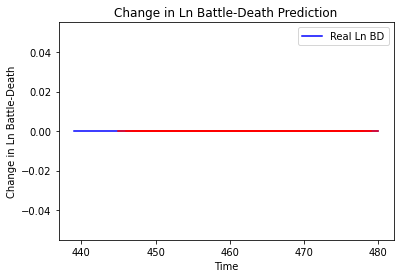

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Swaziland', 'country_id': 164, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Angola']
Building vanilla Model...
Model: "sequential_635"
_________________________________________________________________
Layer (type) 

Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 3.2584 - val_loss: 0.0864
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 3.2994 - val_loss: 0.0854
Epoch 66/100
25/25 [==============================] - 0s 5ms/step - loss: 3.2752 - val_loss: 0.0854
Epoch 67/100
25/25 [==============================] - 0s 4ms/step - loss: 3.2775 - val_loss: 0.0853
Epoch 68/100
25/25 [==============================] - 0s 5ms/step - loss: 3.3014 - val_loss: 0.0852
Epoch 69/100
25/25 [==============================] - 0s 4ms/step - loss: 3.2688 - val_loss: 0.0855
Epoch 70/100
25/25 [==============================] - 0s 4ms/step - loss: 3.2970 - val_loss: 0.0856
Epoch 71/100
25/25 [==============================] - 0s 4ms/step - loss: 3.2782 - val_loss: 0.0851
Epoch 72/100
25/25 [==============================] - 0s 5ms/step - loss: 3.2747 - val_loss: 0.0857
Epoch 73/100
25/25 [==============================] - 0s 5ms/step - loss: 3.2565 - val_loss: 0.0855


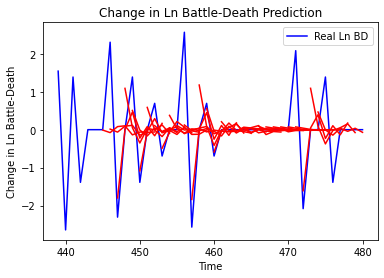

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Angola', 'country_id': 165, 'step': 't+1', 'mse': 0.7358449934782101, 'mae': 0.547490570750042, 'r2': 0.4217376171428655, 'tadda_score': 0.547490570750042}
{'country': 'Angola', 'country_id': 165, 'step': 't+2', 'mse': 2.3655299911489767, 'mae': 1.066197208495144, 'r2': -0.8589472260129332, 'tadda_score': 1.2257670067809066}
{'country': 'Angola', 'country_id': 165, 'step': 't+3', 'mse': 1.2389945809103484, 'mae': 0.8161091833735316, 'r2': -0.412570880931157, 'tadda_score': 0.8549518644238321}
{'country': 'Angola', 'country_id': 165, 'step': 't+4', 'mse': 1.0944131708357092, 'mae': 0.7948600507010349, 'r2': -0.019599637857651064, 'tadda_score': 0.8067219298312395}
{'country': 'Angola', 'country_id': 165, 'step': 't+5', 'mse': 1.2661333766474243, 'mae': 0.7897734649514867, 'r2': -0.29316415329925594, 'tadda_score': 0.8186489107743614}
{'country': 'Angola', 'country_id': 165, 'step': 't+6', 'mse': 1.548272993307657

Epoch 60/100
25/25 [==============================] - 0s 5ms/step - loss: 1.8855 - val_loss: 0.2218
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 1.8976 - val_loss: 0.2213
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 1.8785 - val_loss: 0.2212
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 1.8783 - val_loss: 0.2218
Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 1.8876 - val_loss: 0.2218
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 1.8768 - val_loss: 0.2218
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 1.8804 - val_loss: 0.2224
Epoch 67/100
25/25 [==============================] - 0s 4ms/step - loss: 1.8847 - val_loss: 0.2212
Epoch 68/100
25/25 [==============================] - 0s 4ms/step - loss: 1.8711 - val_loss: 0.2210
Epoch 69/100
25/25 [==============================] - 0s 4ms/step - loss: 1.8735 - val_loss: 0.2213


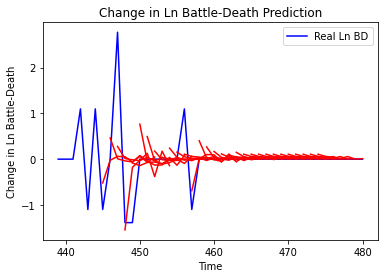

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo', 'country_id': 166, 'step': 't+1', 'mse': 0.3672150265256195, 'mae': 0.35502331256647607, 'r2': 0.27098833028810865, 'tadda_score': 0.35502331256647607}
{'country': 'Congo', 'country_id': 166, 'step': 't+2', 'mse': 1.135724461135238, 'mae': 0.6501846127078139, 'r2': -0.49445715421592085, 'tadda_score': 0.7617892655099633}
{'country': 'Congo', 'country_id': 166, 'step': 't+3', 'mse': 1.0278725990533164, 'mae': 0.6025223606845158, 'r2': -0.7330520805163223, 'tadda_score': 0.7024005307774165}
{'country': 'Congo', 'country_id': 166, 'step': 't+4', 'mse': 0.933279798399918, 'mae': 0.6221112856289167, 'r2': -0.3435581177466229, 'tadda_score': 0.7087041305025835}
{'country': 'Congo', 'country_id': 166, 'step': 't+5', 'mse': 0.9308363988321446, 'mae': 0.615886187456093, 'r2': -0.5694434885239044, 'tadda_score': 0.6888568961640614}
{'country': 'Congo', 'country_id': 166, 'step': 't+6', 'mse': 0.8993351807110233, '

Epoch 60/100
25/25 [==============================] - 0s 5ms/step - loss: 2.9405 - val_loss: 3.3120
Epoch 61/100
25/25 [==============================] - 0s 5ms/step - loss: 2.9473 - val_loss: 3.3131
Epoch 62/100
25/25 [==============================] - 0s 5ms/step - loss: 2.9493 - val_loss: 3.3157
Epoch 63/100
25/25 [==============================] - 0s 5ms/step - loss: 2.9230 - val_loss: 3.3108
Epoch 64/100
25/25 [==============================] - 0s 6ms/step - loss: 2.9502 - val_loss: 3.3136
Epoch 65/100
25/25 [==============================] - 0s 5ms/step - loss: 2.9595 - val_loss: 3.3138
Epoch 66/100
25/25 [==============================] - 0s 5ms/step - loss: 2.9437 - val_loss: 3.3192
Epoch 67/100
25/25 [==============================] - 0s 5ms/step - loss: 2.9274 - val_loss: 3.3145
Epoch 68/100
25/25 [==============================] - 0s 4ms/step - loss: 2.9143 - val_loss: 3.3168
Epoch 69/100
25/25 [==============================] - 0s 4ms/step - loss: 2.9375 - val_loss: 3.3169


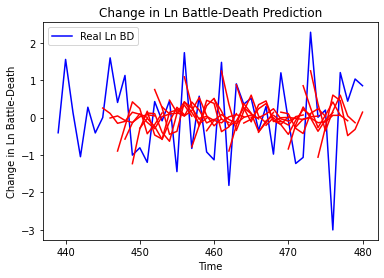

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+1', 'mse': 0.9011479173946125, 'mae': 0.7740936313115753, 'r2': 0.17664340942931755, 'tadda_score': 0.9370536936117407}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+2', 'mse': 2.851383715742515, 'mae': 1.3631330368366454, 'r2': -1.0166454490213725, 'tadda_score': 1.7697791239193694}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+3', 'mse': 2.5686534780450363, 'mae': 1.29860731376896, 'r2': -0.48912981780967435, 'tadda_score': 1.6556096721558737}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+4', 'mse': 3.134272837309541, 'mae': 1.4771660175316608, 'r2': -0.7990537317276825, 'tadda_score': 1.945934189994442}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+5', 'mse': 3.882119778535994, 'mae': 1.556847673874292, 'r2': -1.1147576075039671, 'tadda_score': 2.0994832810970077}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+6', 'mse

25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
25/25 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
25/25 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
25/25 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
25/25 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
25/25 [=====================

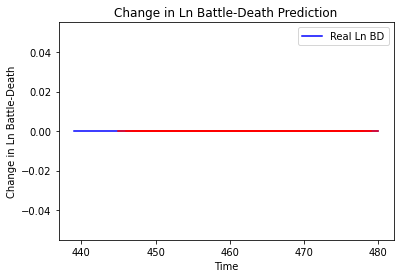

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Gabon', 'country_id': 169, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Namibia']
Building vanilla Model...
Model: "sequential_639"
_________________________________________________________________
Layer (type)                 Output Shap

Epoch 62/100
25/25 [==============================] - 0s 5ms/step - loss: 0.1380 - val_loss: 4.0029e-05
Epoch 63/100
25/25 [==============================] - 0s 6ms/step - loss: 0.1395 - val_loss: 2.7455e-05
Epoch 64/100
25/25 [==============================] - 0s 6ms/step - loss: 0.1383 - val_loss: 5.6396e-05
Epoch 65/100
25/25 [==============================] - 0s 6ms/step - loss: 0.1389 - val_loss: 1.6529e-05
Epoch 66/100
25/25 [==============================] - 0s 7ms/step - loss: 0.1391 - val_loss: 1.3602e-05
Epoch 67/100
25/25 [==============================] - 0s 7ms/step - loss: 0.1420 - val_loss: 1.1254e-04
Epoch 68/100
25/25 [==============================] - 0s 6ms/step - loss: 0.1404 - val_loss: 3.4019e-05
Epoch 69/100
25/25 [==============================] - 0s 6ms/step - loss: 0.1389 - val_loss: 1.4038e-04
Epoch 70/100
25/25 [==============================] - 0s 6ms/step - loss: 0.1400 - val_loss: 1.0157e-04
Epoch 71/100
25/25 [==============================] - 0s 6ms/ste

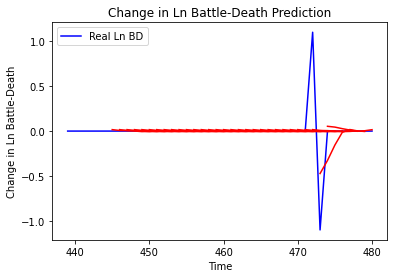

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Namibia', 'country_id': 170, 'step': 't+1', 'mse': 0.052474537076368954, 'mae': 0.07330530699983927, 'r2': 0.3478447873921655, 'tadda_score': 0.07330530699983927}
{'country': 'Namibia', 'country_id': 170, 'step': 't+2', 'mse': 0.10798906604935819, 'mae': 0.12288602383827858, 'r2': -0.34209154101248274, 'tadda_score': 0.1261346190362741}
{'country': 'Namibia', 'country_id': 170, 'step': 't+3', 'mse': 0.06972419585373114, 'mae': 0.09673662765272306, 'r2': -0.792830040322906, 'tadda_score': 0.09673662765272306}
{'country': 'Namibia', 'country_id': 170, 'step': 't+4', 'mse': 0.07064225604374137, 'mae': 0.09803270879832751, 'r2': -0.816436277258614, 'tadda_score': 0.09803270879832751}
{'country': 'Namibia', 'country_id': 170, 'step': 't+5', 'mse': 0.052484002341349215, 'mae': 0.07409270016797231, 'r2': -0.34953002873411143, 'tadda_score': 0.07409270016797231}
{'country': 'Namibia', 'country_id': 170, 'step': 't+6', '

25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
25/25 [=====================

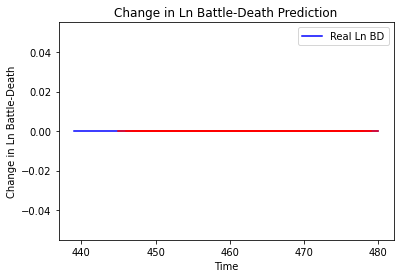

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Madagascar', 'country_id': 172, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mauritius']
Building vanilla Model...
Model: "sequential_641"
_________________________________________________________________
Lay

25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
25/25 [=====================

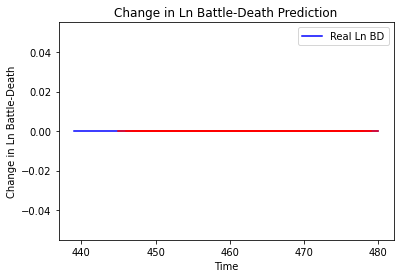

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritius', 'country_id': 173, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Seychelles']
Building vanilla Model...
Model: "sequential_642"
_________________________________________________________________
Layer (ty

25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
25/25 [=====================

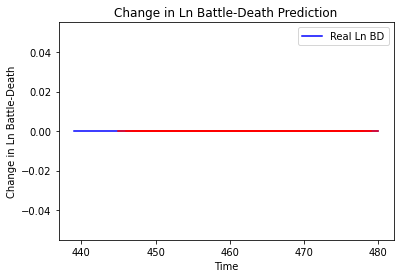

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Seychelles', 'country_id': 174, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Libya']
Building vanilla Model...
Model: "sequential_643"
_________________________________________________________________
Layer (

Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3002
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3003
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0315 - val_loss: 2.3004
Epoch 67/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.3004
Epoch 68/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0315 - val_loss: 2.3006
Epoch 69/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3006
Epoch 70/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3007
Epoch 71/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3008
Epoch 72/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3006
Epoch 73/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3006


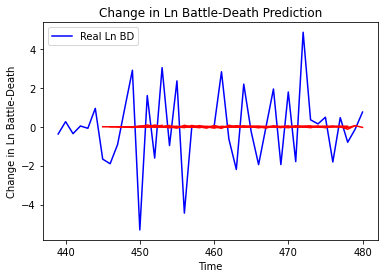

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Libya', 'country_id': 213, 'step': 't+1', 'mse': 4.843963323078138, 'mae': 1.6890871518524284, 'r2': 0.000345148930907313, 'tadda_score': 1.6904704890407851}
{'country': 'Libya', 'country_id': 213, 'step': 't+2', 'mse': 5.424865993861701, 'mae': 1.784788766870343, 'r2': -0.001409764268009539, 'tadda_score': 1.7865728641940806}
{'country': 'Libya', 'country_id': 213, 'step': 't+3', 'mse': 7.420283512021771, 'mae': 2.1089035523664035, 'r2': 0.00030404677878714814, 'tadda_score': 2.1114705561734564}
{'country': 'Libya', 'country_id': 213, 'step': 't+4', 'mse': 5.825124437304614, 'mae': 1.976394985616134, 'r2': -0.006616461816507879, 'tadda_score': 1.9793002411179133}
{'country': 'Libya', 'country_id': 213, 'step': 't+5', 'mse': 7.418639198048596, 'mae': 2.28366539572855, 'r2': -0.019578894626522736, 'tadda_score': 2.302262544739298}
{'country': 'Libya', 'country_id': 213, 'step': 't+6', 'mse': 6.303903792838909, 'm

Epoch 60/100
25/25 [==============================] - 0s 5ms/step - loss: 4.9066 - val_loss: 0.8591
Epoch 61/100
25/25 [==============================] - 0s 5ms/step - loss: 4.9512 - val_loss: 0.8551
Epoch 62/100
25/25 [==============================] - 0s 5ms/step - loss: 4.9764 - val_loss: 0.8535
Epoch 63/100
25/25 [==============================] - 0s 5ms/step - loss: 4.9460 - val_loss: 0.8552
Epoch 64/100
25/25 [==============================] - 0s 9ms/step - loss: 4.9623 - val_loss: 0.8549
Epoch 65/100
25/25 [==============================] - 0s 7ms/step - loss: 4.9646 - val_loss: 0.8574
Epoch 66/100
25/25 [==============================] - 0s 9ms/step - loss: 4.9537 - val_loss: 0.8629
Epoch 67/100
25/25 [==============================] - 0s 8ms/step - loss: 4.9779 - val_loss: 0.8652
Epoch 68/100
25/25 [==============================] - 0s 10ms/step - loss: 4.9170 - val_loss: 0.8614
Epoch 69/100
25/25 [==============================] - 0s 8ms/step - loss: 4.9484 - val_loss: 0.8554

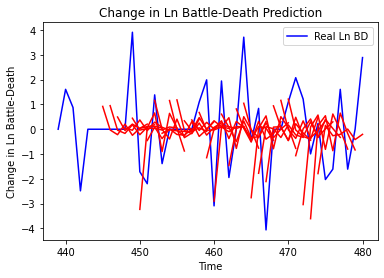

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Chad', 'country_id': 214, 'step': 't+1', 'mse': 3.3589841696673566, 'mae': 1.4601306194298778, 'r2': -0.14428825488341301, 'tadda_score': 1.7540789439512603}
{'country': 'Chad', 'country_id': 214, 'step': 't+2', 'mse': 8.256885483407299, 'mae': 2.2239670718128233, 'r2': -0.9451990981596619, 'tadda_score': 2.9241453731472045}
{'country': 'Chad', 'country_id': 214, 'step': 't+3', 'mse': 9.329746006700349, 'mae': 2.3890883285323814, 'r2': -0.7863896067756901, 'tadda_score': 2.9901944178859434}
{'country': 'Chad', 'country_id': 214, 'step': 't+4', 'mse': 13.533851269442824, 'mae': 3.0674422410893616, 'r2': -1.2194165855381702, 'tadda_score': 3.9468144881495015}
{'country': 'Chad', 'country_id': 214, 'step': 't+5', 'mse': 11.307010385619218, 'mae': 2.697405003216949, 'r2': -1.3799921262966413, 'tadda_score': 3.443635159439928}
{'country': 'Chad', 'country_id': 214, 'step': 't+6', 'mse': 9.50059155803462, 'mae': 2.405

25/25 [==============================] - 0s 4ms/step - loss: 0.5700 - val_loss: 2.1245
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 0.5761 - val_loss: 2.1269
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 0.5762 - val_loss: 2.1245
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 0.5754 - val_loss: 2.1227
Epoch 64/100
25/25 [==============================] - 0s 5ms/step - loss: 0.5775 - val_loss: 2.1230
Epoch 65/100
25/25 [==============================] - 0s 7ms/step - loss: 0.5733 - val_loss: 2.1224
Epoch 66/100
25/25 [==============================] - 0s 6ms/step - loss: 0.5716 - val_loss: 2.1192
Epoch 67/100
25/25 [==============================] - 0s 6ms/step - loss: 0.5655 - val_loss: 2.1200
Epoch 68/100
25/25 [==============================] - 0s 6ms/step - loss: 0.5763 - val_loss: 2.1173
Epoch 69/100
25/25 [==============================] - 0s 4ms/step - loss: 0.5657 - val_loss: 2.1173
Epoch 70/100


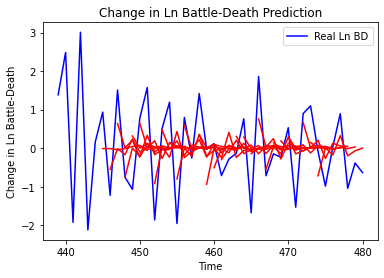

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Egypt', 'country_id': 222, 'step': 't+1', 'mse': 0.6824092529883188, 'mae': 0.6844287778493879, 'r2': 0.39451449007759554, 'tadda_score': 0.7358051050386945}
{'country': 'Egypt', 'country_id': 222, 'step': 't+2', 'mse': 1.5396221860852124, 'mae': 1.0509959290962625, 'r2': -0.42365740405034735, 'tadda_score': 1.2778773243145356}
{'country': 'Egypt', 'country_id': 222, 'step': 't+3', 'mse': 1.4111549084142998, 'mae': 0.9650228729630332, 'r2': -0.5215856307064275, 'tadda_score': 1.1946277514879722}
{'country': 'Egypt', 'country_id': 222, 'step': 't+4', 'mse': 1.2955328137044286, 'mae': 0.9491194311043937, 'r2': -0.05175977516936037, 'tadda_score': 1.1109172407052237}
{'country': 'Egypt', 'country_id': 222, 'step': 't+5', 'mse': 1.62327983748136, 'mae': 1.0875757834890487, 'r2': -0.36828801388266474, 'tadda_score': 1.3627179494454464}
{'country': 'Egypt', 'country_id': 222, 'step': 't+6', 'mse': 1.3734676663660828, 

25/25 [==============================] - 0s 4ms/step - loss: 2.6557 - val_loss: 9.9921e-04
Epoch 59/100
25/25 [==============================] - 0s 4ms/step - loss: 2.6546 - val_loss: 0.0015
Epoch 60/100
25/25 [==============================] - 0s 4ms/step - loss: 2.6433 - val_loss: 7.7605e-04
Epoch 61/100
25/25 [==============================] - 0s 4ms/step - loss: 2.6586 - val_loss: 0.0013
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 2.6279 - val_loss: 0.0014
Epoch 63/100
25/25 [==============================] - 0s 5ms/step - loss: 2.6554 - val_loss: 0.0010
Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 2.6563 - val_loss: 0.0024
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 2.6570 - val_loss: 0.0021
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 2.6482 - val_loss: 0.0016
Epoch 67/100
25/25 [==============================] - 0s 5ms/step - loss: 2.6373 - val_loss: 0.0017
Epoch

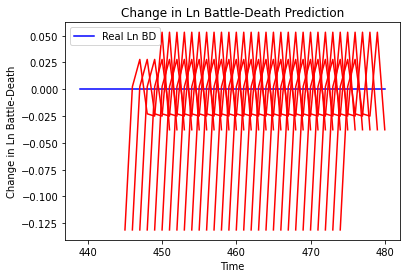

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Uganda', 'country_id': 235, 'step': 't+1', 'mse': 0.017213983672200506, 'mae': 0.1312020719051361, 'r2': 0.0, 'tadda_score': 0.1312020719051361}
{'country': 'Uganda', 'country_id': 235, 'step': 't+2', 'mse': 0.016590807764168325, 'mae': 0.12880530953407288, 'r2': 0.0, 'tadda_score': 0.12880530953407288}
{'country': 'Uganda', 'country_id': 235, 'step': 't+3', 'mse': 0.010196355250858602, 'mae': 0.10097700357437134, 'r2': 0.0, 'tadda_score': 0.10097700357437134}
{'country': 'Uganda', 'country_id': 235, 'step': 't+4', 'mse': 0.015344422999441498, 'mae': 0.12387260794639587, 'r2': 0.0, 'tadda_score': 0.12387260794639587}
{'country': 'Uganda', 'country_id': 235, 'step': 't+5', 'mse': 0.022887022772820842, 'mae': 0.1512845754623413, 'r2': 0.0, 'tadda_score': 0.1512845754623413}
{'country': 'Uganda', 'country_id': 235, 'step': 't+6', 'mse': 0.009622055994441325, 'mae': 0.09809207916259766, 'r2': 0.0, 'tadda_score': 0.0

25/25 [==============================] - 0s 6ms/step - loss: 0.1152 - val_loss: 1.6498
Epoch 61/100
25/25 [==============================] - 0s 5ms/step - loss: 0.1179 - val_loss: 1.6499
Epoch 62/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1139 - val_loss: 1.6505
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1153 - val_loss: 1.6518
Epoch 64/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1151 - val_loss: 1.6510
Epoch 65/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1145 - val_loss: 1.6532
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1142 - val_loss: 1.6535
Epoch 67/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1170 - val_loss: 1.6518
Epoch 68/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1157 - val_loss: 1.6519
Epoch 69/100
25/25 [==============================] - 0s 4ms/step - loss: 0.1139 - val_loss: 1.6516
Epoch 70/100


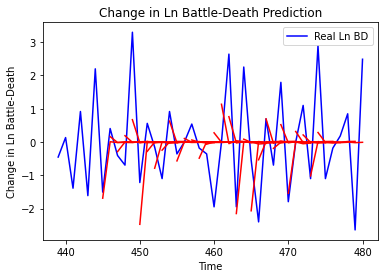

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Kenya', 'country_id': 237, 'step': 't+1', 'mse': 1.3865588779802374, 'mae': 0.8735377758361226, 'r2': 0.33085280560879193, 'tadda_score': 0.8984047819790567}
{'country': 'Kenya', 'country_id': 237, 'step': 't+2', 'mse': 3.4472970523447013, 'mae': 1.511831366364904, 'r2': -0.8059071041966375, 'tadda_score': 1.9613740040309702}
{'country': 'Kenya', 'country_id': 237, 'step': 't+3', 'mse': 3.178491549977814, 'mae': 1.3720113633081754, 'r2': -0.4556319980376269, 'tadda_score': 1.6555353505418142}
{'country': 'Kenya', 'country_id': 237, 'step': 't+4', 'mse': 3.9617055739003377, 'mae': 1.6356712517163414, 'r2': -0.4107083692688809, 'tadda_score': 1.9225845197360971}
{'country': 'Kenya', 'country_id': 237, 'step': 't+5', 'mse': 2.8159271800069336, 'mae': 1.235428607168865, 'r2': -0.8591548568390064, 'tadda_score': 1.5689604135384876}
{'country': 'Kenya', 'country_id': 237, 'step': 't+6', 'mse': 2.6251551193769256, 'mae

19/19 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
19/19 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
19/19 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
19/19 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
19/19 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
19/19 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
19/19 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
19/19 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
19/19 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
19/19 [=====================

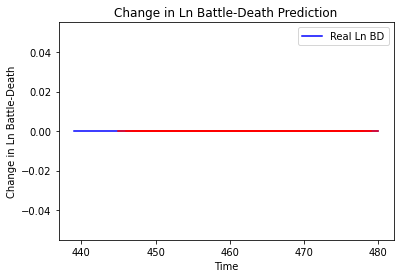

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tanzania', 'country_id': 242, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Morocco']
Building vanilla Model...
Model: "sequential_649"
_________________________________________________________________
Layer (type)       

25/25 [==============================] - 0s 6ms/step - loss: 0.0690 - val_loss: 2.3530e-05
Epoch 62/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0690 - val_loss: 1.5224e-05
Epoch 63/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0692 - val_loss: 1.8291e-05
Epoch 64/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0690 - val_loss: 3.3549e-06
Epoch 65/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0708 - val_loss: 3.3634e-05
Epoch 66/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0691 - val_loss: 1.0500e-05
Epoch 67/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0697 - val_loss: 3.8733e-05
Epoch 68/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0696 - val_loss: 2.1376e-06
Epoch 69/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0688 - val_loss: 2.2551e-05
Epoch 70/100
25/25 [==============================] - 0s 4ms/step - loss: 0.0

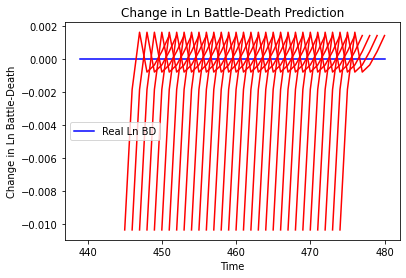

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Morocco', 'country_id': 243, 'step': 't+1', 'mse': 0.00010745249345701924, 'mae': 0.010365929454565048, 'r2': 0.0, 'tadda_score': 0.010365929454565048}
{'country': 'Morocco', 'country_id': 243, 'step': 't+2', 'mse': 0.00014922821854849392, 'mae': 0.012215900234878063, 'r2': 0.0, 'tadda_score': 0.012215900234878063}
{'country': 'Morocco', 'country_id': 243, 'step': 't+3', 'mse': 0.00011224525061368298, 'mae': 0.010594585910439491, 'r2': 0.0, 'tadda_score': 0.010594585910439491}
{'country': 'Morocco', 'country_id': 243, 'step': 't+4', 'mse': 0.00012970962576554224, 'mae': 0.01138901337981224, 'r2': 0.0, 'tadda_score': 0.01138901337981224}
{'country': 'Morocco', 'country_id': 243, 'step': 't+5', 'mse': 9.805726683448455e-05, 'mae': 0.00990238692611456, 'r2': 0.0, 'tadda_score': 0.00990238692611456}
{'country': 'Morocco', 'country_id': 243, 'step': 't+6', 'mse': 8.927165979678853e-05, 'mae': 0.009448368102312088, 'r

25/25 [==============================] - 0s 5ms/step - loss: 0.0626 - val_loss: 0.1141
Epoch 61/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0634 - val_loss: 0.1143
Epoch 62/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0627 - val_loss: 0.1145
Epoch 63/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0635 - val_loss: 0.1141
Epoch 64/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0633 - val_loss: 0.1140
Epoch 65/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0630 - val_loss: 0.1139
Epoch 66/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0636 - val_loss: 0.1140
Epoch 67/100
25/25 [==============================] - 0s 5ms/step - loss: 0.0635 - val_loss: 0.1138
Epoch 68/100
25/25 [==============================] - 0s 6ms/step - loss: 0.0633 - val_loss: 0.1136
Epoch 69/100
25/25 [==============================] - 0s 7ms/step - loss: 0.0632 - val_loss: 0.1135
Epoch 70/100


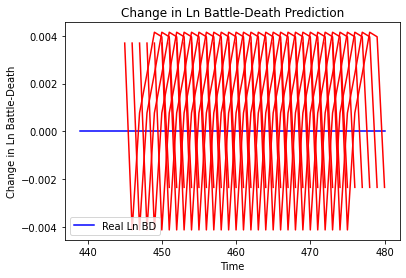

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritania', 'country_id': 244, 'step': 't+1', 'mse': 1.3638575357077798e-05, 'mae': 0.0036930441856384277, 'r2': 0.0, 'tadda_score': 0.0036930441856384277}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+2', 'mse': 1.7727291110394838e-07, 'mae': 0.0004210378974676132, 'r2': 0.0, 'tadda_score': 0.0004210378974676132}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+3', 'mse': 1.244227540062818e-07, 'mae': 0.00035273609682917595, 'r2': 0.0, 'tadda_score': 0.00035273609682917595}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+4', 'mse': 7.638598660442803e-06, 'mae': 0.0027638014871627092, 'r2': 0.0, 'tadda_score': 0.0027638014871627092}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+5', 'mse': 0.00012153572458262554, 'mae': 0.011024324223399162, 'r2': 0.0, 'tadda_score': 0.011024324223399162}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+6', 'mse': 0.00022446291907938457,

4/4 [==============================] - 0s 8ms/step - loss: 3.2053 - val_loss: 0.9271
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 3.1344 - val_loss: 0.9274
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 3.1333 - val_loss: 0.9277
Epoch 64/100
4/4 [==============================] - 0s 8ms/step - loss: 3.1569 - val_loss: 0.9278
Epoch 65/100
4/4 [==============================] - 0s 8ms/step - loss: 3.1207 - val_loss: 0.9282
Epoch 66/100
4/4 [==============================] - 0s 8ms/step - loss: 3.1447 - val_loss: 0.9285
Epoch 67/100
4/4 [==============================] - 0s 8ms/step - loss: 3.1456 - val_loss: 0.9289
Epoch 68/100
4/4 [==============================] - 0s 8ms/step - loss: 3.1375 - val_loss: 0.9292
Epoch 69/100
4/4 [==============================] - 0s 8ms/step - loss: 3.1914 - val_loss: 0.9296
Epoch 70/100
4/4 [==============================] - 0s 8ms/step - loss: 3.1466 - val_loss: 0.9301
Epoch 71/100
4/4 [===============

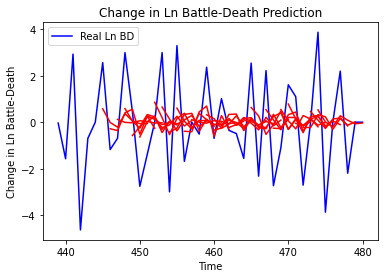

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sudan', 'country_id': 245, 'step': 't+1', 'mse': 2.989442854660387, 'mae': 1.5065174595607844, 'r2': 0.2528903851779515, 'tadda_score': 1.5697288614852754}
{'country': 'Sudan', 'country_id': 245, 'step': 't+2', 'mse': 4.79067318409353, 'mae': 1.7957239415222075, 'r2': -0.1227915947487983, 'tadda_score': 2.0535346014771525}
{'country': 'Sudan', 'country_id': 245, 'step': 't+3', 'mse': 4.060794565005432, 'mae': 1.6786418100091784, 'r2': -0.04712171032585877, 'tadda_score': 1.790875924616354}
{'country': 'Sudan', 'country_id': 245, 'step': 't+4', 'mse': 3.6249622381321007, 'mae': 1.5026490413818085, 'r2': -0.0918262314960987, 'tadda_score': 1.6430949358814284}
{'country': 'Sudan', 'country_id': 245, 'step': 't+5', 'mse': 5.3332137105472395, 'mae': 1.9824513939488233, 'r2': -0.01724533762682956, 'tadda_score': 2.156113600479394}
{'country': 'Sudan', 'country_id': 245, 'step': 't+6', 'mse': 5.258800131461949, 'mae': 

Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 6.4031 - val_loss: 4.0824
Epoch 62/100
4/4 [==============================] - 0s 8ms/step - loss: 6.3487 - val_loss: 4.0794
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 6.3556 - val_loss: 4.0763
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 6.3218 - val_loss: 4.0734
Epoch 65/100
4/4 [==============================] - 0s 8ms/step - loss: 6.3097 - val_loss: 4.0705
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 6.3068 - val_loss: 4.0678
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 6.2705 - val_loss: 4.0655
Epoch 68/100
4/4 [==============================] - 0s 9ms/step - loss: 6.3318 - val_loss: 4.0632
Epoch 69/100
4/4 [==============================] - 0s 8ms/step - loss: 6.3285 - val_loss: 4.0603
Epoch 70/100
4/4 [==============================] - 0s 8ms/step - loss: 6.3927 - val_loss: 4.0572
Epoch 71/100
4/4 [==

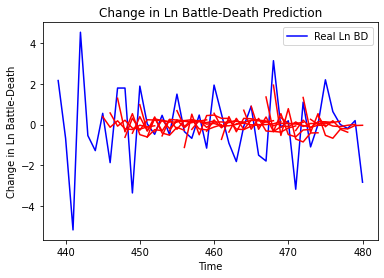

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Sudan', 'country_id': 246, 'step': 't+1', 'mse': 1.904713926555959, 'mae': 1.0589664452749008, 'r2': 0.14379557992926573, 'tadda_score': 1.2560482666867492}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+2', 'mse': 3.480028812047647, 'mae': 1.4165045183355516, 'r2': -0.2877604163479568, 'tadda_score': 1.6499411311204144}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+3', 'mse': 4.2088221743651495, 'mae': 1.7222556629643022, 'r2': -0.6097534679841916, 'tadda_score': 2.1385043567781827}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+4', 'mse': 4.200034871683296, 'mae': 1.7031812366656722, 'r2': -0.3324109667791597, 'tadda_score': 1.9706071824393931}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+5', 'mse': 3.230740908885079, 'mae': 1.3503191119080609, 'r2': -0.2808290742800008, 'tadda_score': 1.5344656903006957}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+

In [40]:
np.random.seed(1)
tf.random.set_seed(1)
model = Sequential()
summary_model(dataset=df,
              modelname = "Vanilla",
              pred_africa=True,
              period=period_test, 
              epochs=100, 
              batch_size=10, 
              look_back=6, 
              look_forward=7,
              num_neurons=6, 
              val_split=0.2)

['Cape Verde']
Building vanilla Model...
Model: "sequential_654"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_640 (LSTM)              (None, 6)                 192       
_________________________________________________________________
dropout_1280 (Dropout)       (None, 6)                 0         
_________________________________________________________________
dense_1280 (Dense)           (None, 6)                 42        
_________________________________________________________________
dropout_1281 (Dropout)       (None, 6)                 0         
_________________________________________________________________
dense_1281 (Dense)           (None, 7)                 49        
Total params: 283
Trainable params: 283
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
21/21 [==============================] - 0s 22ms/step - loss: 0.000

21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 70/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 71/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 72/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 73/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 74/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 75/100
21/21 [=====================

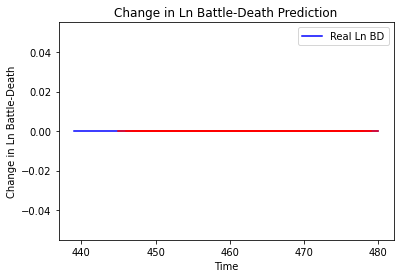

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
["Cote d'Ivoire"]
Building vanilla Model...
Model: "sequential_655"
_________________________________________________________________
Layer 

Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5463 - val_loss: 0.2824
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5487 - val_loss: 0.2824
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5450 - val_loss: 0.2822
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5440 - val_loss: 0.2824
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5474 - val_loss: 0.2826
Epoch 69/100
21/21 [==============================] - 0s 6ms/step - loss: 0.5475 - val_loss: 0.2826
Epoch 70/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5489 - val_loss: 0.2831
Epoch 71/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5460 - val_loss: 0.2832
Epoch 72/100
21/21 [==============================] - 0s 6ms/step - loss: 0.5418 - val_loss: 0.2832
Epoch 73/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5433 - val_loss: 0.2832


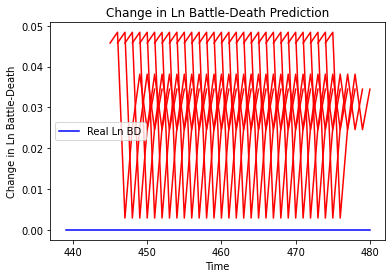

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+1', 'mse': 0.0020961525115694712, 'mae': 0.04578375816345215, 'r2': 0.0, 'tadda_score': 0.04578375816345215}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+2', 'mse': 0.008874725116508275, 'mae': 0.09420575946569443, 'r2': 0.0, 'tadda_score': 0.09420575946569443}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+3', 'mse': 0.0094318490388281, 'mae': 0.09711770713329315, 'r2': 0.0, 'tadda_score': 0.09711770713329315}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+4', 'mse': 0.01492492484320046, 'mae': 0.12216760963201523, 'r2': 0.0, 'tadda_score': 0.12216760963201523}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+5', 'mse': 0.012520566599185878, 'mae': 0.11189533770084381, 'r2': 0.0, 'tadda_score': 0.11189533770084381}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+6', 'mse': 0.01862393209411395, 'mae': 0.13646952807

Epoch 56/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
21/21 [========

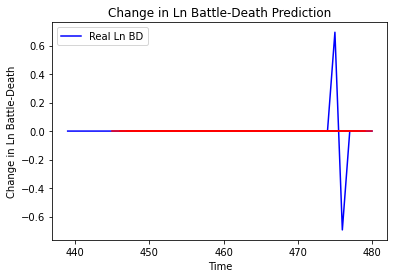

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ghana', 'country_id': 42, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Liberia']
Building vanilla Model...
Model: "sequential_657"
_________________________________________________________________
Layer (type)                 Output Shape      

Epoch 62/100
21/21 [==============================] - 0s 4ms/step - loss: 1.1978 - val_loss: 3.1682e-04
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 1.2015 - val_loss: 6.4055e-04
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 1.1983 - val_loss: 4.7849e-04
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 1.1914 - val_loss: 3.1949e-04
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 1.1872 - val_loss: 6.6494e-04
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 1.1934 - val_loss: 3.8376e-04
Epoch 68/100
21/21 [==============================] - 0s 4ms/step - loss: 1.1873 - val_loss: 4.6479e-04
Epoch 69/100
21/21 [==============================] - 0s 4ms/step - loss: 1.1859 - val_loss: 4.7153e-04
Epoch 70/100
21/21 [==============================] - 0s 4ms/step - loss: 1.1838 - val_loss: 3.4480e-04
Epoch 71/100
21/21 [==============================] - 0s 4ms/ste

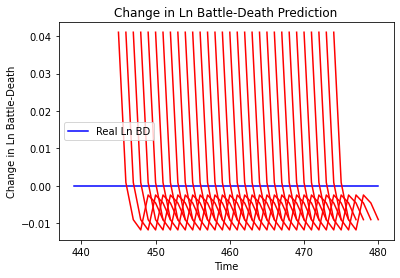

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Liberia', 'country_id': 43, 'step': 't+1', 'mse': 0.00168414488783597, 'mae': 0.041038334369659424, 'r2': 0.0, 'tadda_score': 0.041038334369659424}
{'country': 'Liberia', 'country_id': 43, 'step': 't+2', 'mse': 0.0017562882418654113, 'mae': 0.04190809279680252, 'r2': 0.0, 'tadda_score': 0.04190809279680252}
{'country': 'Liberia', 'country_id': 43, 'step': 't+3', 'mse': 0.0010784694230727698, 'mae': 0.0328400582075119, 'r2': 0.0, 'tadda_score': 0.0328400582075119}
{'country': 'Liberia', 'country_id': 43, 'step': 't+4', 'mse': 0.0004426314390549302, 'mae': 0.021038807928562164, 'r2': 0.0, 'tadda_score': 0.021038807928562164}
{'country': 'Liberia', 'country_id': 43, 'step': 't+5', 'mse': 0.0003132557039772256, 'mae': 0.01769903115928173, 'r2': 0.0, 'tadda_score': 0.01769903115928173}
{'country': 'Liberia', 'country_id': 43, 'step': 't+6', 'mse': 0.0001717788477955673, 'mae': 0.013106442987918854, 'r2': 0.0, 'tadda_

21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
21/21 [=====================

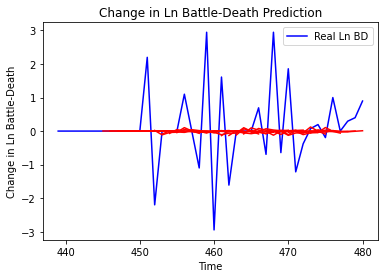

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+1', 'mse': 1.6742776543631133, 'mae': 0.8335248412330749, 'r2': -0.015278527382594831, 'tadda_score': 0.8465746639916477}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+2', 'mse': 1.2153790525381603, 'mae': 0.7374995573037526, 'r2': -0.027045985543387108, 'tadda_score': 0.749499747397866}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+3', 'mse': 2.079107497536221, 'mae': 0.9197378957385883, 'r2': -0.042883405759973625, 'tadda_score': 0.9401895886028871}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+4', 'mse': 2.449831263009633, 'mae': 1.0383192531516663, 'r2': -0.10361105329287468, 'tadda_score': 1.069929188651394}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+5', 'mse': 2.3406549435409576, 'mae': 0.950955364773219, 'r2': -0.12284161414109773, 'tadda_score': 0.968839185729171}
{'country': 'Burkina Faso', 'country_id': 47, 'step

21/21 [==============================] - 0s 4ms/step - loss: 0.2581 - val_loss: 4.0843e-05
Epoch 58/100
21/21 [==============================] - 0s 4ms/step - loss: 0.2581 - val_loss: 9.8390e-05
Epoch 59/100
21/21 [==============================] - 0s 4ms/step - loss: 0.2567 - val_loss: 8.1298e-06
Epoch 60/100
21/21 [==============================] - 0s 4ms/step - loss: 0.2617 - val_loss: 2.6357e-05
Epoch 61/100
21/21 [==============================] - 0s 4ms/step - loss: 0.2555 - val_loss: 4.0432e-06
Epoch 62/100
21/21 [==============================] - 0s 6ms/step - loss: 0.2581 - val_loss: 3.5862e-05
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.2535 - val_loss: 6.3345e-05
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.2584 - val_loss: 1.2194e-04
Epoch 65/100
21/21 [==============================] - 0s 4ms/step - loss: 0.2585 - val_loss: 5.2427e-05
Epoch 66/100
21/21 [==============================] - 0s 4ms/step - loss: 0.2

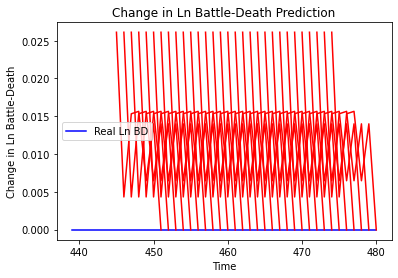

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea', 'country_id': 48, 'step': 't+1', 'mse': 0.0006822672227180249, 'mae': 0.026120245456695557, 'r2': 0.0, 'tadda_score': 0.026120245456695557}
{'country': 'Guinea', 'country_id': 48, 'step': 't+2', 'mse': 0.0009263547359040225, 'mae': 0.03043607622385025, 'r2': 0.0, 'tadda_score': 0.03043607622385025}
{'country': 'Guinea', 'country_id': 48, 'step': 't+3', 'mse': 0.002094188828170529, 'mae': 0.045762307941913605, 'r2': 0.0, 'tadda_score': 0.045762307941913605}
{'country': 'Guinea', 'country_id': 48, 'step': 't+4', 'mse': 0.003771029173747442, 'mae': 0.06140870600938797, 'r2': 0.0, 'tadda_score': 0.06140870600938797}
{'country': 'Guinea', 'country_id': 48, 'step': 't+5', 'mse': 0.0040392070538644576, 'mae': 0.06355475634336472, 'r2': 0.0, 'tadda_score': 0.06355475634336472}
{'country': 'Guinea', 'country_id': 48, 'step': 't+6', 'mse': 0.006013557831696659, 'mae': 0.07754713296890259, 'r2': 0.0, 'tadda_score'

21/21 [==============================] - 0s 5ms/step - loss: 0.6360 - val_loss: 1.9919e-04
Epoch 59/100
21/21 [==============================] - 0s 5ms/step - loss: 0.6252 - val_loss: 7.3255e-05
Epoch 60/100
21/21 [==============================] - 0s 5ms/step - loss: 0.6227 - val_loss: 1.6693e-04
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.6204 - val_loss: 3.6784e-04
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.6314 - val_loss: 8.1834e-04
Epoch 63/100
21/21 [==============================] - 0s 6ms/step - loss: 0.6014 - val_loss: 1.9011e-05
Epoch 64/100
21/21 [==============================] - 0s 6ms/step - loss: 0.5993 - val_loss: 1.0413e-04
Epoch 65/100
21/21 [==============================] - 0s 6ms/step - loss: 0.6206 - val_loss: 9.9099e-05
Epoch 66/100
21/21 [==============================] - 0s 6ms/step - loss: 0.6639 - val_loss: 5.2241e-04
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 0.6

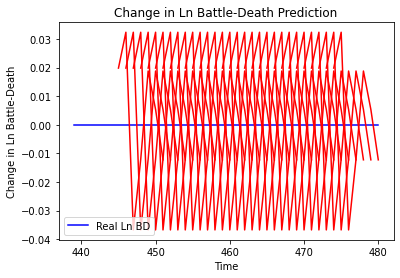

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+1', 'mse': 0.00039247936403641673, 'mae': 0.01981109194457531, 'r2': 0.0, 'tadda_score': 0.01981109194457531}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+2', 'mse': 0.0027197557617084644, 'mae': 0.05215127766132355, 'r2': 0.0, 'tadda_score': 0.05215127766132355}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+3', 'mse': 0.00023703529259901102, 'mae': 0.01539595052599907, 'r2': 0.0, 'tadda_score': 0.01539595052599907}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+4', 'mse': 1.1275400650490909e-05, 'mae': 0.0033578863367438316, 'r2': 0.0, 'tadda_score': 0.0033578863367438316}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+5', 'mse': 0.0001039991827034327, 'mae': 0.010197998955845833, 'r2': 0.0, 'tadda_score': 0.010197998955845833}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+6', 'mse': 2.3532701686383196e-05, '

21/21 [==============================] - 0s 6ms/step - loss: 1.2701 - val_loss: 3.0049
Epoch 61/100
21/21 [==============================] - 0s 6ms/step - loss: 1.2803 - val_loss: 3.0031
Epoch 62/100
21/21 [==============================] - 0s 7ms/step - loss: 1.2775 - val_loss: 3.0045
Epoch 63/100
21/21 [==============================] - 0s 7ms/step - loss: 1.2642 - val_loss: 3.0066
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 1.2739 - val_loss: 3.0060
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 1.2611 - val_loss: 3.0100
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 1.2687 - val_loss: 3.0095
Epoch 67/100
21/21 [==============================] - 0s 6ms/step - loss: 1.2809 - val_loss: 3.0104
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 1.2624 - val_loss: 3.0112
Epoch 69/100
21/21 [==============================] - 0s 6ms/step - loss: 1.2728 - val_loss: 3.0115
Epoch 70/100


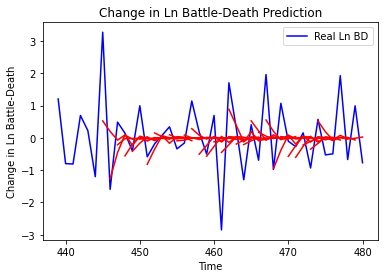

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mali', 'country_id': 50, 'step': 't+1', 'mse': 0.8137523277276502, 'mae': 0.6441636096404485, 'r2': 0.3554004230076665, 'tadda_score': 0.7197721113479626}
{'country': 'Mali', 'country_id': 50, 'step': 't+2', 'mse': 1.7473633778923263, 'mae': 1.0342086251301028, 'r2': -0.80479380121719, 'tadda_score': 1.3793526220542653}
{'country': 'Mali', 'country_id': 50, 'step': 't+3', 'mse': 1.558746085998646, 'mae': 1.0480519518883102, 'r2': -0.3730058309985007, 'tadda_score': 1.3650569858035515}
{'country': 'Mali', 'country_id': 50, 'step': 't+4', 'mse': 2.286471829521619, 'mae': 1.2576897025096456, 'r2': -0.5289662928910241, 'tadda_score': 1.6452853073664546}
{'country': 'Mali', 'country_id': 50, 'step': 't+5', 'mse': 1.8242316602941422, 'mae': 1.1065662868529589, 'r2': -0.6847651304272204, 'tadda_score': 1.3829069620827865}
{'country': 'Mali', 'country_id': 50, 'step': 't+6', 'mse': 2.04006748840039, 'mae': 1.17192958153

21/21 [==============================] - 0s 6ms/step - loss: 1.6261 - val_loss: 0.4297
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 1.6337 - val_loss: 0.4291
Epoch 62/100
21/21 [==============================] - 0s 6ms/step - loss: 1.6259 - val_loss: 0.4295
Epoch 63/100
21/21 [==============================] - 0s 6ms/step - loss: 1.6442 - val_loss: 0.4296
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 1.6381 - val_loss: 0.4307
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 1.6422 - val_loss: 0.4302
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 1.6429 - val_loss: 0.4299
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 1.6403 - val_loss: 0.4309
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 1.6258 - val_loss: 0.4291
Epoch 69/100
21/21 [==============================] - 0s 5ms/step - loss: 1.6385 - val_loss: 0.4292
Epoch 70/100


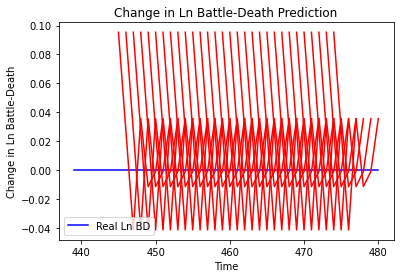

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Senegal', 'country_id': 52, 'step': 't+1', 'mse': 0.009092002766951879, 'mae': 0.09535199403762817, 'r2': 0.0, 'tadda_score': 0.09535199403762817}
{'country': 'Senegal', 'country_id': 52, 'step': 't+2', 'mse': 0.015065305248644023, 'mae': 0.12274080514907837, 'r2': 0.0, 'tadda_score': 0.12274080514907837}
{'country': 'Senegal', 'country_id': 52, 'step': 't+3', 'mse': 0.006597673758017786, 'mae': 0.08122606575489044, 'r2': 0.0, 'tadda_score': 0.08122606575489044}
{'country': 'Senegal', 'country_id': 52, 'step': 't+4', 'mse': 0.013619368467346682, 'mae': 0.11670204997062683, 'r2': 0.0, 'tadda_score': 0.11670204997062683}
{'country': 'Senegal', 'country_id': 52, 'step': 't+5', 'mse': 0.0060495118012662275, 'mae': 0.07777860760688782, 'r2': 0.0, 'tadda_score': 0.07777860760688782}
{'country': 'Senegal', 'country_id': 52, 'step': 't+6', 'mse': 0.005894035606080428, 'mae': 0.07677262276411057, 'r2': 0.0, 'tadda_score'

21/21 [==============================] - 0s 5ms/step - loss: 2.1409 - val_loss: 8.4035e-04
Epoch 59/100
21/21 [==============================] - 0s 5ms/step - loss: 2.1605 - val_loss: 0.0015
Epoch 60/100
21/21 [==============================] - 0s 5ms/step - loss: 2.1723 - val_loss: 0.0013
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 2.1667 - val_loss: 0.0012
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 2.1577 - val_loss: 0.0015
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 2.1499 - val_loss: 0.0011
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 2.1399 - val_loss: 0.0014
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 2.1463 - val_loss: 0.0013
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 2.1223 - val_loss: 8.3263e-04
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 2.1398 - val_loss: 9.4875e-04
E

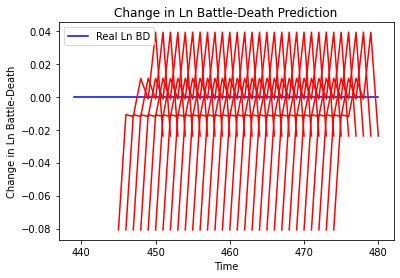

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+1', 'mse': 0.006538026946911524, 'mae': 0.08085806667804718, 'r2': 0.0, 'tadda_score': 0.08085806667804718}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+2', 'mse': 0.00841402085285381, 'mae': 0.09172797203063965, 'r2': 0.0, 'tadda_score': 0.09172797203063965}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+3', 'mse': 0.010757078392822417, 'mae': 0.10371633619070053, 'r2': 0.0, 'tadda_score': 0.10371633619070053}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+4', 'mse': 0.008565233954445972, 'mae': 0.09254854917526245, 'r2': 0.0, 'tadda_score': 0.09254854917526245}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+5', 'mse': 0.006894088595234271, 'mae': 0.08303064852952957, 'r2': 0.0, 'tadda_score': 0.08303064852952957}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+6', 'mse': 0.001922256439888026, 'mae': 0.043843545019626

Epoch 56/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
21/21 [========

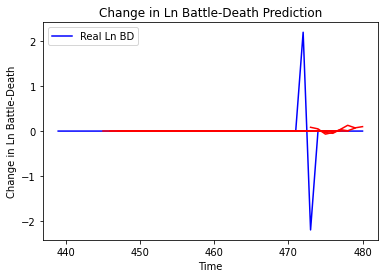

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'The Gambia', 'country_id': 54, 'step': 't+1', 'mse': 0.3344635006101058, 'mae': 0.14996411150983358, 'r2': -0.03918075081110084, 'tadda_score': 0.1527766746410865}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+2', 'mse': 0.3206260668255155, 'mae': 0.15051594397715115, 'r2': 0.00381226577617777, 'tadda_score': 0.15051594397715115}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+3', 'mse': 0.16120023594117155, 'mae': 0.07751101607477359, 'r2': -0.03624223256999781, 'tadda_score': 0.07751101607477359}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+4', 'mse': 0.16098918190446462, 'mae': 0.0752661927729417, 'r2': -0.03488551553473296, 'tadda_score': 0.0752661927729417}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+5', 'mse': 0.16154135505451395, 'mae': 0.07832870462929896, 'r2': -0.0384350459335665, 'tadda_score': 0.07832870462929896}
{'country': 'The Gambia', 'country_id': 54, 'step'

21/21 [==============================] - 0s 5ms/step - loss: 0.6224 - val_loss: 1.2318e-04
Epoch 58/100
21/21 [==============================] - 0s 5ms/step - loss: 0.6294 - val_loss: 1.7962e-04
Epoch 59/100
21/21 [==============================] - 0s 5ms/step - loss: 0.6270 - val_loss: 1.3957e-04
Epoch 60/100
21/21 [==============================] - 0s 6ms/step - loss: 0.6307 - val_loss: 1.7731e-04
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.6239 - val_loss: 3.4425e-04
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.6247 - val_loss: 3.7787e-04
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.6217 - val_loss: 3.2590e-04
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.6214 - val_loss: 2.1909e-04
Epoch 65/100
21/21 [==============================] - 0s 6ms/step - loss: 0.6184 - val_loss: 2.4464e-04
Epoch 66/100
21/21 [==============================] - 0s 6ms/step - loss: 0.6

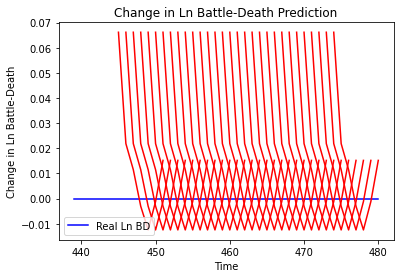

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Djibouti', 'country_id': 55, 'step': 't+1', 'mse': 0.0043776248553651365, 'mae': 0.06616362184286118, 'r2': 0.0, 'tadda_score': 0.06616362184286118}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+2', 'mse': 0.0077448614655689085, 'mae': 0.08800489455461502, 'r2': 0.0, 'tadda_score': 0.08800489455461502}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+3', 'mse': 0.009894536726401393, 'mae': 0.09947128593921661, 'r2': 0.0, 'tadda_score': 0.09947128593921661}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+4', 'mse': 0.009292916935770335, 'mae': 0.09639977663755417, 'r2': 0.0, 'tadda_score': 0.09639977663755417}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+5', 'mse': 0.0038525976098213732, 'mae': 0.06206929683685303, 'r2': 0.0, 'tadda_score': 0.06206929683685303}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+6', 'mse': 0.0037047885597290553, 'mae': 0.06086697429418564, 'r2': 0.0, 'tad

18/18 [==============================] - 0s 5ms/step - loss: 1.9749 - val_loss: 0.0303
Epoch 61/100
18/18 [==============================] - 0s 6ms/step - loss: 1.9530 - val_loss: 0.0295
Epoch 62/100
18/18 [==============================] - 0s 5ms/step - loss: 1.9727 - val_loss: 0.0301
Epoch 63/100
18/18 [==============================] - 0s 6ms/step - loss: 1.9621 - val_loss: 0.0312
Epoch 64/100
18/18 [==============================] - 0s 7ms/step - loss: 1.9432 - val_loss: 0.0307
Epoch 65/100
18/18 [==============================] - 0s 7ms/step - loss: 1.9471 - val_loss: 0.0305
Epoch 66/100
18/18 [==============================] - 0s 6ms/step - loss: 1.9677 - val_loss: 0.0298
Epoch 67/100
18/18 [==============================] - 0s 5ms/step - loss: 1.9424 - val_loss: 0.0297
Epoch 68/100
18/18 [==============================] - 0s 5ms/step - loss: 1.9378 - val_loss: 0.0299
Epoch 69/100
18/18 [==============================] - 0s 5ms/step - loss: 1.9552 - val_loss: 0.0297
Epoch 70/100


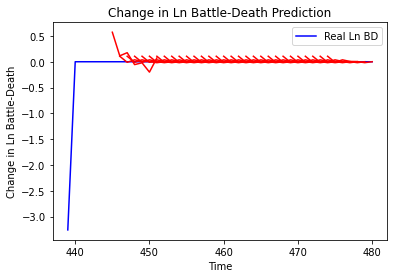

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Eritrea', 'country_id': 56, 'step': 't+1', 'mse': 0.021815705353327153, 'mae': 0.12183727274338405, 'r2': 0.0, 'tadda_score': 0.12183727274338405}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+2', 'mse': 0.024480907285466074, 'mae': 0.11498436952630679, 'r2': 0.0, 'tadda_score': 0.11498436952630679}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+3', 'mse': 0.041703546886605644, 'mae': 0.15678036113580068, 'r2': 0.0, 'tadda_score': 0.15678036113580068}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+4', 'mse': 0.040069435162416386, 'mae': 0.16029228617747623, 'r2': 0.0, 'tadda_score': 0.16029228617747623}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+5', 'mse': 0.03759502754007258, 'mae': 0.17016165256500243, 'r2': 0.0, 'tadda_score': 0.17016165256500243}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+6', 'mse': 0.024932382766882078, 'mae': 0.1459913765390714, 'r2': 0.0, 'tadda_score': 0

18/18 [==============================] - 0s 5ms/step - loss: 4.5613 - val_loss: 2.6154
Epoch 61/100
18/18 [==============================] - 0s 5ms/step - loss: 4.5957 - val_loss: 2.6153
Epoch 62/100
18/18 [==============================] - 0s 5ms/step - loss: 4.5349 - val_loss: 2.6143
Epoch 63/100
18/18 [==============================] - 0s 5ms/step - loss: 4.5356 - val_loss: 2.6136
Epoch 64/100
18/18 [==============================] - 0s 5ms/step - loss: 4.5876 - val_loss: 2.6134
Epoch 65/100
18/18 [==============================] - 0s 5ms/step - loss: 4.5735 - val_loss: 2.6159
Epoch 66/100
18/18 [==============================] - 0s 5ms/step - loss: 4.5833 - val_loss: 2.6147
Epoch 67/100
18/18 [==============================] - 0s 5ms/step - loss: 4.5489 - val_loss: 2.6146
Epoch 68/100
18/18 [==============================] - 0s 5ms/step - loss: 4.5549 - val_loss: 2.6137
Epoch 69/100
18/18 [==============================] - 0s 5ms/step - loss: 4.5559 - val_loss: 2.6127
Epoch 70/100


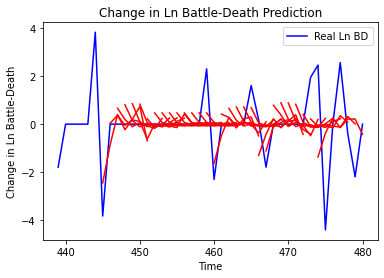

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+1', 'mse': 1.1883238973836543, 'mae': 0.8506710442270841, 'r2': 0.12894876954988754, 'tadda_score': 0.9397060386703416}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+2', 'mse': 3.973876683605306, 'mae': 1.447218132881493, 'r2': -0.9916829867306189, 'tadda_score': 1.6389166155141301}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+3', 'mse': 3.939109642345511, 'mae': 1.439919638254415, 'r2': -0.974257955686809, 'tadda_score': 1.65870323143221}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+4', 'mse': 4.12888728012119, 'mae': 1.4629915566426228, 'r2': -1.0693733612501308, 'tadda_score': 1.6894816091837197}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+5', 'mse': 3.174699774070372, 'mae': 1.219929645824602, 'r2': -0.5911403476810846, 'tadda_score': 1.3681593839011301}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+6', 'mse': 2.662133848562665, '

Epoch 60/100
21/21 [==============================] - 0s 5ms/step - loss: 0.9228 - val_loss: 1.0001
Epoch 61/100
21/21 [==============================] - 0s 6ms/step - loss: 0.9180 - val_loss: 0.9999
Epoch 62/100
21/21 [==============================] - 0s 6ms/step - loss: 0.9203 - val_loss: 0.9997
Epoch 63/100
21/21 [==============================] - 0s 6ms/step - loss: 0.9294 - val_loss: 1.0005
Epoch 64/100
21/21 [==============================] - 0s 6ms/step - loss: 0.9257 - val_loss: 0.9992
Epoch 65/100
21/21 [==============================] - 0s 6ms/step - loss: 0.9224 - val_loss: 0.9996
Epoch 66/100
21/21 [==============================] - 0s 6ms/step - loss: 0.9143 - val_loss: 1.0000
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 0.9214 - val_loss: 1.0000
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 0.9230 - val_loss: 0.9998
Epoch 69/100
21/21 [==============================] - 0s 4ms/step - loss: 0.9198 - val_loss: 1.0000


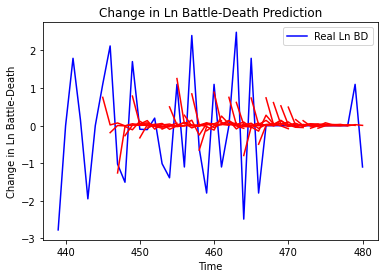

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Algeria', 'country_id': 67, 'step': 't+1', 'mse': 1.0697186493898223, 'mae': 0.7978175522337394, 'r2': 0.329275065748171, 'tadda_score': 0.8328224769681729}
{'country': 'Algeria', 'country_id': 67, 'step': 't+2', 'mse': 2.3276779567505126, 'mae': 1.1565371402473625, 'r2': -0.3820672840786232, 'tadda_score': 1.4068873016408463}
{'country': 'Algeria', 'country_id': 67, 'step': 't+3', 'mse': 2.6752975976626154, 'mae': 1.2796363173321894, 'r2': -0.49135766761075295, 'tadda_score': 1.5699170513347795}
{'country': 'Algeria', 'country_id': 67, 'step': 't+4', 'mse': 2.822617023228439, 'mae': 1.291641372486455, 'r2': -0.38262678570231334, 'tadda_score': 1.5413460520848659}
{'country': 'Algeria', 'country_id': 67, 'step': 't+5', 'mse': 2.1135995686424724, 'mae': 1.0648402081760104, 'r2': -0.5705497581970127, 'tadda_score': 1.2854584397705728}
{'country': 'Algeria', 'country_id': 67, 'step': 't+6', 'mse': 2.211262546710033

Epoch 60/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1846 - val_loss: 1.4640
Epoch 61/100
21/21 [==============================] - 0s 6ms/step - loss: 0.1854 - val_loss: 1.4655
Epoch 62/100
21/21 [==============================] - 0s 7ms/step - loss: 0.1870 - val_loss: 1.4662
Epoch 63/100
21/21 [==============================] - 0s 6ms/step - loss: 0.1868 - val_loss: 1.4659
Epoch 64/100
21/21 [==============================] - 0s 6ms/step - loss: 0.1850 - val_loss: 1.4647
Epoch 65/100
21/21 [==============================] - 0s 6ms/step - loss: 0.1858 - val_loss: 1.4644
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1835 - val_loss: 1.4636
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1843 - val_loss: 1.4646
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1838 - val_loss: 1.4647
Epoch 69/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1861 - val_loss: 1.4644


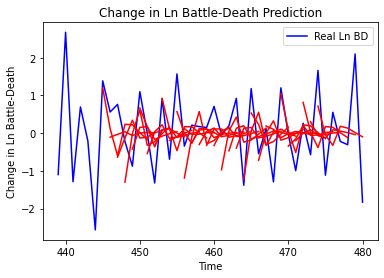

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cameroon', 'country_id': 69, 'step': 't+1', 'mse': 0.566261375913747, 'mae': 0.6492828808694131, 'r2': 0.2311011029216118, 'tadda_score': 0.7550136814484047}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+2', 'mse': 1.7195236294005187, 'mae': 1.1461649355002104, 'r2': -1.3295812187008207, 'tadda_score': 1.5935945646671315}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+3', 'mse': 1.3522355836763054, 'mae': 0.9468606332782755, 'r2': -0.3798280023982128, 'tadda_score': 1.1223113333030392}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+4', 'mse': 1.5428116253917248, 'mae': 0.9735550925012937, 'r2': -0.7518222608299416, 'tadda_score': 1.229117580987663}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+5', 'mse': 1.9041787164848392, 'mae': 1.1391947214787868, 'r2': -0.9143531764861845, 'tadda_score': 1.4822014345462786}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+6', 'mse': 2.1464420967

21/21 [==============================] - 0s 5ms/step - loss: 0.7326 - val_loss: 2.3938
Epoch 60/100
21/21 [==============================] - 0s 5ms/step - loss: 0.7345 - val_loss: 2.3933
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.7298 - val_loss: 2.3922
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.7311 - val_loss: 2.3905
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.7231 - val_loss: 2.3941
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.7286 - val_loss: 2.3955
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 0.7198 - val_loss: 2.3944
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 0.7306 - val_loss: 2.3935
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 0.7213 - val_loss: 2.3950
Epoch 68/100
21/21 [==============================] - 0s 4ms/step - loss: 0.7245 - val_loss: 2.3957
Epoch 69/100


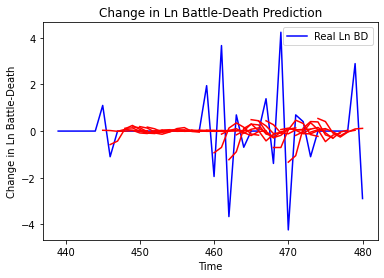

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+1', 'mse': 1.921715140731194, 'mae': 0.8578833523247565, 'r2': 0.27338081778834866, 'tadda_score': 0.8766324547781472}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+2', 'mse': 2.032976504293396, 'mae': 1.0601151466937635, 'r2': -0.38867057622771073, 'tadda_score': 1.1289381339472306}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+3', 'mse': 2.4385232396771728, 'mae': 1.0288129366170402, 'r2': -0.040405733525462395, 'tadda_score': 1.093388186070426}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+4', 'mse': 2.9380681528312187, 'mae': 1.0891257522830984, 'r2': -0.21525945453537387, 'tadda_score': 1.1355244766503196}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+5', 'mse': 2.776315762219694, 'mae': 0.9590373431197234, 'r2': -0.09555902775044367, 'tadda_score': 1.0147467920

21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 57/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 58/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 59/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 60/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0

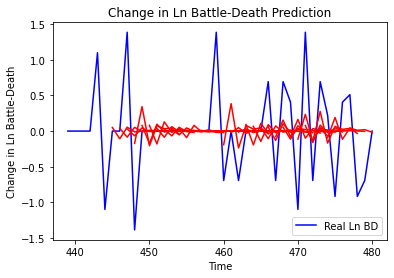

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tunisia', 'country_id': 73, 'step': 't+1', 'mse': 0.3649384011527977, 'mae': 0.39834876279585935, 'r2': 0.11603089817663537, 'tadda_score': 0.4041252351855574}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+2', 'mse': 0.3930873097815621, 'mae': 0.426775848610437, 'r2': 0.044736481344820445, 'tadda_score': 0.4388514028794925}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+3', 'mse': 0.48776451344712574, 'mae': 0.47029963307192185, 'r2': -0.02084588504496665, 'tadda_score': 0.47488972337405144}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+4', 'mse': 0.49442527304955186, 'mae': 0.4590380735742362, 'r2': -0.023931869145592533, 'tadda_score': 0.4608115183546952}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+5', 'mse': 0.5035340868003977, 'mae': 0.5061849248203899, 'r2': -0.1445553108840325, 'tadda_score': 0.5466983739826347}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+6', 'mse': 0.59789

21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
21/21 [=====================

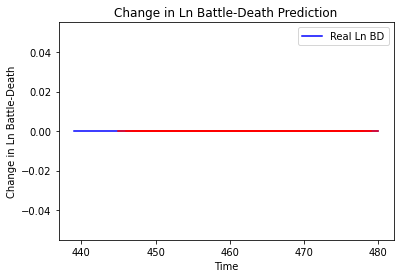

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Benin', 'country_id': 74, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Equatorial Guinea']
Building vanilla Model...
Model: "sequential_673"
_________________________________________________________________
Layer (type)                 Output S

21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
21/21 [=====================

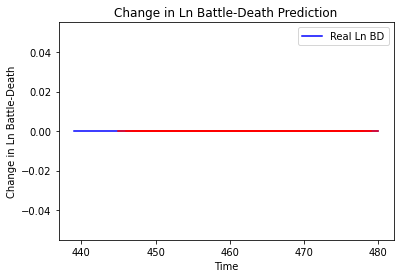

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Niger']
Building vanilla Model...
Model: "sequential_674"
_______________________________

21/21 [==============================] - 0s 5ms/step - loss: 0.8482 - val_loss: 1.6337
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.8484 - val_loss: 1.6333
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 0.8550 - val_loss: 1.6339
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 0.8570 - val_loss: 1.6333
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 0.8514 - val_loss: 1.6336
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 0.8416 - val_loss: 1.6339
Epoch 69/100
21/21 [==============================] - 0s 5ms/step - loss: 0.8530 - val_loss: 1.6335
Epoch 70/100
21/21 [==============================] - 0s 5ms/step - loss: 0.8427 - val_loss: 1.6335
Epoch 71/100
21/21 [==============================] - 0s 5ms/step - loss: 0.8574 - val_loss: 1.6342
Epoch 72/100
21/21 [==============================] - 0s 5ms/step - loss: 0.8438 - val_loss: 1.6335
Epoch 73/100


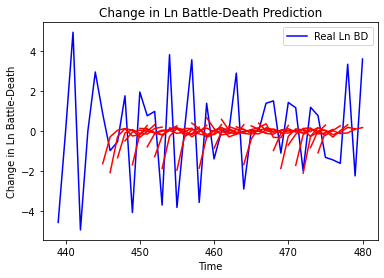

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Niger', 'country_id': 78, 'step': 't+1', 'mse': 3.3672347257404476, 'mae': 1.5662138926415774, 'r2': 0.2226829380459887, 'tadda_score': 1.88114885960312}
{'country': 'Niger', 'country_id': 78, 'step': 't+2', 'mse': 6.623699051750605, 'mae': 2.1410423091465813, 'r2': -0.6867900032055589, 'tadda_score': 2.61655897760536}
{'country': 'Niger', 'country_id': 78, 'step': 't+3', 'mse': 6.173515823828014, 'mae': 1.935263804366622, 'r2': -0.5939738378627593, 'tadda_score': 2.455020029118094}
{'country': 'Niger', 'country_id': 78, 'step': 't+4', 'mse': 6.448747766087961, 'mae': 2.1164154423435213, 'r2': -0.42129689808244963, 'tadda_score': 2.556933021859296}
{'country': 'Niger', 'country_id': 78, 'step': 't+5', 'mse': 7.885148199062556, 'mae': 2.2517558918407925, 'r2': -0.4334474683912899, 'tadda_score': 2.7343658723941813}
{'country': 'Niger', 'country_id': 78, 'step': 't+6', 'mse': 7.488029330353229, 'mae': 2.1297410148

21/21 [==============================] - 0s 5ms/step - loss: 0.5355 - val_loss: 1.1857
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5277 - val_loss: 1.1856
Epoch 62/100
21/21 [==============================] - 0s 4ms/step - loss: 0.5340 - val_loss: 1.1872
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5260 - val_loss: 1.1857
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5359 - val_loss: 1.1869
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5324 - val_loss: 1.1890
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5254 - val_loss: 1.1891
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5318 - val_loss: 1.1892
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5380 - val_loss: 1.1907
Epoch 69/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5341 - val_loss: 1.1874
Epoch 70/100


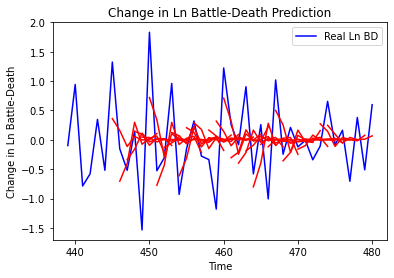

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Nigeria', 'country_id': 79, 'step': 't+1', 'mse': 0.4066183193704628, 'mae': 0.4879316544645532, 'r2': 0.28851468092027177, 'tadda_score': 0.5433144083110992}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+2', 'mse': 1.1993676062426757, 'mae': 0.8710508837337146, 'r2': -1.2166580217648328, 'tadda_score': 1.155258288138593}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+3', 'mse': 0.9399859610607442, 'mae': 0.7814882700335856, 'r2': -0.5341953625744333, 'tadda_score': 0.9764655353505786}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+4', 'mse': 1.1474341062707352, 'mae': 0.8388661810872109, 'r2': -0.5425075001259136, 'tadda_score': 1.0882490384912393}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+5', 'mse': 0.7479651028063241, 'mae': 0.6618918487427109, 'r2': -0.4609746739421845, 'tadda_score': 0.8116074353081458}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+6', 'mse': 0.73465661409407

21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
21/21 [=====================

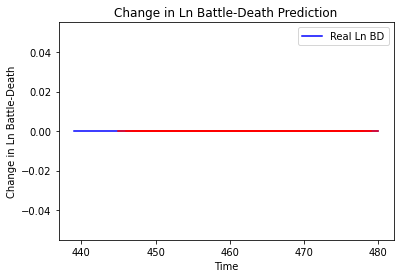

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Togo']
Building vanilla Model...
Model: "sequential_677"
____

21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
21/21 [=====================

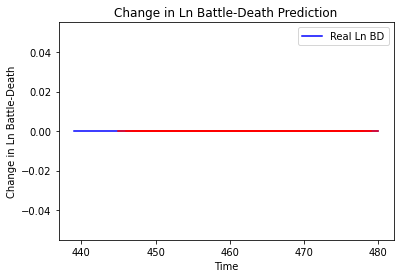

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Togo', 'country_id': 81, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Somalia']
Building vanilla Model...
Model: "sequential_678"
_________________________________________________________________
Layer (type)                 Output Shape             

21/21 [==============================] - 0s 5ms/step - loss: 2.5318 - val_loss: 0.3675
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 2.5978 - val_loss: 0.3678
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 2.5645 - val_loss: 0.3686
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 2.5743 - val_loss: 0.3692
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 2.5857 - val_loss: 0.3688
Epoch 69/100
21/21 [==============================] - 0s 5ms/step - loss: 2.5616 - val_loss: 0.3677
Epoch 70/100
21/21 [==============================] - 0s 5ms/step - loss: 2.5931 - val_loss: 0.3677
Epoch 71/100
21/21 [==============================] - 0s 5ms/step - loss: 2.5613 - val_loss: 0.3675
Epoch 72/100
21/21 [==============================] - 0s 5ms/step - loss: 2.5700 - val_loss: 0.3678
Epoch 73/100
21/21 [==============================] - 0s 5ms/step - loss: 2.5846 - val_loss: 0.3678
Epoch 74/100


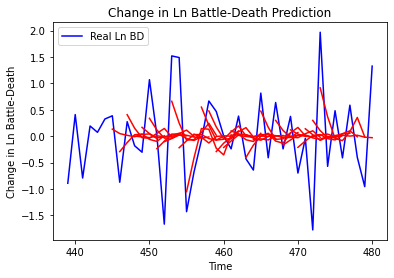

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Somalia', 'country_id': 120, 'step': 't+1', 'mse': 0.539325372724479, 'mae': 0.5582188049893818, 'r2': 0.2920247689566966, 'tadda_score': 0.6345124432758732}
{'country': 'Somalia', 'country_id': 120, 'step': 't+2', 'mse': 1.3972717321114039, 'mae': 0.9021248636016611, 'r2': -0.4248688144337689, 'tadda_score': 1.1114643491364382}
{'country': 'Somalia', 'country_id': 120, 'step': 't+3', 'mse': 1.3403941683720189, 'mae': 0.8517970071882104, 'r2': -0.6794951236401339, 'tadda_score': 1.069914506198227}
{'country': 'Somalia', 'country_id': 120, 'step': 't+4', 'mse': 1.0147226267998113, 'mae': 0.8293748447025915, 'r2': -0.4638688932497732, 'tadda_score': 0.9862191363833943}
{'country': 'Somalia', 'country_id': 120, 'step': 't+5', 'mse': 0.9000831617167913, 'mae': 0.7078723440702891, 'r2': -0.16758144054937807, 'tadda_score': 0.853780878581592}
{'country': 'Somalia', 'country_id': 120, 'step': 't+6', 'mse': 1.0249352955

21/21 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
21/21 [=====================

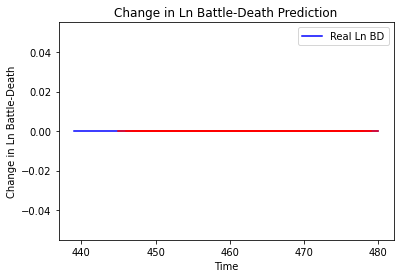

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Botswana', 'country_id': 154, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Burundi']
Building vanilla Model...
Model: "sequential_680"
_________________________________________________________________
Layer (type)       

21/21 [==============================] - 0s 5ms/step - loss: 1.9359 - val_loss: 1.6133
Epoch 64/100
21/21 [==============================] - 0s 6ms/step - loss: 1.9252 - val_loss: 1.6131
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 1.9202 - val_loss: 1.6128
Epoch 66/100
21/21 [==============================] - 0s 6ms/step - loss: 1.9144 - val_loss: 1.6122
Epoch 67/100
21/21 [==============================] - 0s 7ms/step - loss: 1.9315 - val_loss: 1.6126
Epoch 68/100
21/21 [==============================] - 0s 7ms/step - loss: 1.9057 - val_loss: 1.6125
Epoch 69/100
21/21 [==============================] - 0s 6ms/step - loss: 1.9305 - val_loss: 1.6133
Epoch 70/100
21/21 [==============================] - 0s 6ms/step - loss: 1.9335 - val_loss: 1.6140
Epoch 71/100
21/21 [==============================] - 0s 5ms/step - loss: 1.9120 - val_loss: 1.6136
Epoch 72/100
21/21 [==============================] - 0s 5ms/step - loss: 1.9214 - val_loss: 1.6136
Epoch 73/100


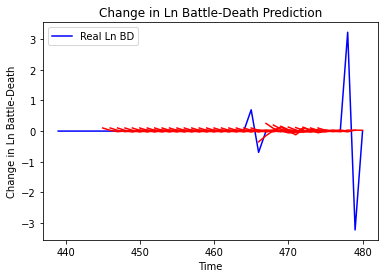

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burundi', 'country_id': 155, 'step': 't+1', 'mse': 0.028765465114771002, 'mae': 0.13757987009702208, 'r2': 0.1019267977887508, 'tadda_score': 0.13757987009702208}
{'country': 'Burundi', 'country_id': 155, 'step': 't+2', 'mse': 0.07205395290533399, 'mae': 0.19314607667146208, 'r2': -1.2495629380400164, 'tadda_score': 0.204355467232248}
{'country': 'Burundi', 'country_id': 155, 'step': 't+3', 'mse': 0.06269164752231363, 'mae': 0.173146972429932, 'r2': -0.9572667578162097, 'tadda_score': 0.18112991439519407}
{'country': 'Burundi', 'country_id': 155, 'step': 't+4', 'mse': 0.053269301276993516, 'mae': 0.1655004018268792, 'r2': -0.663096069766651, 'tadda_score': 0.17072477725364846}
{'country': 'Burundi', 'country_id': 155, 'step': 't+5', 'mse': 0.03842743044332301, 'mae': 0.11203236194668295, 'r2': -0.19972492616724646, 'tadda_score': 0.11446204421140832}
{'country': 'Burundi', 'country_id': 155, 'step': 't+6', 'mse'

21/21 [==============================] - 0s 5ms/step - loss: 2.4220 - val_loss: 0.1844
Epoch 60/100
21/21 [==============================] - 0s 5ms/step - loss: 2.4040 - val_loss: 0.1839
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 2.4085 - val_loss: 0.1827
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 2.4299 - val_loss: 0.1831
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 2.4304 - val_loss: 0.1833
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 2.4094 - val_loss: 0.1836
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 2.4121 - val_loss: 0.1841
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 2.4107 - val_loss: 0.1826
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 2.4280 - val_loss: 0.1842
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 2.4257 - val_loss: 0.1840
Epoch 69/100


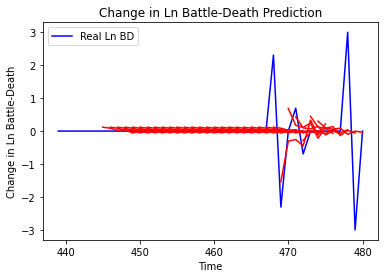

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Rwanda', 'country_id': 156, 'step': 't+1', 'mse': 0.22257133811073843, 'mae': 0.25939995768303237, 'r2': 0.42262757832620157, 'tadda_score': 0.25939995768303237}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+2', 'mse': 0.6884024330633114, 'mae': 0.46581636739407545, 'r2': -0.7857851025999765, 'tadda_score': 0.5134342498842336}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+3', 'mse': 0.5867912277177317, 'mae': 0.4940267690560865, 'r2': -1.1025308193231593, 'tadda_score': 0.5290030915083138}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+4', 'mse': 0.6070608317348473, 'mae': 0.5100657621205592, 'r2': -0.6454137788271923, 'tadda_score': 0.5100657621205592}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+5', 'mse': 0.5907432577257706, 'mae': 0.38495679079518236, 'r2': -0.6011856558648883, 'tadda_score': 0.4026659228307557}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+6', 'mse': 0.58566355

21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
21/21 [=====================

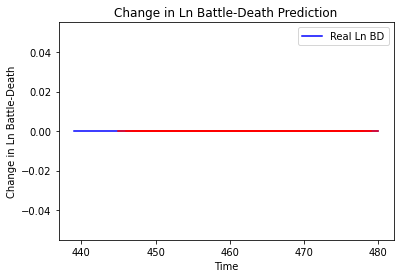

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zambia', 'country_id': 157, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Zimbabwe']
Building vanilla Model...
Model: "sequential_683"
_________________________________________________________________
Layer (type)                 Out

21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
21/21 [=====================

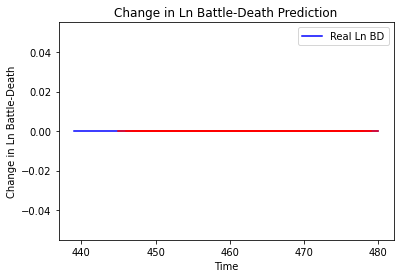

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Comoros']
Building vanilla Model...
Model: "sequential_684"
_________________________________________________________________
Layer (type)       

21/21 [==============================] - 0s 5ms/step - loss: 0.1289 - val_loss: 7.7614e-06
Epoch 62/100
21/21 [==============================] - 0s 6ms/step - loss: 0.1283 - val_loss: 1.1832e-05
Epoch 63/100
21/21 [==============================] - 0s 6ms/step - loss: 0.1276 - val_loss: 2.5979e-04
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1264 - val_loss: 4.5548e-05
Epoch 65/100
21/21 [==============================] - 0s 6ms/step - loss: 0.1260 - val_loss: 9.2798e-06
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1270 - val_loss: 2.9943e-05
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1301 - val_loss: 2.7707e-05
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1279 - val_loss: 4.8295e-05
Epoch 69/100
21/21 [==============================] - 0s 6ms/step - loss: 0.1248 - val_loss: 7.5163e-05
Epoch 70/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1

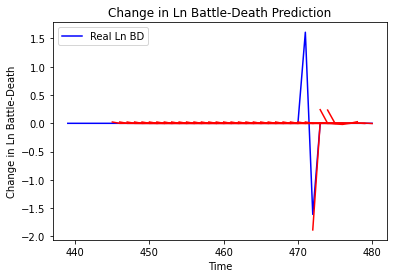

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Comoros', 'country_id': 159, 'step': 't+1', 'mse': 0.09061467971677233, 'mae': 0.09790072043736776, 'r2': 0.4752633917377078, 'tadda_score': 0.09790072043736776}
{'country': 'Comoros', 'country_id': 159, 'step': 't+2', 'mse': 0.31750695752572394, 'mae': 0.20455609552014267, 'r2': -0.8386372330893954, 'tadda_score': 0.21256343316980597}
{'country': 'Comoros', 'country_id': 159, 'step': 't+3', 'mse': 0.3168211555003406, 'mae': 0.20504346562622383, 'r2': -0.83466585196369, 'tadda_score': 0.21287531130709644}
{'country': 'Comoros', 'country_id': 159, 'step': 't+4', 'mse': 0.2065963830556298, 'mae': 0.15179399431098697, 'r2': -1.475248297578431, 'tadda_score': 0.15179399431098697}
{'country': 'Comoros', 'country_id': 159, 'step': 't+5', 'mse': 0.21017520464961142, 'mae': 0.15254491436331669, 'r2': -1.5181264541406132, 'tadda_score': 0.15254491436331669}
{'country': 'Comoros', 'country_id': 159, 'step': 't+6', 'mse': 

21/21 [==============================] - 0s 6ms/step - loss: 0.1394 - val_loss: 1.2795e-05
Epoch 58/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1417 - val_loss: 5.0276e-05
Epoch 59/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1399 - val_loss: 4.3730e-05
Epoch 60/100
21/21 [==============================] - 0s 6ms/step - loss: 0.1405 - val_loss: 1.0622e-04
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1390 - val_loss: 4.0037e-05
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1394 - val_loss: 2.6080e-05
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1421 - val_loss: 6.8849e-05
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1439 - val_loss: 9.4521e-06
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1405 - val_loss: 4.7369e-05
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1

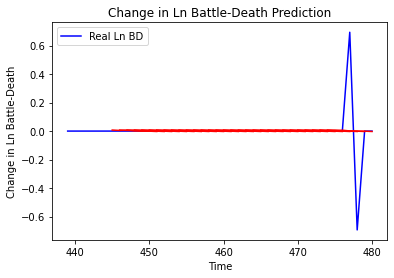

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Lesotho', 'country_id': 160, 'step': 't+1', 'mse': 5.234948227531358e-05, 'mae': 0.007235294207930565, 'r2': 0.0, 'tadda_score': 0.007235294207930565}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+2', 'mse': 0.00013773835120437037, 'mae': 0.011736198328435421, 'r2': 0.0, 'tadda_score': 0.011736198328435421}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+3', 'mse': 0.00032083742350922165, 'mae': 0.017911935225129128, 'r2': 0.0, 'tadda_score': 0.017911935225129128}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+4', 'mse': 0.00035639357689522255, 'mae': 0.01887838914990425, 'r2': 0.0, 'tadda_score': 0.01887838914990425}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+5', 'mse': 0.0002002727435232868, 'mae': 0.014151775278151035, 'r2': 0.0, 'tadda_score': 0.014151775278151035}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+6', 'mse': 0.00018330939939326107, 'mae': 0.013539180159568787, 

Epoch 56/100
21/21 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
21/21 [========

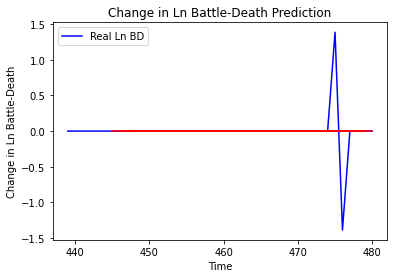

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Malawi', 'country_id': 161, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mozambique']
Building vanilla Model...
Model: "sequential_687"
_________________________________________________________________
Layer (type)                 O

21/21 [==============================] - 0s 5ms/step - loss: 1.0006 - val_loss: 0.6883
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 1.0091 - val_loss: 0.6883
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 0.9961 - val_loss: 0.6886
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 1.0282 - val_loss: 0.6889
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 1.0354 - val_loss: 0.6893
Epoch 69/100
21/21 [==============================] - 0s 5ms/step - loss: 1.0046 - val_loss: 0.6896
Epoch 70/100
21/21 [==============================] - 0s 5ms/step - loss: 1.0418 - val_loss: 0.6902
Epoch 71/100
21/21 [==============================] - 0s 5ms/step - loss: 1.0176 - val_loss: 0.6903
Epoch 72/100
21/21 [==============================] - 0s 5ms/step - loss: 1.0361 - val_loss: 0.6909
Epoch 73/100
21/21 [==============================] - 0s 5ms/step - loss: 1.0611 - val_loss: 0.6904
Epoch 74/100


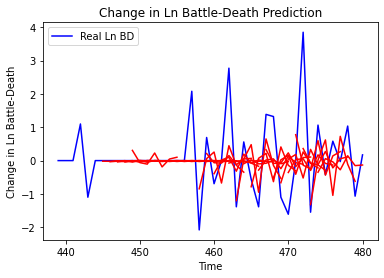

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mozambique', 'country_id': 162, 'step': 't+1', 'mse': 1.2397185826878316, 'mae': 0.6713649681543049, 'r2': 0.2121534615681746, 'tadda_score': 0.7059365611297127}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+2', 'mse': 2.467517736753861, 'mae': 1.0309875645957338, 'r2': -0.2896520221269301, 'tadda_score': 1.1798036648553556}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+3', 'mse': 2.343885498991459, 'mae': 1.0851844997799873, 'r2': -0.2247107737171532, 'tadda_score': 1.1954398231304169}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+4', 'mse': 2.4687779030041597, 'mae': 1.1287965898254477, 'r2': -0.6381758466779515, 'tadda_score': 1.4036961895266138}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+5', 'mse': 1.2793883135984978, 'mae': 0.7883734095523677, 'r2': -0.5621424318383477, 'tadda_score': 0.9078334163556419}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+6', '

21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
21/21 [=====================

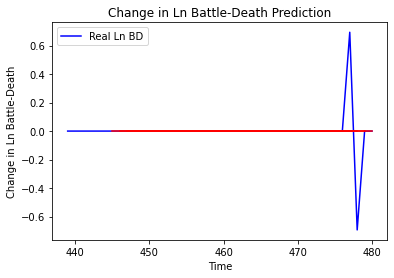

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Africa', 'country_id': 163, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Swaziland']
Building vanilla Model...
Model: "sequential_689"
_______________________________________________________

21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
21/21 [=====================

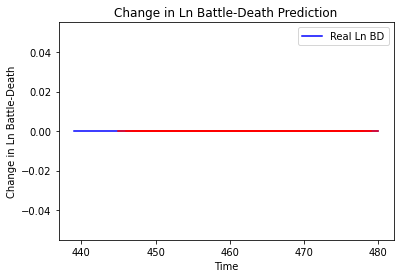

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Swaziland', 'country_id': 164, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Angola']
Building vanilla Model...
Model: "sequential_690"
_________________________________________________________________
Layer (type) 

Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 3.2769 - val_loss: 0.0856
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 3.2948 - val_loss: 0.0847
Epoch 66/100
21/21 [==============================] - 0s 7ms/step - loss: 3.2941 - val_loss: 0.0843
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 3.2459 - val_loss: 0.0844
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 3.2826 - val_loss: 0.0843
Epoch 69/100
21/21 [==============================] - 0s 5ms/step - loss: 3.2859 - val_loss: 0.0848
Epoch 70/100
21/21 [==============================] - 0s 5ms/step - loss: 3.3060 - val_loss: 0.0848
Epoch 71/100
21/21 [==============================] - 0s 5ms/step - loss: 3.2663 - val_loss: 0.0852
Epoch 72/100
21/21 [==============================] - 0s 5ms/step - loss: 3.2872 - val_loss: 0.0857
Epoch 73/100
21/21 [==============================] - 0s 5ms/step - loss: 3.2739 - val_loss: 0.0854


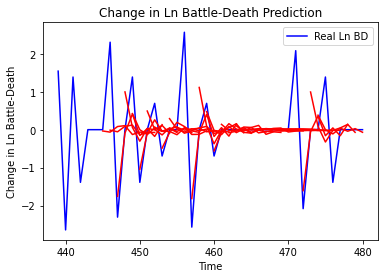

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Angola', 'country_id': 165, 'step': 't+1', 'mse': 0.7405695601549102, 'mae': 0.5297866412065468, 'r2': 0.4180248254426433, 'tadda_score': 0.5302192556919696}
{'country': 'Angola', 'country_id': 165, 'step': 't+2', 'mse': 2.339059148095006, 'mae': 1.0454110677912376, 'r2': -0.8381451645512217, 'tadda_score': 1.1895670670642993}
{'country': 'Angola', 'country_id': 165, 'step': 't+3', 'mse': 1.264757291265945, 'mae': 0.8026217570577868, 'r2': -0.4419428047659171, 'tadda_score': 0.835881019450705}
{'country': 'Angola', 'country_id': 165, 'step': 't+4', 'mse': 1.116613313376425, 'mae': 0.7821564115563362, 'r2': -0.04028218983901777, 'tadda_score': 0.7928585812428921}
{'country': 'Angola', 'country_id': 165, 'step': 't+5', 'mse': 1.2531620781772834, 'mae': 0.7731583659262173, 'r2': -0.2799159296028335, 'tadda_score': 0.7963683603366924}
{'country': 'Angola', 'country_id': 165, 'step': 't+6', 'mse': 1.5502785820443428,

Epoch 60/100
21/21 [==============================] - 0s 5ms/step - loss: 1.8804 - val_loss: 0.2226
Epoch 61/100
21/21 [==============================] - 0s 4ms/step - loss: 1.8722 - val_loss: 0.2218
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 1.8742 - val_loss: 0.2215
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 1.8945 - val_loss: 0.2216
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 1.8889 - val_loss: 0.2215
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 1.8756 - val_loss: 0.2217
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 1.8723 - val_loss: 0.2221
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 1.8619 - val_loss: 0.2217
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 1.8642 - val_loss: 0.2218
Epoch 69/100
21/21 [==============================] - 0s 5ms/step - loss: 1.8764 - val_loss: 0.2214


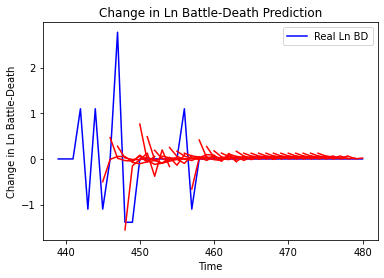

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo', 'country_id': 166, 'step': 't+1', 'mse': 0.37156443204238054, 'mae': 0.36726460754652523, 'r2': 0.26235369622090254, 'tadda_score': 0.36726460754652523}
{'country': 'Congo', 'country_id': 166, 'step': 't+2', 'mse': 1.1437037970914095, 'mae': 0.6646225082243684, 'r2': -0.5049568626519558, 'tadda_score': 0.7768108434841239}
{'country': 'Congo', 'country_id': 166, 'step': 't+3', 'mse': 1.0341076336680086, 'mae': 0.616529785496038, 'r2': -0.7435647060314259, 'tadda_score': 0.7172117480655927}
{'country': 'Congo', 'country_id': 166, 'step': 't+4', 'mse': 0.9507655478823794, 'mae': 0.6380289357424199, 'r2': -0.3687307623300835, 'tadda_score': 0.7286458757043301}
{'country': 'Congo', 'country_id': 166, 'step': 't+5', 'mse': 0.9510809512575629, 'mae': 0.6352672419468977, 'r2': -0.603576963559922, 'tadda_score': 0.7112038447479824}
{'country': 'Congo', 'country_id': 166, 'step': 't+6', 'mse': 0.9130352391728074, 

Epoch 60/100
21/21 [==============================] - 0s 7ms/step - loss: 2.9520 - val_loss: 3.2968
Epoch 61/100
21/21 [==============================] - 0s 7ms/step - loss: 2.9475 - val_loss: 3.2980
Epoch 62/100
21/21 [==============================] - 0s 7ms/step - loss: 2.9444 - val_loss: 3.3006
Epoch 63/100
21/21 [==============================] - 0s 6ms/step - loss: 2.9543 - val_loss: 3.2980
Epoch 64/100
21/21 [==============================] - 0s 6ms/step - loss: 2.9537 - val_loss: 3.2998
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 2.9461 - val_loss: 3.3007
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 2.9463 - val_loss: 3.3045
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 2.9583 - val_loss: 3.3014
Epoch 68/100
21/21 [==============================] - 0s 6ms/step - loss: 2.9366 - val_loss: 3.3037
Epoch 69/100
21/21 [==============================] - 0s 5ms/step - loss: 2.9390 - val_loss: 3.3027


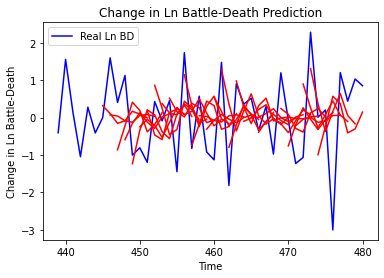

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+1', 'mse': 0.9064263262780077, 'mae': 0.7809424716387742, 'r2': 0.17182065762799803, 'tadda_score': 0.9472502219830506}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+2', 'mse': 2.8734714775192174, 'mae': 1.3816366573742642, 'r2': -1.0322670519715933, 'tadda_score': 1.7976956986458714}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+3', 'mse': 2.6104235726682314, 'mae': 1.311985236542321, 'r2': -0.5133452652913142, 'tadda_score': 1.6739661908516257}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+4', 'mse': 3.1962392103894715, 'mae': 1.4868584085397993, 'r2': -0.8346220566686515, 'tadda_score': 1.95715416634014}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+5', 'mse': 3.952332231219602, 'mae': 1.574913925901149, 'r2': -1.153005350212763, 'tadda_score': 2.122477448955272}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+6', 'mse'

21/21 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
21/21 [=====================

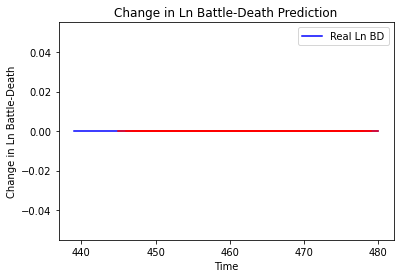

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Gabon', 'country_id': 169, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Namibia']
Building vanilla Model...
Model: "sequential_694"
_________________________________________________________________
Layer (type)                 Output Shap

21/21 [==============================] - 0s 5ms/step - loss: 0.1410 - val_loss: 7.8425e-05
Epoch 62/100
21/21 [==============================] - 0s 4ms/step - loss: 0.1394 - val_loss: 4.8973e-05
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1386 - val_loss: 1.6446e-05
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1393 - val_loss: 3.9203e-05
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1386 - val_loss: 3.1811e-05
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1412 - val_loss: 2.3004e-05
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1401 - val_loss: 1.3565e-04
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1418 - val_loss: 5.9039e-05
Epoch 69/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1384 - val_loss: 1.0102e-04
Epoch 70/100
21/21 [==============================] - 0s 4ms/step - loss: 0.1

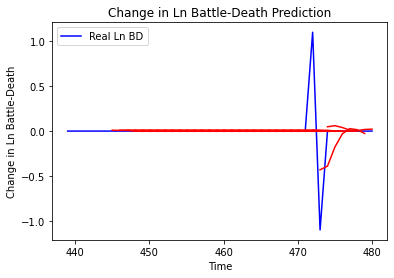

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Namibia', 'country_id': 170, 'step': 't+1', 'mse': 0.05454817122030296, 'mae': 0.06928868981098822, 'r2': 0.32207359642310507, 'tadda_score': 0.06928868981098822}
{'country': 'Namibia', 'country_id': 170, 'step': 't+2', 'mse': 0.11016218686984684, 'mae': 0.11951860678092334, 'r2': -0.3690991555560039, 'tadda_score': 0.12311835156774216}
{'country': 'Namibia', 'country_id': 170, 'step': 't+3', 'mse': 0.07278487046502952, 'mae': 0.09787737847316112, 'r2': -0.8715296842499678, 'tadda_score': 0.09787737847316112}
{'country': 'Namibia', 'country_id': 170, 'step': 't+4', 'mse': 0.07498293792610898, 'mae': 0.09900654984958815, 'r2': -0.928048964632155, 'tadda_score': 0.09900654984958815}
{'country': 'Namibia', 'country_id': 170, 'step': 't+5', 'mse': 0.05209323012332152, 'mae': 0.0743045693481748, 'r2': -0.3394820366013176, 'tadda_score': 0.0743045693481748}
{'country': 'Namibia', 'country_id': 170, 'step': 't+6', 'mse

21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
21/21 [=====================

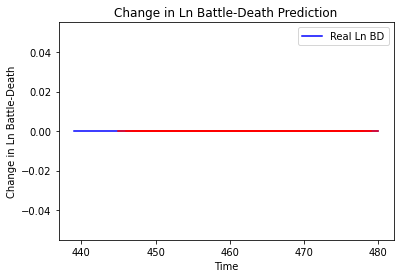

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Madagascar', 'country_id': 172, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mauritius']
Building vanilla Model...
Model: "sequential_696"
_________________________________________________________________
Lay

21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
21/21 [=====================

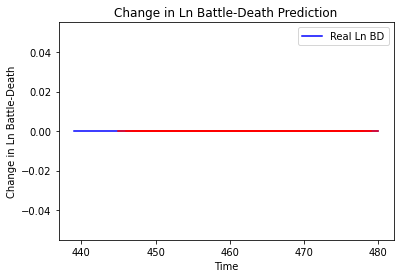

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritius', 'country_id': 173, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Seychelles']
Building vanilla Model...
Model: "sequential_697"
_________________________________________________________________
Layer (ty

21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
21/21 [=====================

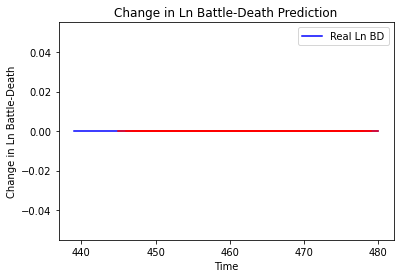

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Seychelles', 'country_id': 174, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Libya']
Building vanilla Model...
Model: "sequential_698"
_________________________________________________________________
Layer (

Epoch 64/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3024
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0315 - val_loss: 2.3024
Epoch 66/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3025
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.3025
Epoch 68/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3024
Epoch 69/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3026
Epoch 70/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3025
Epoch 71/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3025
Epoch 72/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3026
Epoch 73/100
21/21 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3026


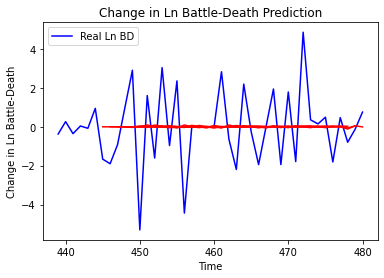

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Libya', 'country_id': 213, 'step': 't+1', 'mse': 4.839863104649995, 'mae': 1.6880531902230884, 'r2': 0.0011913162052563653, 'tadda_score': 1.6886203864278813}
{'country': 'Libya', 'country_id': 213, 'step': 't+2', 'mse': 5.422595159741314, 'mae': 1.7846721270435082, 'r2': -0.0009905768698761364, 'tadda_score': 1.786253882666458}
{'country': 'Libya', 'country_id': 213, 'step': 't+3', 'mse': 7.42900759952297, 'mae': 2.1089957441423146, 'r2': -0.0008713038606280588, 'tadda_score': 2.1108892000500172}
{'country': 'Libya', 'country_id': 213, 'step': 't+4', 'mse': 5.826494546335447, 'mae': 1.9766963628692364, 'r2': -0.006853224879643127, 'tadda_score': 1.978744112505155}
{'country': 'Libya', 'country_id': 213, 'step': 't+5', 'mse': 7.424898569950738, 'mae': 2.2846517947295264, 'r2': -0.020439149899042386, 'tadda_score': 2.304568910966089}
{'country': 'Libya', 'country_id': 213, 'step': 't+6', 'mse': 6.3258808752538895

Epoch 60/100
21/21 [==============================] - 0s 4ms/step - loss: 4.9641 - val_loss: 0.8511
Epoch 61/100
21/21 [==============================] - 0s 4ms/step - loss: 4.9954 - val_loss: 0.8504
Epoch 62/100
21/21 [==============================] - 0s 4ms/step - loss: 4.9636 - val_loss: 0.8493
Epoch 63/100
21/21 [==============================] - 0s 4ms/step - loss: 4.9454 - val_loss: 0.8506
Epoch 64/100
21/21 [==============================] - 0s 4ms/step - loss: 4.9946 - val_loss: 0.8499
Epoch 65/100
21/21 [==============================] - 0s 4ms/step - loss: 4.9519 - val_loss: 0.8524
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 4.9600 - val_loss: 0.8509
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 4.9526 - val_loss: 0.8512
Epoch 68/100
21/21 [==============================] - 0s 4ms/step - loss: 4.9182 - val_loss: 0.8505
Epoch 69/100
21/21 [==============================] - 0s 5ms/step - loss: 4.9369 - val_loss: 0.8503


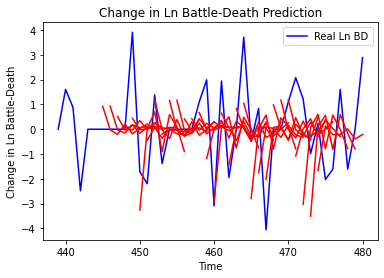

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Chad', 'country_id': 214, 'step': 't+1', 'mse': 3.3551234200045075, 'mae': 1.4641197321795734, 'r2': -0.1429730326998322, 'tadda_score': 1.7546658951027505}
{'country': 'Chad', 'country_id': 214, 'step': 't+2', 'mse': 8.316319109375376, 'mae': 2.2369973086481045, 'r2': -0.9592007741991067, 'tadda_score': 2.9420835021301857}
{'country': 'Chad', 'country_id': 214, 'step': 't+3', 'mse': 9.318641179805573, 'mae': 2.3907941275358238, 'r2': -0.7842633380288642, 'tadda_score': 2.988392747791612}
{'country': 'Chad', 'country_id': 214, 'step': 't+4', 'mse': 13.40778621727574, 'mae': 3.0591137148706293, 'r2': -1.1987431746910984, 'tadda_score': 3.934275332864938}
{'country': 'Chad', 'country_id': 214, 'step': 't+5', 'mse': 11.260629368161485, 'mae': 2.6983352777432272, 'r2': -1.3702294699803943, 'tadda_score': 3.4521934019596245}
{'country': 'Chad', 'country_id': 214, 'step': 't+6', 'mse': 9.349572542424879, 'mae': 2.3952

21/21 [==============================] - 0s 5ms/step - loss: 0.5701 - val_loss: 2.1287
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5804 - val_loss: 2.1292
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5776 - val_loss: 2.1258
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5771 - val_loss: 2.1241
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5643 - val_loss: 2.1245
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5731 - val_loss: 2.1243
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5730 - val_loss: 2.1222
Epoch 67/100
21/21 [==============================] - 0s 4ms/step - loss: 0.5648 - val_loss: 2.1231
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5705 - val_loss: 2.1203
Epoch 69/100
21/21 [==============================] - 0s 5ms/step - loss: 0.5674 - val_loss: 2.1214
Epoch 70/100


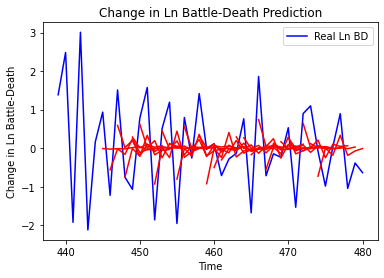

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Egypt', 'country_id': 222, 'step': 't+1', 'mse': 0.6849057144866327, 'mae': 0.6884726106199367, 'r2': 0.39229943912878595, 'tadda_score': 0.7372455926311755}
{'country': 'Egypt', 'country_id': 222, 'step': 't+2', 'mse': 1.5399551927538535, 'mae': 1.0510705473671935, 'r2': -0.42396532856175906, 'tadda_score': 1.2748884667093516}
{'country': 'Egypt', 'country_id': 222, 'step': 't+3', 'mse': 1.4119628406599458, 'mae': 0.9637827081221289, 'r2': -0.5224567881450823, 'tadda_score': 1.1910931652027312}
{'country': 'Egypt', 'country_id': 222, 'step': 't+4', 'mse': 1.2941953473275598, 'mae': 0.9494719964897949, 'r2': -0.050673972231023656, 'tadda_score': 1.112026508911085}
{'country': 'Egypt', 'country_id': 222, 'step': 't+5', 'mse': 1.601846480437881, 'mae': 1.0795050203506156, 'r2': -0.3502215013426191, 'tadda_score': 1.3464851004087925}
{'country': 'Egypt', 'country_id': 222, 'step': 't+6', 'mse': 1.3678386386937897, 

21/21 [==============================] - 0s 5ms/step - loss: 2.6539 - val_loss: 8.0755e-04
Epoch 59/100
21/21 [==============================] - 0s 5ms/step - loss: 2.6492 - val_loss: 0.0011
Epoch 60/100
21/21 [==============================] - 0s 4ms/step - loss: 2.6762 - val_loss: 8.8482e-04
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 2.6418 - val_loss: 8.6251e-04
Epoch 62/100
21/21 [==============================] - 0s 4ms/step - loss: 2.6591 - val_loss: 9.8274e-04
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 2.6344 - val_loss: 5.2761e-04
Epoch 64/100
21/21 [==============================] - 0s 4ms/step - loss: 2.6664 - val_loss: 6.9756e-04
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 2.6550 - val_loss: 8.4251e-04
Epoch 66/100
21/21 [==============================] - 0s 4ms/step - loss: 2.6631 - val_loss: 0.0010
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 2.6815 - va

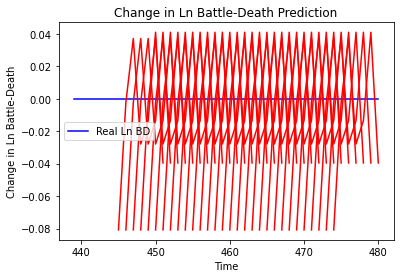

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Uganda', 'country_id': 235, 'step': 't+1', 'mse': 0.006534854885121233, 'mae': 0.08083844929933548, 'r2': 0.0, 'tadda_score': 0.08083844929933548}
{'country': 'Uganda', 'country_id': 235, 'step': 't+2', 'mse': 0.006908690956672958, 'mae': 0.08311853557825089, 'r2': 0.0, 'tadda_score': 0.08311853557825089}
{'country': 'Uganda', 'country_id': 235, 'step': 't+3', 'mse': 0.0021170961901689905, 'mae': 0.04601191356778145, 'r2': 0.0, 'tadda_score': 0.04601191356778145}
{'country': 'Uganda', 'country_id': 235, 'step': 't+4', 'mse': 0.005467977733239815, 'mae': 0.0739457756280899, 'r2': 0.0, 'tadda_score': 0.0739457756280899}
{'country': 'Uganda', 'country_id': 235, 'step': 't+5', 'mse': 0.007244986950603938, 'mae': 0.08511748909950256, 'r2': 0.0, 'tadda_score': 0.08511748909950256}
{'country': 'Uganda', 'country_id': 235, 'step': 't+6', 'mse': 0.0019492980318645131, 'mae': 0.044150855392217636, 'r2': 0.0, 'tadda_score'

21/21 [==============================] - 0s 5ms/step - loss: 0.1146 - val_loss: 1.6492
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1183 - val_loss: 1.6479
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1140 - val_loss: 1.6487
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1151 - val_loss: 1.6484
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1143 - val_loss: 1.6471
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1153 - val_loss: 1.6496
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1160 - val_loss: 1.6509
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1139 - val_loss: 1.6477
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1145 - val_loss: 1.6492
Epoch 69/100
21/21 [==============================] - 0s 5ms/step - loss: 0.1140 - val_loss: 1.6500
Epoch 70/100


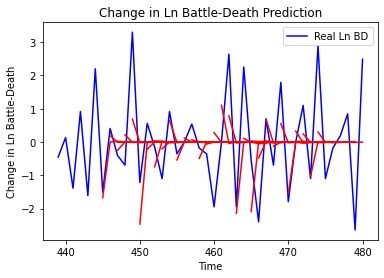

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Kenya', 'country_id': 237, 'step': 't+1', 'mse': 1.3774826938575697, 'mae': 0.8698523533432814, 'r2': 0.33523293200508886, 'tadda_score': 0.8936868456094594}
{'country': 'Kenya', 'country_id': 237, 'step': 't+2', 'mse': 3.4581244232042794, 'mae': 1.511559954503921, 'r2': -0.8115791497610845, 'tadda_score': 1.9630237514473474}
{'country': 'Kenya', 'country_id': 237, 'step': 't+3', 'mse': 3.1274218896084696, 'mae': 1.3672908434417743, 'r2': -0.43224397557676775, 'tadda_score': 1.6441068986204166}
{'country': 'Kenya', 'country_id': 237, 'step': 't+4', 'mse': 3.895162968755146, 'mae': 1.6246110190472263, 'r2': -0.3870134711397253, 'tadda_score': 1.9002783042213578}
{'country': 'Kenya', 'country_id': 237, 'step': 't+5', 'mse': 2.7170076597753563, 'mae': 1.2138593431095996, 'r2': -0.7938453886892409, 'tadda_score': 1.5313464493335007}
{'country': 'Kenya', 'country_id': 237, 'step': 't+6', 'mse': 2.5778687777366476, 'm

16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [=====================

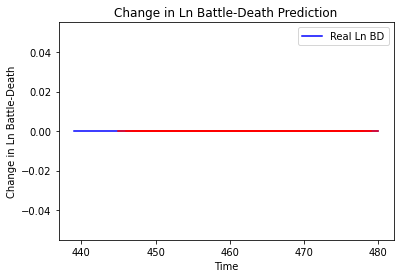

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tanzania', 'country_id': 242, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Morocco']
Building vanilla Model...
Model: "sequential_704"
_________________________________________________________________
Layer (type)       

21/21 [==============================] - 0s 6ms/step - loss: 0.0687 - val_loss: 3.2590e-05
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0692 - val_loss: 7.0295e-06
Epoch 63/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0698 - val_loss: 4.3436e-06
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0700 - val_loss: 5.7439e-06
Epoch 65/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0712 - val_loss: 2.3081e-05
Epoch 66/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0693 - val_loss: 5.4178e-06
Epoch 67/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0697 - val_loss: 9.0370e-06
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0703 - val_loss: 3.2365e-05
Epoch 69/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0690 - val_loss: 1.6513e-05
Epoch 70/100
21/21 [==============================] - 0s 6ms/step - loss: 0.0

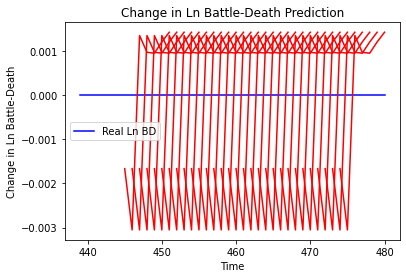

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Morocco', 'country_id': 243, 'step': 't+1', 'mse': 2.7776777960250663e-06, 'mae': 0.0016666366718709469, 'r2': 0.0, 'tadda_score': 0.0016666366718709469}
{'country': 'Morocco', 'country_id': 243, 'step': 't+2', 'mse': 2.227310412206921e-05, 'mae': 0.004719438962638378, 'r2': 0.0, 'tadda_score': 0.004719438962638378}
{'country': 'Morocco', 'country_id': 243, 'step': 't+3', 'mse': 1.138860616558949e-05, 'mae': 0.003374700900167227, 'r2': 0.0, 'tadda_score': 0.003374700900167227}
{'country': 'Morocco', 'country_id': 243, 'step': 't+4', 'mse': 5.805119497420913e-06, 'mae': 0.0024093815591186285, 'r2': 0.0, 'tadda_score': 0.0024093815591186285}
{'country': 'Morocco', 'country_id': 243, 'step': 't+5', 'mse': 2.522673920554494e-06, 'mae': 0.0015882927691563964, 'r2': 0.0, 'tadda_score': 0.0015882927691563964}
{'country': 'Morocco', 'country_id': 243, 'step': 't+6', 'mse': 7.765726264128553e-06, 'mae': 0.002786705270409

21/21 [==============================] - 0s 5ms/step - loss: 0.0627 - val_loss: 0.1137
Epoch 61/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0654 - val_loss: 0.1137
Epoch 62/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0645 - val_loss: 0.1139
Epoch 63/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0639 - val_loss: 0.1140
Epoch 64/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0631 - val_loss: 0.1139
Epoch 65/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0634 - val_loss: 0.1141
Epoch 66/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0649 - val_loss: 0.1143
Epoch 67/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0632 - val_loss: 0.1143
Epoch 68/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0644 - val_loss: 0.1144
Epoch 69/100
21/21 [==============================] - 0s 5ms/step - loss: 0.0629 - val_loss: 0.1145
Epoch 70/100


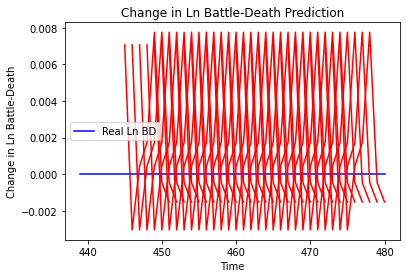

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritania', 'country_id': 244, 'step': 't+1', 'mse': 4.9882712938807174e-05, 'mae': 0.007062769494950771, 'r2': 0.0, 'tadda_score': 0.007062769494950771}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+2', 'mse': 1.610012210342981e-05, 'mae': 0.004012495744973421, 'r2': 0.0, 'tadda_score': 0.004012495744973421}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+3', 'mse': 1.974195446639935e-05, 'mae': 0.004443191923201084, 'r2': 0.0, 'tadda_score': 0.004443191923201084}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+4', 'mse': 3.8006107175859484e-05, 'mae': 0.006164909340441227, 'r2': 0.0, 'tadda_score': 0.006164909340441227}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+5', 'mse': 0.0002880347405920282, 'mae': 0.016971586272120476, 'r2': 0.0, 'tadda_score': 0.016971586272120476}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+6', 'mse': 0.00027260508635518557, 'mae': 0.0

4/4 [==============================] - 0s 8ms/step - loss: 3.2124 - val_loss: 0.9269
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 3.1965 - val_loss: 0.9272
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 3.1948 - val_loss: 0.9271
Epoch 64/100
4/4 [==============================] - 0s 8ms/step - loss: 3.2221 - val_loss: 0.9268
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 3.1669 - val_loss: 0.9266
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 3.2387 - val_loss: 0.9264
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 3.2074 - val_loss: 0.9262
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 3.1924 - val_loss: 0.9261
Epoch 69/100
4/4 [==============================] - 0s 7ms/step - loss: 3.2393 - val_loss: 0.9259
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 3.2190 - val_loss: 0.9258
Epoch 71/100
4/4 [===============

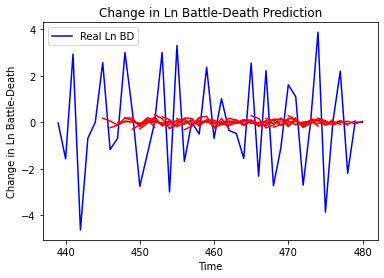

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sudan', 'country_id': 245, 'step': 't+1', 'mse': 3.5207575601779473, 'mae': 1.587942541250937, 'r2': 0.12010633668219595, 'tadda_score': 1.6137567632986634}
{'country': 'Sudan', 'country_id': 245, 'step': 't+2', 'mse': 4.444137172070265, 'mae': 1.7260445212363655, 'r2': -0.041573839617979225, 'tadda_score': 1.8482185921360508}
{'country': 'Sudan', 'country_id': 245, 'step': 't+3', 'mse': 3.964093383000157, 'mae': 1.6750854985061256, 'r2': -0.022186219137877217, 'tadda_score': 1.7255058109653958}
{'country': 'Sudan', 'country_id': 245, 'step': 't+4', 'mse': 3.384396262049606, 'mae': 1.4551037197636691, 'r2': -0.01936858205374925, 'tadda_score': 1.491958472910238}
{'country': 'Sudan', 'country_id': 245, 'step': 't+5', 'mse': 5.210457449649855, 'mae': 1.9339197843952554, 'r2': 0.006168918924602251, 'tadda_score': 1.9736137846791324}
{'country': 'Sudan', 'country_id': 245, 'step': 't+6', 'mse': 4.75264660270055, 'ma

4/4 [==============================] - 0s 7ms/step - loss: 6.4416 - val_loss: 4.1378
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 6.5023 - val_loss: 4.1349
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 6.4689 - val_loss: 4.1322
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 6.4461 - val_loss: 4.1309
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 6.4388 - val_loss: 4.1297
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 6.4472 - val_loss: 4.1284
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 6.3901 - val_loss: 4.1276
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 6.4475 - val_loss: 4.1269
Epoch 69/100
4/4 [==============================] - 0s 7ms/step - loss: 6.4875 - val_loss: 4.1252
Epoch 70/100
4/4 [==============================] - 0s 6ms/step - loss: 6.4499 - val_loss: 4.1223
Epoch 71/100
4/4 [===============

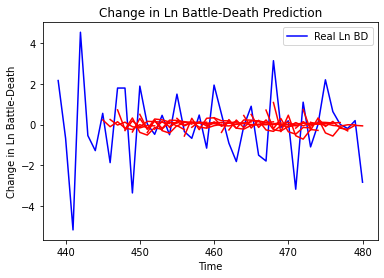

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Sudan', 'country_id': 246, 'step': 't+1', 'mse': 1.864701497509813, 'mae': 1.0775310188697858, 'r2': 0.16178191274777054, 'tadda_score': 1.1759077680773617}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+2', 'mse': 3.0570654432180615, 'mae': 1.3535187015987566, 'r2': -0.13124576852139636, 'tadda_score': 1.472182968264533}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+3', 'mse': 3.381357126587736, 'mae': 1.5363955466812034, 'r2': -0.29327187880982497, 'tadda_score': 1.764008659632522}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+4', 'mse': 3.610857169567827, 'mae': 1.5746146535116978, 'r2': -0.14550136824866655, 'tadda_score': 1.6851180345056997}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+5', 'mse': 2.7879470831792466, 'mae': 1.2849097966154481, 'r2': -0.10528320976453864, 'tadda_score': 1.3296529117288753}
{'country': 'South Sudan', 'country_id': 246, 'step': 

In [41]:
np.random.seed(1)
tf.random.set_seed(1)
model = Sequential()
summary_model(dataset=df,
              modelname = "Vanilla",
              pred_africa=True,
              period=period_test, 
              epochs=100, 
              batch_size=12, 
              look_back=6, 
              look_forward=7,
              num_neurons=6, 
              val_split=0.2)

['Cape Verde']
Building vanilla Model...
Model: "sequential_709"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_694 (LSTM)              (None, 6)                 192       
_________________________________________________________________
dropout_1388 (Dropout)       (None, 6)                 0         
_________________________________________________________________
dense_1388 (Dense)           (None, 6)                 42        
_________________________________________________________________
dropout_1389 (Dropout)       (None, 6)                 0         
_________________________________________________________________
dense_1389 (Dense)           (None, 7)                 49        
Total params: 283
Trainable params: 283
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
122/122 [==============================] - 1s 8ms/step - loss: 0.00

Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
122/122 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
122/122 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 70/100
122/122 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 71/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 72/100
122/122 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 73/100
122/122 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 74/100
122/122 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 75/1

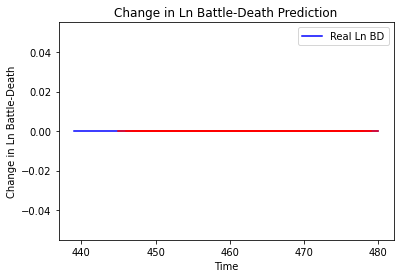

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
["Cote d'Ivoire"]
Building vanilla Model...
Model: "sequential_710"
_________________________________________________________________
Layer 

122/122 [==============================] - 0s 3ms/step - loss: 0.5300 - val_loss: 0.2980
Epoch 63/100
122/122 [==============================] - 0s 3ms/step - loss: 0.5220 - val_loss: 0.2979
Epoch 64/100
122/122 [==============================] - 0s 3ms/step - loss: 0.5286 - val_loss: 0.2983
Epoch 65/100
122/122 [==============================] - 0s 3ms/step - loss: 0.5324 - val_loss: 0.2997
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5431 - val_loss: 0.3004
Epoch 67/100
122/122 [==============================] - 0s 3ms/step - loss: 0.5298 - val_loss: 0.3013
Epoch 68/100
122/122 [==============================] - 0s 3ms/step - loss: 0.5212 - val_loss: 0.3012
Epoch 69/100
122/122 [==============================] - 0s 3ms/step - loss: 0.5227 - val_loss: 0.3000
Epoch 70/100
122/122 [==============================] - 0s 3ms/step - loss: 0.5354 - val_loss: 0.3022
Epoch 71/100
122/122 [==============================] - 0s 3ms/step - loss: 0.5235 - val_loss: 

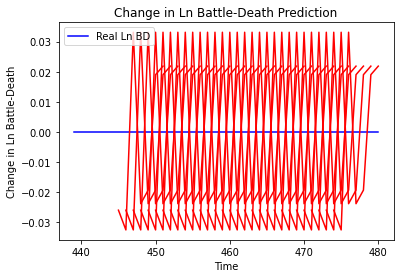

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+1', 'mse': 0.0006812650524705734, 'mae': 0.02610105462372303, 'r2': 0.0, 'tadda_score': 0.02610105462372303}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+2', 'mse': 0.003454082029983374, 'mae': 0.058771438896656036, 'r2': 0.0, 'tadda_score': 0.058771438896656036}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+3', 'mse': 0.0006573186539471504, 'mae': 0.02563822641968727, 'r2': 0.0, 'tadda_score': 0.02563822641968727}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+4', 'mse': 0.0024583345394591505, 'mae': 0.04958159476518631, 'r2': 0.0, 'tadda_score': 0.04958159476518631}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+5', 'mse': 0.0013203829390584648, 'mae': 0.036337073892354965, 'r2': 0.0, 'tadda_score': 0.036337073892354965}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+6', 'mse': 0.0003004398937927477, 'mae': 0

Epoch 55/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/1

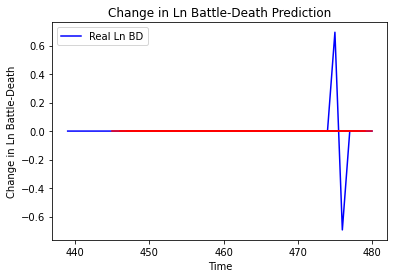

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ghana', 'country_id': 42, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Liberia']
Building vanilla Model...
Model: "sequential_712"
_________________________________________________________________
Layer (type)                 Output Shape      

122/122 [==============================] - 0s 2ms/step - loss: 1.1573 - val_loss: 2.0711e-04
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 1.1646 - val_loss: 1.8642e-04
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 1.1419 - val_loss: 1.0610e-04
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 1.1643 - val_loss: 8.3553e-05
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 1.1433 - val_loss: 0.0031
Epoch 66/100
122/122 [==============================] - 0s 3ms/step - loss: 1.1765 - val_loss: 6.9260e-04
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 1.1674 - val_loss: 0.0010
Epoch 68/100
122/122 [==============================] - 0s 2ms/step - loss: 1.1486 - val_loss: 1.2730e-04
Epoch 69/100
122/122 [==============================] - 0s 2ms/step - loss: 1.1403 - val_loss: 6.6510e-05
Epoch 70/100
122/122 [==============================] - 0s 2ms/step

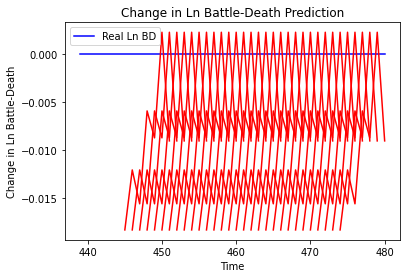

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Liberia', 'country_id': 43, 'step': 't+1', 'mse': 0.00033408592885231236, 'mae': 0.01827801764011383, 'r2': 0.0, 'tadda_score': 0.01827801764011383}
{'country': 'Liberia', 'country_id': 43, 'step': 't+2', 'mse': 0.0009191435921762636, 'mae': 0.030317381024360657, 'r2': 0.0, 'tadda_score': 0.030317381024360657}
{'country': 'Liberia', 'country_id': 43, 'step': 't+3', 'mse': 0.0021048859615513393, 'mae': 0.04587903618812561, 'r2': 0.0, 'tadda_score': 0.04587903618812561}
{'country': 'Liberia', 'country_id': 43, 'step': 't+4', 'mse': 0.00268103340890008, 'mae': 0.05177869647741318, 'r2': 0.0, 'tadda_score': 0.05177869647741318}
{'country': 'Liberia', 'country_id': 43, 'step': 't+5', 'mse': 0.002346524733781108, 'mae': 0.04844094067811966, 'r2': 0.0, 'tadda_score': 0.04844094067811966}
{'country': 'Liberia', 'country_id': 43, 'step': 't+6', 'mse': 0.002130256352364024, 'mae': 0.046154700219631195, 'r2': 0.0, 'tadda_s

122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
122/122 [=

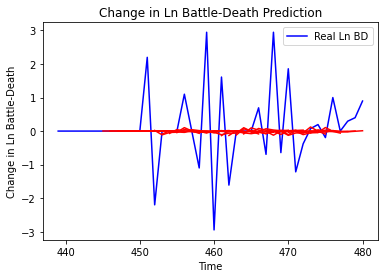

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+1', 'mse': 1.6742776543631133, 'mae': 0.8335248412330749, 'r2': -0.015278527382594831, 'tadda_score': 0.8465746639916477}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+2', 'mse': 1.2153790525381603, 'mae': 0.7374995573037526, 'r2': -0.027045985543387108, 'tadda_score': 0.749499747397866}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+3', 'mse': 2.079107497536221, 'mae': 0.9197378957385883, 'r2': -0.042883405759973625, 'tadda_score': 0.9401895886028871}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+4', 'mse': 2.449831263009633, 'mae': 1.0383192531516663, 'r2': -0.10361105329287468, 'tadda_score': 1.069929188651394}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+5', 'mse': 2.3406549435409576, 'mae': 0.950955364773219, 'r2': -0.12284161414109773, 'tadda_score': 0.968839185729171}
{'country': 'Burkina Faso', 'country_id': 47, 'step

122/122 [==============================] - 0s 2ms/step - loss: 0.2421 - val_loss: 7.2400e-05
Epoch 57/100
122/122 [==============================] - 0s 2ms/step - loss: 0.2399 - val_loss: 1.9527e-04
Epoch 58/100
122/122 [==============================] - 0s 2ms/step - loss: 0.2358 - val_loss: 2.8467e-04
Epoch 59/100
122/122 [==============================] - 0s 3ms/step - loss: 0.2464 - val_loss: 7.9289e-04
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.2405 - val_loss: 8.5578e-05
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.2428 - val_loss: 5.6463e-04
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.2441 - val_loss: 1.6667e-04
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.2447 - val_loss: 7.2912e-05
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.2442 - val_loss: 3.3189e-04
Epoch 65/100
122/122 [==============================] - 0s 

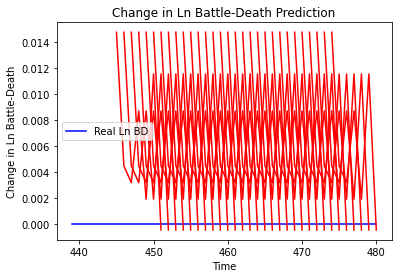

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea', 'country_id': 48, 'step': 't+1', 'mse': 0.00021724123028952005, 'mae': 0.014739105477929115, 'r2': 0.0, 'tadda_score': 0.014739105477929115}
{'country': 'Guinea', 'country_id': 48, 'step': 't+2', 'mse': 0.00036872672911482385, 'mae': 0.019202258437871933, 'r2': 0.0, 'tadda_score': 0.019202258437871933}
{'country': 'Guinea', 'country_id': 48, 'step': 't+3', 'mse': 0.0005002321388094567, 'mae': 0.0223658699542284, 'r2': 0.0, 'tadda_score': 0.0223658699542284}
{'country': 'Guinea', 'country_id': 48, 'step': 't+4', 'mse': 0.0009643324872968956, 'mae': 0.031053703278303146, 'r2': 0.0, 'tadda_score': 0.031053703278303146}
{'country': 'Guinea', 'country_id': 48, 'step': 't+5', 'mse': 0.0008115408287726056, 'mae': 0.02848755568265915, 'r2': 0.0, 'tadda_score': 0.02848755568265915}
{'country': 'Guinea', 'country_id': 48, 'step': 't+6', 'mse': 0.0016015685109005418, 'mae': 0.040019601583480835, 'r2': 0.0, 'tadda_

122/122 [==============================] - 0s 2ms/step - loss: 0.5665 - val_loss: 2.4529e-04
Epoch 58/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5767 - val_loss: 1.5031e-04
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5590 - val_loss: 1.9577e-04
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5749 - val_loss: 2.2245e-04
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5636 - val_loss: 0.0021
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5984 - val_loss: 1.7575e-04
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5566 - val_loss: 0.0013
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5428 - val_loss: 7.4208e-05
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5864 - val_loss: 6.4397e-04
Epoch 66/100
122/122 [==============================] - 0s 3ms/step

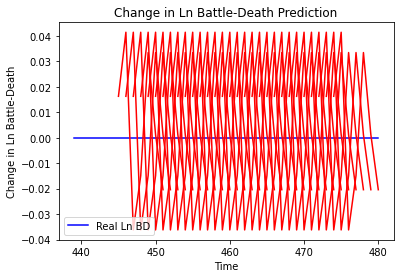

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+1', 'mse': 0.00026426858525502306, 'mae': 0.016256339848041534, 'r2': 0.0, 'tadda_score': 0.016256339848041534}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+2', 'mse': 0.003325899045876435, 'mae': 0.057670608162879944, 'r2': 0.0, 'tadda_score': 0.057670608162879944}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+3', 'mse': 0.00046091063424270884, 'mae': 0.02146882936358452, 'r2': 0.0, 'tadda_score': 0.02146882936358452}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+4', 'mse': 4.3422961660058434e-05, 'mae': 0.006589610129594803, 'r2': 0.0, 'tadda_score': 0.006589610129594803}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+5', 'mse': 1.9291776877233824e-06, 'mae': 0.0013889484107494354, 'r2': 0.0, 'tadda_score': 0.0013889484107494354}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+6', 'mse': 3.983314546263106e-08

Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 1.2724 - val_loss: 3.0115
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 1.2725 - val_loss: 3.0118
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 1.2678 - val_loss: 3.0143
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 1.2602 - val_loss: 3.0201
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 1.2609 - val_loss: 3.0173
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 1.2556 - val_loss: 3.0231
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 1.2471 - val_loss: 3.0230
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 1.2502 - val_loss: 3.0284
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 1.2569 - val_loss: 3.0257
Epoch 68/100
122/122 [==============================] - 0s 2ms/step - loss: 1.2440

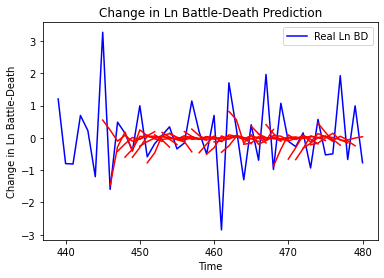

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mali', 'country_id': 50, 'step': 't+1', 'mse': 0.865798232750784, 'mae': 0.6726916594281112, 'r2': 0.31417317582328297, 'tadda_score': 0.7601805696114217}
{'country': 'Mali', 'country_id': 50, 'step': 't+2', 'mse': 1.7382947585416184, 'mae': 1.056002194133645, 'r2': -0.7954271244304203, 'tadda_score': 1.4099601918928288}
{'country': 'Mali', 'country_id': 50, 'step': 't+3', 'mse': 1.6771901207640096, 'mae': 1.1011255656685504, 'r2': -0.47733606915633686, 'tadda_score': 1.4430003806954692}
{'country': 'Mali', 'country_id': 50, 'step': 't+4', 'mse': 2.3188469487315535, 'mae': 1.2621143968498794, 'r2': -0.5506155716449526, 'tadda_score': 1.6536854458695738}
{'country': 'Mali', 'country_id': 50, 'step': 't+5', 'mse': 1.7226410337922475, 'mae': 1.0721777518798938, 'r2': -0.5909413311620273, 'tadda_score': 1.3071312966654733}
{'country': 'Mali', 'country_id': 50, 'step': 't+6', 'mse': 2.076703025656074, 'mae': 1.182538

Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 1.6247 - val_loss: 0.4321
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 1.6253 - val_loss: 0.4326
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 1.6277 - val_loss: 0.4334
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 1.6259 - val_loss: 0.4331
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 1.6171 - val_loss: 0.4332
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 1.6053 - val_loss: 0.4351
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 1.6157 - val_loss: 0.4359
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 1.6175 - val_loss: 0.4340
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 1.6160 - val_loss: 0.4356
Epoch 68/100
122/122 [==============================] - 0s 2ms/step - loss: 1.6126

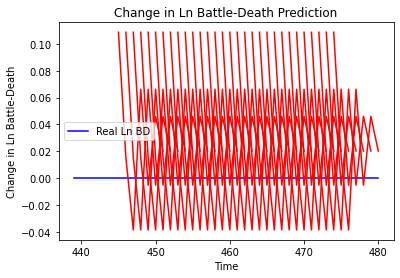

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Senegal', 'country_id': 52, 'step': 't+1', 'mse': 0.011829957823479786, 'mae': 0.108765609562397, 'r2': 0.0, 'tadda_score': 0.108765609562397}
{'country': 'Senegal', 'country_id': 52, 'step': 't+2', 'mse': 0.015390759120951003, 'mae': 0.12405949831008911, 'r2': 0.0, 'tadda_score': 0.12405949831008911}
{'country': 'Senegal', 'country_id': 52, 'step': 't+3', 'mse': 0.00729438428994289, 'mae': 0.08540716767311096, 'r2': 0.0, 'tadda_score': 0.08540716767311096}
{'country': 'Senegal', 'country_id': 52, 'step': 't+4', 'mse': 0.023006133080016866, 'mae': 0.15167772769927979, 'r2': 0.0, 'tadda_score': 0.15167772769927979}
{'country': 'Senegal', 'country_id': 52, 'step': 't+5', 'mse': 0.01718884292503109, 'mae': 0.13110622763633728, 'r2': 0.0, 'tadda_score': 0.13110622763633728}
{'country': 'Senegal', 'country_id': 52, 'step': 't+6', 'mse': 0.031380352538690204, 'mae': 0.17714500427246094, 'r2': 0.0, 'tadda_score': 0.177

Epoch 58/100
122/122 [==============================] - 0s 2ms/step - loss: 2.1174 - val_loss: 7.3737e-04
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 2.1322 - val_loss: 8.1513e-04
Epoch 60/100
122/122 [==============================] - 0s 3ms/step - loss: 2.1330 - val_loss: 3.2401e-04
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 2.1272 - val_loss: 1.9470e-04
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 2.1044 - val_loss: 3.4625e-04
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 2.1442 - val_loss: 8.7977e-05
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 2.1416 - val_loss: 8.7526e-04
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 2.1191 - val_loss: 3.7870e-04
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 2.0985 - val_loss: 0.0029
Epoch 67/100
122/122 [============================

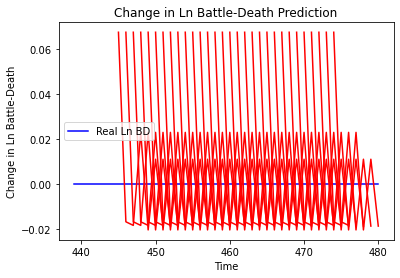

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+1', 'mse': 0.004540716534862099, 'mae': 0.06738483905792236, 'r2': 0.0, 'tadda_score': 0.06738483905792236}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+2', 'mse': 0.0025651934983273034, 'mae': 0.05064773932099342, 'r2': 0.0, 'tadda_score': 0.05064773932099342}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+3', 'mse': 0.0010440127532904686, 'mae': 0.03231118619441986, 'r2': 0.0, 'tadda_score': 0.03231118619441986}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+4', 'mse': 0.0030534595624832073, 'mae': 0.055258117616176605, 'r2': 0.0, 'tadda_score': 0.055258117616176605}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+5', 'mse': 0.0026680583442308947, 'mae': 0.05165325105190277, 'r2': 0.0, 'tadda_score': 0.05165325105190277}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+6', 'mse': 0.003929280995940199, 'mae': 0.06268397

Epoch 55/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/1

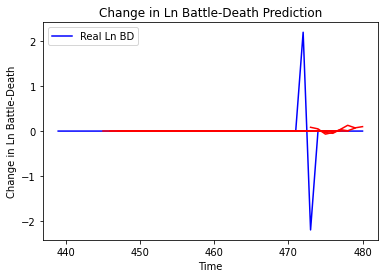

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'The Gambia', 'country_id': 54, 'step': 't+1', 'mse': 0.3344635006101058, 'mae': 0.14996411150983358, 'r2': -0.03918075081110084, 'tadda_score': 0.1527766746410865}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+2', 'mse': 0.3206260668255155, 'mae': 0.15051594397715115, 'r2': 0.00381226577617777, 'tadda_score': 0.15051594397715115}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+3', 'mse': 0.16120023594117155, 'mae': 0.07751101607477359, 'r2': -0.03624223256999781, 'tadda_score': 0.07751101607477359}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+4', 'mse': 0.16098918190446462, 'mae': 0.0752661927729417, 'r2': -0.03488551553473296, 'tadda_score': 0.0752661927729417}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+5', 'mse': 0.16154135505451395, 'mae': 0.07832870462929896, 'r2': -0.0384350459335665, 'tadda_score': 0.07832870462929896}
{'country': 'The Gambia', 'country_id': 54, 'step'

122/122 [==============================] - 0s 2ms/step - loss: 0.6133 - val_loss: 0.0016
Epoch 57/100
122/122 [==============================] - 0s 2ms/step - loss: 0.6185 - val_loss: 0.0047
Epoch 58/100
122/122 [==============================] - 0s 2ms/step - loss: 0.6137 - val_loss: 0.0018
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.6119 - val_loss: 0.0018
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.6142 - val_loss: 0.0019
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.6074 - val_loss: 0.0017
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.6143 - val_loss: 0.0012
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.6249 - val_loss: 0.0013
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.6218 - val_loss: 9.7893e-04
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 0.6089 - val_lo

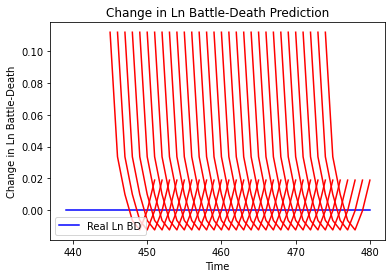

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Djibouti', 'country_id': 55, 'step': 't+1', 'mse': 0.012484647225385892, 'mae': 0.11173471808433533, 'r2': 0.0, 'tadda_score': 0.11173471808433533}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+2', 'mse': 0.02112739623700932, 'mae': 0.14535266160964966, 'r2': 0.0, 'tadda_score': 0.14535266160964966}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+3', 'mse': 0.02414009064734679, 'mae': 0.1553708165884018, 'r2': 0.0, 'tadda_score': 0.1553708165884018}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+4', 'mse': 0.022209381273544437, 'mae': 0.14902812242507935, 'r2': 0.0, 'tadda_score': 0.14902812242507935}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+5', 'mse': 0.01063686913966766, 'mae': 0.10313519835472107, 'r2': 0.0, 'tadda_score': 0.10313519835472107}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+6', 'mse': 0.010595258632722926, 'mae': 0.10293327271938324, 'r2': 0.0, 'tadda_score'

106/106 [==============================] - 0s 2ms/step - loss: 1.9325 - val_loss: 0.0310
Epoch 60/100
106/106 [==============================] - 0s 2ms/step - loss: 1.9460 - val_loss: 0.0291
Epoch 61/100
106/106 [==============================] - 0s 2ms/step - loss: 1.9045 - val_loss: 0.0302
Epoch 62/100
106/106 [==============================] - 0s 2ms/step - loss: 1.9213 - val_loss: 0.0289
Epoch 63/100
106/106 [==============================] - 0s 2ms/step - loss: 1.9139 - val_loss: 0.0296
Epoch 64/100
106/106 [==============================] - 0s 2ms/step - loss: 1.9033 - val_loss: 0.0297
Epoch 65/100
106/106 [==============================] - 0s 2ms/step - loss: 1.9139 - val_loss: 0.0290
Epoch 66/100
106/106 [==============================] - 0s 2ms/step - loss: 1.8949 - val_loss: 0.0295
Epoch 67/100
106/106 [==============================] - 0s 2ms/step - loss: 1.9086 - val_loss: 0.0290
Epoch 68/100
106/106 [==============================] - 0s 2ms/step - loss: 1.8976 - val_loss: 

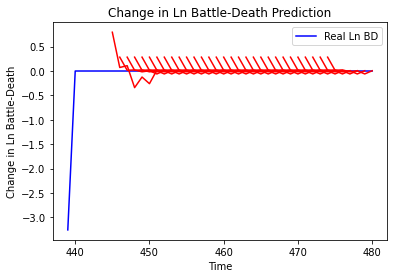

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Eritrea', 'country_id': 56, 'step': 't+1', 'mse': 0.09910709048469749, 'mae': 0.3011705140272776, 'r2': 0.0, 'tadda_score': 0.3011705140272776}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+2', 'mse': 0.11145370763137263, 'mae': 0.3178887516260147, 'r2': 0.0, 'tadda_score': 0.3178887516260147}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+3', 'mse': 0.13198707730618436, 'mae': 0.34376586278279625, 'r2': 0.0, 'tadda_score': 0.34376586278279625}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+4', 'mse': 0.10360977505875028, 'mae': 0.31636636952559155, 'r2': 0.0, 'tadda_score': 0.31636636952559155}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+5', 'mse': 0.09108886696570373, 'mae': 0.3006954292456309, 'r2': 0.0, 'tadda_score': 0.3006954292456309}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+6', 'mse': 0.0547526142652643, 'mae': 0.2337833285331726, 'r2': 0.0, 'tadda_score': 0.23378332853

106/106 [==============================] - 0s 3ms/step - loss: 4.4575 - val_loss: 2.6020
Epoch 60/100
106/106 [==============================] - 0s 3ms/step - loss: 4.4500 - val_loss: 2.6025
Epoch 61/100
106/106 [==============================] - 0s 3ms/step - loss: 4.4557 - val_loss: 2.5988
Epoch 62/100
106/106 [==============================] - 0s 3ms/step - loss: 4.5170 - val_loss: 2.6027
Epoch 63/100
106/106 [==============================] - 0s 3ms/step - loss: 4.5041 - val_loss: 2.6012
Epoch 64/100
106/106 [==============================] - 0s 3ms/step - loss: 4.5160 - val_loss: 2.6041
Epoch 65/100
106/106 [==============================] - 0s 3ms/step - loss: 4.4421 - val_loss: 2.5994
Epoch 66/100
106/106 [==============================] - 0s 3ms/step - loss: 4.5096 - val_loss: 2.5988
Epoch 67/100
106/106 [==============================] - 0s 3ms/step - loss: 4.4444 - val_loss: 2.6028
Epoch 68/100
106/106 [==============================] - 0s 3ms/step - loss: 4.4886 - val_loss: 

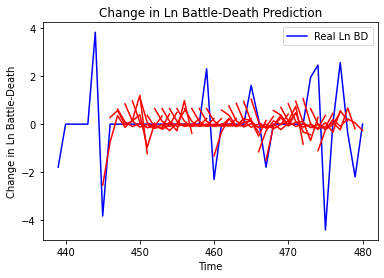

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+1', 'mse': 1.1508881273189127, 'mae': 0.9003676703687514, 'r2': 0.15638949816734193, 'tadda_score': 0.9756071618314589}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+2', 'mse': 3.8705385574270132, 'mae': 1.4770707973521657, 'r2': -0.939890542179169, 'tadda_score': 1.6611140855830617}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+3', 'mse': 3.6986097799426205, 'mae': 1.4756126611115243, 'r2': -0.8537208775648177, 'tadda_score': 1.6578931062104014}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+4', 'mse': 3.8555898355755533, 'mae': 1.5003585039259701, 'r2': -0.9323983330958443, 'tadda_score': 1.694431215393713}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+5', 'mse': 3.0349648879080617, 'mae': 1.2503499943695178, 'r2': -0.5211060669067453, 'tadda_score': 1.3840988614839027}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+6', 'mse': 2.569281609

122/122 [==============================] - 0s 2ms/step - loss: 0.9213 - val_loss: 1.0036
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.9216 - val_loss: 1.0023
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.9127 - val_loss: 1.0051
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.9150 - val_loss: 1.0079
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.9238 - val_loss: 1.0055
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.9133 - val_loss: 1.0058
Epoch 64/100
122/122 [==============================] - 0s 3ms/step - loss: 0.9234 - val_loss: 1.0058
Epoch 65/100
122/122 [==============================] - 0s 4ms/step - loss: 0.9241 - val_loss: 1.0050
Epoch 66/100
122/122 [==============================] - 0s 3ms/step - loss: 0.9219 - val_loss: 1.0047
Epoch 67/100
122/122 [==============================] - 0s 3ms/step - loss: 0.9164 - val_loss: 

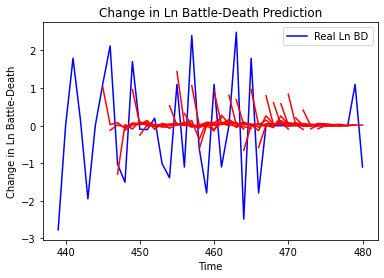

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Algeria', 'country_id': 67, 'step': 't+1', 'mse': 1.0905035449196236, 'mae': 0.8162113870071904, 'r2': 0.3162427158909359, 'tadda_score': 0.8531080950560705}
{'country': 'Algeria', 'country_id': 67, 'step': 't+2', 'mse': 2.4186165395327226, 'mae': 1.193611649789798, 'r2': -0.43606239957957715, 'tadda_score': 1.456568501790005}
{'country': 'Algeria', 'country_id': 67, 'step': 't+3', 'mse': 2.7125032783925866, 'mae': 1.3061426219489187, 'r2': -0.5120981554293038, 'tadda_score': 1.6120484942839552}
{'country': 'Algeria', 'country_id': 67, 'step': 't+4', 'mse': 2.9301280127869185, 'mae': 1.3273039963497675, 'r2': -0.43528981887246565, 'tadda_score': 1.6012932158166129}
{'country': 'Algeria', 'country_id': 67, 'step': 't+5', 'mse': 2.237306254444176, 'mae': 1.1040199838748532, 'r2': -0.6624723287518539, 'tadda_score': 1.3362653874030668}
{'country': 'Algeria', 'country_id': 67, 'step': 't+6', 'mse': 2.338348512430995

122/122 [==============================] - 0s 3ms/step - loss: 0.1827 - val_loss: 1.4545
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1843 - val_loss: 1.4561
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1826 - val_loss: 1.4523
Epoch 61/100
122/122 [==============================] - 0s 3ms/step - loss: 0.1796 - val_loss: 1.4528
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1836 - val_loss: 1.4553
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1792 - val_loss: 1.4544
Epoch 64/100
122/122 [==============================] - 0s 3ms/step - loss: 0.1815 - val_loss: 1.4519
Epoch 65/100
122/122 [==============================] - 0s 3ms/step - loss: 0.1818 - val_loss: 1.4527
Epoch 66/100
122/122 [==============================] - 0s 3ms/step - loss: 0.1812 - val_loss: 1.4510
Epoch 67/100
122/122 [==============================] - 0s 3ms/step - loss: 0.1813 - val_loss: 

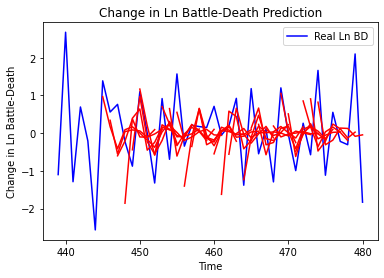

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cameroon', 'country_id': 69, 'step': 't+1', 'mse': 0.7802380941246175, 'mae': 0.7375717675658005, 'r2': -0.05944751937723991, 'tadda_score': 0.8936044049483475}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+2', 'mse': 1.801162018577111, 'mae': 1.1495333999528903, 'r2': -1.4401835127891442, 'tadda_score': 1.5976373377079185}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+3', 'mse': 1.4751062520214877, 'mae': 1.0238330266509583, 'r2': -0.5052058514229656, 'tadda_score': 1.2473095120622844}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+4', 'mse': 1.5764174755021034, 'mae': 0.9464805380210914, 'r2': -0.7899808249401439, 'tadda_score': 1.1898254220764477}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+5', 'mse': 2.1802815032448777, 'mae': 1.2240615562731565, 'r2': -1.19193124323745, 'tadda_score': 1.6307193839186966}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+6', 'mse': 2.160559487

122/122 [==============================] - 0s 2ms/step - loss: 0.7135 - val_loss: 2.3835
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.7049 - val_loss: 2.3742
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.7128 - val_loss: 2.3739
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.7207 - val_loss: 2.3751
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.7144 - val_loss: 2.3749
Epoch 63/100
122/122 [==============================] - 0s 3ms/step - loss: 0.7051 - val_loss: 2.3815
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.7086 - val_loss: 2.3800
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 0.6995 - val_loss: 2.3765
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 0.7196 - val_loss: 2.3728
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 0.7088 - val_loss: 

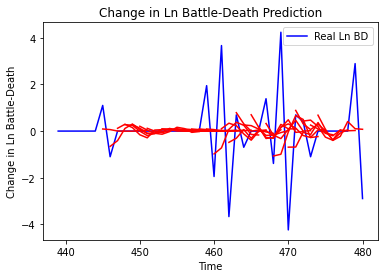

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+1', 'mse': 2.092048644770448, 'mae': 0.8606912563808311, 'r2': 0.20897606352224274, 'tadda_score': 0.8780127625234474}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+2', 'mse': 2.4302794777017485, 'mae': 1.0868463309428864, 'r2': -0.6600573570659494, 'tadda_score': 1.2430802744449947}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+3', 'mse': 2.6433142972552797, 'mae': 1.0776887888490307, 'r2': -0.127780660699506, 'tadda_score': 1.1683862363079338}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+4', 'mse': 2.795648579643165, 'mae': 1.1181192227532089, 'r2': -0.15635110938317154, 'tadda_score': 1.2295913838674246}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+5', 'mse': 2.8779941440125736, 'mae': 0.9679097040605406, 'r2': -0.13568222649322093, 'tadda_score': 1.019997333895

122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 56/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 57/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 58/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 64/100
122/122 [==============================] - 0s 

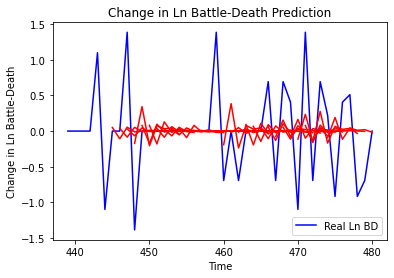

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tunisia', 'country_id': 73, 'step': 't+1', 'mse': 0.3649384011527977, 'mae': 0.39834876279585935, 'r2': 0.11603089817663537, 'tadda_score': 0.4041252351855574}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+2', 'mse': 0.3930873097815621, 'mae': 0.426775848610437, 'r2': 0.044736481344820445, 'tadda_score': 0.4388514028794925}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+3', 'mse': 0.48776451344712574, 'mae': 0.47029963307192185, 'r2': -0.02084588504496665, 'tadda_score': 0.47488972337405144}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+4', 'mse': 0.49442527304955186, 'mae': 0.4590380735742362, 'r2': -0.023931869145592533, 'tadda_score': 0.4608115183546952}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+5', 'mse': 0.5035340868003977, 'mae': 0.5061849248203899, 'r2': -0.1445553108840325, 'tadda_score': 0.5466983739826347}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+6', 'mse': 0.59789

122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 55/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
122/122 [=

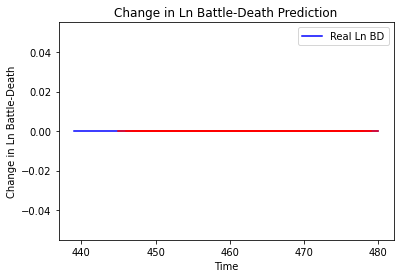

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Benin', 'country_id': 74, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Equatorial Guinea']
Building vanilla Model...
Model: "sequential_728"
_________________________________________________________________
Layer (type)                 Output S

122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
122/122 [=

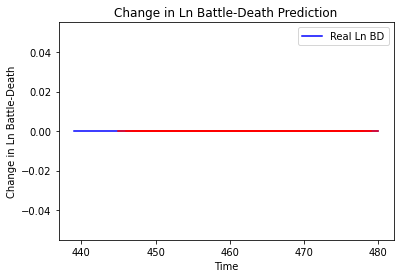

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Niger']
Building vanilla Model...
Model: "sequential_729"
_______________________________

122/122 [==============================] - 0s 2ms/step - loss: 0.8442 - val_loss: 1.6243
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.8471 - val_loss: 1.6250
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.8398 - val_loss: 1.6245
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 0.8484 - val_loss: 1.6262
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 0.8524 - val_loss: 1.6256
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 0.8492 - val_loss: 1.6256
Epoch 68/100
122/122 [==============================] - 0s 2ms/step - loss: 0.8370 - val_loss: 1.6244
Epoch 69/100
122/122 [==============================] - 0s 2ms/step - loss: 0.8463 - val_loss: 1.6237
Epoch 70/100
122/122 [==============================] - 0s 2ms/step - loss: 0.8440 - val_loss: 1.6248
Epoch 71/100
122/122 [==============================] - 0s 2ms/step - loss: 0.8465 - val_loss: 

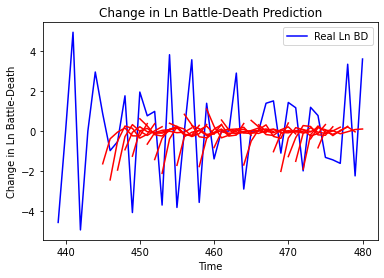

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Niger', 'country_id': 78, 'step': 't+1', 'mse': 3.584597861437357, 'mae': 1.6270134850990294, 'r2': 0.17250524395016686, 'tadda_score': 1.9489549144756315}
{'country': 'Niger', 'country_id': 78, 'step': 't+2', 'mse': 7.475219732486936, 'mae': 2.3250869018973477, 'r2': -0.9036381058392711, 'tadda_score': 2.916471535279508}
{'country': 'Niger', 'country_id': 78, 'step': 't+3', 'mse': 6.691417477413807, 'mae': 2.037598092874322, 'r2': -0.7276937002490087, 'tadda_score': 2.5876882016861766}
{'country': 'Niger', 'country_id': 78, 'step': 't+4', 'mse': 6.987085912915787, 'mae': 2.202053960478274, 'r2': -0.5399460321406115, 'tadda_score': 2.693321367418734}
{'country': 'Niger', 'country_id': 78, 'step': 't+5', 'mse': 8.098129134384441, 'mae': 2.294184715339181, 'r2': -0.47216544487638146, 'tadda_score': 2.7963488116623334}
{'country': 'Niger', 'country_id': 78, 'step': 't+6', 'mse': 7.642203411065462, 'mae': 2.12986784

Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5253 - val_loss: 1.2246
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5379 - val_loss: 1.2237
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5248 - val_loss: 1.2263
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5374 - val_loss: 1.2244
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5218 - val_loss: 1.2242
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5227 - val_loss: 1.2318
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5224 - val_loss: 1.2348
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5234 - val_loss: 1.2362
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5281 - val_loss: 1.2411
Epoch 68/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5249

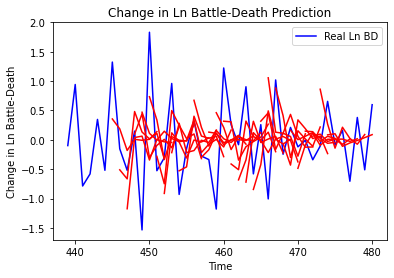

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Nigeria', 'country_id': 79, 'step': 't+1', 'mse': 0.7329796859710331, 'mae': 0.6401173867582419, 'r2': -0.2825400649913319, 'tadda_score': 0.7915155448316672}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+2', 'mse': 1.667507427173421, 'mae': 1.0959647527594039, 'r2': -2.0818688912034085, 'tadda_score': 1.5828292222081293}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+3', 'mse': 1.4620768402197262, 'mae': 0.9345298908569617, 'r2': -1.3863244781457214, 'tadda_score': 1.2847035499829254}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+4', 'mse': 1.6954393700818369, 'mae': 1.018045466423897, 'r2': -1.2791966266888442, 'tadda_score': 1.4357996863930105}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+5', 'mse': 1.165168546072944, 'mae': 0.8671833999982357, 'r2': -1.2758839019357193, 'tadda_score': 1.192802464393862}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+6', 'mse': 1.2598556076637948,

122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 55/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
122/122 [=

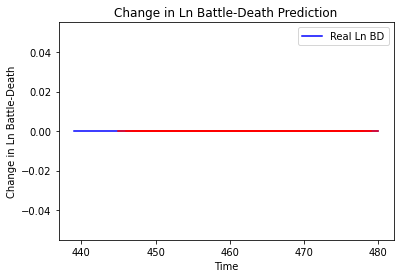

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Togo']
Building vanilla Model...
Model: "sequential_732"
____

122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
122/122 [=

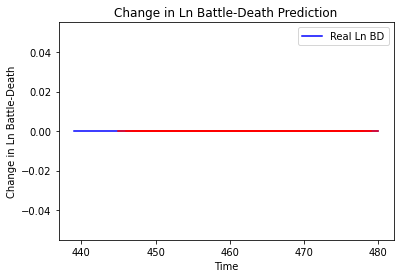

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Togo', 'country_id': 81, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Somalia']
Building vanilla Model...
Model: "sequential_733"
_________________________________________________________________
Layer (type)                 Output Shape             

122/122 [==============================] - 0s 2ms/step - loss: 2.5387 - val_loss: 0.3702
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 2.5573 - val_loss: 0.3718
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 2.5479 - val_loss: 0.3735
Epoch 66/100
122/122 [==============================] - 0s 3ms/step - loss: 2.5259 - val_loss: 0.3732
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 2.5109 - val_loss: 0.3710
Epoch 68/100
122/122 [==============================] - 0s 2ms/step - loss: 2.5547 - val_loss: 0.3740
Epoch 69/100
122/122 [==============================] - 0s 2ms/step - loss: 2.5163 - val_loss: 0.3713
Epoch 70/100
122/122 [==============================] - 0s 2ms/step - loss: 2.5256 - val_loss: 0.3736
Epoch 71/100
122/122 [==============================] - 0s 3ms/step - loss: 2.5343 - val_loss: 0.3722
Epoch 72/100
122/122 [==============================] - 0s 3ms/step - loss: 2.5434 - val_loss: 

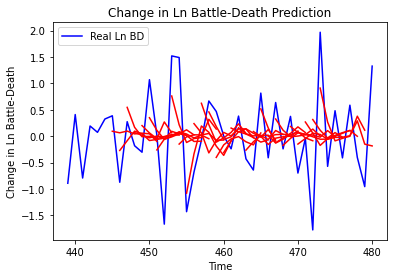

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Somalia', 'country_id': 120, 'step': 't+1', 'mse': 0.5669678130834777, 'mae': 0.5876171324964605, 'r2': 0.2557383932556957, 'tadda_score': 0.6901475632504863}
{'country': 'Somalia', 'country_id': 120, 'step': 't+2', 'mse': 1.4765216642873251, 'mae': 0.9366012519979005, 'r2': -0.5056839875374484, 'tadda_score': 1.178046084332816}
{'country': 'Somalia', 'country_id': 120, 'step': 't+3', 'mse': 1.348005621839944, 'mae': 0.8542758002350965, 'r2': -0.689032168253451, 'tadda_score': 1.0823719883432228}
{'country': 'Somalia', 'country_id': 120, 'step': 't+4', 'mse': 1.0063963713744901, 'mae': 0.806463668018984, 'r2': -0.45185719074854935, 'tadda_score': 0.9652581239321899}
{'country': 'Somalia', 'country_id': 120, 'step': 't+5', 'mse': 0.8685205714333453, 'mae': 0.6998535651309512, 'r2': -0.12663867414952068, 'tadda_score': 0.8447393954016984}
{'country': 'Somalia', 'country_id': 120, 'step': 't+6', 'mse': 1.0149472812

122/122 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 55/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
122/122 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
122/122 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
122/122 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
122/122 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
122/122 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
122/122 [=

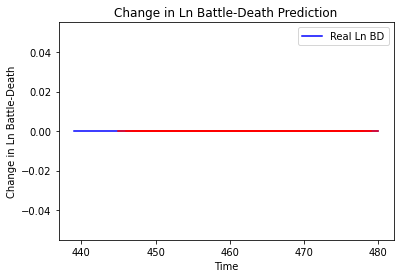

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Botswana', 'country_id': 154, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Burundi']
Building vanilla Model...
Model: "sequential_735"
_________________________________________________________________
Layer (type)       

122/122 [==============================] - 0s 2ms/step - loss: 1.9197 - val_loss: 1.6220
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 1.9197 - val_loss: 1.6212
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 1.9099 - val_loss: 1.6220
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 1.9189 - val_loss: 1.6213
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 1.9241 - val_loss: 1.6210
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 1.9082 - val_loss: 1.6232
Epoch 68/100
122/122 [==============================] - 0s 2ms/step - loss: 1.9181 - val_loss: 1.6190
Epoch 69/100
122/122 [==============================] - 0s 2ms/step - loss: 1.9133 - val_loss: 1.6205
Epoch 70/100
122/122 [==============================] - 0s 2ms/step - loss: 1.9140 - val_loss: 1.6197
Epoch 71/100
122/122 [==============================] - 0s 2ms/step - loss: 1.9052 - val_loss: 

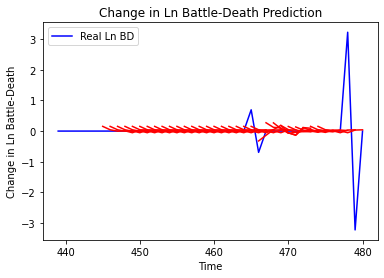

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burundi', 'country_id': 155, 'step': 't+1', 'mse': 0.03931809735811021, 'mae': 0.1802466453335492, 'r2': -0.22753202349993717, 'tadda_score': 0.1802466453335492}
{'country': 'Burundi', 'country_id': 155, 'step': 't+2', 'mse': 0.09133643112675151, 'mae': 0.2477871143541543, 'r2': -1.8515722187446353, 'tadda_score': 0.26086543537396273}
{'country': 'Burundi', 'country_id': 155, 'step': 't+3', 'mse': 0.08422532203761644, 'mae': 0.24181512631195864, 'r2': -1.629559590564544, 'tadda_score': 0.25102558669664543}
{'country': 'Burundi', 'country_id': 155, 'step': 't+4', 'mse': 0.07553030817538149, 'mae': 0.2382838553410578, 'r2': -1.3580966084304995, 'tadda_score': 0.24432491324561917}
{'country': 'Burundi', 'country_id': 155, 'step': 't+5', 'mse': 0.04367914443308053, 'mae': 0.14762775984623117, 'r2': -0.36368624509816416, 'tadda_score': 0.15076987432656766}
{'country': 'Burundi', 'country_id': 155, 'step': 't+6', 'mse

122/122 [==============================] - 0s 2ms/step - loss: 2.4026 - val_loss: 0.1853
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 2.4133 - val_loss: 0.1809
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 2.3848 - val_loss: 0.1845
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 2.3963 - val_loss: 0.1814
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 2.3936 - val_loss: 0.1825
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 2.3774 - val_loss: 0.1837
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 2.4060 - val_loss: 0.1848
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 2.3964 - val_loss: 0.1840
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 2.3758 - val_loss: 0.1829
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 2.3952 - val_loss: 

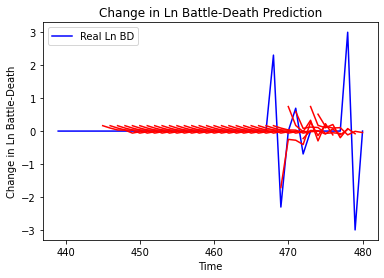

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Rwanda', 'country_id': 156, 'step': 't+1', 'mse': 0.23785729474345624, 'mae': 0.3021599324805991, 'r2': 0.3829742704315354, 'tadda_score': 0.3021599324805991}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+2', 'mse': 0.7652668637274792, 'mae': 0.5200545417530792, 'r2': -0.9851791613761687, 'tadda_score': 0.5810933060709096}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+3', 'mse': 0.6908266729345008, 'mae': 0.5626525375785081, 'r2': -1.4753000761524118, 'tadda_score': 0.6139468385320552}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+4', 'mse': 0.70323566171001, 'mae': 0.5830533076505605, 'r2': -0.9060917572849008, 'tadda_score': 0.5830533076505605}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+5', 'mse': 0.6866633461768922, 'mae': 0.42915144107547837, 'r2': -0.861173167746951, 'tadda_score': 0.4572242433012271}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+6', 'mse': 0.684890156141476

122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 55/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
122/122 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
122/122 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
122/122 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
122/122 [=

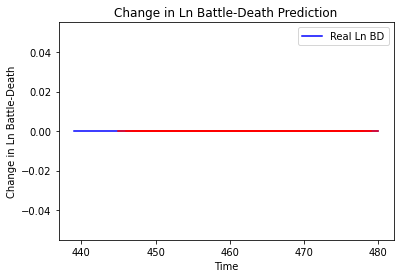

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zambia', 'country_id': 157, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Zimbabwe']
Building vanilla Model...
Model: "sequential_738"
_________________________________________________________________
Layer (type)                 Out

122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
122/122 [=

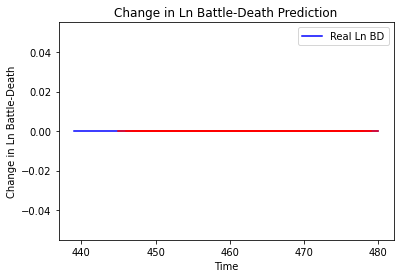

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Comoros']
Building vanilla Model...
Model: "sequential_739"
_________________________________________________________________
Layer (type)       

122/122 [==============================] - 0s 2ms/step - loss: 0.1251 - val_loss: 8.7843e-06
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1258 - val_loss: 4.7421e-06
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1248 - val_loss: 2.7550e-05
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1250 - val_loss: 2.6519e-06
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1251 - val_loss: 1.7746e-05
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1250 - val_loss: 1.0710e-04
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1251 - val_loss: 3.6556e-04
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1250 - val_loss: 2.6941e-05
Epoch 68/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1251 - val_loss: 5.3842e-06
Epoch 69/100
122/122 [==============================] - 0s 

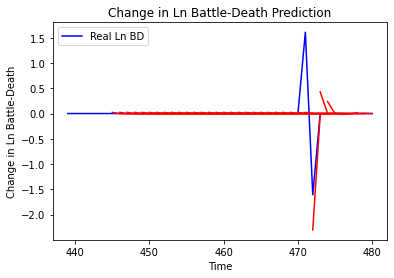

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Comoros', 'country_id': 159, 'step': 't+1', 'mse': 0.10842795147452548, 'mae': 0.11791640321413675, 'r2': 0.37210929095145584, 'tadda_score': 0.11791640321413675}
{'country': 'Comoros', 'country_id': 159, 'step': 't+2', 'mse': 0.404626976725526, 'mae': 0.2241465056756973, 'r2': -1.3431367637342992, 'tadda_score': 0.2384693845927556}
{'country': 'Comoros', 'country_id': 159, 'step': 't+3', 'mse': 0.38499648362967315, 'mae': 0.22285135889498786, 'r2': -1.229459394925727, 'tadda_score': 0.23057189041821555}
{'country': 'Comoros', 'country_id': 159, 'step': 't+4', 'mse': 0.27305086348565705, 'mae': 0.16863731703757442, 'r2': -2.271444906241187, 'tadda_score': 0.16863731703757442}
{'country': 'Comoros', 'country_id': 159, 'step': 't+5', 'mse': 0.273089712640656, 'mae': 0.16616829334794678, 'r2': -2.271910361170025, 'tadda_score': 0.16616829334794678}
{'country': 'Comoros', 'country_id': 159, 'step': 't+6', 'mse': 0.2

122/122 [==============================] - 0s 2ms/step - loss: 0.1375 - val_loss: 2.0856e-05
Epoch 57/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1380 - val_loss: 1.7971e-05
Epoch 58/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1371 - val_loss: 9.6955e-06
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1380 - val_loss: 8.9043e-04
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1374 - val_loss: 8.8331e-06
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1367 - val_loss: 3.7060e-05
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1367 - val_loss: 4.8043e-05
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1371 - val_loss: 8.2900e-06
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1367 - val_loss: 4.0391e-06
Epoch 65/100
122/122 [==============================] - 0s 

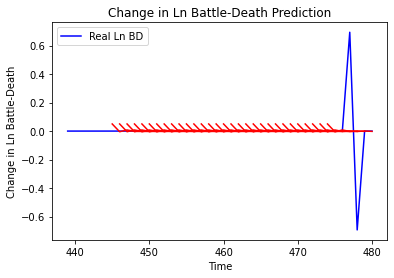

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Lesotho', 'country_id': 160, 'step': 't+1', 'mse': 0.0024944878239816504, 'mae': 0.04994484782218933, 'r2': 0.0, 'tadda_score': 0.04994484782218933}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+2', 'mse': 0.002056043093832796, 'mae': 0.045343611389398575, 'r2': 0.0, 'tadda_score': 0.045343611389398575}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+3', 'mse': 0.0028232736109023993, 'mae': 0.053134486079216, 'r2': 0.0, 'tadda_score': 0.053134486079216}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+4', 'mse': 0.002595122662205407, 'mae': 0.05094234645366669, 'r2': 0.0, 'tadda_score': 0.05094234645366669}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+5', 'mse': 0.0027794587963014955, 'mae': 0.0527205727994442, 'r2': 0.0, 'tadda_score': 0.0527205727994442}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+6', 'mse': 0.0028494360763269833, 'mae': 0.05338010936975479, 'r2': 0.0, 'tadda_s

122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
122/122 [=

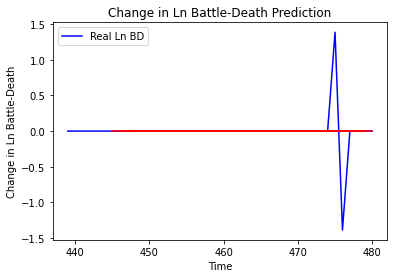

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Malawi', 'country_id': 161, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mozambique']
Building vanilla Model...
Model: "sequential_742"
_________________________________________________________________
Layer (type)                 O

Epoch 63/100
122/122 [==============================] - 0s 3ms/step - loss: 0.9900 - val_loss: 0.7064
Epoch 64/100
122/122 [==============================] - 0s 3ms/step - loss: 0.9717 - val_loss: 0.7032
Epoch 65/100
122/122 [==============================] - 0s 3ms/step - loss: 0.9444 - val_loss: 0.7064
Epoch 66/100
122/122 [==============================] - 0s 3ms/step - loss: 0.9692 - val_loss: 0.7057
Epoch 67/100
122/122 [==============================] - 0s 3ms/step - loss: 1.0004 - val_loss: 0.7035
Epoch 68/100
122/122 [==============================] - 0s 3ms/step - loss: 0.9575 - val_loss: 0.7008
Epoch 69/100
122/122 [==============================] - 0s 2ms/step - loss: 0.8984 - val_loss: 0.7023
Epoch 70/100
122/122 [==============================] - 0s 2ms/step - loss: 0.9916 - val_loss: 0.7042
Epoch 71/100
122/122 [==============================] - 0s 3ms/step - loss: 0.9551 - val_loss: 0.6998
Epoch 72/100
122/122 [==============================] - 0s 3ms/step - loss: 0.9820

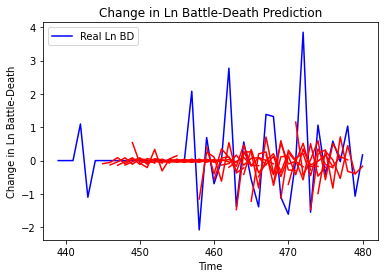

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mozambique', 'country_id': 162, 'step': 't+1', 'mse': 1.3772405648702393, 'mae': 0.7142096753867022, 'r2': 0.12475764518395305, 'tadda_score': 0.7931995246262901}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+2', 'mse': 2.5240452477720456, 'mae': 1.0777441363696632, 'r2': -0.3191962145777245, 'tadda_score': 1.2423091646198805}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+3', 'mse': 2.6902955439675913, 'mae': 1.1423677376505215, 'r2': -0.40571454475829927, 'tadda_score': 1.3252168209946633}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+4', 'mse': 2.9287147728333425, 'mae': 1.2307877217271888, 'r2': -0.9433703602200465, 'tadda_score': 1.5899920065739714}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+5', 'mse': 1.6474713864212596, 'mae': 0.8891230574180605, 'r2': -1.0115745396560283, 'tadda_score': 1.0776523988996864}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+6

121/121 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 55/100
121/121 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
121/121 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
121/121 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
121/121 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
121/121 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
121/121 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
121/121 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
121/121 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
121/121 [=

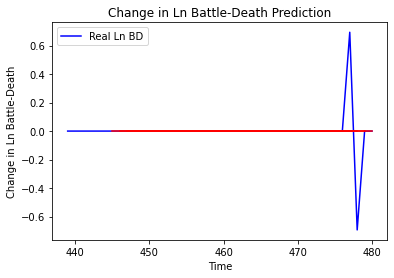

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Africa', 'country_id': 163, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Swaziland']
Building vanilla Model...
Model: "sequential_744"
_______________________________________________________

Epoch 58/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/1

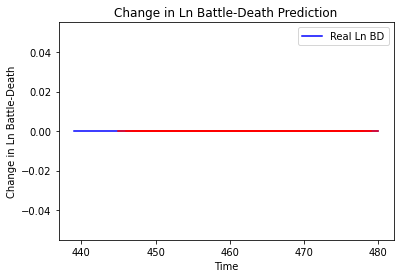

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Swaziland', 'country_id': 164, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Angola']
Building vanilla Model...
Model: "sequential_745"
_________________________________________________________________
Layer (type) 

122/122 [==============================] - 0s 2ms/step - loss: 3.2336 - val_loss: 0.0880
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 3.2248 - val_loss: 0.0880
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 3.2625 - val_loss: 0.0887
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 3.2342 - val_loss: 0.0891
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 3.2265 - val_loss: 0.0881
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 3.2534 - val_loss: 0.0888
Epoch 68/100
122/122 [==============================] - 0s 2ms/step - loss: 3.2543 - val_loss: 0.0884
Epoch 69/100
122/122 [==============================] - 0s 2ms/step - loss: 3.2425 - val_loss: 0.0882
Epoch 70/100
122/122 [==============================] - 0s 2ms/step - loss: 3.2513 - val_loss: 0.0880
Epoch 71/100
122/122 [==============================] - 0s 2ms/step - loss: 3.2221 - val_loss: 

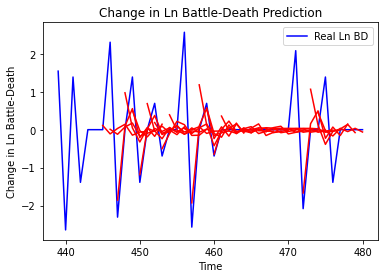

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Angola', 'country_id': 165, 'step': 't+1', 'mse': 0.7461338573744093, 'mae': 0.5326381190927865, 'r2': 0.4136521330990238, 'tadda_score': 0.5326381190927865}
{'country': 'Angola', 'country_id': 165, 'step': 't+2', 'mse': 2.4132844655328407, 'mae': 1.0588898521475039, 'r2': -0.8964749885091807, 'tadda_score': 1.2273997318557939}
{'country': 'Angola', 'country_id': 165, 'step': 't+3', 'mse': 1.2194539911560756, 'mae': 0.7868828581695565, 'r2': -0.3902927624402537, 'tadda_score': 0.818122854274989}
{'country': 'Angola', 'country_id': 165, 'step': 't+4', 'mse': 1.0848409732943631, 'mae': 0.7864894352832763, 'r2': -0.010681790917627776, 'tadda_score': 0.8019500575939148}
{'country': 'Angola', 'country_id': 165, 'step': 't+5', 'mse': 1.288401657612982, 'mae': 0.7792743042146875, 'r2': -0.3159078414693799, 'tadda_score': 0.8106856500144514}
{'country': 'Angola', 'country_id': 165, 'step': 't+6', 'mse': 1.60007292565205

122/122 [==============================] - 0s 2ms/step - loss: 1.8568 - val_loss: 0.2236
Epoch 59/100
122/122 [==============================] - 0s 3ms/step - loss: 1.8559 - val_loss: 0.2236
Epoch 60/100
122/122 [==============================] - 0s 3ms/step - loss: 1.8844 - val_loss: 0.2215
Epoch 61/100
122/122 [==============================] - 0s 3ms/step - loss: 1.8442 - val_loss: 0.2235
Epoch 62/100
122/122 [==============================] - 0s 3ms/step - loss: 1.8618 - val_loss: 0.2212
Epoch 63/100
122/122 [==============================] - 0s 3ms/step - loss: 1.8412 - val_loss: 0.2233
Epoch 64/100
122/122 [==============================] - 0s 3ms/step - loss: 1.8703 - val_loss: 0.2313
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 1.8661 - val_loss: 0.2247
Epoch 66/100
122/122 [==============================] - 0s 3ms/step - loss: 1.8652 - val_loss: 0.2244
Epoch 67/100
122/122 [==============================] - 0s 3ms/step - loss: 1.8637 - val_loss: 

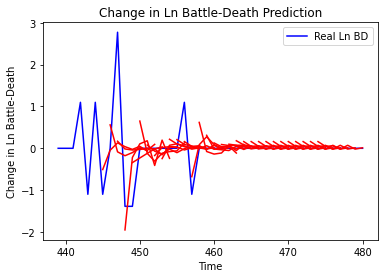

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo', 'country_id': 166, 'step': 't+1', 'mse': 0.3781966731033762, 'mae': 0.38276938721318743, 'r2': 0.24918707508463256, 'tadda_score': 0.38276938721318743}
{'country': 'Congo', 'country_id': 166, 'step': 't+2', 'mse': 1.1861654660989658, 'mae': 0.6608324731255772, 'r2': -0.5608305778001361, 'tadda_score': 0.7846969023212992}
{'country': 'Congo', 'country_id': 166, 'step': 't+3', 'mse': 0.9999730973361663, 'mae': 0.6218239003440159, 'r2': -0.6860119224842784, 'tadda_score': 0.7065400048117259}
{'country': 'Congo', 'country_id': 166, 'step': 't+4', 'mse': 0.8851916897694153, 'mae': 0.6107370931923806, 'r2': -0.27433003756277663, 'tadda_score': 0.686567938727182}
{'country': 'Congo', 'country_id': 166, 'step': 't+5', 'mse': 0.9148025143092002, 'mae': 0.595101491016191, 'r2': -0.5424094407665851, 'tadda_score': 0.67123688996041}
{'country': 'Congo', 'country_id': 166, 'step': 't+6', 'mse': 0.9177837404147059, 'm

122/122 [==============================] - 0s 2ms/step - loss: 2.9243 - val_loss: 3.3498
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 2.9214 - val_loss: 3.3531
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 2.9186 - val_loss: 3.3572
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 2.9146 - val_loss: 3.3593
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 2.9120 - val_loss: 3.3604
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 2.9103 - val_loss: 3.3570
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 2.9066 - val_loss: 3.3580
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 2.9013 - val_loss: 3.3594
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 2.9392 - val_loss: 3.3618
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 2.9058 - val_loss: 

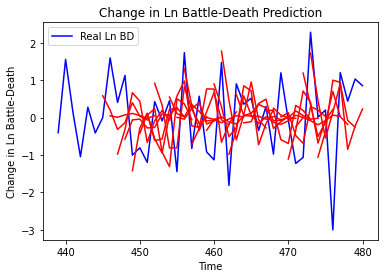

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+1', 'mse': 0.9982179946593597, 'mae': 0.8164495441262751, 'r2': 0.08795287780804051, 'tadda_score': 0.9998968429374029}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+2', 'mse': 3.3261486575144104, 'mae': 1.4891485697154907, 'r2': -1.3524236727284085, 'tadda_score': 1.966978559009702}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+3', 'mse': 2.684366255494092, 'mae': 1.3519317372795696, 'r2': -0.5562121816527363, 'tadda_score': 1.7616418057835854}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+4', 'mse': 3.4826659760471697, 'mae': 1.5421013566119572, 'r2': -0.9990292950842781, 'tadda_score': 2.0761441526078284}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+5', 'mse': 4.45388893669218, 'mae': 1.662558207056254, 'r2': -1.426224858883553, 'tadda_score': 2.300296118250817}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+6', 'mse'

122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 55/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
122/122 [=

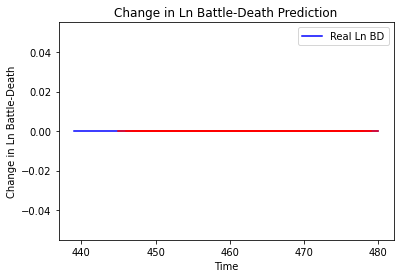

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Gabon', 'country_id': 169, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Namibia']
Building vanilla Model...
Model: "sequential_749"
_________________________________________________________________
Layer (type)                 Output Shap

121/121 [==============================] - 0s 2ms/step - loss: 0.1358 - val_loss: 1.8046e-05
Epoch 61/100
121/121 [==============================] - 0s 2ms/step - loss: 0.1400 - val_loss: 3.7723e-04
Epoch 62/100
121/121 [==============================] - 0s 2ms/step - loss: 0.1368 - val_loss: 1.1812e-05
Epoch 63/100
121/121 [==============================] - 0s 2ms/step - loss: 0.1371 - val_loss: 3.4052e-04
Epoch 64/100
121/121 [==============================] - 0s 2ms/step - loss: 0.1365 - val_loss: 2.4887e-04
Epoch 65/100
121/121 [==============================] - 0s 2ms/step - loss: 0.1367 - val_loss: 2.0442e-05
Epoch 66/100
121/121 [==============================] - 0s 2ms/step - loss: 0.1380 - val_loss: 8.8092e-04
Epoch 67/100
121/121 [==============================] - 0s 2ms/step - loss: 0.1420 - val_loss: 1.6116e-04
Epoch 68/100
121/121 [==============================] - 0s 2ms/step - loss: 0.1399 - val_loss: 4.1836e-05
Epoch 69/100
121/121 [==============================] - 0s 

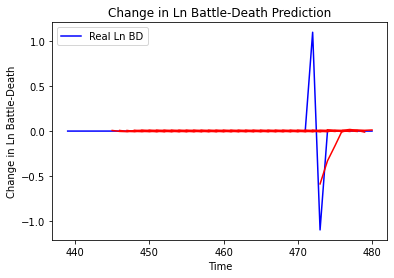

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Namibia', 'country_id': 170, 'step': 't+1', 'mse': 0.04848038589809807, 'mae': 0.06019372637093755, 'r2': 0.39748422503145664, 'tadda_score': 0.06019372637093755}
{'country': 'Namibia', 'country_id': 170, 'step': 't+2', 'mse': 0.10978306569784829, 'mae': 0.10734447827272806, 'r2': -0.36438742559507054, 'tadda_score': 0.10799541215432876}
{'country': 'Namibia', 'country_id': 170, 'step': 't+3', 'mse': 0.07958874880439004, 'mae': 0.07598357075525171, 'r2': -1.0464789587184393, 'tadda_score': 0.07608482244590022}
{'country': 'Namibia', 'country_id': 170, 'step': 't+4', 'mse': 0.07855843825226067, 'mae': 0.07659202872164891, 'r2': -1.019986409236847, 'tadda_score': 0.07659202872164891}
{'country': 'Namibia', 'country_id': 170, 'step': 't+5', 'mse': 0.05695526070595892, 'mae': 0.07541179628121701, 'r2': -0.46450025127972405, 'tadda_score': 0.07541179628121701}
{'country': 'Namibia', 'country_id': 170, 'step': 't+6', 

122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 55/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
122/122 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
122/122 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
122/122 [=

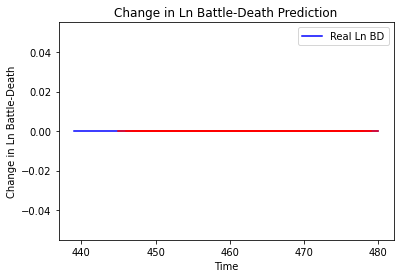

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Madagascar', 'country_id': 172, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mauritius']
Building vanilla Model...
Model: "sequential_751"
_________________________________________________________________
Lay

122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
122/122 [=

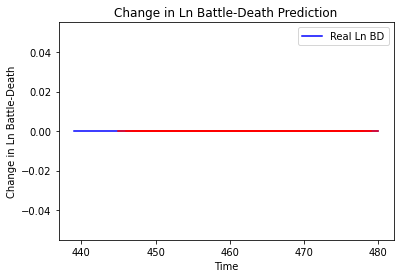

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritius', 'country_id': 173, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Seychelles']
Building vanilla Model...
Model: "sequential_752"
_________________________________________________________________
Layer (ty

122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
122/122 [=

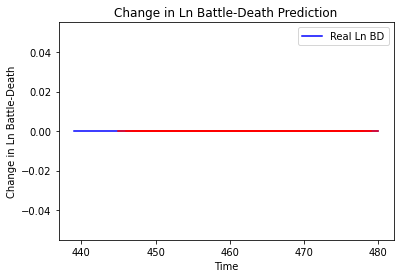

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Seychelles', 'country_id': 174, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Libya']
Building vanilla Model...
Model: "sequential_753"
_________________________________________________________________
Layer (

122/122 [==============================] - 0s 2ms/step - loss: 0.0315 - val_loss: 2.3068
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0315 - val_loss: 2.3067
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0315 - val_loss: 2.3064
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0314 - val_loss: 2.3064
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0315 - val_loss: 2.3065
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0315 - val_loss: 2.3067
Epoch 68/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0315 - val_loss: 2.3069
Epoch 69/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0315 - val_loss: 2.3072
Epoch 70/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0314 - val_loss: 2.3074
Epoch 71/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0315 - val_loss: 

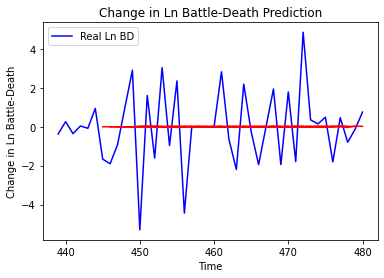

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Libya', 'country_id': 213, 'step': 't+1', 'mse': 4.845898341629516, 'mae': 1.688634846622314, 'r2': -5.418330032114227e-05, 'tadda_score': 1.6886358814315083}
{'country': 'Libya', 'country_id': 213, 'step': 't+2', 'mse': 5.417274574470211, 'mae': 1.7837089003505426, 'r2': -8.416932998134286e-06, 'tadda_score': 1.783715416570398}
{'country': 'Libya', 'country_id': 213, 'step': 't+3', 'mse': 7.422631898773201, 'mae': 2.108058279807989, 'r2': -1.2339074691114504e-05, 'tadda_score': 2.108064730545484}
{'country': 'Libya', 'country_id': 213, 'step': 't+4', 'mse': 5.8176069812265885, 'mae': 1.9751013885688609, 'r2': -0.005317400290772545, 'tadda_score': 1.9751175161023968}
{'country': 'Libya', 'country_id': 213, 'step': 't+5', 'mse': 7.381895720104356, 'mae': 2.2778118437210844, 'r2': -0.014529063568964773, 'tadda_score': 2.2841939282357586}
{'country': 'Libya', 'country_id': 213, 'step': 't+6', 'mse': 6.2420307464955

122/122 [==============================] - 0s 2ms/step - loss: 4.8757 - val_loss: 0.8590
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 4.9394 - val_loss: 0.8594
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 4.9102 - val_loss: 0.8556
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 4.9045 - val_loss: 0.8577
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 4.9229 - val_loss: 0.8660
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 4.9157 - val_loss: 0.8623
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 4.9053 - val_loss: 0.8621
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 4.9167 - val_loss: 0.8621
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 4.9614 - val_loss: 0.8612
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 4.9986 - val_loss: 

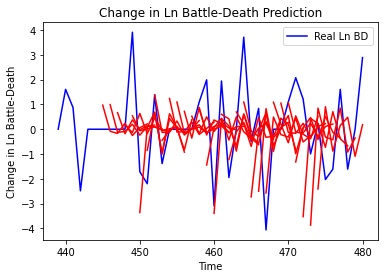

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Chad', 'country_id': 214, 'step': 't+1', 'mse': 3.8108870505177825, 'mae': 1.533522889616367, 'r2': -0.29823573804655346, 'tadda_score': 1.9066951807362604}
{'country': 'Chad', 'country_id': 214, 'step': 't+2', 'mse': 8.577718899187312, 'mae': 2.2610443211947198, 'r2': -1.0207826668416908, 'tadda_score': 2.9970790939881717}
{'country': 'Chad', 'country_id': 214, 'step': 't+3', 'mse': 10.419261429397386, 'mae': 2.551139635197325, 'r2': -0.9950018268865095, 'tadda_score': 3.2495567484219907}
{'country': 'Chad', 'country_id': 214, 'step': 't+4', 'mse': 14.230917467392722, 'mae': 3.1312188128952743, 'r2': -1.33372848760858, 'tadda_score': 4.077208938233511}
{'country': 'Chad', 'country_id': 214, 'step': 't+5', 'mse': 12.80055908669352, 'mae': 2.8757385509283213, 'r2': -1.6943664858814138, 'tadda_score': 3.7387607581487163}
{'country': 'Chad', 'country_id': 214, 'step': 't+6', 'mse': 12.380030713630237, 'mae': 2.7422

Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5707 - val_loss: 2.1166
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5727 - val_loss: 2.1184
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5687 - val_loss: 2.1141
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5754 - val_loss: 2.1131
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5789 - val_loss: 2.1108
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5757 - val_loss: 2.1151
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5703 - val_loss: 2.1167
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5723 - val_loss: 2.1135
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5662 - val_loss: 2.1116
Epoch 68/100
122/122 [==============================] - 0s 2ms/step - loss: 0.5646

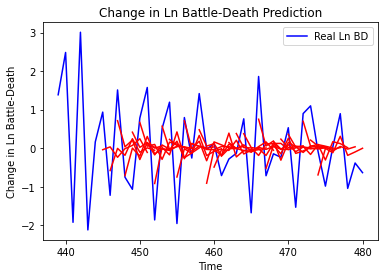

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Egypt', 'country_id': 222, 'step': 't+1', 'mse': 0.6825880528522913, 'mae': 0.6843951264944521, 'r2': 0.39435584520820466, 'tadda_score': 0.7525305208987839}
{'country': 'Egypt', 'country_id': 222, 'step': 't+2', 'mse': 1.5533823443944108, 'mae': 1.059463345472783, 'r2': -0.43638114331238387, 'tadda_score': 1.3086170987186534}
{'country': 'Egypt', 'country_id': 222, 'step': 't+3', 'mse': 1.385356260275789, 'mae': 0.9613391452902817, 'r2': -0.4937680948248995, 'tadda_score': 1.1992844088747363}
{'country': 'Egypt', 'country_id': 222, 'step': 't+4', 'mse': 1.3056872718942893, 'mae': 0.94779609151297, 'r2': -0.06000352673609699, 'tadda_score': 1.1108797324956774}
{'country': 'Egypt', 'country_id': 222, 'step': 't+5', 'mse': 1.5930339917319924, 'mae': 1.0745428825124108, 'r2': -0.3427933165094652, 'tadda_score': 1.3507491847827038}
{'country': 'Egypt', 'country_id': 222, 'step': 't+6', 'mse': 1.3568894323000968, 'ma

122/122 [==============================] - 0s 2ms/step - loss: 2.6277 - val_loss: 0.0073
Epoch 59/100
122/122 [==============================] - 0s 2ms/step - loss: 2.6309 - val_loss: 0.0013
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 2.6645 - val_loss: 0.0026
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 2.6377 - val_loss: 0.0018
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 2.6426 - val_loss: 0.0025
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 2.6289 - val_loss: 0.0067
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 2.6541 - val_loss: 0.0102
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 2.6432 - val_loss: 0.0048
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 2.6278 - val_loss: 0.0033
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 2.6273 - val_loss: 

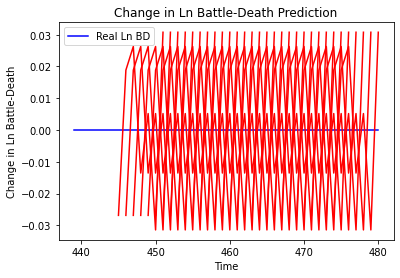

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Uganda', 'country_id': 235, 'step': 't+1', 'mse': 0.0007229477080771297, 'mae': 0.026887686923146248, 'r2': 0.0, 'tadda_score': 0.026887686923146248}
{'country': 'Uganda', 'country_id': 235, 'step': 't+2', 'mse': 6.460434194278941e-05, 'mae': 0.008037682622671127, 'r2': 0.0, 'tadda_score': 0.008037682622671127}
{'country': 'Uganda', 'country_id': 235, 'step': 't+3', 'mse': 0.0003329998095629727, 'mae': 0.018248282372951508, 'r2': 0.0, 'tadda_score': 0.018248282372951508}
{'country': 'Uganda', 'country_id': 235, 'step': 't+4', 'mse': 2.2011135540015575e-05, 'mae': 0.004691602662205696, 'r2': 0.0, 'tadda_score': 0.004691602662205696}
{'country': 'Uganda', 'country_id': 235, 'step': 't+5', 'mse': 8.077944785398004e-05, 'mae': 0.008987738750874996, 'r2': 0.0, 'tadda_score': 0.008987738750874996}
{'country': 'Uganda', 'country_id': 235, 'step': 't+6', 'mse': 0.0016365776757770872, 'mae': 0.04045463725924492, 'r2': 0.

122/122 [==============================] - 0s 2ms/step - loss: 0.1154 - val_loss: 1.6648
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1146 - val_loss: 1.6638
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1149 - val_loss: 1.6602
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1141 - val_loss: 1.6619
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1147 - val_loss: 1.6606
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1141 - val_loss: 1.6639
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1147 - val_loss: 1.6711
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1142 - val_loss: 1.6706
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1151 - val_loss: 1.6649
Epoch 68/100
122/122 [==============================] - 0s 2ms/step - loss: 0.1140 - val_loss: 

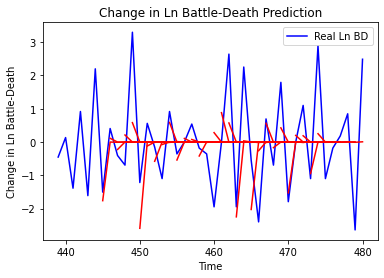

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Kenya', 'country_id': 237, 'step': 't+1', 'mse': 1.4788967165289313, 'mae': 0.901038601115508, 'r2': 0.28629097229450007, 'tadda_score': 0.9215853010827434}
{'country': 'Kenya', 'country_id': 237, 'step': 't+2', 'mse': 3.5237777042421894, 'mae': 1.5274117451481497, 'r2': -0.8459723931746563, 'tadda_score': 1.963640485673892}
{'country': 'Kenya', 'country_id': 237, 'step': 't+3', 'mse': 3.167194705501069, 'mae': 1.3861879483028996, 'r2': -0.450458459571772, 'tadda_score': 1.6570268924201277}
{'country': 'Kenya', 'country_id': 237, 'step': 't+4', 'mse': 3.9256841436094088, 'mae': 1.6204398961106945, 'r2': -0.3978816378935808, 'tadda_score': 1.8794962874293335}
{'country': 'Kenya', 'country_id': 237, 'step': 't+5', 'mse': 2.621426718224453, 'mae': 1.1890030592136178, 'r2': -0.7307401447158617, 'tadda_score': 1.4800718150489125}
{'country': 'Kenya', 'country_id': 237, 'step': 't+6', 'mse': 2.525653121801031, 'mae': 

93/93 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
93/93 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
93/93 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
93/93 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
93/93 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
93/93 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
93/93 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
93/93 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
93/93 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
93/93 [=====================

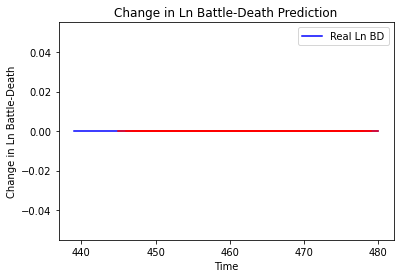

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tanzania', 'country_id': 242, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Morocco']
Building vanilla Model...
Model: "sequential_759"
_________________________________________________________________
Layer (type)       

122/122 [==============================] - 0s 2ms/step - loss: 0.0689 - val_loss: 5.1415e-06
Epoch 61/100
122/122 [==============================] - 0s 3ms/step - loss: 0.0710 - val_loss: 1.0754e-04
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0690 - val_loss: 2.2261e-06
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0690 - val_loss: 4.9300e-06
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0687 - val_loss: 2.6675e-06
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0686 - val_loss: 2.6262e-04
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0692 - val_loss: 1.0261e-04
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0689 - val_loss: 6.2216e-06
Epoch 68/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0690 - val_loss: 3.7625e-06
Epoch 69/100
122/122 [==============================] - 0s 

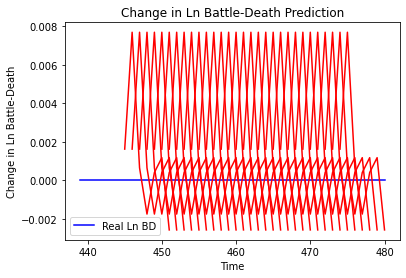

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Morocco', 'country_id': 243, 'step': 't+1', 'mse': 2.6387231087700302e-06, 'mae': 0.0016244146972894669, 'r2': 0.0, 'tadda_score': 0.0016244146972894669}
{'country': 'Morocco', 'country_id': 243, 'step': 't+2', 'mse': 8.658323866241047e-05, 'mae': 0.009305011481046677, 'r2': 0.0, 'tadda_score': 0.009305011481046677}
{'country': 'Morocco', 'country_id': 243, 'step': 't+3', 'mse': 9.920114423413173e-05, 'mae': 0.009959977120161057, 'r2': 0.0, 'tadda_score': 0.009959977120161057}
{'country': 'Morocco', 'country_id': 243, 'step': 't+4', 'mse': 6.754413749866187e-05, 'mae': 0.008218524046242237, 'r2': 0.0, 'tadda_score': 0.008218524046242237}
{'country': 'Morocco', 'country_id': 243, 'step': 't+5', 'mse': 9.010911636584741e-07, 'mae': 0.0009492582175880671, 'r2': 0.0, 'tadda_score': 0.0009492582175880671}
{'country': 'Morocco', 'country_id': 243, 'step': 't+6', 'mse': 4.5381346101578215e-06, 'mae': 0.0021302897948771

122/122 [==============================] - 0s 3ms/step - loss: 0.0625 - val_loss: 0.1171
Epoch 60/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0620 - val_loss: 0.1170
Epoch 61/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0637 - val_loss: 0.1171
Epoch 62/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0629 - val_loss: 0.1173
Epoch 63/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0634 - val_loss: 0.1178
Epoch 64/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0626 - val_loss: 0.1190
Epoch 65/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0632 - val_loss: 0.1187
Epoch 66/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0612 - val_loss: 0.1204
Epoch 67/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0622 - val_loss: 0.1212
Epoch 68/100
122/122 [==============================] - 0s 2ms/step - loss: 0.0650 - val_loss: 

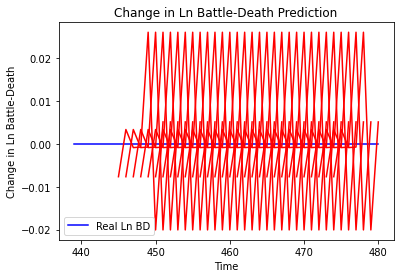

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritania', 'country_id': 244, 'step': 't+1', 'mse': 5.850311618175682e-05, 'mae': 0.007648732978850603, 'r2': 0.0, 'tadda_score': 0.007648732978850603}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+2', 'mse': 1.8224012349188357e-05, 'mae': 0.004268959164619446, 'r2': 0.0, 'tadda_score': 0.004268959164619446}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+3', 'mse': 2.6176932672164477e-05, 'mae': 0.005116339772939682, 'r2': 0.0, 'tadda_score': 0.005116339772939682}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+4', 'mse': 3.405378400861501e-05, 'mae': 0.005835562013089657, 'r2': 0.0, 'tadda_score': 0.005835562013089657}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+5', 'mse': 0.000285295273731459, 'mae': 0.016890686005353928, 'r2': 0.0, 'tadda_score': 0.016890686005353928}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+6', 'mse': 1.015734184095854e-05, 'mae': 0.003

19/19 [==============================] - 0s 4ms/step - loss: 2.9707 - val_loss: 1.0977
Epoch 61/100
19/19 [==============================] - 0s 4ms/step - loss: 2.9653 - val_loss: 1.1118
Epoch 62/100
19/19 [==============================] - 0s 4ms/step - loss: 2.9298 - val_loss: 1.1194
Epoch 63/100
19/19 [==============================] - 0s 4ms/step - loss: 2.9794 - val_loss: 1.1200
Epoch 64/100
19/19 [==============================] - 0s 5ms/step - loss: 2.8613 - val_loss: 1.1365
Epoch 65/100
19/19 [==============================] - 0s 4ms/step - loss: 2.8784 - val_loss: 1.1477
Epoch 66/100
19/19 [==============================] - 0s 4ms/step - loss: 2.9657 - val_loss: 1.1559
Epoch 67/100
19/19 [==============================] - 0s 4ms/step - loss: 2.9409 - val_loss: 1.1631
Epoch 68/100
19/19 [==============================] - 0s 4ms/step - loss: 2.9465 - val_loss: 1.1600
Epoch 69/100
19/19 [==============================] - 0s 4ms/step - loss: 2.9600 - val_loss: 1.1705
Epoch 70/100


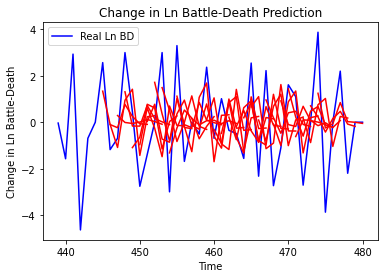

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sudan', 'country_id': 245, 'step': 't+1', 'mse': 2.6966018072803686, 'mae': 1.4600490912639625, 'r2': 0.32607604978133975, 'tadda_score': 1.5968155200127292}
{'country': 'Sudan', 'country_id': 245, 'step': 't+2', 'mse': 5.967100698729741, 'mae': 2.031465170598436, 'r2': -0.39851128476031605, 'tadda_score': 2.5423097909156573}
{'country': 'Sudan', 'country_id': 245, 'step': 't+3', 'mse': 4.5043199245893275, 'mae': 1.6953317236820762, 'r2': -0.16148973009781153, 'tadda_score': 1.9235634934822623}
{'country': 'Sudan', 'country_id': 245, 'step': 't+4', 'mse': 4.742972884869193, 'mae': 1.6313664542278146, 'r2': -0.42856721554245225, 'tadda_score': 2.0914645191669954}
{'country': 'Sudan', 'country_id': 245, 'step': 't+5', 'mse': 6.691092335866517, 'mae': 2.1900022143070084, 'r2': -0.27624409065587896, 'tadda_score': 2.742482619876085}
{'country': 'Sudan', 'country_id': 245, 'step': 't+6', 'mse': 6.782930265208415, 'ma

Epoch 60/100
19/19 [==============================] - 0s 4ms/step - loss: 6.1245 - val_loss: 3.9549
Epoch 61/100
19/19 [==============================] - 0s 4ms/step - loss: 6.0649 - val_loss: 3.9539
Epoch 62/100
19/19 [==============================] - 0s 4ms/step - loss: 5.9744 - val_loss: 3.9639
Epoch 63/100
19/19 [==============================] - 0s 4ms/step - loss: 6.0453 - val_loss: 3.9469
Epoch 64/100
19/19 [==============================] - 0s 4ms/step - loss: 6.0772 - val_loss: 3.9442
Epoch 65/100
19/19 [==============================] - 0s 4ms/step - loss: 6.0836 - val_loss: 3.9419
Epoch 66/100
19/19 [==============================] - 0s 4ms/step - loss: 6.0476 - val_loss: 3.9448
Epoch 67/100
19/19 [==============================] - 0s 4ms/step - loss: 5.9227 - val_loss: 3.9494
Epoch 68/100
19/19 [==============================] - 0s 4ms/step - loss: 6.0178 - val_loss: 3.9541
Epoch 69/100
19/19 [==============================] - 0s 4ms/step - loss: 5.9537 - val_loss: 3.9494


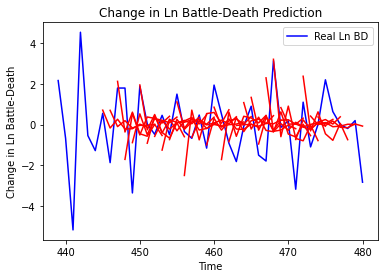

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Sudan', 'country_id': 246, 'step': 't+1', 'mse': 2.430558713745541, 'mae': 1.1210445303974503, 'r2': -0.09258145537543583, 'tadda_score': 1.494113435274159}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+2', 'mse': 4.841112298771749, 'mae': 1.6212996269345104, 'r2': -0.7914198778674273, 'tadda_score': 2.1076157381216505}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+3', 'mse': 6.211174227681009, 'mae': 2.0503676034552334, 'r2': -1.3755955559637503, 'tadda_score': 2.8133682556492565}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+4', 'mse': 5.725605502339855, 'mae': 1.9613304800972051, 'r2': -0.816380052985421, 'tadda_score': 2.552659588772526}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+5', 'mse': 4.6358983444663355, 'mae': 1.6685948769268926, 'r2': -0.8379045403081, 'tadda_score': 2.158572755259031}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+6', 'm

In [42]:
np.random.seed(1)
tf.random.set_seed(1)
model = Sequential()
summary_model(dataset=df,
              modelname = "Vanilla",
              pred_africa=True,
              period=period_test, 
              epochs=100, 
              batch_size=2, 
              look_back=6, 
              look_forward=7,
              num_neurons=6, 
              val_split=0.2)

['Cape Verde']
Building vanilla Model...
Model: "sequential_764"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_748 (LSTM)              (None, 6)                 192       
_________________________________________________________________
dropout_1496 (Dropout)       (None, 6)                 0         
_________________________________________________________________
dense_1496 (Dense)           (None, 6)                 42        
_________________________________________________________________
dropout_1497 (Dropout)       (None, 6)                 0         
_________________________________________________________________
dense_1497 (Dense)           (None, 7)                 49        
Total params: 283
Trainable params: 283
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
8/8 [==============================] - 0s 32ms/step - loss: 0.0000e

8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 77/100
8/8 [==============================] - 0s 5ms/

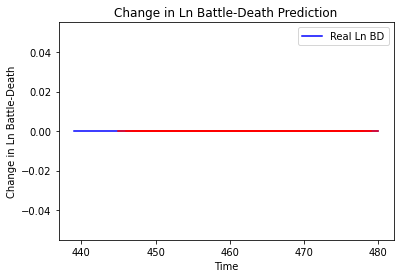

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
["Cote d'Ivoire"]
Building vanilla Model...
Model: "sequential_765"
_________________________________________________________________
Layer 

8/8 [==============================] - 0s 5ms/step - loss: 0.5575 - val_loss: 0.2831
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5542 - val_loss: 0.2829
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5571 - val_loss: 0.2828
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5505 - val_loss: 0.2827
Epoch 69/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5508 - val_loss: 0.2826
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5505 - val_loss: 0.2826
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5523 - val_loss: 0.2826
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5539 - val_loss: 0.2824
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5523 - val_loss: 0.2825
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5575 - val_loss: 0.2825
Epoch 75/100
8/8 [===============

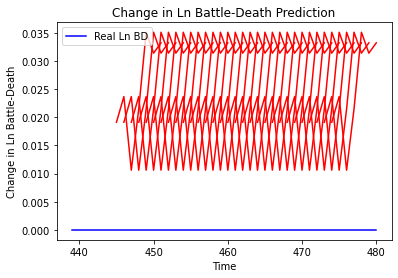

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+1', 'mse': 0.0003654133126088782, 'mae': 0.019115786999464035, 'r2': 0.0, 'tadda_score': 0.019115786999464035}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+2', 'mse': 0.0018306566446951167, 'mae': 0.04278617352247238, 'r2': 0.0, 'tadda_score': 0.04278617352247238}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+3', 'mse': 0.002850792836179075, 'mae': 0.053392816334962845, 'r2': 0.0, 'tadda_score': 0.053392816334962845}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+4', 'mse': 0.005602425530831789, 'mae': 0.07484935224056244, 'r2': 0.0, 'tadda_score': 0.07484935224056244}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+5', 'mse': 0.0074424622574662536, 'mae': 0.08626970648765564, 'r2': 0.0, 'tadda_score': 0.08626970648765564}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+6', 'mse': 0.013841782490558785, 'mae': 0.1

Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
8/8 [==============================] - 0s 11ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
8/8 [===========================

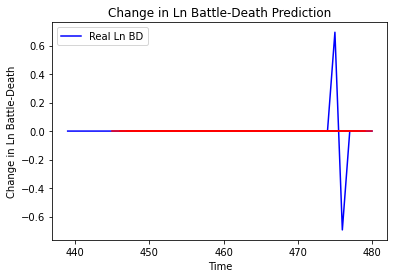

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ghana', 'country_id': 42, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Liberia']
Building vanilla Model...
Model: "sequential_767"
_________________________________________________________________
Layer (type)                 Output Shape      

8/8 [==============================] - 0s 5ms/step - loss: 1.2100 - val_loss: 6.3204e-04
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 1.2082 - val_loss: 6.4781e-04
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 1.2058 - val_loss: 4.8464e-04
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 1.2096 - val_loss: 5.5896e-04
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 1.2083 - val_loss: 4.6210e-04
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 1.1986 - val_loss: 4.1191e-04
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 1.2070 - val_loss: 3.6190e-04
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 1.1987 - val_loss: 3.3799e-04
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 1.1944 - val_loss: 3.8636e-04
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 1.2113 - val_loss: 4.39

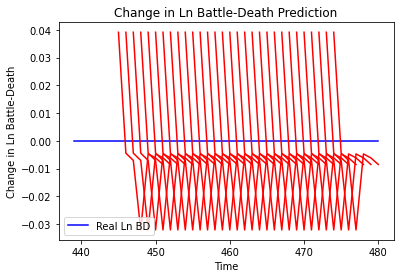

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Liberia', 'country_id': 43, 'step': 't+1', 'mse': 0.0015302094230013191, 'mae': 0.03911789134144783, 'r2': 0.0, 'tadda_score': 0.03911789134144783}
{'country': 'Liberia', 'country_id': 43, 'step': 't+2', 'mse': 0.001203855694998035, 'mae': 0.03469662368297577, 'r2': 0.0, 'tadda_score': 0.03469662368297577}
{'country': 'Liberia', 'country_id': 43, 'step': 't+3', 'mse': 0.0007650088896971191, 'mae': 0.027658794075250626, 'r2': 0.0, 'tadda_score': 0.027658794075250626}
{'country': 'Liberia', 'country_id': 43, 'step': 't+4', 'mse': 1.9418954854813486e-05, 'mae': 0.004406694322824478, 'r2': 0.0, 'tadda_score': 0.004406694322824478}
{'country': 'Liberia', 'country_id': 43, 'step': 't+5', 'mse': 2.1945394713016606e-05, 'mae': 0.0046845912002027035, 'r2': 0.0, 'tadda_score': 0.0046845912002027035}
{'country': 'Liberia', 'country_id': 43, 'step': 't+6', 'mse': 0.0001166812889010771, 'mae': 0.010801911354064941, 'r2': 0.0

8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
8/8 [==============================] - 0s 5ms/

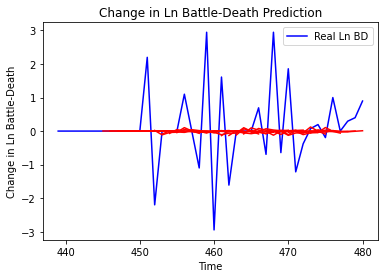

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+1', 'mse': 1.6742776543631133, 'mae': 0.8335248412330749, 'r2': -0.015278527382594831, 'tadda_score': 0.8465746639916477}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+2', 'mse': 1.2153790525381603, 'mae': 0.7374995573037526, 'r2': -0.027045985543387108, 'tadda_score': 0.749499747397866}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+3', 'mse': 2.079107497536221, 'mae': 0.9197378957385883, 'r2': -0.042883405759973625, 'tadda_score': 0.9401895886028871}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+4', 'mse': 2.449831263009633, 'mae': 1.0383192531516663, 'r2': -0.10361105329287468, 'tadda_score': 1.069929188651394}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+5', 'mse': 2.3406549435409576, 'mae': 0.950955364773219, 'r2': -0.12284161414109773, 'tadda_score': 0.968839185729171}
{'country': 'Burkina Faso', 'country_id': 47, 'step

8/8 [==============================] - 0s 5ms/step - loss: 0.2639 - val_loss: 1.5895e-05
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.2623 - val_loss: 2.8192e-05
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.2645 - val_loss: 3.5787e-05
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.2637 - val_loss: 1.9939e-05
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.2615 - val_loss: 2.6064e-05
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.2618 - val_loss: 3.5931e-05
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.2638 - val_loss: 4.9544e-05
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.2635 - val_loss: 3.6411e-05
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.2637 - val_loss: 1.6376e-05
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.2621 - val_loss: 8.93

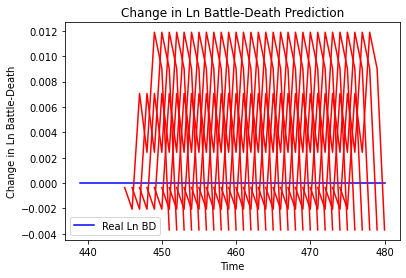

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea', 'country_id': 48, 'step': 't+1', 'mse': 1.2725368764288092e-07, 'mae': 0.00035672634840011597, 'r2': 0.0, 'tadda_score': 0.00035672634840011597}
{'country': 'Guinea', 'country_id': 48, 'step': 't+2', 'mse': 5.861492604162177e-06, 'mae': 0.002421051962301135, 'r2': 0.0, 'tadda_score': 0.002421051962301135}
{'country': 'Guinea', 'country_id': 48, 'step': 't+3', 'mse': 2.154996640538545e-05, 'mae': 0.004642194136977196, 'r2': 0.0, 'tadda_score': 0.004642194136977196}
{'country': 'Guinea', 'country_id': 48, 'step': 't+4', 'mse': 4.99916203730447e-05, 'mae': 0.00707047525793314, 'r2': 0.0, 'tadda_score': 0.00707047525793314}
{'country': 'Guinea', 'country_id': 48, 'step': 't+5', 'mse': 0.000442368606096491, 'mae': 0.021032560616731644, 'r2': 0.0, 'tadda_score': 0.021032560616731644}
{'country': 'Guinea', 'country_id': 48, 'step': 't+6', 'mse': 0.0009035834864556946, 'mae': 0.03005966544151306, 'r2': 0.0, 'ta

8/8 [==============================] - 0s 5ms/step - loss: 0.6762 - val_loss: 6.7300e-05
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.6657 - val_loss: 7.9779e-05
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.6614 - val_loss: 1.4761e-04
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.6632 - val_loss: 2.2242e-04
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.6757 - val_loss: 2.0751e-04
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.6649 - val_loss: 2.5741e-04
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.6803 - val_loss: 1.6330e-04
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.6626 - val_loss: 1.3514e-04
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.6619 - val_loss: 1.4835e-04
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.6649 - val_loss: 1.12

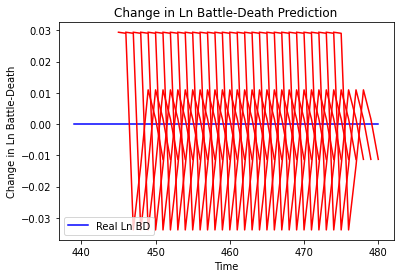

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+1', 'mse': 0.0008646346178133868, 'mae': 0.029404670000076294, 'r2': 0.0, 'tadda_score': 0.029404670000076294}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+2', 'mse': 0.0034193146070205516, 'mae': 0.05847490578889847, 'r2': 0.0, 'tadda_score': 0.05847490578889847}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+3', 'mse': 0.0006046771024049852, 'mae': 0.024590183049440384, 'r2': 0.0, 'tadda_score': 0.024590183049440384}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+4', 'mse': 0.0001267554511352742, 'mae': 0.011258572340011597, 'r2': 0.0, 'tadda_score': 0.011258572340011597}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+5', 'mse': 4.697452703489313e-05, 'mae': 0.006853796541690826, 'r2': 0.0, 'tadda_score': 0.006853796541690826}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+6', 'mse': 2.6977345435872692e-05, 'm

8/8 [==============================] - 0s 5ms/step - loss: 1.2967 - val_loss: 3.0232
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 1.2986 - val_loss: 3.0221
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 1.2951 - val_loss: 3.0211
Epoch 64/100
8/8 [==============================] - 0s 7ms/step - loss: 1.2943 - val_loss: 3.0200
Epoch 65/100
8/8 [==============================] - 0s 7ms/step - loss: 1.2933 - val_loss: 3.0190
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 1.2907 - val_loss: 3.0173
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 1.3019 - val_loss: 3.0161
Epoch 68/100
8/8 [==============================] - 0s 7ms/step - loss: 1.2762 - val_loss: 3.0148
Epoch 69/100
8/8 [==============================] - 0s 7ms/step - loss: 1.2892 - val_loss: 3.0145
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 1.2968 - val_loss: 3.0141
Epoch 71/100
8/8 [===============

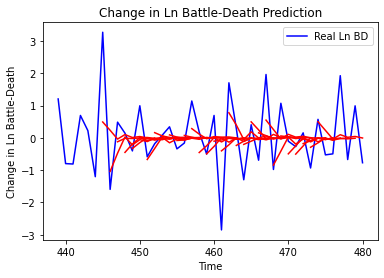

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mali', 'country_id': 50, 'step': 't+1', 'mse': 0.8217763424289571, 'mae': 0.6416827983188971, 'r2': 0.34904434105741766, 'tadda_score': 0.7062031017272019}
{'country': 'Mali', 'country_id': 50, 'step': 't+2', 'mse': 1.6446547502468922, 'mae': 0.9995689358038166, 'r2': -0.6987094590298224, 'tadda_score': 1.3201556651018522}
{'country': 'Mali', 'country_id': 50, 'step': 't+3', 'mse': 1.4842920550928531, 'mae': 1.0203606653654151, 'r2': -0.3074237458255311, 'tadda_score': 1.3219462527278631}
{'country': 'Mali', 'country_id': 50, 'step': 't+4', 'mse': 2.1841994071586845, 'mae': 1.2374776797822904, 'r2': -0.4605766086332663, 'tadda_score': 1.6031659622820011}
{'country': 'Mali', 'country_id': 50, 'step': 't+5', 'mse': 1.788642459393962, 'mae': 1.0929430411716332, 'r2': -0.6518968023516487, 'tadda_score': 1.3680476958761645}
{'country': 'Mali', 'country_id': 50, 'step': 't+6', 'mse': 2.035733482353112, 'mae': 1.169373

8/8 [==============================] - 0s 5ms/step - loss: 1.6346 - val_loss: 0.4296
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 1.6422 - val_loss: 0.4302
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 1.6555 - val_loss: 0.4307
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 1.6536 - val_loss: 0.4305
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 1.6348 - val_loss: 0.4302
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 1.6465 - val_loss: 0.4303
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 1.6353 - val_loss: 0.4304
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 1.6419 - val_loss: 0.4297
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 1.6288 - val_loss: 0.4294
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 1.6544 - val_loss: 0.4292
Epoch 71/100
8/8 [===============

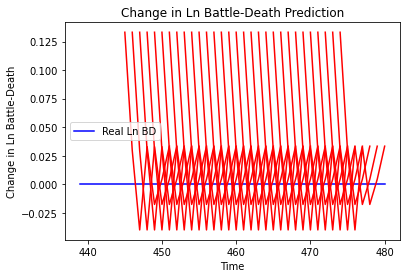

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Senegal', 'country_id': 52, 'step': 't+1', 'mse': 0.01774264219012256, 'mae': 0.1332015097141266, 'r2': 0.0, 'tadda_score': 0.1332015097141266}
{'country': 'Senegal', 'country_id': 52, 'step': 't+2', 'mse': 0.02646344432389558, 'mae': 0.1626758873462677, 'r2': 0.0, 'tadda_score': 0.1626758873462677}
{'country': 'Senegal', 'country_id': 52, 'step': 't+3', 'mse': 0.01503304286241397, 'mae': 0.12260930985212326, 'r2': 0.0, 'tadda_score': 0.12260930985212326}
{'country': 'Senegal', 'country_id': 52, 'step': 't+4', 'mse': 0.02418236163791576, 'mae': 0.15550678968429565, 'r2': 0.0, 'tadda_score': 0.15550678968429565}
{'country': 'Senegal', 'country_id': 52, 'step': 't+5', 'mse': 0.011729843865639966, 'mae': 0.10830440372228622, 'r2': 0.0, 'tadda_score': 0.10830440372228622}
{'country': 'Senegal', 'country_id': 52, 'step': 't+6', 'mse': 0.012688508334336712, 'mae': 0.1126432791352272, 'r2': 0.0, 'tadda_score': 0.112643

8/8 [==============================] - 0s 5ms/step - loss: 2.1792 - val_loss: 6.4911e-04
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 2.1721 - val_loss: 6.0902e-04
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 2.1611 - val_loss: 6.4550e-04
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 2.1631 - val_loss: 7.8765e-04
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 2.1741 - val_loss: 8.6490e-04
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 2.1532 - val_loss: 9.9689e-04
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 2.1710 - val_loss: 0.0010
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 2.1567 - val_loss: 8.8565e-04
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 2.1598 - val_loss: 5.9562e-04
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 2.1491 - val_loss: 4.7813e-

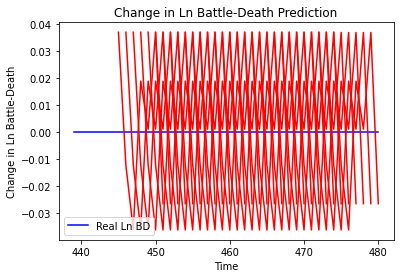

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+1', 'mse': 0.0013615202857276132, 'mae': 0.03689878433942795, 'r2': 0.0, 'tadda_score': 0.03689878433942795}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+2', 'mse': 0.0006095762498455372, 'mae': 0.024689598008990288, 'r2': 0.0, 'tadda_score': 0.024689598008990288}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+3', 'mse': 0.00013145980701529184, 'mae': 0.011465592309832573, 'r2': 0.0, 'tadda_score': 0.011465592309832573}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+4', 'mse': 5.426651398871343e-05, 'mae': 0.00736658088862896, 'r2': 0.0, 'tadda_score': 0.00736658088862896}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+5', 'mse': 0.00042666513743407075, 'mae': 0.02065587416291237, 'r2': 0.0, 'tadda_score': 0.02065587416291237}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+6', 'mse': 0.0033037084332252636, 'mae': 0.05

Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
8/8 [============================

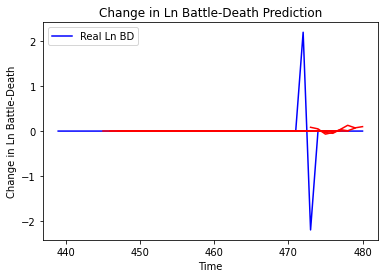

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'The Gambia', 'country_id': 54, 'step': 't+1', 'mse': 0.3344635006101058, 'mae': 0.14996411150983358, 'r2': -0.03918075081110084, 'tadda_score': 0.1527766746410865}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+2', 'mse': 0.3206260668255155, 'mae': 0.15051594397715115, 'r2': 0.00381226577617777, 'tadda_score': 0.15051594397715115}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+3', 'mse': 0.16120023594117155, 'mae': 0.07751101607477359, 'r2': -0.03624223256999781, 'tadda_score': 0.07751101607477359}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+4', 'mse': 0.16098918190446462, 'mae': 0.0752661927729417, 'r2': -0.03488551553473296, 'tadda_score': 0.0752661927729417}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+5', 'mse': 0.16154135505451395, 'mae': 0.07832870462929896, 'r2': -0.0384350459335665, 'tadda_score': 0.07832870462929896}
{'country': 'The Gambia', 'country_id': 54, 'step'

8/8 [==============================] - 0s 7ms/step - loss: 0.6419 - val_loss: 1.0615e-04
Epoch 59/100
8/8 [==============================] - 0s 7ms/step - loss: 0.6386 - val_loss: 1.2549e-04
Epoch 60/100
8/8 [==============================] - 0s 7ms/step - loss: 0.6376 - val_loss: 1.1857e-04
Epoch 61/100
8/8 [==============================] - 0s 7ms/step - loss: 0.6389 - val_loss: 1.2399e-04
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.6339 - val_loss: 1.2839e-04
Epoch 63/100
8/8 [==============================] - 0s 7ms/step - loss: 0.6377 - val_loss: 8.0340e-05
Epoch 64/100
8/8 [==============================] - 0s 7ms/step - loss: 0.6384 - val_loss: 4.9734e-05
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 0.6335 - val_loss: 4.2478e-05
Epoch 66/100
8/8 [==============================] - 0s 7ms/step - loss: 0.6339 - val_loss: 5.6747e-05
Epoch 67/100
8/8 [==============================] - 0s 7ms/step - loss: 0.6395 - val_loss: 1.19

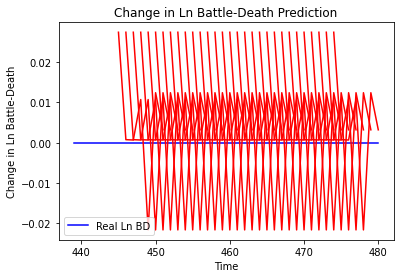

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Djibouti', 'country_id': 55, 'step': 't+1', 'mse': 0.0007556145535676656, 'mae': 0.02748844400048256, 'r2': 0.0, 'tadda_score': 0.02748844400048256}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+2', 'mse': 0.0007971972176405752, 'mae': 0.028234681114554405, 'r2': 0.0, 'tadda_score': 0.028234681114554405}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+3', 'mse': 0.0008349926083981579, 'mae': 0.028896238654851913, 'r2': 0.0, 'tadda_score': 0.028896238654851913}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+4', 'mse': 0.001570625740665632, 'mae': 0.03963112086057663, 'r2': 0.0, 'tadda_score': 0.03963112086057663}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+5', 'mse': 0.0002945858666426743, 'mae': 0.017163503915071487, 'r2': 0.0, 'tadda_score': 0.017163503915071487}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+6', 'mse': 0.0008759554642279732, 'mae': 0.029596544802188873, 'r2': 0

7/7 [==============================] - 0s 7ms/step - loss: 1.9668 - val_loss: 0.0298
Epoch 62/100
7/7 [==============================] - 0s 7ms/step - loss: 2.0049 - val_loss: 0.0298
Epoch 63/100
7/7 [==============================] - 0s 6ms/step - loss: 1.9760 - val_loss: 0.0299
Epoch 64/100
7/7 [==============================] - 0s 7ms/step - loss: 1.9797 - val_loss: 0.0299
Epoch 65/100
7/7 [==============================] - 0s 7ms/step - loss: 1.9674 - val_loss: 0.0300
Epoch 66/100
7/7 [==============================] - 0s 7ms/step - loss: 2.0071 - val_loss: 0.0299
Epoch 67/100
7/7 [==============================] - 0s 7ms/step - loss: 1.9953 - val_loss: 0.0298
Epoch 68/100
7/7 [==============================] - 0s 6ms/step - loss: 1.9715 - val_loss: 0.0298
Epoch 69/100
7/7 [==============================] - 0s 6ms/step - loss: 1.9703 - val_loss: 0.0299
Epoch 70/100
7/7 [==============================] - 0s 6ms/step - loss: 1.9736 - val_loss: 0.0298
Epoch 71/100
7/7 [===============

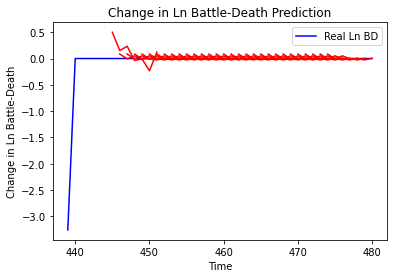

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Eritrea', 'country_id': 56, 'step': 't+1', 'mse': 0.015404980515448889, 'mae': 0.09940346429745356, 'r2': 0.0, 'tadda_score': 0.09940346429745356}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+2', 'mse': 0.0202450425211299, 'mae': 0.09875291312734286, 'r2': 0.0, 'tadda_score': 0.09875291312734286}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+3', 'mse': 0.04266986374108954, 'mae': 0.1561331942677498, 'r2': 0.0, 'tadda_score': 0.1561331942677498}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+4', 'mse': 0.03868218943746558, 'mae': 0.14760709380110104, 'r2': 0.0, 'tadda_score': 0.14760709380110104}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+5', 'mse': 0.03190763852640488, 'mae': 0.14775300770998, 'r2': 0.0, 'tadda_score': 0.14775300770998}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+6', 'mse': 0.017051803918437525, 'mae': 0.11425290008385976, 'r2': 0.0, 'tadda_score': 0.1142529000

Epoch 62/100
7/7 [==============================] - 0s 6ms/step - loss: 4.6130 - val_loss: 2.6407
Epoch 63/100
7/7 [==============================] - 0s 5ms/step - loss: 4.6461 - val_loss: 2.6386
Epoch 64/100
7/7 [==============================] - 0s 6ms/step - loss: 4.6328 - val_loss: 2.6369
Epoch 65/100
7/7 [==============================] - 0s 6ms/step - loss: 4.6213 - val_loss: 2.6360
Epoch 66/100
7/7 [==============================] - 0s 6ms/step - loss: 4.6445 - val_loss: 2.6349
Epoch 67/100
7/7 [==============================] - 0s 5ms/step - loss: 4.6362 - val_loss: 2.6334
Epoch 68/100
7/7 [==============================] - 0s 5ms/step - loss: 4.6213 - val_loss: 2.6319
Epoch 69/100
7/7 [==============================] - 0s 6ms/step - loss: 4.5942 - val_loss: 2.6311
Epoch 70/100
7/7 [==============================] - 0s 6ms/step - loss: 4.6029 - val_loss: 2.6299
Epoch 71/100
7/7 [==============================] - 0s 5ms/step - loss: 4.6336 - val_loss: 2.6287
Epoch 72/100
7/7 [==

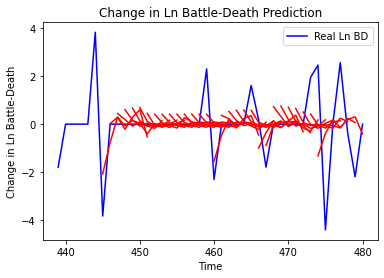

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+1', 'mse': 1.1137912890589732, 'mae': 0.8003056275214757, 'r2': 0.1835817869728381, 'tadda_score': 0.8776037163899347}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+2', 'mse': 3.5948680862411573, 'mae': 1.3596330452642547, 'r2': -0.8017261674087979, 'tadda_score': 1.5266515035114394}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+3', 'mse': 3.6149327988703495, 'mae': 1.3562955507319876, 'r2': -0.8117824801630591, 'tadda_score': 1.5474532751919539}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+4', 'mse': 3.806833253764687, 'mae': 1.3804148255469113, 'r2': -0.9079618288418319, 'tadda_score': 1.5812590160649727}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+5', 'mse': 2.9384739704839347, 'mae': 1.1201448349835184, 'r2': -0.4727454020173387, 'tadda_score': 1.2420830784918573}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+6', 'mse': 2.439675591

8/8 [==============================] - 0s 5ms/step - loss: 0.9221 - val_loss: 0.9995
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.9282 - val_loss: 0.9993
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.9247 - val_loss: 0.9994
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.9334 - val_loss: 0.9991
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.9233 - val_loss: 0.9989
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.9250 - val_loss: 0.9987
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.9193 - val_loss: 0.9984
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.9320 - val_loss: 0.9984
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.9229 - val_loss: 0.9985
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.9209 - val_loss: 0.9982
Epoch 71/100
8/8 [===============

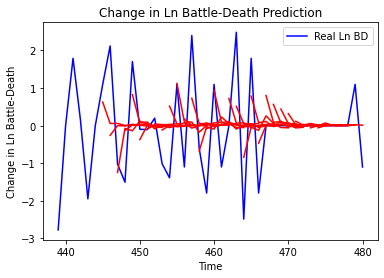

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Algeria', 'country_id': 67, 'step': 't+1', 'mse': 1.0984562877009116, 'mae': 0.7894407411615091, 'r2': 0.3112562618526299, 'tadda_score': 0.8225962047974306}
{'country': 'Algeria', 'country_id': 67, 'step': 't+2', 'mse': 2.4500951893280627, 'mae': 1.1738432938477772, 'r2': -0.454752962809313, 'tadda_score': 1.441037008625406}
{'country': 'Algeria', 'country_id': 67, 'step': 't+3', 'mse': 2.6985877577875397, 'mae': 1.2798833767221383, 'r2': -0.5043408807353542, 'tadda_score': 1.571995086436074}
{'country': 'Algeria', 'country_id': 67, 'step': 't+4', 'mse': 2.811497032521861, 'mae': 1.2725020776634441, 'r2': -0.37717978496464655, 'tadda_score': 1.518089179738862}
{'country': 'Algeria', 'country_id': 67, 'step': 't+5', 'mse': 1.9958926492687163, 'mae': 1.0362609045537645, 'r2': -0.4830854264933009, 'tadda_score': 1.2359729232224161}
{'country': 'Algeria', 'country_id': 67, 'step': 't+6', 'mse': 2.1306515892228366, 

Epoch 61/100
8/8 [==============================] - 0s 8ms/step - loss: 0.1885 - val_loss: 1.4639
Epoch 62/100
8/8 [==============================] - 0s 7ms/step - loss: 0.1868 - val_loss: 1.4639
Epoch 63/100
8/8 [==============================] - 0s 13ms/step - loss: 0.1912 - val_loss: 1.4640
Epoch 64/100
8/8 [==============================] - 0s 10ms/step - loss: 0.1931 - val_loss: 1.4637
Epoch 65/100
8/8 [==============================] - 0s 10ms/step - loss: 0.1885 - val_loss: 1.4632
Epoch 66/100
8/8 [==============================] - 0s 8ms/step - loss: 0.1909 - val_loss: 1.4630
Epoch 67/100
8/8 [==============================] - 0s 8ms/step - loss: 0.1883 - val_loss: 1.4630
Epoch 68/100
8/8 [==============================] - 0s 8ms/step - loss: 0.1894 - val_loss: 1.4632
Epoch 69/100
8/8 [==============================] - 0s 6ms/step - loss: 0.1885 - val_loss: 1.4629
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1877 - val_loss: 1.4631
Epoch 71/100
8/8 

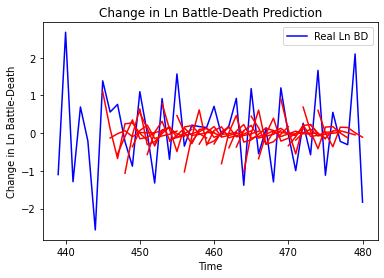

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cameroon', 'country_id': 69, 'step': 't+1', 'mse': 0.5399866964638231, 'mae': 0.6468242138442476, 'r2': 0.26677821760656584, 'tadda_score': 0.7397546121048012}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+2', 'mse': 1.564714195236939, 'mae': 1.0941396306413271, 'r2': -1.1198480436871643, 'tadda_score': 1.4945809373466035}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+3', 'mse': 1.2261853420555044, 'mae': 0.8980344640556822, 'r2': -0.25120570078373583, 'tadda_score': 1.0236263950510671}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+4', 'mse': 1.3769105170971159, 'mae': 0.9254931217529695, 'r2': -0.5634458901676691, 'tadda_score': 1.1314779506224713}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+5', 'mse': 1.6946700361148992, 'mae': 1.0639166774260556, 'r2': -0.7037250435827693, 'tadda_score': 1.3462792731232998}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+6', 'mse': 1.9874618

Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.7477 - val_loss: 2.4161
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.7413 - val_loss: 2.4150
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.7516 - val_loss: 2.4141
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.7453 - val_loss: 2.4129
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.7453 - val_loss: 2.4121
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.7444 - val_loss: 2.4112
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.7416 - val_loss: 2.4103
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.7409 - val_loss: 2.4098
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.7434 - val_loss: 2.4094
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.7451 - val_loss: 2.4083
Epoch 71/100
8/8 [==

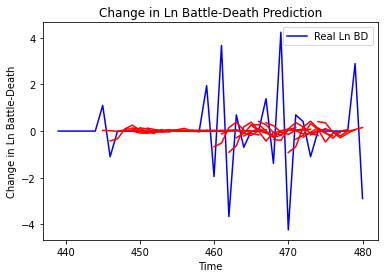

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+1', 'mse': 2.1273947226001724, 'mae': 0.8991906969228313, 'r2': 0.19561136777589427, 'tadda_score': 0.9327759977160817}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+2', 'mse': 1.6200112119580559, 'mae': 0.9306939358459684, 'r2': -0.10658529424916474, 'tadda_score': 0.9889565089043749}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+3', 'mse': 2.235617848747155, 'mae': 0.9434240690467519, 'r2': 0.04616466640017569, 'tadda_score': 1.0062303121236726}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+4', 'mse': 2.5947897362737695, 'mae': 0.9563385430305819, 'r2': -0.07327080091705285, 'tadda_score': 0.9827714401810984}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+5', 'mse': 2.7448449687234926, 'mae': 0.962488100633167, 'r2': -0.08314037120048856, 'tadda_score': 1.0301859281

8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 

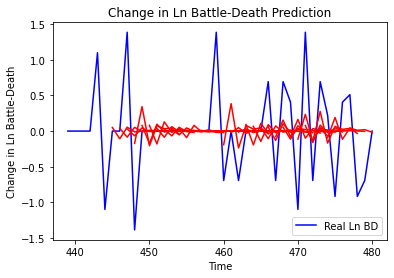

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tunisia', 'country_id': 73, 'step': 't+1', 'mse': 0.3649384011527977, 'mae': 0.39834876279585935, 'r2': 0.11603089817663537, 'tadda_score': 0.4041252351855574}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+2', 'mse': 0.3930873097815621, 'mae': 0.426775848610437, 'r2': 0.044736481344820445, 'tadda_score': 0.4388514028794925}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+3', 'mse': 0.48776451344712574, 'mae': 0.47029963307192185, 'r2': -0.02084588504496665, 'tadda_score': 0.47488972337405144}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+4', 'mse': 0.49442527304955186, 'mae': 0.4590380735742362, 'r2': -0.023931869145592533, 'tadda_score': 0.4608115183546952}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+5', 'mse': 0.5035340868003977, 'mae': 0.5061849248203899, 'r2': -0.1445553108840325, 'tadda_score': 0.5466983739826347}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+6', 'mse': 0.59789

8/8 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
8/8 [==============================] - 0s 11ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
8/8 [==============================] - 0s 11ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
8/8 [==============================] - 0s 11ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
8/8 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
8/8 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
8/8 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
8/8 [==============================] - 0s 

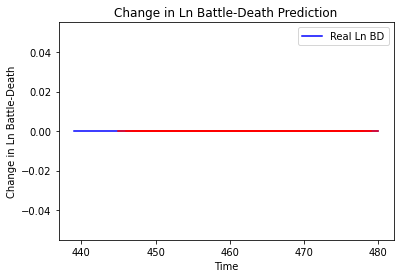

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Benin', 'country_id': 74, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Equatorial Guinea']
Building vanilla Model...
Model: "sequential_783"
_________________________________________________________________
Layer (type)                 Output S

8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
8/8 [==============================] - 0s 5ms/

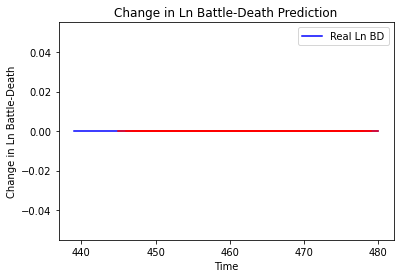

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Niger']
Building vanilla Model...
Model: "sequential_784"
_______________________________

8/8 [==============================] - 0s 5ms/step - loss: 0.8484 - val_loss: 1.6440
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.8561 - val_loss: 1.6438
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.8480 - val_loss: 1.6433
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.8590 - val_loss: 1.6430
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.8510 - val_loss: 1.6428
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.8653 - val_loss: 1.6424
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.8480 - val_loss: 1.6420
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.8565 - val_loss: 1.6419
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.8590 - val_loss: 1.6413
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.8615 - val_loss: 1.6411
Epoch 74/100
8/8 [===============

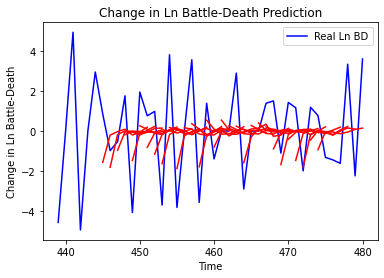

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Niger', 'country_id': 78, 'step': 't+1', 'mse': 3.1787269734046286, 'mae': 1.5127594833226519, 'r2': 0.2661994446563235, 'tadda_score': 1.7739856267622627}
{'country': 'Niger', 'country_id': 78, 'step': 't+2', 'mse': 6.133828039240618, 'mae': 2.0772660280564326, 'r2': -0.5620395397098419, 'tadda_score': 2.485037232468416}
{'country': 'Niger', 'country_id': 78, 'step': 't+3', 'mse': 5.7507013304585435, 'mae': 1.8599237291212942, 'r2': -0.48480504977949934, 'tadda_score': 2.3106472708976327}
{'country': 'Niger', 'country_id': 78, 'step': 't+4', 'mse': 6.032097057069154, 'mae': 2.0512006842255275, 'r2': -0.3294675411604122, 'tadda_score': 2.4340338456789334}
{'country': 'Niger', 'country_id': 78, 'step': 't+5', 'mse': 7.439754660694825, 'mae': 2.1879830909837863, 'r2': -0.3524790168297878, 'tadda_score': 2.5987706756164215}
{'country': 'Niger', 'country_id': 78, 'step': 't+6', 'mse': 6.894912571146195, 'mae': 2.066

8/8 [==============================] - 0s 6ms/step - loss: 0.5322 - val_loss: 1.1642
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5321 - val_loss: 1.1643
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5314 - val_loss: 1.1643
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5340 - val_loss: 1.1641
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5345 - val_loss: 1.1648
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5337 - val_loss: 1.1657
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5377 - val_loss: 1.1667
Epoch 68/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5323 - val_loss: 1.1674
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5337 - val_loss: 1.1662
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5344 - val_loss: 1.1656
Epoch 71/100
8/8 [===============

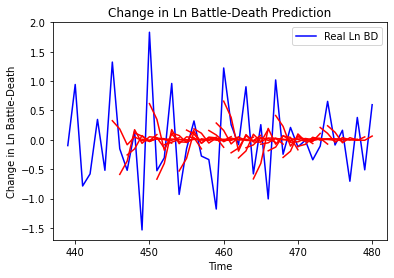

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Nigeria', 'country_id': 79, 'step': 't+1', 'mse': 0.39888192988915094, 'mae': 0.4793019424551576, 'r2': 0.3020515219242831, 'tadda_score': 0.5243276685835272}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+2', 'mse': 1.0609902793980843, 'mae': 0.8090941054874262, 'r2': -0.9609105678700558, 'tadda_score': 1.0486420970382642}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+3', 'mse': 0.9045610068514389, 'mae': 0.7675392812010225, 'r2': -0.4763766262116085, 'tadda_score': 0.9518997497128027}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+4', 'mse': 1.1180011640378922, 'mae': 0.8228588209386569, 'r2': -0.502940492402491, 'tadda_score': 1.0634177552435202}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+5', 'mse': 0.7070964511325533, 'mae': 0.6448315901927624, 'r2': -0.38114733329551154, 'tadda_score': 0.7766993857545131}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+6', 'mse': 0.7003004502276

8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
8/8 [==============================] - 0s 5ms/

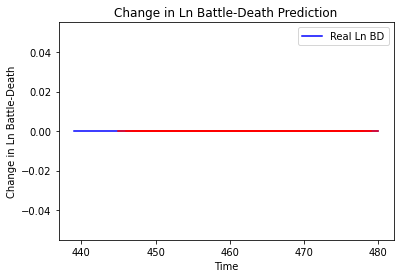

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Togo']
Building vanilla Model...
Model: "sequential_787"
____

8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
8/8 [==============================] - 0s 5ms/

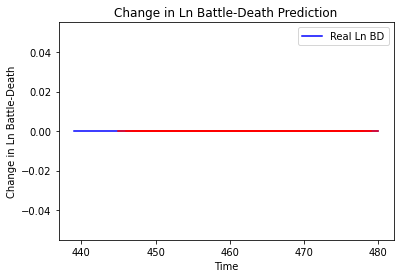

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Togo', 'country_id': 81, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Somalia']
Building vanilla Model...
Model: "sequential_788"
_________________________________________________________________
Layer (type)                 Output Shape             

8/8 [==============================] - 0s 5ms/step - loss: 2.6131 - val_loss: 0.3652
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 2.5979 - val_loss: 0.3653
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 2.6052 - val_loss: 0.3655
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 2.5960 - val_loss: 0.3657
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 2.5763 - val_loss: 0.3658
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 2.5920 - val_loss: 0.3658
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 2.5903 - val_loss: 0.3657
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 2.5898 - val_loss: 0.3657
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 2.6000 - val_loss: 0.3659
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 2.5994 - val_loss: 0.3661
Epoch 75/100
8/8 [===============

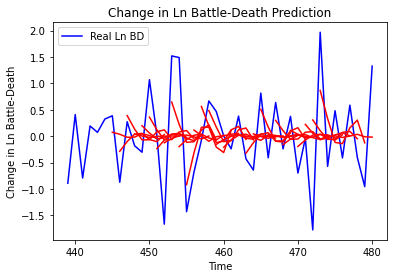

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Somalia', 'country_id': 120, 'step': 't+1', 'mse': 0.5481760779232784, 'mae': 0.5706638955142341, 'r2': 0.2804064020581356, 'tadda_score': 0.6481377530163768}
{'country': 'Somalia', 'country_id': 120, 'step': 't+2', 'mse': 1.3611314709061928, 'mae': 0.8855470402657353, 'r2': -0.3880147580942892, 'tadda_score': 1.0795249655713006}
{'country': 'Somalia', 'country_id': 120, 'step': 't+3', 'mse': 1.2601938172090497, 'mae': 0.8406316803855295, 'r2': -0.5790052066659137, 'tadda_score': 1.037362498674551}
{'country': 'Somalia', 'country_id': 120, 'step': 't+4', 'mse': 0.9454062744141216, 'mae': 0.8028873379162301, 'r2': -0.36387107180475153, 'tadda_score': 0.9320461546667019}
{'country': 'Somalia', 'country_id': 120, 'step': 't+5', 'mse': 0.8917604068644222, 'mae': 0.7126726583712931, 'r2': -0.15678522247400206, 'tadda_score': 0.8437340592945503}
{'country': 'Somalia', 'country_id': 120, 'step': 't+6', 'mse': 0.9473433

8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
8/8 [==============================] - 0s 5ms/

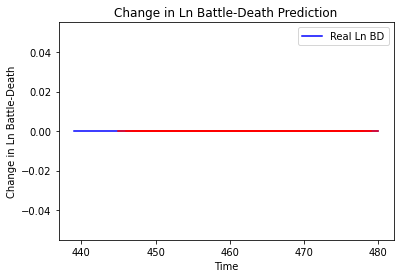

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Botswana', 'country_id': 154, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Burundi']
Building vanilla Model...
Model: "sequential_790"
_________________________________________________________________
Layer (type)       

8/8 [==============================] - 0s 5ms/step - loss: 1.9323 - val_loss: 1.6127
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 1.9322 - val_loss: 1.6123
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 1.9386 - val_loss: 1.6123
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 1.9292 - val_loss: 1.6121
Epoch 69/100
8/8 [==============================] - 0s 6ms/step - loss: 1.9245 - val_loss: 1.6121
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 1.9333 - val_loss: 1.6126
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 1.9223 - val_loss: 1.6125
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 1.9332 - val_loss: 1.6124
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 1.9222 - val_loss: 1.6119
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 1.9397 - val_loss: 1.6118
Epoch 75/100
8/8 [===============

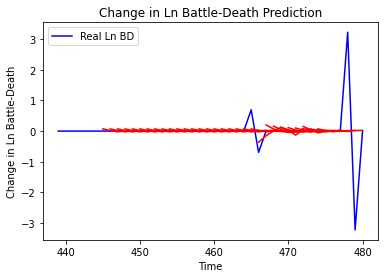

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burundi', 'country_id': 155, 'step': 't+1', 'mse': 0.02458515988341714, 'mae': 0.11324815389730615, 'r2': 0.2324381623838817, 'tadda_score': 0.11324815389730615}
{'country': 'Burundi', 'country_id': 155, 'step': 't+2', 'mse': 0.06291369631618031, 'mae': 0.16345839388388478, 'r2': -0.9641992398935673, 'tadda_score': 0.17249404974001728}
{'country': 'Burundi', 'country_id': 155, 'step': 't+3', 'mse': 0.055248295245965404, 'mae': 0.14008350831486863, 'r2': -0.7248813196758799, 'tadda_score': 0.1463809506318776}
{'country': 'Burundi', 'country_id': 155, 'step': 't+4', 'mse': 0.0482442748262671, 'mae': 0.13682171664851986, 'r2': -0.5062120570175308, 'tadda_score': 0.14121104441303095}
{'country': 'Burundi', 'country_id': 155, 'step': 't+5', 'mse': 0.03746215484549496, 'mae': 0.0982655819477447, 'r2': -0.16958850585563212, 'tadda_score': 0.10039946449019593}
{'country': 'Burundi', 'country_id': 155, 'step': 't+6', 'ms

Epoch 61/100
8/8 [==============================] - 0s 6ms/step - loss: 2.4389 - val_loss: 0.1839
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 2.4418 - val_loss: 0.1837
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 2.4450 - val_loss: 0.1833
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 2.4474 - val_loss: 0.1827
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 2.4367 - val_loss: 0.1831
Epoch 66/100
8/8 [==============================] - 0s 7ms/step - loss: 2.4395 - val_loss: 0.1834
Epoch 67/100
8/8 [==============================] - 0s 7ms/step - loss: 2.4489 - val_loss: 0.1834
Epoch 68/100
8/8 [==============================] - 0s 8ms/step - loss: 2.4355 - val_loss: 0.1832
Epoch 69/100
8/8 [==============================] - 0s 7ms/step - loss: 2.4389 - val_loss: 0.1825
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 2.4256 - val_loss: 0.1822
Epoch 71/100
8/8 [==

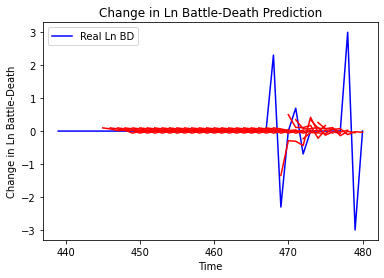

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Rwanda', 'country_id': 156, 'step': 't+1', 'mse': 0.22554385595177084, 'mae': 0.24341178310547829, 'r2': 0.41491656827920453, 'tadda_score': 0.24341178310547829}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+2', 'mse': 0.5960913776617989, 'mae': 0.41497255635891916, 'r2': -0.5463209467169869, 'tadda_score': 0.4496912933651066}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+3', 'mse': 0.5149843091311992, 'mae': 0.43051423713978604, 'r2': -0.8452395507470745, 'tadda_score': 0.45943195904708384}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+4', 'mse': 0.53466912586526, 'mae': 0.4403141655427766, 'r2': -0.44919899427220544, 'tadda_score': 0.4403141655427766}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+5', 'mse': 0.522206624638828, 'mae': 0.32810751327897625, 'r2': -0.4154198898321768, 'tadda_score': 0.3409481160742593}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+6', 'mse': 0.50883250

8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
8/8 [==============================] - 0s 5ms/

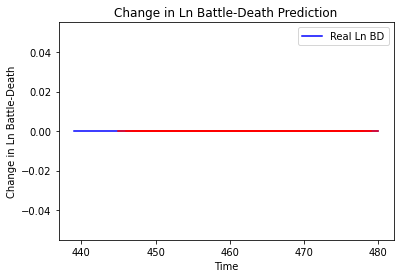

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zambia', 'country_id': 157, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Zimbabwe']
Building vanilla Model...
Model: "sequential_793"
_________________________________________________________________
Layer (type)                 Out

8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
8/8 [==============================] - 0s 7ms/

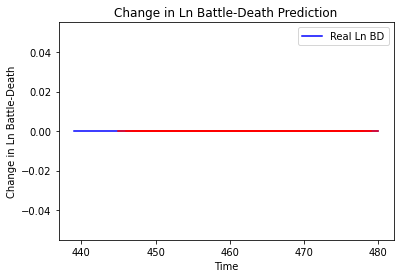

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Comoros']
Building vanilla Model...
Model: "sequential_794"
_________________________________________________________________
Layer (type)       

Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.1281 - val_loss: 3.0178e-05
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 0.1287 - val_loss: 2.1050e-05
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1318 - val_loss: 9.6044e-06
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1279 - val_loss: 6.6048e-06
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1313 - val_loss: 1.6080e-05
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1281 - val_loss: 1.4396e-05
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1292 - val_loss: 1.5298e-05
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.1281 - val_loss: 2.1614e-05
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1266 - val_loss: 1.7190e-05
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1273 - v

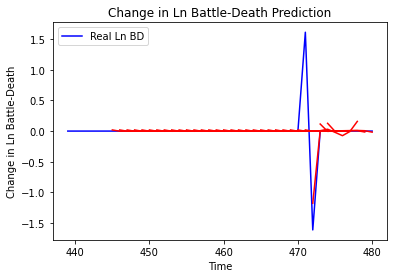

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Comoros', 'country_id': 159, 'step': 't+1', 'mse': 0.09189602840447246, 'mae': 0.09162954934635158, 'r2': 0.46784328534339414, 'tadda_score': 0.09162954934635158}
{'country': 'Comoros', 'country_id': 159, 'step': 't+2', 'mse': 0.22945890176904396, 'mae': 0.16765890777804848, 'r2': -0.32876357590427085, 'tadda_score': 0.17131968945958612}
{'country': 'Comoros', 'country_id': 159, 'step': 't+3', 'mse': 0.22849029586998088, 'mae': 0.16599730111731487, 'r2': -0.32315451812460605, 'tadda_score': 0.17004853618714608}
{'country': 'Comoros', 'country_id': 159, 'step': 't+4', 'mse': 0.1308353212798083, 'mae': 0.11254465392827191, 'r2': -0.5675487705598896, 'tadda_score': 0.11254465392827191}
{'country': 'Comoros', 'country_id': 159, 'step': 't+5', 'mse': 0.13734162479735118, 'mae': 0.11873208898156085, 'r2': -0.645501329395298, 'tadda_score': 0.11873208898156085}
{'country': 'Comoros', 'country_id': 159, 'step': 't+6', '

8/8 [==============================] - 0s 5ms/step - loss: 0.1442 - val_loss: 6.4352e-06
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1427 - val_loss: 3.0596e-06
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1435 - val_loss: 1.4229e-06
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1416 - val_loss: 1.3442e-05
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1467 - val_loss: 2.2279e-05
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1459 - val_loss: 3.0579e-05
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1429 - val_loss: 2.0860e-05
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1436 - val_loss: 9.4461e-06
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1434 - val_loss: 5.1612e-06
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.1433 - val_loss: 2.53

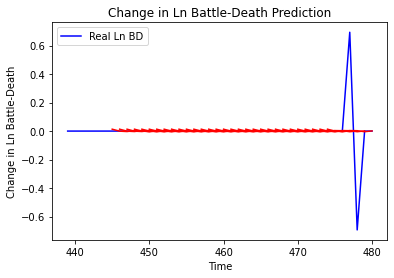

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Lesotho', 'country_id': 160, 'step': 't+1', 'mse': 0.00017552910533669489, 'mae': 0.013248739764094353, 'r2': 0.0, 'tadda_score': 0.013248739764094353}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+2', 'mse': 0.00016022303046897904, 'mae': 0.012657923623919487, 'r2': 0.0, 'tadda_score': 0.012657923623919487}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+3', 'mse': 8.877872659553143e-05, 'mae': 0.009422246366739273, 'r2': 0.0, 'tadda_score': 0.009422246366739273}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+4', 'mse': 0.0001677373661718197, 'mae': 0.01295134611427784, 'r2': 0.0, 'tadda_score': 0.01295134611427784}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+5', 'mse': 0.0002630876632698925, 'mae': 0.016219977289438248, 'r2': 0.0, 'tadda_score': 0.016219977289438248}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+6', 'mse': 0.00013971254619641552, 'mae': 0.011820006184279919, '

8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
8/8 [==============================] - 0s 7ms/

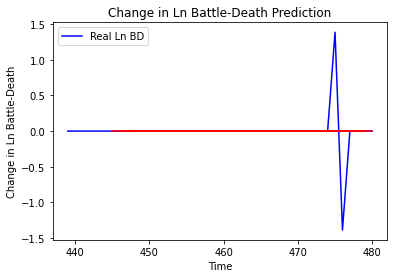

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Malawi', 'country_id': 161, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mozambique']
Building vanilla Model...
Model: "sequential_797"
_________________________________________________________________
Layer (type)                 O

8/8 [==============================] - 0s 5ms/step - loss: 1.0547 - val_loss: 0.6905
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 1.0546 - val_loss: 0.6905
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 1.0623 - val_loss: 0.6905
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 1.0551 - val_loss: 0.6903
Epoch 69/100
8/8 [==============================] - 0s 6ms/step - loss: 1.0465 - val_loss: 0.6902
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 1.0570 - val_loss: 0.6903
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 1.0821 - val_loss: 0.6902
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 1.0364 - val_loss: 0.6902
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 1.0578 - val_loss: 0.6902
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 1.0620 - val_loss: 0.6902
Epoch 75/100
8/8 [===============

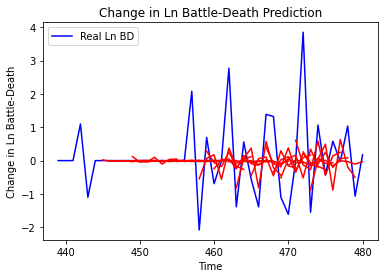

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mozambique', 'country_id': 162, 'step': 't+1', 'mse': 1.2770703508877455, 'mae': 0.689680369769537, 'r2': 0.18841625080796442, 'tadda_score': 0.7029436796872601}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+2', 'mse': 2.2907348034543205, 'mae': 0.9793438023549267, 'r2': -0.19725614427309468, 'tadda_score': 1.0841285110733851}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+3', 'mse': 2.168867839226498, 'mae': 1.0425034234023571, 'r2': -0.13326176155459635, 'tadda_score': 1.1063164690232754}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+4', 'mse': 2.0928690604397553, 'mae': 1.021463427336411, 'r2': -0.3887387524410324, 'tadda_score': 1.213631581158833}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+5', 'mse': 1.1008796556881433, 'mae': 0.7047913306385201, 'r2': -0.34418206280234265, 'tadda_score': 0.7833056331604642}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+6',

8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
8/8 [==============================] - 0s 5ms/

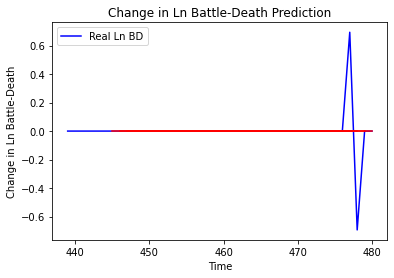

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Africa', 'country_id': 163, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Swaziland']
Building vanilla Model...
Model: "sequential_799"
_______________________________________________________

8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
8/8 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
8/8 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
8/8 [==============================] - 0s 6ms/

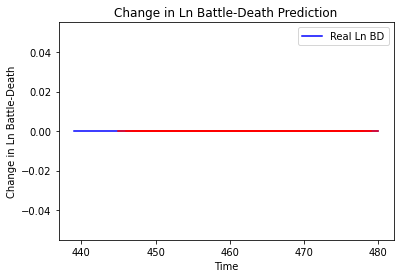

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Swaziland', 'country_id': 164, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Angola']
Building vanilla Model...
Model: "sequential_800"
_________________________________________________________________
Layer (type) 

8/8 [==============================] - 0s 5ms/step - loss: 3.3220 - val_loss: 0.0853
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 3.3073 - val_loss: 0.0853
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 3.3216 - val_loss: 0.0853
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 3.3386 - val_loss: 0.0853
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 3.3296 - val_loss: 0.0853
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 3.3336 - val_loss: 0.0852
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 3.3339 - val_loss: 0.0854
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 3.3303 - val_loss: 0.0855
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 3.3185 - val_loss: 0.0854
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 3.3184 - val_loss: 0.0852
Epoch 75/100
8/8 [===============

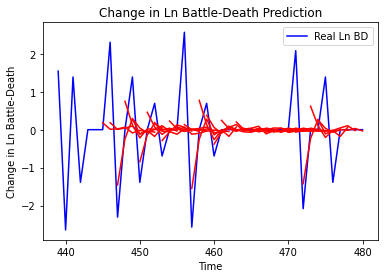

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Angola', 'country_id': 165, 'step': 't+1', 'mse': 0.7109800646197016, 'mae': 0.5534823525013568, 'r2': 0.44127767400094076, 'tadda_score': 0.5556289055011712}
{'country': 'Angola', 'country_id': 165, 'step': 't+2', 'mse': 2.079075787154939, 'mae': 1.0017878267851512, 'r2': -0.6338377368553623, 'tadda_score': 1.1235377365039827}
{'country': 'Angola', 'country_id': 165, 'step': 't+3', 'mse': 1.2238576859836228, 'mae': 0.7953784449075468, 'r2': -0.3953133905993613, 'tadda_score': 0.8367402621283937}
{'country': 'Angola', 'country_id': 165, 'step': 't+4', 'mse': 1.1255457172445409, 'mae': 0.7780032273361414, 'r2': -0.04860397907897607, 'tadda_score': 0.8000285431722134}
{'country': 'Angola', 'country_id': 165, 'step': 't+5', 'mse': 1.196062459777584, 'mae': 0.7418221960500591, 'r2': -0.22159728715690452, 'tadda_score': 0.7674016239777915}
{'country': 'Angola', 'country_id': 165, 'step': 't+6', 'mse': 1.5258638010527

8/8 [==============================] - 0s 5ms/step - loss: 1.9042 - val_loss: 0.2223
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 1.8991 - val_loss: 0.2222
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 1.9010 - val_loss: 0.2222
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 1.9124 - val_loss: 0.2222
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 1.9180 - val_loss: 0.2221
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 1.9134 - val_loss: 0.2221
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 1.8955 - val_loss: 0.2222
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 1.9159 - val_loss: 0.2225
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 1.9103 - val_loss: 0.2225
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 1.8979 - val_loss: 0.2224
Epoch 71/100
8/8 [===============

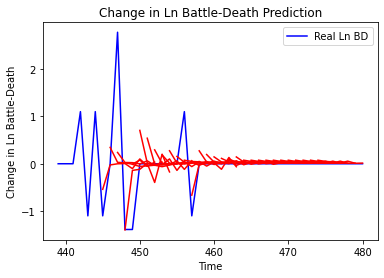

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo', 'country_id': 166, 'step': 't+1', 'mse': 0.3740163449803659, 'mae': 0.3403148567903012, 'r2': 0.25748604915912265, 'tadda_score': 0.3403148567903012}
{'country': 'Congo', 'country_id': 166, 'step': 't+2', 'mse': 1.110058385844429, 'mae': 0.6356748265390796, 'r2': -0.46068412990274066, 'tadda_score': 0.7336143446331425}
{'country': 'Congo', 'country_id': 166, 'step': 't+3', 'mse': 1.040688495639854, 'mae': 0.5896421496093688, 'r2': -0.7546604162803434, 'tadda_score': 0.6936028206368704}
{'country': 'Congo', 'country_id': 166, 'step': 't+4', 'mse': 1.0061872947713686, 'mae': 0.6321118363758345, 'r2': -0.44851641510009266, 'tadda_score': 0.7329319158216734}
{'country': 'Congo', 'country_id': 166, 'step': 't+5', 'mse': 1.040546765829786, 'mae': 0.6520469157914737, 'r2': -0.7544214517020134, 'tadda_score': 0.7405543266753772}
{'country': 'Congo', 'country_id': 166, 'step': 't+6', 'mse': 0.9679799869510516, 'm

8/8 [==============================] - 0s 6ms/step - loss: 2.9786 - val_loss: 3.2842
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 2.9439 - val_loss: 3.2856
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 2.9745 - val_loss: 3.2852
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 2.9788 - val_loss: 3.2852
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 2.9814 - val_loss: 3.2853
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 2.9536 - val_loss: 3.2863
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 2.9595 - val_loss: 3.2864
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 2.9483 - val_loss: 3.2873
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 2.9623 - val_loss: 3.2878
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 2.9549 - val_loss: 3.2891
Epoch 71/100
8/8 [===============

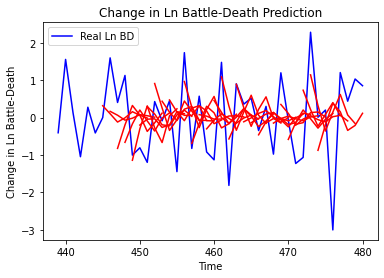

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+1', 'mse': 0.896564273003003, 'mae': 0.7867500509116249, 'r2': 0.1808313720776421, 'tadda_score': 0.9479018728229599}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+2', 'mse': 2.672845628534092, 'mae': 1.3255576908535374, 'r2': -0.8903741165949375, 'tadda_score': 1.7190633038626726}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+3', 'mse': 2.5451858996203227, 'mae': 1.2672244935623251, 'r2': -0.4755249189462336, 'tadda_score': 1.5924526127071623}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+4', 'mse': 2.9954210951096627, 'mae': 1.4008110898378565, 'r2': -0.7193536679719021, 'tadda_score': 1.778953377916721}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+5', 'mse': 3.6380151226569573, 'mae': 1.5192171098999117, 'r2': -0.9817833028723861, 'tadda_score': 1.9815977933220001}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+6', 'm

8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
8/8 [==============================] - 0s 5ms/

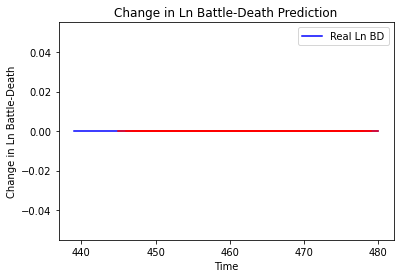

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Gabon', 'country_id': 169, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Namibia']
Building vanilla Model...
Model: "sequential_804"
_________________________________________________________________
Layer (type)                 Output Shap

Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1415 - val_loss: 1.4001e-05
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1416 - val_loss: 9.7012e-06
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1407 - val_loss: 1.3038e-05
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1414 - val_loss: 2.4122e-05
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1417 - val_loss: 7.2098e-06
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1405 - val_loss: 6.2864e-06
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1419 - val_loss: 2.5348e-06
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1417 - val_loss: 3.2544e-06
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1414 - val_loss: 3.8642e-06
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1419 - v

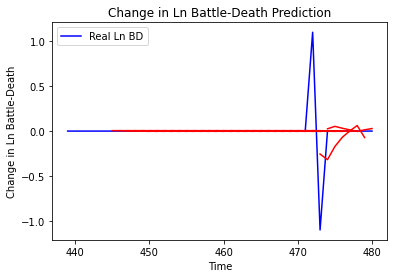

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Namibia', 'country_id': 170, 'step': 't+1', 'mse': 0.06362932567654817, 'mae': 0.06972648089772157, 'r2': 0.2092127205564327, 'tadda_score': 0.06972648089772157}
{'country': 'Namibia', 'country_id': 170, 'step': 't+2', 'mse': 0.09667697336875179, 'mae': 0.10315324730570805, 'r2': -0.20150449407152715, 'tadda_score': 0.10574330381448757}
{'country': 'Namibia', 'country_id': 170, 'step': 't+3', 'mse': 0.05830117834542104, 'mae': 0.07562040868846423, 'r2': -0.4991080591759991, 'tadda_score': 0.07562040868846423}
{'country': 'Namibia', 'country_id': 170, 'step': 't+4', 'mse': 0.061878660880792566, 'mae': 0.07997039862918702, 'r2': -0.5910964726616084, 'tadda_score': 0.07997039862918702}
{'country': 'Namibia', 'country_id': 170, 'step': 't+5', 'mse': 0.04791526631971415, 'mae': 0.06291019744870907, 'r2': -0.2320533467071737, 'tadda_score': 0.06291019744870907}
{'country': 'Namibia', 'country_id': 170, 'step': 't+6', 

8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
8/8 [==============================] - 0s 5ms/

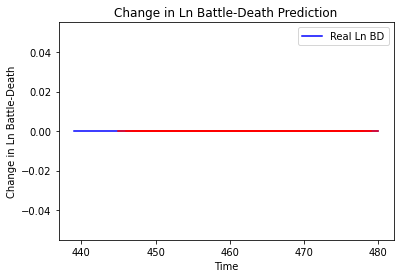

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Madagascar', 'country_id': 172, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mauritius']
Building vanilla Model...
Model: "sequential_806"
_________________________________________________________________
Lay

8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
8/8 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
8/8 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
8/8 [==============================] - 0s 6ms/

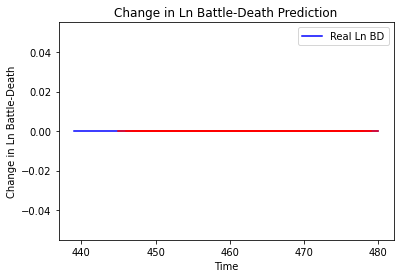

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritius', 'country_id': 173, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Seychelles']
Building vanilla Model...
Model: "sequential_807"
_________________________________________________________________
Layer (ty

8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
8/8 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
8/8 [==============================] - 0s 6ms/

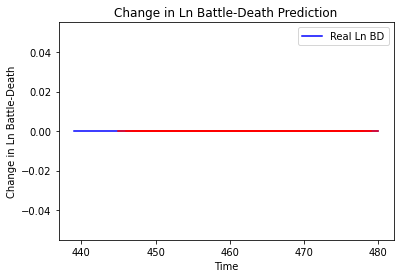

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Seychelles', 'country_id': 174, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Libya']
Building vanilla Model...
Model: "sequential_808"
_________________________________________________________________
Layer (

8/8 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.2974
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.2976
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.2976
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.2976
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.2976
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.2976
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0314 - val_loss: 2.2978
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.2978
Epoch 73/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0314 - val_loss: 2.2981
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.2983
Epoch 75/100
8/8 [===============

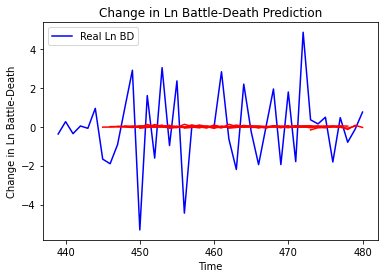

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Libya', 'country_id': 213, 'step': 't+1', 'mse': 4.756646213911489, 'mae': 1.6807417050818831, 'r2': 0.018364891430588837, 'tadda_score': 1.689165276401513}
{'country': 'Libya', 'country_id': 213, 'step': 't+2', 'mse': 5.503980121088953, 'mae': 1.799466148219954, 'r2': -0.01601393321643263, 'tadda_score': 1.8240910745684815}
{'country': 'Libya', 'country_id': 213, 'step': 't+3', 'mse': 7.49940502298003, 'mae': 2.123041981845417, 'r2': -0.010355580200366976, 'tadda_score': 2.1481669924364173}
{'country': 'Libya', 'country_id': 213, 'step': 't+4', 'mse': 5.936946745738058, 'mae': 1.9912122336496876, 'r2': -0.025940027807058952, 'tadda_score': 2.0131579639049835}
{'country': 'Libya', 'country_id': 213, 'step': 't+5', 'mse': 7.454913142926121, 'mae': 2.289103531708092, 'r2': -0.024564195519939824, 'tadda_score': 2.3234875608804524}
{'country': 'Libya', 'country_id': 213, 'step': 't+6', 'mse': 6.422036883979542, 'mae

8/8 [==============================] - 0s 5ms/step - loss: 5.0571 - val_loss: 0.8432
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 5.0531 - val_loss: 0.8433
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 5.0367 - val_loss: 0.8433
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 5.0201 - val_loss: 0.8439
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 5.0138 - val_loss: 0.8447
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 5.0137 - val_loss: 0.8456
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 4.9935 - val_loss: 0.8470
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 5.0235 - val_loss: 0.8474
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 4.9877 - val_loss: 0.8473
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 5.0405 - val_loss: 0.8482
Epoch 71/100
8/8 [===============

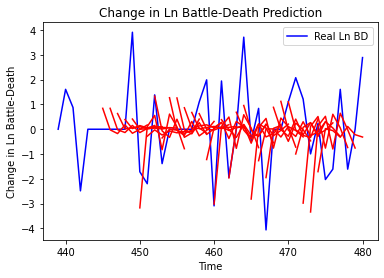

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Chad', 'country_id': 214, 'step': 't+1', 'mse': 3.3088523056127954, 'mae': 1.454788411904532, 'r2': -0.12721008471783968, 'tadda_score': 1.727394037692903}
{'country': 'Chad', 'country_id': 214, 'step': 't+2', 'mse': 8.11734306385885, 'mae': 2.259951768552692, 'r2': -0.912324984887033, 'tadda_score': 2.9129308583691036}
{'country': 'Chad', 'country_id': 214, 'step': 't+3', 'mse': 9.204699295032858, 'mae': 2.390200283479694, 'r2': -0.7624466027620918, 'tadda_score': 2.9810609443505642}
{'country': 'Chad', 'country_id': 214, 'step': 't+4', 'mse': 13.244987645086242, 'mae': 3.084724329190272, 'r2': -1.1720458330382386, 'tadda_score': 3.9452637367216923}
{'country': 'Chad', 'country_id': 214, 'step': 't+5', 'mse': 11.201671664654155, 'mae': 2.690698705976303, 'r2': -1.3578195698081577, 'tadda_score': 3.426999761526878}
{'country': 'Chad', 'country_id': 214, 'step': 't+6', 'mse': 8.916345782492042, 'mae': 2.359042779

8/8 [==============================] - 0s 5ms/step - loss: 0.5872 - val_loss: 2.1801
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5791 - val_loss: 2.1772
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5831 - val_loss: 2.1753
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5724 - val_loss: 2.1731
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5746 - val_loss: 2.1710
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5809 - val_loss: 2.1695
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5719 - val_loss: 2.1683
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5746 - val_loss: 2.1655
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5783 - val_loss: 2.1639
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5768 - val_loss: 2.1621
Epoch 71/100
8/8 [===============

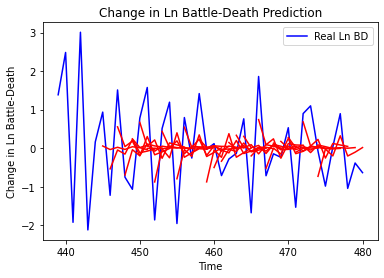

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Egypt', 'country_id': 222, 'step': 't+1', 'mse': 0.6920411310566086, 'mae': 0.6929237070270745, 'r2': 0.3859683536086801, 'tadda_score': 0.7442105841755489}
{'country': 'Egypt', 'country_id': 222, 'step': 't+2', 'mse': 1.576376496624401, 'mae': 1.0652417085671135, 'r2': -0.4576433694402908, 'tadda_score': 1.3023271407227923}
{'country': 'Egypt', 'country_id': 222, 'step': 't+3', 'mse': 1.4595256483651047, 'mae': 0.9797471270088617, 'r2': -0.5737416501603696, 'tadda_score': 1.2183664276077613}
{'country': 'Egypt', 'country_id': 222, 'step': 't+4', 'mse': 1.3060560267063748, 'mae': 0.9596629386594687, 'r2': -0.06030289505324715, 'tadda_score': 1.1356376947041151}
{'country': 'Egypt', 'country_id': 222, 'step': 't+5', 'mse': 1.6341491929115053, 'mae': 1.093351597215851, 'r2': -0.37744996391142505, 'tadda_score': 1.3724012378924786}
{'country': 'Egypt', 'country_id': 222, 'step': 't+6', 'mse': 1.413183768552827, 'ma

8/8 [==============================] - 0s 5ms/step - loss: 2.6765 - val_loss: 4.9934e-04
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 2.6752 - val_loss: 5.0548e-04
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 2.6862 - val_loss: 4.8126e-04
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 2.6858 - val_loss: 4.9926e-04
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 2.6721 - val_loss: 6.4308e-04
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 2.6745 - val_loss: 5.5452e-04
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 2.6759 - val_loss: 4.4093e-04
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 2.6836 - val_loss: 3.3198e-04
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 2.6732 - val_loss: 2.8617e-04
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 2.6769 - val_loss: 2.99

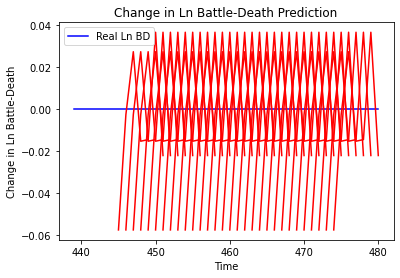

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Uganda', 'country_id': 235, 'step': 't+1', 'mse': 0.0033258345942615564, 'mae': 0.057670049369335175, 'r2': 0.0, 'tadda_score': 0.057670049369335175}
{'country': 'Uganda', 'country_id': 235, 'step': 't+2', 'mse': 0.0036434914440965915, 'mae': 0.0603613406419754, 'r2': 0.0, 'tadda_score': 0.0603613406419754}
{'country': 'Uganda', 'country_id': 235, 'step': 't+3', 'mse': 0.0010901873679803331, 'mae': 0.03301798552274704, 'r2': 0.0, 'tadda_score': 0.03301798552274704}
{'country': 'Uganda', 'country_id': 235, 'step': 't+4', 'mse': 0.0023398969198662606, 'mae': 0.048372481018304825, 'r2': 0.0, 'tadda_score': 0.048372481018304825}
{'country': 'Uganda', 'country_id': 235, 'step': 't+5', 'mse': 0.0036316346086007756, 'mae': 0.06026304513216019, 'r2': 0.0, 'tadda_score': 0.06026304513216019}
{'country': 'Uganda', 'country_id': 235, 'step': 't+6', 'mse': 0.0005584174246564544, 'mae': 0.023630857467651367, 'r2': 0.0, 'tadd

Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1174 - val_loss: 1.6626
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.1162 - val_loss: 1.6612
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1150 - val_loss: 1.6601
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 0.1169 - val_loss: 1.6586
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.1157 - val_loss: 1.6580
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.1181 - val_loss: 1.6567
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1177 - val_loss: 1.6556
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1148 - val_loss: 1.6547
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.1157 - val_loss: 1.6538
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.1159 - val_loss: 1.6531
Epoch 72/100
8/8 [==

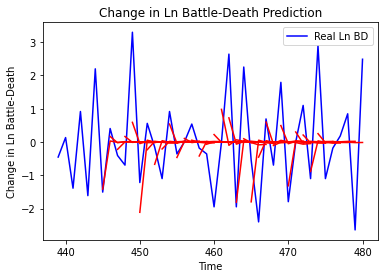

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Kenya', 'country_id': 237, 'step': 't+1', 'mse': 1.3554032338776507, 'mae': 0.8608673107860675, 'r2': 0.34588838193503146, 'tadda_score': 0.8815590930221667}
{'country': 'Kenya', 'country_id': 237, 'step': 't+2', 'mse': 3.0606638450722685, 'mae': 1.4344407924460845, 'r2': -0.6033647514113687, 'tadda_score': 1.8078264888075466}
{'country': 'Kenya', 'country_id': 237, 'step': 't+3', 'mse': 2.885201814295369, 'mae': 1.3113928702094857, 'r2': -0.32131610723139037, 'tadda_score': 1.5482455339649026}
{'country': 'Kenya', 'country_id': 237, 'step': 't+4', 'mse': 3.649691640966304, 'mae': 1.5693164872150875, 'r2': -0.29960453827792755, 'tadda_score': 1.8119907592258113}
{'country': 'Kenya', 'country_id': 237, 'step': 't+5', 'mse': 2.51660298260065, 'mae': 1.169032732723228, 'r2': -0.6615325463870863, 'tadda_score': 1.456166734872333}
{'country': 'Kenya', 'country_id': 237, 'step': 't+6', 'mse': 2.5019460476971047, 'mae'

6/6 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
6/6 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
6/6 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
6/6 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
6/6 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
6/6 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
6/6 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
6/6 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
6/6 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
6/6 [==============================] - 0s 6ms/

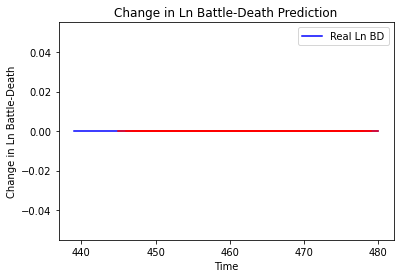

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tanzania', 'country_id': 242, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Morocco']
Building vanilla Model...
Model: "sequential_814"
_________________________________________________________________
Layer (type)       

Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0707 - val_loss: 1.7638e-06
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0714 - val_loss: 5.3194e-06
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0723 - val_loss: 2.2734e-06
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0706 - val_loss: 4.5979e-06
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0705 - val_loss: 6.9571e-06
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0714 - val_loss: 2.1161e-05
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0706 - val_loss: 1.8005e-05
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0710 - val_loss: 5.9478e-06
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0720 - val_loss: 1.8345e-06
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0720 - v

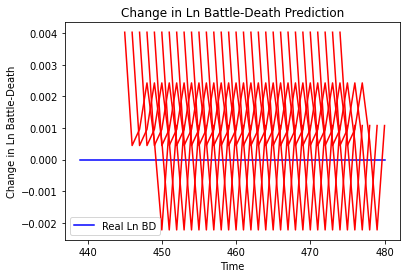

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Morocco', 'country_id': 243, 'step': 't+1', 'mse': 1.6198710723111043e-05, 'mae': 0.0040247621946036816, 'r2': 0.0, 'tadda_score': 0.0040247621946036816}
{'country': 'Morocco', 'country_id': 243, 'step': 't+2', 'mse': 1.997787815660821e-05, 'mae': 0.004469661973416805, 'r2': 0.0, 'tadda_score': 0.004469661973416805}
{'country': 'Morocco', 'country_id': 243, 'step': 't+3', 'mse': 2.9440731776466398e-05, 'mae': 0.005425931420177221, 'r2': 0.0, 'tadda_score': 0.005425931420177221}
{'country': 'Morocco', 'country_id': 243, 'step': 't+4', 'mse': 6.160891247436462e-05, 'mae': 0.007849134504795074, 'r2': 0.0, 'tadda_score': 0.007849134504795074}
{'country': 'Morocco', 'country_id': 243, 'step': 't+5', 'mse': 6.370994164503572e-05, 'mae': 0.007981850765645504, 'r2': 0.0, 'tadda_score': 0.007981850765645504}
{'country': 'Morocco', 'country_id': 243, 'step': 't+6', 'mse': 3.317339007134095e-05, 'mae': 0.005759634543210268

8/8 [==============================] - 0s 5ms/step - loss: 0.0654 - val_loss: 0.1155
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0644 - val_loss: 0.1154
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0658 - val_loss: 0.1153
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0653 - val_loss: 0.1152
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 0.0651 - val_loss: 0.1151
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0667 - val_loss: 0.1151
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0645 - val_loss: 0.1150
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0643 - val_loss: 0.1149
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0649 - val_loss: 0.1148
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.0646 - val_loss: 0.1148
Epoch 71/100
8/8 [===============

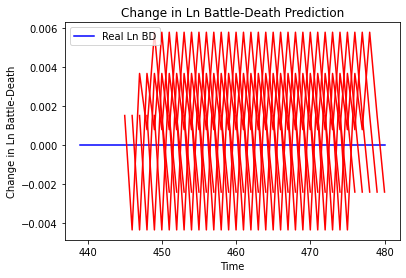

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritania', 'country_id': 244, 'step': 't+1', 'mse': 2.2937060398418255e-06, 'mae': 0.0015144986100494862, 'r2': 0.0, 'tadda_score': 0.0015144986100494862}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+2', 'mse': 8.137778790829643e-06, 'mae': 0.00285267923027277, 'r2': 0.0, 'tadda_score': 0.00285267923027277}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+3', 'mse': 6.798584041602107e-07, 'mae': 0.0008245352655649185, 'r2': 0.0, 'tadda_score': 0.0008245352655649185}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+4', 'mse': 2.595253248763524e-06, 'mae': 0.0016109789721667767, 'r2': 0.0, 'tadda_score': 0.0016109789721667767}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+5', 'mse': 0.00013862465845354902, 'mae': 0.011773897334933281, 'r2': 0.0, 'tadda_score': 0.011773897334933281}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+6', 'mse': 0.00017640259541471318, 'mae':

2/2 [==============================] - 0s 10ms/step - loss: 3.2081 - val_loss: 0.9262
Epoch 61/100
2/2 [==============================] - 0s 10ms/step - loss: 3.2053 - val_loss: 0.9262
Epoch 62/100
2/2 [==============================] - 0s 10ms/step - loss: 3.2058 - val_loss: 0.9261
Epoch 63/100
2/2 [==============================] - 0s 10ms/step - loss: 3.2250 - val_loss: 0.9259
Epoch 64/100
2/2 [==============================] - 0s 9ms/step - loss: 3.2414 - val_loss: 0.9257
Epoch 65/100
2/2 [==============================] - 0s 12ms/step - loss: 3.2081 - val_loss: 0.9255
Epoch 66/100
2/2 [==============================] - 0s 10ms/step - loss: 3.2134 - val_loss: 0.9253
Epoch 67/100
2/2 [==============================] - 0s 10ms/step - loss: 3.2082 - val_loss: 0.9251
Epoch 68/100
2/2 [==============================] - 0s 10ms/step - loss: 3.2123 - val_loss: 0.9249
Epoch 69/100
2/2 [==============================] - 0s 10ms/step - loss: 3.2492 - val_loss: 0.9247
Epoch 70/100
2/2 [======

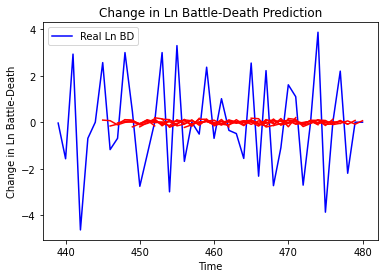

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sudan', 'country_id': 245, 'step': 't+1', 'mse': 3.703121216319396, 'mae': 1.6188973763181298, 'r2': 0.07453074031815154, 'tadda_score': 1.6351040412826865}
{'country': 'Sudan', 'country_id': 245, 'step': 't+2', 'mse': 4.368009996693704, 'mae': 1.7145446723987119, 'r2': -0.023731889361682912, 'tadda_score': 1.7969835198213115}
{'country': 'Sudan', 'country_id': 245, 'step': 't+3', 'mse': 3.9384414444812412, 'mae': 1.676047286364354, 'r2': -0.015571577272815329, 'tadda_score': 1.7090685834528678}
{'country': 'Sudan', 'country_id': 245, 'step': 't+4', 'mse': 3.362281422495061, 'mae': 1.4483015131530292, 'r2': -0.012707667995945915, 'tadda_score': 1.4826855762876199}
{'country': 'Sudan', 'country_id': 245, 'step': 't+5', 'mse': 5.238572513799187, 'mae': 1.9381047715429045, 'r2': 0.0008063140347163156, 'tadda_score': 1.95961821374134}
{'country': 'Sudan', 'country_id': 245, 'step': 't+6', 'mse': 4.715302698881081, '

2/2 [==============================] - 0s 10ms/step - loss: 6.4479 - val_loss: 4.1740
Epoch 61/100
2/2 [==============================] - 0s 10ms/step - loss: 6.5230 - val_loss: 4.1721
Epoch 62/100
2/2 [==============================] - 0s 11ms/step - loss: 6.4996 - val_loss: 4.1700
Epoch 63/100
2/2 [==============================] - 0s 10ms/step - loss: 6.5463 - val_loss: 4.1682
Epoch 64/100
2/2 [==============================] - 0s 9ms/step - loss: 6.5165 - val_loss: 4.1665
Epoch 65/100
2/2 [==============================] - 0s 10ms/step - loss: 6.4543 - val_loss: 4.1649
Epoch 66/100
2/2 [==============================] - 0s 10ms/step - loss: 6.5107 - val_loss: 4.1632
Epoch 67/100
2/2 [==============================] - 0s 10ms/step - loss: 6.4822 - val_loss: 4.1615
Epoch 68/100
2/2 [==============================] - 0s 10ms/step - loss: 6.4930 - val_loss: 4.1602
Epoch 69/100
2/2 [==============================] - 0s 9ms/step - loss: 6.3930 - val_loss: 4.1590
Epoch 70/100
2/2 [=======

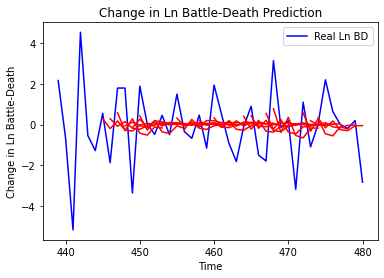

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Sudan', 'country_id': 246, 'step': 't+1', 'mse': 2.008732558844356, 'mae': 1.1099126293623742, 'r2': 0.09703726546884939, 'tadda_score': 1.1850707437211567}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+2', 'mse': 2.914082607103653, 'mae': 1.3502860135821488, 'r2': -0.07833596618646643, 'tadda_score': 1.4465565016605444}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+3', 'mse': 3.16725191383089, 'mae': 1.4546364817882755, 'r2': -0.21138279096761559, 'tadda_score': 1.6110160096352477}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+4', 'mse': 3.4367083506609197, 'mae': 1.5480491409936097, 'r2': -0.09025473262485217, 'tadda_score': 1.6168754220245825}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+5', 'mse': 2.6662931101846064, 'mae': 1.2765643388591772, 'r2': -0.05705342284950499, 'tadda_score': 1.2966288274092044}
{'country': 'South Sudan', 'country_id': 246, 'step':

In [43]:
np.random.seed(1)
tf.random.set_seed(1)
model = Sequential()
summary_model(dataset=df,
              modelname = "Vanilla",
              pred_africa=True,
              period=period_test, 
              epochs=100, 
              batch_size=32, 
              look_back=6, 
              look_forward=7,
              num_neurons=6, 
              val_split=0.2)

['Cape Verde']
Building vanilla Model...
Model: "sequential_819"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_802 (LSTM)              (None, 6)                 192       
_________________________________________________________________
dropout_1604 (Dropout)       (None, 6)                 0         
_________________________________________________________________
dense_1604 (Dense)           (None, 6)                 42        
_________________________________________________________________
dropout_1605 (Dropout)       (None, 6)                 0         
_________________________________________________________________
dense_1605 (Dense)           (None, 7)                 49        
Total params: 283
Trainable params: 283
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
4/4 [==============================] - 0s 58ms/step - loss: 0.0000e

4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 71/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 72/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 73/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 74/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 75/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 76/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 77/100
4/4 [==============================] - 0s 7ms/

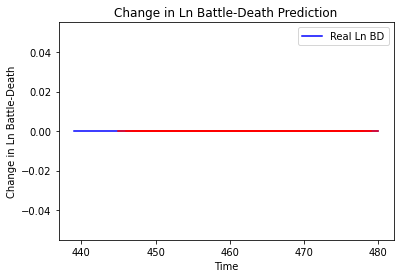

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
["Cote d'Ivoire"]
Building vanilla Model...
Model: "sequential_820"
_________________________________________________________________
Layer 

4/4 [==============================] - 0s 6ms/step - loss: 0.5647 - val_loss: 0.2853
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.5598 - val_loss: 0.2853
Epoch 67/100
4/4 [==============================] - 0s 6ms/step - loss: 0.5608 - val_loss: 0.2852
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 0.5574 - val_loss: 0.2852
Epoch 69/100
4/4 [==============================] - 0s 6ms/step - loss: 0.5577 - val_loss: 0.2851
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 0.5549 - val_loss: 0.2851
Epoch 71/100
4/4 [==============================] - 0s 6ms/step - loss: 0.5574 - val_loss: 0.2850
Epoch 72/100
4/4 [==============================] - 0s 6ms/step - loss: 0.5565 - val_loss: 0.2848
Epoch 73/100
4/4 [==============================] - 0s 7ms/step - loss: 0.5573 - val_loss: 0.2848
Epoch 74/100
4/4 [==============================] - 0s 6ms/step - loss: 0.5584 - val_loss: 0.2847
Epoch 75/100
4/4 [===============

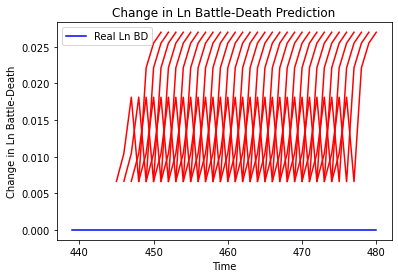

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+1', 'mse': 4.411838851949793e-05, 'mae': 0.006642167456448078, 'r2': 0.0, 'tadda_score': 0.006642167456448078}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+2', 'mse': 0.00029226422901823534, 'mae': 0.017095737159252167, 'r2': 0.0, 'tadda_score': 0.017095737159252167}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+3', 'mse': 0.0012401225717582204, 'mae': 0.03521537408232689, 'r2': 0.0, 'tadda_score': 0.03521537408232689}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+4', 'mse': 0.0017482230058397108, 'mae': 0.041811756789684296, 'r2': 0.0, 'tadda_score': 0.041811756789684296}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+5', 'mse': 0.0028622169572472544, 'mae': 0.05349969118833542, 'r2': 0.0, 'tadda_score': 0.05349969118833542}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+6', 'mse': 0.006241622147209525, 'mae'

Epoch 57/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
4/4 [============================

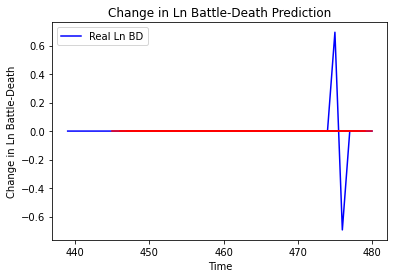

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ghana', 'country_id': 42, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Liberia']
Building vanilla Model...
Model: "sequential_822"
_________________________________________________________________
Layer (type)                 Output Shape      

4/4 [==============================] - 0s 7ms/step - loss: 1.2239 - val_loss: 3.4476e-04
Epoch 64/100
4/4 [==============================] - 0s 8ms/step - loss: 1.2143 - val_loss: 3.6639e-04
Epoch 65/100
4/4 [==============================] - 0s 8ms/step - loss: 1.2134 - val_loss: 3.3533e-04
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 1.2170 - val_loss: 3.7443e-04
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 1.2234 - val_loss: 3.6432e-04
Epoch 68/100
4/4 [==============================] - 0s 8ms/step - loss: 1.2130 - val_loss: 3.7173e-04
Epoch 69/100
4/4 [==============================] - 0s 8ms/step - loss: 1.2234 - val_loss: 3.4514e-04
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 1.2179 - val_loss: 2.9673e-04
Epoch 71/100
4/4 [==============================] - 0s 7ms/step - loss: 1.2155 - val_loss: 2.5544e-04
Epoch 72/100
4/4 [==============================] - 0s 7ms/step - loss: 1.2206 - val_loss: 2.49

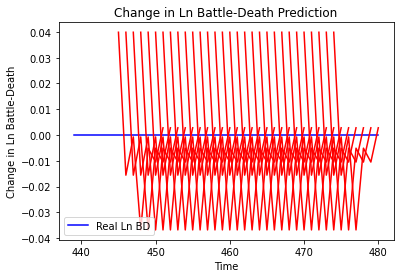

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Liberia', 'country_id': 43, 'step': 't+1', 'mse': 0.0015897955445588613, 'mae': 0.03987224027514458, 'r2': 0.0, 'tadda_score': 0.03987224027514458}
{'country': 'Liberia', 'country_id': 43, 'step': 't+2', 'mse': 0.0005909049322701115, 'mae': 0.02430853620171547, 'r2': 0.0, 'tadda_score': 0.02430853620171547}
{'country': 'Liberia', 'country_id': 43, 'step': 't+3', 'mse': 0.0005555772657936942, 'mae': 0.02357068657875061, 'r2': 0.0, 'tadda_score': 0.02357068657875061}
{'country': 'Liberia', 'country_id': 43, 'step': 't+4', 'mse': 0.00017501130540781284, 'mae': 0.013229183852672577, 'r2': 0.0, 'tadda_score': 0.013229183852672577}
{'country': 'Liberia', 'country_id': 43, 'step': 't+5', 'mse': 7.623485235086491e-06, 'mae': 0.00276106595993042, 'r2': 0.0, 'tadda_score': 0.00276106595993042}
{'country': 'Liberia', 'country_id': 43, 'step': 't+6', 'mse': 0.0001753648643198014, 'mae': 0.013242539949715137, 'r2': 0.0, 'tad

4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
4/4 [==============================] - 0s 7ms/

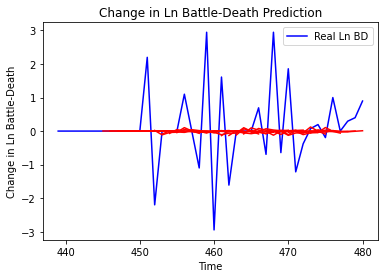

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+1', 'mse': 1.6742776543631133, 'mae': 0.8335248412330749, 'r2': -0.015278527382594831, 'tadda_score': 0.8465746639916477}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+2', 'mse': 1.2153790525381603, 'mae': 0.7374995573037526, 'r2': -0.027045985543387108, 'tadda_score': 0.749499747397866}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+3', 'mse': 2.079107497536221, 'mae': 0.9197378957385883, 'r2': -0.042883405759973625, 'tadda_score': 0.9401895886028871}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+4', 'mse': 2.449831263009633, 'mae': 1.0383192531516663, 'r2': -0.10361105329287468, 'tadda_score': 1.069929188651394}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+5', 'mse': 2.3406549435409576, 'mae': 0.950955364773219, 'r2': -0.12284161414109773, 'tadda_score': 0.968839185729171}
{'country': 'Burkina Faso', 'country_id': 47, 'step

4/4 [==============================] - 0s 7ms/step - loss: 0.2645 - val_loss: 1.7168e-05
Epoch 59/100
4/4 [==============================] - 0s 8ms/step - loss: 0.2645 - val_loss: 2.2888e-05
Epoch 60/100
4/4 [==============================] - 0s 7ms/step - loss: 0.2625 - val_loss: 2.5965e-05
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.2642 - val_loss: 2.2698e-05
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.2633 - val_loss: 2.1495e-05
Epoch 63/100
4/4 [==============================] - 0s 8ms/step - loss: 0.2635 - val_loss: 1.8529e-05
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.2641 - val_loss: 2.2307e-05
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.2640 - val_loss: 2.2723e-05
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.2644 - val_loss: 1.7457e-05
Epoch 67/100
4/4 [==============================] - 0s 8ms/step - loss: 0.2621 - val_loss: 1.19

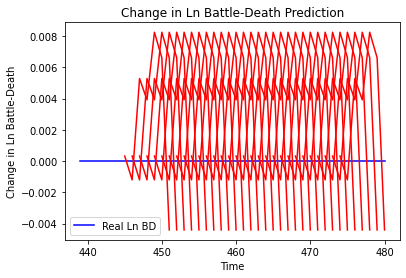

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea', 'country_id': 48, 'step': 't+1', 'mse': 1.0265981215205194e-07, 'mae': 0.0003204056993126869, 'r2': 0.0, 'tadda_score': 0.0003204056993126869}
{'country': 'Guinea', 'country_id': 48, 'step': 't+2', 'mse': 7.835225483733554e-07, 'mae': 0.0008851680904626846, 'r2': 0.0, 'tadda_score': 0.0008851680904626846}
{'country': 'Guinea', 'country_id': 48, 'step': 't+3', 'mse': 1.9374135748425692e-05, 'mae': 0.0044016060419380665, 'r2': 0.0, 'tadda_score': 0.0044016060419380665}
{'country': 'Guinea', 'country_id': 48, 'step': 't+4', 'mse': 6.926362908643569e-05, 'mae': 0.008322477340698242, 'r2': 0.0, 'tadda_score': 0.008322477340698242}
{'country': 'Guinea', 'country_id': 48, 'step': 't+5', 'mse': 0.0003161247692787944, 'mae': 0.017779897898435593, 'r2': 0.0, 'tadda_score': 0.017779897898435593}
{'country': 'Guinea', 'country_id': 48, 'step': 't+6', 'mse': 0.0005954910578270245, 'mae': 0.024402685463428497, 'r2': 

4/4 [==============================] - 0s 8ms/step - loss: 0.6861 - val_loss: 5.7829e-05
Epoch 60/100
4/4 [==============================] - 0s 9ms/step - loss: 0.6827 - val_loss: 6.3167e-05
Epoch 61/100
4/4 [==============================] - 0s 8ms/step - loss: 0.6861 - val_loss: 7.3678e-05
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.6788 - val_loss: 7.7636e-05
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.6817 - val_loss: 6.7561e-05
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.6866 - val_loss: 7.7879e-05
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.6936 - val_loss: 7.7926e-05
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.6855 - val_loss: 8.1165e-05
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 0.6798 - val_loss: 1.0211e-04
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 0.6785 - val_loss: 1.22

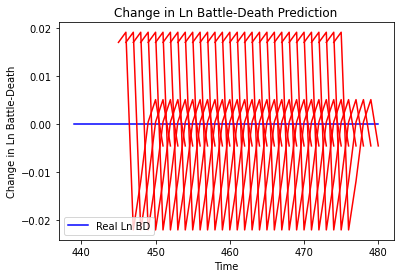

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+1', 'mse': 0.00028761761275558975, 'mae': 0.01695929281413555, 'r2': 0.0, 'tadda_score': 0.01695929281413555}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+2', 'mse': 0.001298098761315425, 'mae': 0.036029137670993805, 'r2': 0.0, 'tadda_score': 0.036029137670993805}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+3', 'mse': 0.0001943875051012324, 'mae': 0.013942291960120201, 'r2': 0.0, 'tadda_score': 0.013942291960120201}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+4', 'mse': 3.991326092304265e-06, 'mae': 0.001997830346226692, 'r2': 0.0, 'tadda_score': 0.001997830346226692}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+5', 'mse': 0.00027863049614490487, 'mae': 0.016692228615283966, 'r2': 0.0, 'tadda_score': 0.016692228615283966}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+6', 'mse': 0.00013579736927116573, '

4/4 [==============================] - 0s 7ms/step - loss: 1.3190 - val_loss: 3.0664
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 1.3160 - val_loss: 3.0652
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 1.3150 - val_loss: 3.0640
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 1.3109 - val_loss: 3.0628
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 1.3148 - val_loss: 3.0616
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 1.3206 - val_loss: 3.0603
Epoch 67/100
4/4 [==============================] - 0s 9ms/step - loss: 1.3180 - val_loss: 3.0592
Epoch 68/100
4/4 [==============================] - 0s 8ms/step - loss: 1.3093 - val_loss: 3.0578
Epoch 69/100
4/4 [==============================] - 0s 7ms/step - loss: 1.3106 - val_loss: 3.0567
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 1.3182 - val_loss: 3.0554
Epoch 71/100
4/4 [===============

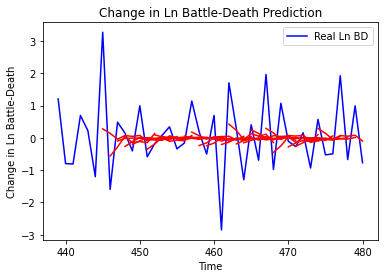

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mali', 'country_id': 50, 'step': 't+1', 'mse': 0.9793763499843268, 'mae': 0.70516293164089, 'r2': 0.22420427026111012, 'tadda_score': 0.7425887329230176}
{'country': 'Mali', 'country_id': 50, 'step': 't+2', 'mse': 1.2550832918946326, 'mae': 0.876083653243627, 'r2': -0.29633399319318876, 'tadda_score': 1.057204332336531}
{'country': 'Mali', 'country_id': 50, 'step': 't+3', 'mse': 1.242465561233843, 'mae': 0.9222755065691762, 'r2': -0.09441330805072079, 'tadda_score': 1.0888354558380737}
{'country': 'Mali', 'country_id': 50, 'step': 't+4', 'mse': 1.7862451835849549, 'mae': 1.1112474495843587, 'r2': -0.1944641702022385, 'tadda_score': 1.3202530226658324}
{'country': 'Mali', 'country_id': 50, 'step': 't+5', 'mse': 1.494578844408465, 'mae': 1.0042742099976818, 'r2': -0.3803149986595358, 'tadda_score': 1.1773006291958226}
{'country': 'Mali', 'country_id': 50, 'step': 't+6', 'mse': 1.8372201088409323, 'mae': 1.11386314

4/4 [==============================] - 0s 7ms/step - loss: 1.6597 - val_loss: 0.4300
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 1.6559 - val_loss: 0.4300
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 1.6687 - val_loss: 0.4301
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 1.6614 - val_loss: 0.4301
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 1.6542 - val_loss: 0.4301
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 1.6518 - val_loss: 0.4301
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 1.6461 - val_loss: 0.4299
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 1.6492 - val_loss: 0.4297
Epoch 69/100
4/4 [==============================] - 0s 7ms/step - loss: 1.6485 - val_loss: 0.4295
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 1.6614 - val_loss: 0.4293
Epoch 71/100
4/4 [===============

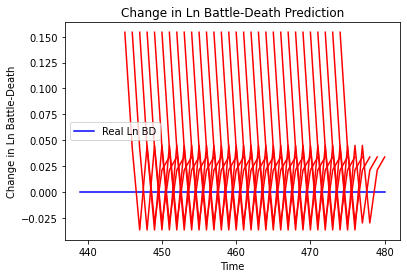

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Senegal', 'country_id': 52, 'step': 't+1', 'mse': 0.023833371084302835, 'mae': 0.15438060462474823, 'r2': 0.0, 'tadda_score': 0.15438060462474823}
{'country': 'Senegal', 'country_id': 52, 'step': 't+2', 'mse': 0.03864952888433493, 'mae': 0.19659483432769775, 'r2': 0.0, 'tadda_score': 0.19659483432769775}
{'country': 'Senegal', 'country_id': 52, 'step': 't+3', 'mse': 0.025553066231873922, 'mae': 0.1598532646894455, 'r2': 0.0, 'tadda_score': 0.1598532646894455}
{'country': 'Senegal', 'country_id': 52, 'step': 't+4', 'mse': 0.0419425434975631, 'mae': 0.20479878783226013, 'r2': 0.0, 'tadda_score': 0.20479878783226013}
{'country': 'Senegal', 'country_id': 52, 'step': 't+5', 'mse': 0.017579826447777558, 'mae': 0.1325889378786087, 'r2': 0.0, 'tadda_score': 0.1325889378786087}
{'country': 'Senegal', 'country_id': 52, 'step': 't+6', 'mse': 0.02364158345923162, 'mae': 0.1537581980228424, 'r2': 0.0, 'tadda_score': 0.153758

4/4 [==============================] - 0s 7ms/step - loss: 2.2175 - val_loss: 3.3414e-04
Epoch 60/100
4/4 [==============================] - 0s 7ms/step - loss: 2.1972 - val_loss: 3.4261e-04
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 2.1973 - val_loss: 3.2015e-04
Epoch 62/100
4/4 [==============================] - 0s 8ms/step - loss: 2.2081 - val_loss: 3.2488e-04
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 2.1976 - val_loss: 3.2655e-04
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 2.1898 - val_loss: 3.1515e-04
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 2.2029 - val_loss: 3.1807e-04
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 2.1898 - val_loss: 3.0815e-04
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 2.1922 - val_loss: 2.8811e-04
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 2.1974 - val_loss: 2.66

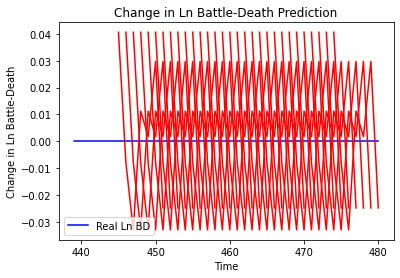

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+1', 'mse': 0.0016474025915452217, 'mae': 0.04058820754289627, 'r2': 0.0, 'tadda_score': 0.04058820754289627}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+2', 'mse': 0.001065838203745395, 'mae': 0.03264717757701874, 'r2': 0.0, 'tadda_score': 0.03264717757701874}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+3', 'mse': 1.0322576161903019e-07, 'mae': 0.0003212876617908478, 'r2': 0.0, 'tadda_score': 0.0003212876617908478}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+4', 'mse': 0.00011913336200250826, 'mae': 0.010914823040366173, 'r2': 0.0, 'tadda_score': 0.010914823040366173}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+5', 'mse': 0.0004248023130544766, 'mae': 0.020610732957720757, 'r2': 0.0, 'tadda_score': 0.020610732957720757}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+6', 'mse': 0.002532840978177797, 'mae': 0.

Epoch 57/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
4/4 [============================

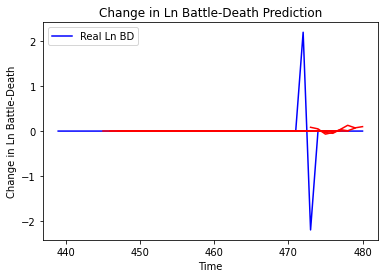

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'The Gambia', 'country_id': 54, 'step': 't+1', 'mse': 0.3344635006101058, 'mae': 0.14996411150983358, 'r2': -0.03918075081110084, 'tadda_score': 0.1527766746410865}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+2', 'mse': 0.3206260668255155, 'mae': 0.15051594397715115, 'r2': 0.00381226577617777, 'tadda_score': 0.15051594397715115}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+3', 'mse': 0.16120023594117155, 'mae': 0.07751101607477359, 'r2': -0.03624223256999781, 'tadda_score': 0.07751101607477359}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+4', 'mse': 0.16098918190446462, 'mae': 0.0752661927729417, 'r2': -0.03488551553473296, 'tadda_score': 0.0752661927729417}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+5', 'mse': 0.16154135505451395, 'mae': 0.07832870462929896, 'r2': -0.0384350459335665, 'tadda_score': 0.07832870462929896}
{'country': 'The Gambia', 'country_id': 54, 'step'

4/4 [==============================] - 0s 7ms/step - loss: 0.6436 - val_loss: 8.6873e-05
Epoch 59/100
4/4 [==============================] - 0s 8ms/step - loss: 0.6406 - val_loss: 8.5169e-05
Epoch 60/100
4/4 [==============================] - 0s 7ms/step - loss: 0.6409 - val_loss: 7.5348e-05
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.6418 - val_loss: 7.7334e-05
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.6394 - val_loss: 7.9378e-05
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.6407 - val_loss: 6.6428e-05
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.6421 - val_loss: 4.6268e-05
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.6397 - val_loss: 3.3841e-05
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.6406 - val_loss: 2.8098e-05
Epoch 67/100
4/4 [==============================] - 0s 8ms/step - loss: 0.6418 - val_loss: 4.02

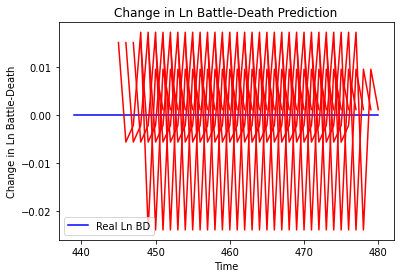

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Djibouti', 'country_id': 55, 'step': 't+1', 'mse': 0.0002269329672758497, 'mae': 0.015064294449985027, 'r2': 0.0, 'tadda_score': 0.015064294449985027}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+2', 'mse': 8.89818996930615e-05, 'mae': 0.009433021768927574, 'r2': 0.0, 'tadda_score': 0.009433021768927574}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+3', 'mse': 5.2766458980079735e-05, 'mae': 0.007264052517712116, 'r2': 0.0, 'tadda_score': 0.007264052517712116}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+4', 'mse': 0.0005989788003008117, 'mae': 0.024474043399095535, 'r2': 0.0, 'tadda_score': 0.024474043399095535}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+5', 'mse': 3.8412158284831244e-05, 'mae': 0.006197754293680191, 'r2': 0.0, 'tadda_score': 0.006197754293680191}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+6', 'mse': 0.00024698046363286555, 'mae': 0.01571561209857464, '

4/4 [==============================] - 0s 7ms/step - loss: 1.9920 - val_loss: 0.0292
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 2.0050 - val_loss: 0.0292
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 1.9829 - val_loss: 0.0292
Epoch 64/100
4/4 [==============================] - 0s 8ms/step - loss: 1.9949 - val_loss: 0.0292
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 1.9845 - val_loss: 0.0293
Epoch 66/100
4/4 [==============================] - 0s 9ms/step - loss: 2.0018 - val_loss: 0.0293
Epoch 67/100
4/4 [==============================] - 0s 8ms/step - loss: 1.9973 - val_loss: 0.0293
Epoch 68/100
4/4 [==============================] - 0s 8ms/step - loss: 1.9928 - val_loss: 0.0294
Epoch 69/100
4/4 [==============================] - 0s 7ms/step - loss: 1.9777 - val_loss: 0.0294
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 1.9952 - val_loss: 0.0294
Epoch 71/100
4/4 [===============

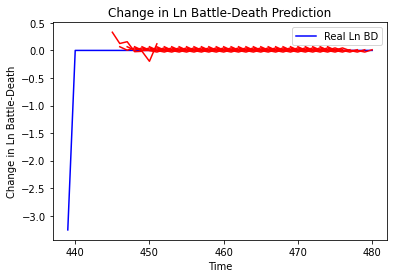

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Eritrea', 'country_id': 56, 'step': 't+1', 'mse': 0.007924010723637437, 'mae': 0.07543829406301181, 'r2': 0.0, 'tadda_score': 0.07543829406301181}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+2', 'mse': 0.01181342922691054, 'mae': 0.08401716301838556, 'r2': 0.0, 'tadda_score': 0.08401716301838556}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+3', 'mse': 0.025588447304839407, 'mae': 0.1327424831688404, 'r2': 0.0, 'tadda_score': 0.1327424831688404}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+4', 'mse': 0.024072246026696907, 'mae': 0.12937070777018864, 'r2': 0.0, 'tadda_score': 0.12937070777018864}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+5', 'mse': 0.018045750062127407, 'mae': 0.11961563850442568, 'r2': 0.0, 'tadda_score': 0.11961563850442568}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+6', 'mse': 0.00810797023024618, 'mae': 0.08454216346144676, 'r2': 0.0, 'tadda_score': 0.0

Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 4.7364 - val_loss: 2.6905
Epoch 63/100
4/4 [==============================] - 0s 8ms/step - loss: 4.7332 - val_loss: 2.6889
Epoch 64/100
4/4 [==============================] - 0s 8ms/step - loss: 4.7193 - val_loss: 2.6873
Epoch 65/100
4/4 [==============================] - 0s 8ms/step - loss: 4.7240 - val_loss: 2.6856
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 4.7457 - val_loss: 2.6841
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 4.7321 - val_loss: 2.6827
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 4.6949 - val_loss: 2.6811
Epoch 69/100
4/4 [==============================] - 0s 7ms/step - loss: 4.6943 - val_loss: 2.6797
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 4.7234 - val_loss: 2.6782
Epoch 71/100
4/4 [==============================] - 0s 7ms/step - loss: 4.7457 - val_loss: 2.6769
Epoch 72/100
4/4 [==

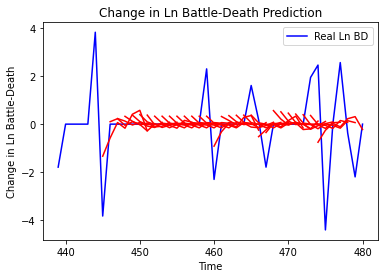

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+1', 'mse': 1.0657922843534786, 'mae': 0.7306465045726304, 'r2': 0.21876545381750434, 'tadda_score': 0.7731606221314276}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+2', 'mse': 2.848686135319684, 'mae': 1.1566705970646647, 'r2': -0.42774428146173826, 'tadda_score': 1.2679620513003773}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+3', 'mse': 2.90190927990522, 'mae': 1.164419778057109, 'r2': -0.454419399994894, 'tadda_score': 1.2922010390641}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+4', 'mse': 3.018896784817525, 'mae': 1.184926005073558, 'r2': -0.5130528307088313, 'tadda_score': 1.3176109620612568}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+5', 'mse': 2.4263112246416454, 'mae': 0.9514205971044011, 'r2': -0.2160525278927523, 'tadda_score': 1.0169893099548128}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+6', 'mse': 1.980987044524119,

4/4 [==============================] - 0s 6ms/step - loss: 0.9314 - val_loss: 1.0077
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.9368 - val_loss: 1.0073
Epoch 63/100
4/4 [==============================] - 0s 6ms/step - loss: 0.9353 - val_loss: 1.0070
Epoch 64/100
4/4 [==============================] - 0s 6ms/step - loss: 0.9381 - val_loss: 1.0066
Epoch 65/100
4/4 [==============================] - 0s 6ms/step - loss: 0.9325 - val_loss: 1.0064
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.9326 - val_loss: 1.0060
Epoch 67/100
4/4 [==============================] - 0s 6ms/step - loss: 0.9305 - val_loss: 1.0057
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 0.9379 - val_loss: 1.0053
Epoch 69/100
4/4 [==============================] - 0s 6ms/step - loss: 0.9316 - val_loss: 1.0050
Epoch 70/100
4/4 [==============================] - 0s 6ms/step - loss: 0.9322 - val_loss: 1.0046
Epoch 71/100
4/4 [===============

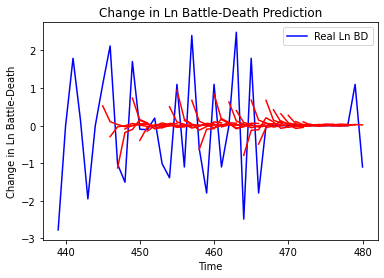

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Algeria', 'country_id': 67, 'step': 't+1', 'mse': 1.1323381212557526, 'mae': 0.7940800189824995, 'r2': 0.29001199300084823, 'tadda_score': 0.8252157300563748}
{'country': 'Algeria', 'country_id': 67, 'step': 't+2', 'mse': 2.472165684385016, 'mae': 1.169892788330354, 'r2': -0.46785739981838126, 'tadda_score': 1.4331206698215384}
{'country': 'Algeria', 'country_id': 67, 'step': 't+3', 'mse': 2.612119446419551, 'mae': 1.2607011128486207, 'r2': -0.4561386996857877, 'tadda_score': 1.5367409025277705}
{'country': 'Algeria', 'country_id': 67, 'step': 't+4', 'mse': 2.71181199644871, 'mae': 1.254925917505724, 'r2': -0.32835020593419206, 'tadda_score': 1.4776335894261827}
{'country': 'Algeria', 'country_id': 67, 'step': 't+5', 'mse': 1.8169045544646216, 'mae': 0.979238892621779, 'r2': -0.3500849692708068, 'tadda_score': 1.139496152471238}
{'country': 'Algeria', 'country_id': 67, 'step': 't+6', 'mse': 2.037939883172763, 'm

4/4 [==============================] - 0s 7ms/step - loss: 0.1940 - val_loss: 1.4690
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1939 - val_loss: 1.4687
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1945 - val_loss: 1.4684
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1944 - val_loss: 1.4681
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1941 - val_loss: 1.4677
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1932 - val_loss: 1.4674
Epoch 67/100
4/4 [==============================] - 0s 9ms/step - loss: 0.1922 - val_loss: 1.4671
Epoch 68/100
4/4 [==============================] - 0s 8ms/step - loss: 0.1945 - val_loss: 1.4670
Epoch 69/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1921 - val_loss: 1.4668
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1900 - val_loss: 1.4666
Epoch 71/100
4/4 [===============

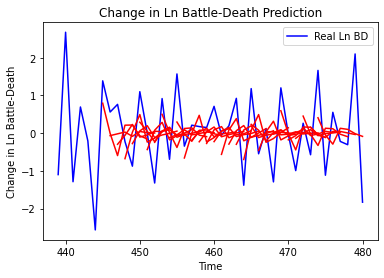

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cameroon', 'country_id': 69, 'step': 't+1', 'mse': 0.5420527082624934, 'mae': 0.6484595705335511, 'r2': 0.26397288024661425, 'tadda_score': 0.7156344077751212}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+2', 'mse': 1.151099316687391, 'mae': 0.9310078599634628, 'r2': -0.5594896767712227, 'tadda_score': 1.1717474004708588}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+3', 'mse': 1.075569674125191, 'mae': 0.8261960306372299, 'r2': -0.09751671439783616, 'tadda_score': 0.8674298154978508}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+4', 'mse': 1.1291029852497882, 'mae': 0.8559000128333349, 'r2': -0.2820669171635928, 'tadda_score': 0.9660006715679744}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+5', 'mse': 1.4320269943158057, 'mae': 0.9690818423813191, 'r2': -0.43967864027129133, 'tadda_score': 1.1539318705385535}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+6', 'mse': 1.7881394

Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.7552 - val_loss: 2.4331
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.7530 - val_loss: 2.4326
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.7560 - val_loss: 2.4321
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.7550 - val_loss: 2.4315
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.7567 - val_loss: 2.4307
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.7548 - val_loss: 2.4302
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 0.7540 - val_loss: 2.4298
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 0.7530 - val_loss: 2.4294
Epoch 69/100
4/4 [==============================] - 0s 8ms/step - loss: 0.7507 - val_loss: 2.4290
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 0.7535 - val_loss: 2.4284
Epoch 71/100
4/4 [==

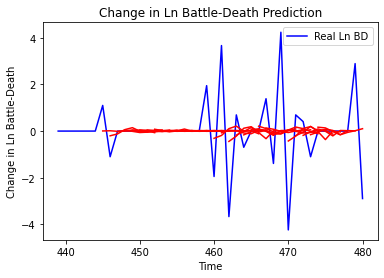

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+1', 'mse': 2.395360307137314, 'mae': 0.923921660679472, 'r2': 0.09429097446143042, 'tadda_score': 0.9454026168563888}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+2', 'mse': 1.4370092267407588, 'mae': 0.7766434441578163, 'r2': 0.018418350271974138, 'tadda_score': 0.800709114901401}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+3', 'mse': 2.223449669196057, 'mae': 0.8965150902026771, 'r2': 0.05135626907409818, 'tadda_score': 0.9205381743588923}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+4', 'mse': 2.457685963654524, 'mae': 0.8464943310449143, 'r2': -0.01656120561122254, 'tadda_score': 0.8591349703152598}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+5', 'mse': 2.684585958054161, 'mae': 0.9242582243732044, 'r2': -0.05936162670734957, 'tadda_score': 0.97897421949122

4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 58/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 59/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 60/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 62/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 63/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 64/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 65/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 66/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 

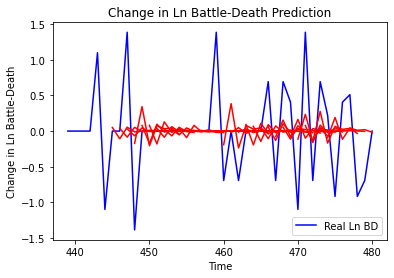

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tunisia', 'country_id': 73, 'step': 't+1', 'mse': 0.3649384011527977, 'mae': 0.39834876279585935, 'r2': 0.11603089817663537, 'tadda_score': 0.4041252351855574}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+2', 'mse': 0.3930873097815621, 'mae': 0.426775848610437, 'r2': 0.044736481344820445, 'tadda_score': 0.4388514028794925}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+3', 'mse': 0.48776451344712574, 'mae': 0.47029963307192185, 'r2': -0.02084588504496665, 'tadda_score': 0.47488972337405144}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+4', 'mse': 0.49442527304955186, 'mae': 0.4590380735742362, 'r2': -0.023931869145592533, 'tadda_score': 0.4608115183546952}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+5', 'mse': 0.5035340868003977, 'mae': 0.5061849248203899, 'r2': -0.1445553108840325, 'tadda_score': 0.5466983739826347}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+6', 'mse': 0.59789

4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
4/4 [==============================] - 0s 7ms/

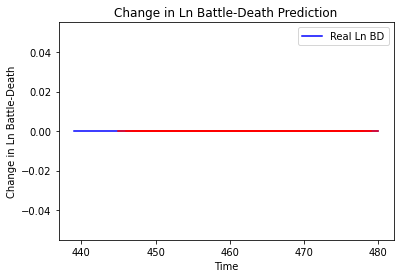

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Benin', 'country_id': 74, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Equatorial Guinea']
Building vanilla Model...
Model: "sequential_838"
_________________________________________________________________
Layer (type)                 Output S

4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
4/4 [==============================] - 0s 8ms/

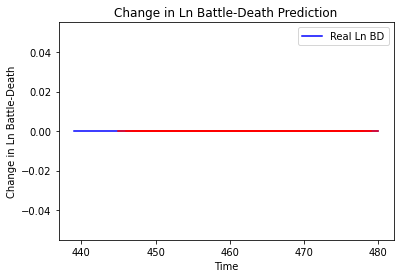

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Niger']
Building vanilla Model...
Model: "sequential_839"
_______________________________

4/4 [==============================] - 0s 8ms/step - loss: 0.8619 - val_loss: 1.6626
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.8682 - val_loss: 1.6618
Epoch 66/100
4/4 [==============================] - 0s 8ms/step - loss: 0.8630 - val_loss: 1.6610
Epoch 67/100
4/4 [==============================] - 0s 8ms/step - loss: 0.8670 - val_loss: 1.6603
Epoch 68/100
4/4 [==============================] - 0s 8ms/step - loss: 0.8636 - val_loss: 1.6596
Epoch 69/100
4/4 [==============================] - 0s 8ms/step - loss: 0.8641 - val_loss: 1.6588
Epoch 70/100
4/4 [==============================] - 0s 8ms/step - loss: 0.8609 - val_loss: 1.6581
Epoch 71/100
4/4 [==============================] - 0s 7ms/step - loss: 0.8692 - val_loss: 1.6574
Epoch 72/100
4/4 [==============================] - 0s 7ms/step - loss: 0.8643 - val_loss: 1.6566
Epoch 73/100
4/4 [==============================] - 0s 8ms/step - loss: 0.8591 - val_loss: 1.6559
Epoch 74/100
4/4 [===============

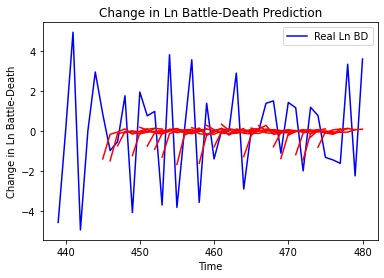

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Niger', 'country_id': 78, 'step': 't+1', 'mse': 3.2508400047574146, 'mae': 1.4958671193223714, 'r2': 0.24955234570856044, 'tadda_score': 1.7088244583111523}
{'country': 'Niger', 'country_id': 78, 'step': 't+2', 'mse': 5.587752135459323, 'mae': 1.9697923804619804, 'r2': -0.42297594876268296, 'tadda_score': 2.287153734793156}
{'country': 'Niger', 'country_id': 78, 'step': 't+3', 'mse': 5.2365366790870755, 'mae': 1.7721953879491552, 'r2': -0.3520500644473714, 'tadda_score': 2.1288978577351636}
{'country': 'Niger', 'country_id': 78, 'step': 't+4', 'mse': 5.5125964017523, 'mae': 1.9519500800132434, 'r2': -0.2149701694634627, 'tadda_score': 2.259407560592858}
{'country': 'Niger', 'country_id': 78, 'step': 't+5', 'mse': 6.8570673447333945, 'mae': 2.10813212728116, 'r2': -0.24655181840022244, 'tadda_score': 2.436293609545759}
{'country': 'Niger', 'country_id': 78, 'step': 't+6', 'mse': 6.183885564739169, 'mae': 1.957069

4/4 [==============================] - 0s 8ms/step - loss: 0.5395 - val_loss: 1.1677
Epoch 62/100
4/4 [==============================] - 0s 8ms/step - loss: 0.5424 - val_loss: 1.1673
Epoch 63/100
4/4 [==============================] - 0s 8ms/step - loss: 0.5380 - val_loss: 1.1669
Epoch 64/100
4/4 [==============================] - 0s 8ms/step - loss: 0.5386 - val_loss: 1.1665
Epoch 65/100
4/4 [==============================] - 0s 8ms/step - loss: 0.5411 - val_loss: 1.1661
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.5462 - val_loss: 1.1660
Epoch 67/100
4/4 [==============================] - 0s 8ms/step - loss: 0.5391 - val_loss: 1.1659
Epoch 68/100
4/4 [==============================] - 0s 8ms/step - loss: 0.5412 - val_loss: 1.1660
Epoch 69/100
4/4 [==============================] - 0s 8ms/step - loss: 0.5387 - val_loss: 1.1660
Epoch 70/100
4/4 [==============================] - 0s 8ms/step - loss: 0.5422 - val_loss: 1.1661
Epoch 71/100
4/4 [===============

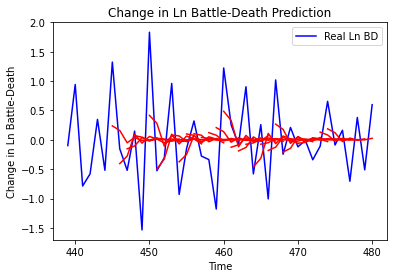

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Nigeria', 'country_id': 79, 'step': 't+1', 'mse': 0.4237442433102276, 'mae': 0.490996188219068, 'r2': 0.25854838850707307, 'tadda_score': 0.5221609084389384}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+2', 'mse': 0.858769897355068, 'mae': 0.7259646532598386, 'r2': -0.587169081367624, 'tadda_score': 0.8964906312687446}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+3', 'mse': 0.7852924719396508, 'mae': 0.6970700870662654, 'r2': -0.28171283255641, 'tadda_score': 0.8343427027970278}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+4', 'mse': 0.988896476972864, 'mae': 0.7647039551032555, 'r2': -0.3293837303968241, 'tadda_score': 0.9477394851290158}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+5', 'mse': 0.6414337020640168, 'mae': 0.6196654722340379, 'r2': -0.25289052953471813, 'tadda_score': 0.7158845038088634}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+6', 'mse': 0.6874337307299605, 

4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
4/4 [==============================] - 0s 7ms/

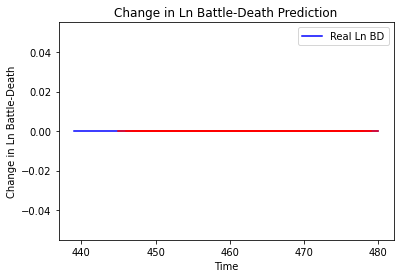

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Togo']
Building vanilla Model...
Model: "sequential_842"
____

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
4/4 [==============================] - 0s 9ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
4/4 [==============================] - 0s 8ms/

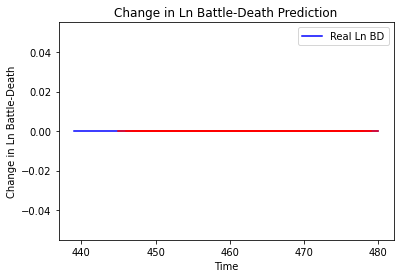

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Togo', 'country_id': 81, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Somalia']
Building vanilla Model...
Model: "sequential_843"
_________________________________________________________________
Layer (type)                 Output Shape             

4/4 [==============================] - 0s 7ms/step - loss: 2.6196 - val_loss: 0.3658
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 2.6183 - val_loss: 0.3657
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 2.6159 - val_loss: 0.3657
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 2.6117 - val_loss: 0.3657
Epoch 69/100
4/4 [==============================] - 0s 7ms/step - loss: 2.6205 - val_loss: 0.3657
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 2.6166 - val_loss: 0.3657
Epoch 71/100
4/4 [==============================] - 0s 7ms/step - loss: 2.6081 - val_loss: 0.3657
Epoch 72/100
4/4 [==============================] - 0s 8ms/step - loss: 2.6116 - val_loss: 0.3657
Epoch 73/100
4/4 [==============================] - 0s 6ms/step - loss: 2.6215 - val_loss: 0.3657
Epoch 74/100
4/4 [==============================] - 0s 7ms/step - loss: 2.6099 - val_loss: 0.3656
Epoch 75/100
4/4 [===============

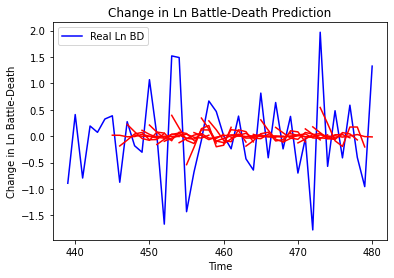

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Somalia', 'country_id': 120, 'step': 't+1', 'mse': 0.598200086449071, 'mae': 0.6088118599881152, 'r2': 0.2147396250347361, 'tadda_score': 0.6557161281659621}
{'country': 'Somalia', 'country_id': 120, 'step': 't+2', 'mse': 1.1640679565507215, 'mae': 0.8039092981830405, 'r2': -0.18705910314553154, 'tadda_score': 0.9250995836484102}
{'country': 'Somalia', 'country_id': 120, 'step': 't+3', 'mse': 1.0378585752175222, 'mae': 0.7627527140291901, 'r2': -0.3004222617761674, 'tadda_score': 0.8832205175322663}
{'country': 'Somalia', 'country_id': 120, 'step': 't+4', 'mse': 0.7915534401086064, 'mae': 0.7355572035893599, 'r2': -0.14191841959234797, 'tadda_score': 0.8026287891328135}
{'country': 'Somalia', 'country_id': 120, 'step': 't+5', 'mse': 0.8153166383656761, 'mae': 0.6607992797881539, 'r2': -0.05762291265526498, 'tadda_score': 0.7334083124942008}
{'country': 'Somalia', 'country_id': 120, 'step': 't+6', 'mse': 0.767641

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
4/4 [==============================] - 0s 8ms/

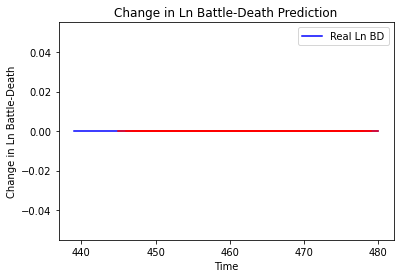

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Botswana', 'country_id': 154, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Burundi']
Building vanilla Model...
Model: "sequential_845"
_________________________________________________________________
Layer (type)       

4/4 [==============================] - 0s 8ms/step - loss: 1.9448 - val_loss: 1.6173
Epoch 66/100
4/4 [==============================] - 0s 8ms/step - loss: 1.9364 - val_loss: 1.6167
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 1.9581 - val_loss: 1.6164
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 1.9463 - val_loss: 1.6159
Epoch 69/100
4/4 [==============================] - 0s 7ms/step - loss: 1.9230 - val_loss: 1.6154
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 1.9435 - val_loss: 1.6152
Epoch 71/100
4/4 [==============================] - 0s 8ms/step - loss: 1.9351 - val_loss: 1.6148
Epoch 72/100
4/4 [==============================] - 0s 7ms/step - loss: 1.9447 - val_loss: 1.6145
Epoch 73/100
4/4 [==============================] - 0s 7ms/step - loss: 1.9364 - val_loss: 1.6142
Epoch 74/100
4/4 [==============================] - 0s 7ms/step - loss: 1.9589 - val_loss: 1.6139
Epoch 75/100
4/4 [===============

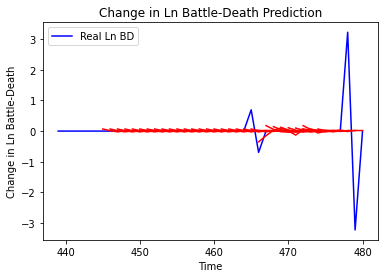

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burundi', 'country_id': 155, 'step': 't+1', 'mse': 0.024315670965917684, 'mae': 0.10999964189746064, 'r2': 0.240851750488004, 'tadda_score': 0.10999964189746064}
{'country': 'Burundi', 'country_id': 155, 'step': 't+2', 'mse': 0.059426379548180676, 'mae': 0.15584241710323177, 'r2': -0.8553233456757399, 'tadda_score': 0.16369572492657186}
{'country': 'Burundi', 'country_id': 155, 'step': 't+3', 'mse': 0.05165535282673865, 'mae': 0.13094748916445256, 'r2': -0.6127077361471127, 'tadda_score': 0.13638410033998968}
{'country': 'Burundi', 'country_id': 155, 'step': 't+4', 'mse': 0.04622974411800104, 'mae': 0.12905227429884752, 'r2': -0.4433173311055074, 'tadda_score': 0.13307225294131123}
{'country': 'Burundi', 'country_id': 155, 'step': 't+5', 'mse': 0.03729752982222927, 'mae': 0.0962226410678832, 'r2': -0.1644488246017941, 'tadda_score': 0.09832947055218698}
{'country': 'Burundi', 'country_id': 155, 'step': 't+6', 'm

Epoch 61/100
4/4 [==============================] - 0s 6ms/step - loss: 2.4850 - val_loss: 0.1850
Epoch 62/100
4/4 [==============================] - 0s 6ms/step - loss: 2.4858 - val_loss: 0.1847
Epoch 63/100
4/4 [==============================] - 0s 6ms/step - loss: 2.4765 - val_loss: 0.1846
Epoch 64/100
4/4 [==============================] - 0s 6ms/step - loss: 2.4742 - val_loss: 0.1843
Epoch 65/100
4/4 [==============================] - 0s 6ms/step - loss: 2.4591 - val_loss: 0.1842
Epoch 66/100
4/4 [==============================] - 0s 6ms/step - loss: 2.4781 - val_loss: 0.1841
Epoch 67/100
4/4 [==============================] - 0s 6ms/step - loss: 2.4767 - val_loss: 0.1839
Epoch 68/100
4/4 [==============================] - 0s 6ms/step - loss: 2.4759 - val_loss: 0.1837
Epoch 69/100
4/4 [==============================] - 0s 6ms/step - loss: 2.4695 - val_loss: 0.1834
Epoch 70/100
4/4 [==============================] - 0s 6ms/step - loss: 2.4768 - val_loss: 0.1833
Epoch 71/100
4/4 [==

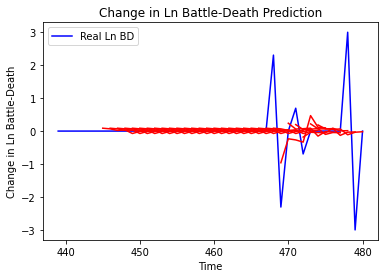

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Rwanda', 'country_id': 156, 'step': 't+1', 'mse': 0.2510697006781312, 'mae': 0.2404857568207836, 'r2': 0.34869996145988746, 'tadda_score': 0.2404857568207836}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+2', 'mse': 0.48804438314563847, 'mae': 0.38017838421100936, 'r2': -0.2660361831535272, 'tadda_score': 0.39978335124884606}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+3', 'mse': 0.41151439034513204, 'mae': 0.38325745548224927, 'r2': -0.4744966308729901, 'tadda_score': 0.40349502548989136}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+4', 'mse': 0.44002171410723867, 'mae': 0.41042897481745005, 'r2': -0.1926610209822388, 'tadda_score': 0.41042897481745005}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+5', 'mse': 0.43502532669248234, 'mae': 0.28594165324196735, 'r2': -0.1791185154097663, 'tadda_score': 0.29356962769255557}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+6', 'mse': 0.4

4/4 [==============================] - 0s 14ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
4/4 [==============================] - 0s 7ms

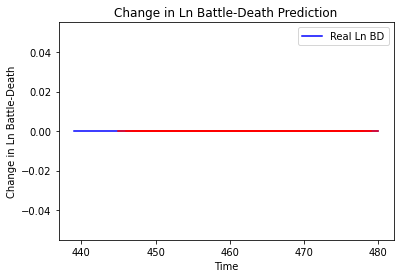

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zambia', 'country_id': 157, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Zimbabwe']
Building vanilla Model...
Model: "sequential_848"
_________________________________________________________________
Layer (type)                 Out

4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
4/4 [==============================] - 0s 6ms/

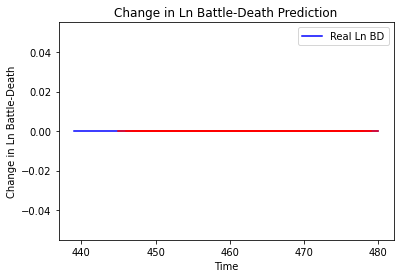

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Comoros']
Building vanilla Model...
Model: "sequential_849"
_________________________________________________________________
Layer (type)       

Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1296 - val_loss: 4.9658e-06
Epoch 64/100
4/4 [==============================] - 0s 8ms/step - loss: 0.1300 - val_loss: 6.3741e-06
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1321 - val_loss: 7.0641e-06
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1301 - val_loss: 5.3588e-06
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1321 - val_loss: 5.8624e-06
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1299 - val_loss: 9.0112e-06
Epoch 69/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1300 - val_loss: 1.1746e-05
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1302 - val_loss: 1.3844e-05
Epoch 71/100
4/4 [==============================] - 0s 8ms/step - loss: 0.1285 - val_loss: 1.5795e-05
Epoch 72/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1304 - v

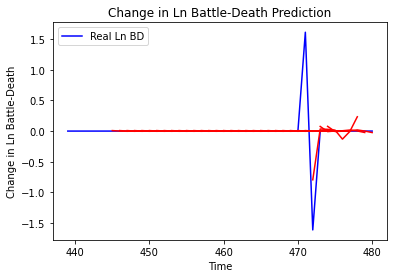

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Comoros', 'country_id': 159, 'step': 't+1', 'mse': 0.10811645294426754, 'mae': 0.09271015259199733, 'r2': 0.37391313424436534, 'tadda_score': 0.09271015259199733}
{'country': 'Comoros', 'country_id': 159, 'step': 't+2', 'mse': 0.1985801843738768, 'mae': 0.14428695357788002, 'r2': -0.14994935414599753, 'tadda_score': 0.1465185152187784}
{'country': 'Comoros', 'country_id': 159, 'step': 't+3', 'mse': 0.19761323633189593, 'mae': 0.14040854745306966, 'r2': -0.1443498967788155, 'tadda_score': 0.1426791230658531}
{'country': 'Comoros', 'country_id': 159, 'step': 't+4', 'mse': 0.10320852666541673, 'mae': 0.08687845273600715, 'r2': -0.23654986668068534, 'tadda_score': 0.08687845273600715}
{'country': 'Comoros', 'country_id': 159, 'step': 't+5', 'mse': 0.11195248931548436, 'mae': 0.09673665102918146, 'r2': -0.3413120040596411, 'tadda_score': 0.09673665102918146}
{'country': 'Comoros', 'country_id': 159, 'step': 't+6', 'm

4/4 [==============================] - 0s 7ms/step - loss: 0.1455 - val_loss: 5.5691e-06
Epoch 59/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1442 - val_loss: 3.3184e-06
Epoch 60/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1454 - val_loss: 3.3376e-06
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1455 - val_loss: 6.5713e-06
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1471 - val_loss: 7.1205e-06
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1463 - val_loss: 8.7566e-06
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1450 - val_loss: 6.3842e-06
Epoch 65/100
4/4 [==============================] - 0s 8ms/step - loss: 0.1449 - val_loss: 2.2755e-06
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1446 - val_loss: 2.6663e-06
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1443 - val_loss: 5.46

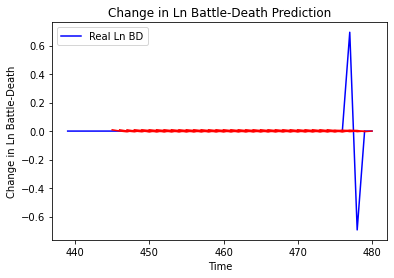

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Lesotho', 'country_id': 160, 'step': 't+1', 'mse': 7.658758555163792e-05, 'mae': 0.008751433342695236, 'r2': 0.0, 'tadda_score': 0.008751433342695236}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+2', 'mse': 8.637780392201089e-05, 'mae': 0.009293965995311737, 'r2': 0.0, 'tadda_score': 0.009293965995311737}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+3', 'mse': 1.8662221528813758e-05, 'mae': 0.004319979343563318, 'r2': 0.0, 'tadda_score': 0.004319979343563318}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+4', 'mse': 9.447915082518021e-05, 'mae': 0.009720038622617722, 'r2': 0.0, 'tadda_score': 0.009720038622617722}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+5', 'mse': 0.000179008609519693, 'mae': 0.013379409909248352, 'r2': 0.0, 'tadda_score': 0.013379409909248352}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+6', 'mse': 8.845269616853182e-05, 'mae': 0.009404929354786873, 'r

4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
4/4 [==============================] - 0s 7ms/

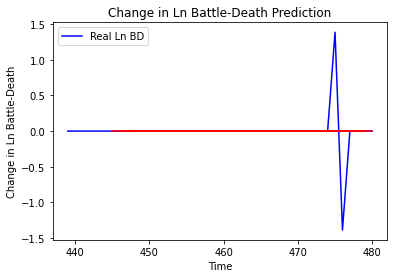

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Malawi', 'country_id': 161, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mozambique']
Building vanilla Model...
Model: "sequential_852"
_________________________________________________________________
Layer (type)                 O

4/4 [==============================] - 0s 7ms/step - loss: 1.0832 - val_loss: 0.6912
Epoch 66/100
4/4 [==============================] - 0s 8ms/step - loss: 1.0928 - val_loss: 0.6912
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 1.1162 - val_loss: 0.6912
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 1.0834 - val_loss: 0.6912
Epoch 69/100
4/4 [==============================] - 0s 7ms/step - loss: 1.0735 - val_loss: 0.6911
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 1.1153 - val_loss: 0.6912
Epoch 71/100
4/4 [==============================] - 0s 7ms/step - loss: 1.0807 - val_loss: 0.6912
Epoch 72/100
4/4 [==============================] - 0s 7ms/step - loss: 1.0900 - val_loss: 0.6912
Epoch 73/100
4/4 [==============================] - 0s 7ms/step - loss: 1.1242 - val_loss: 0.6911
Epoch 74/100
4/4 [==============================] - 0s 7ms/step - loss: 1.0860 - val_loss: 0.6911
Epoch 75/100
4/4 [===============

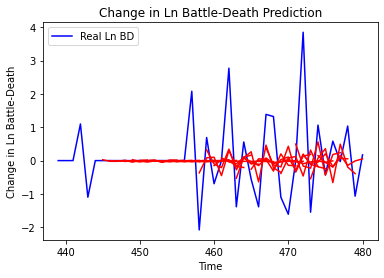

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mozambique', 'country_id': 162, 'step': 't+1', 'mse': 1.3516328567999905, 'mae': 0.7259153873357026, 'r2': 0.14103145477433376, 'tadda_score': 0.7353587192180603}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+2', 'mse': 2.1803806166938586, 'mae': 0.9392306624573418, 'r2': -0.139579355172065, 'tadda_score': 1.0136426504052627}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+3', 'mse': 2.0750391948436335, 'mae': 1.0210310243414322, 'r2': -0.0842350698888068, 'tadda_score': 1.0557331860409658}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+4', 'mse': 1.870121362502717, 'mae': 0.9485261391390325, 'r2': -0.2409328691254291, 'tadda_score': 1.0818051851827863}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+5', 'mse': 1.0100684563539446, 'mae': 0.6628304294146777, 'r2': -0.23330092823337312, 'tadda_score': 0.7148628695704224}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+6',

4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
4/4 [==============================] - 0s 7ms/

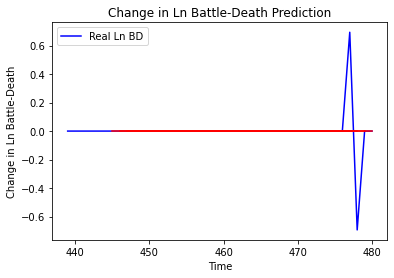

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Africa', 'country_id': 163, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Swaziland']
Building vanilla Model...
Model: "sequential_854"
_______________________________________________________

4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
4/4 [==============================] - 0s 7ms/

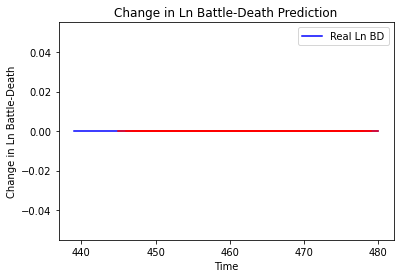

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Swaziland', 'country_id': 164, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Angola']
Building vanilla Model...
Model: "sequential_855"
_________________________________________________________________
Layer (type) 

4/4 [==============================] - 0s 8ms/step - loss: 3.3717 - val_loss: 0.0877
Epoch 66/100
4/4 [==============================] - 0s 8ms/step - loss: 3.3573 - val_loss: 0.0876
Epoch 67/100
4/4 [==============================] - 0s 8ms/step - loss: 3.3798 - val_loss: 0.0875
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 3.3764 - val_loss: 0.0874
Epoch 69/100
4/4 [==============================] - 0s 8ms/step - loss: 3.3715 - val_loss: 0.0874
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 3.3689 - val_loss: 0.0872
Epoch 71/100
4/4 [==============================] - 0s 8ms/step - loss: 3.3809 - val_loss: 0.0871
Epoch 72/100
4/4 [==============================] - 0s 8ms/step - loss: 3.3713 - val_loss: 0.0870
Epoch 73/100
4/4 [==============================] - 0s 8ms/step - loss: 3.3712 - val_loss: 0.0869
Epoch 74/100
4/4 [==============================] - 0s 8ms/step - loss: 3.3713 - val_loss: 0.0867
Epoch 75/100
4/4 [===============

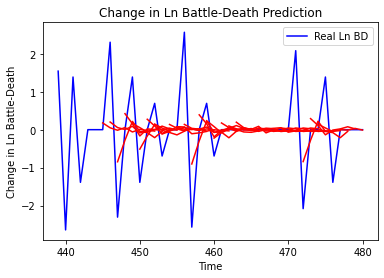

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Angola', 'country_id': 165, 'step': 't+1', 'mse': 0.8389842669786505, 'mae': 0.5909606330034177, 'r2': 0.34068581603105375, 'tadda_score': 0.5921529725131432}
{'country': 'Angola', 'country_id': 165, 'step': 't+2', 'mse': 1.6596771723302988, 'mae': 0.8806334506036878, 'r2': -0.30425413633493603, 'tadda_score': 0.9595331953775923}
{'country': 'Angola', 'country_id': 165, 'step': 't+3', 'mse': 1.0080978523559811, 'mae': 0.675113048347315, 'r2': -0.14932679553853068, 'tadda_score': 0.7053099187140472}
{'country': 'Angola', 'country_id': 165, 'step': 't+4', 'mse': 1.012162239220161, 'mae': 0.7073500810170501, 'r2': 0.05702866151179853, 'tadda_score': 0.7277280020817448}
{'country': 'Angola', 'country_id': 165, 'step': 't+5', 'mse': 1.0264905741749828, 'mae': 0.6250567910607371, 'r2': -0.04840519861937187, 'tadda_score': 0.6394881715412649}
{'country': 'Angola', 'country_id': 165, 'step': 't+6', 'mse': 1.369857455838

4/4 [==============================] - 0s 7ms/step - loss: 1.9353 - val_loss: 0.2231
Epoch 62/100
4/4 [==============================] - 0s 8ms/step - loss: 1.9400 - val_loss: 0.2231
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 1.9388 - val_loss: 0.2231
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 1.9425 - val_loss: 0.2230
Epoch 65/100
4/4 [==============================] - 0s 8ms/step - loss: 1.9460 - val_loss: 0.2230
Epoch 66/100
4/4 [==============================] - 0s 8ms/step - loss: 1.9425 - val_loss: 0.2230
Epoch 67/100
4/4 [==============================] - 0s 8ms/step - loss: 1.9277 - val_loss: 0.2230
Epoch 68/100
4/4 [==============================] - 0s 8ms/step - loss: 1.9396 - val_loss: 0.2230
Epoch 69/100
4/4 [==============================] - 0s 8ms/step - loss: 1.9316 - val_loss: 0.2230
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 1.9377 - val_loss: 0.2229
Epoch 71/100
4/4 [===============

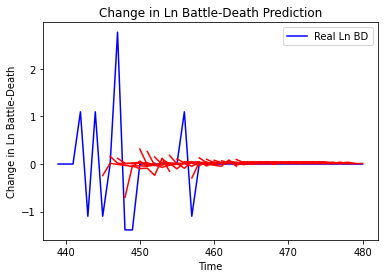

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo', 'country_id': 166, 'step': 't+1', 'mse': 0.40587328179288396, 'mae': 0.3248014102922466, 'r2': 0.1942422355349006, 'tadda_score': 0.3248014102922466}
{'country': 'Congo', 'country_id': 166, 'step': 't+2', 'mse': 0.8750707286119748, 'mae': 0.5181108655894997, 'r2': -0.15147269920726059, 'tadda_score': 0.563979937371135}
{'country': 'Congo', 'country_id': 166, 'step': 't+3', 'mse': 0.7594684055759672, 'mae': 0.48536108796998045, 'r2': -0.28050723560690205, 'tadda_score': 0.5340864053885557}
{'country': 'Congo', 'country_id': 166, 'step': 't+4', 'mse': 0.818530428856743, 'mae': 0.5220441953858155, 'r2': -0.17836387779804141, 'tadda_score': 0.5773261568467238}
{'country': 'Congo', 'country_id': 166, 'step': 't+5', 'mse': 0.7922669951079446, 'mae': 0.5283219545106508, 'r2': -0.3358075363238844, 'tadda_score': 0.5804386848231572}
{'country': 'Congo', 'country_id': 166, 'step': 't+6', 'mse': 0.8109309634829757,

4/4 [==============================] - 0s 7ms/step - loss: 3.0015 - val_loss: 3.3019
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 3.0023 - val_loss: 3.3006
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 3.0071 - val_loss: 3.2994
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 3.0115 - val_loss: 3.2983
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 3.0218 - val_loss: 3.2974
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 3.0009 - val_loss: 3.2964
Epoch 67/100
4/4 [==============================] - 0s 8ms/step - loss: 3.0005 - val_loss: 3.2953
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 2.9919 - val_loss: 3.2943
Epoch 69/100
4/4 [==============================] - 0s 7ms/step - loss: 3.0079 - val_loss: 3.2932
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 2.9933 - val_loss: 3.2924
Epoch 71/100
4/4 [===============

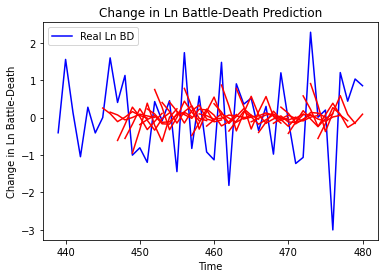

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+1', 'mse': 0.8767178459331478, 'mae': 0.7794760361693603, 'r2': 0.19896456221416225, 'tadda_score': 0.9049628869078857}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+2', 'mse': 2.3512753706284446, 'mae': 1.2311308526196494, 'r2': -0.6629430649389585, 'tadda_score': 1.55909245964869}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+3', 'mse': 2.3211940840386966, 'mae': 1.2040621026226848, 'r2': -0.3456697655053784, 'tadda_score': 1.4601432707278896}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+4', 'mse': 2.699508789545381, 'mae': 1.3044695295471367, 'r2': -0.549501786778769, 'tadda_score': 1.607148838051003}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+5', 'mse': 3.2086945436306293, 'mae': 1.409926697583192, 'r2': -0.7479139190440693, 'tadda_score': 1.78781820706645}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+6', 'mse':

4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
4/4 [==============================] - 0s 10ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
4/4 [==============================] - 0s 8ms

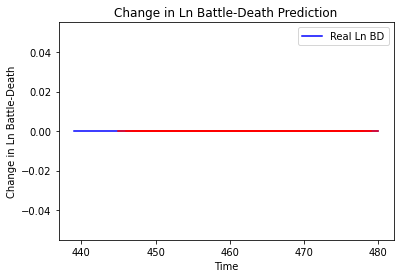

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Gabon', 'country_id': 169, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Namibia']
Building vanilla Model...
Model: "sequential_859"
_________________________________________________________________
Layer (type)                 Output Shap

Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1428 - val_loss: 4.0557e-06
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1426 - val_loss: 4.5653e-06
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1419 - val_loss: 5.2968e-06
Epoch 66/100
4/4 [==============================] - 0s 8ms/step - loss: 0.1427 - val_loss: 6.7534e-06
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1427 - val_loss: 3.9658e-06
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1420 - val_loss: 5.3356e-06
Epoch 69/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1427 - val_loss: 4.5859e-06
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1426 - val_loss: 4.1980e-06
Epoch 71/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1423 - val_loss: 2.7316e-06
Epoch 72/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1425 - v

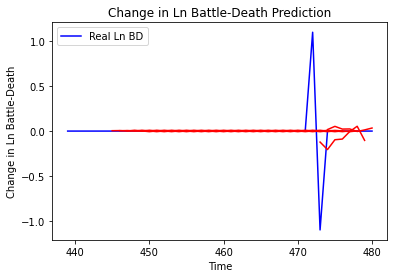

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Namibia', 'country_id': 170, 'step': 't+1', 'mse': 0.07172903399614507, 'mae': 0.07346774936984671, 'r2': 0.10854928843237988, 'tadda_score': 0.07346774936984671}
{'country': 'Namibia', 'country_id': 170, 'step': 't+2', 'mse': 0.08864921086529334, 'mae': 0.09500769784694604, 'r2': -0.10173520683438819, 'tadda_score': 0.0973179107968578}
{'country': 'Namibia', 'country_id': 170, 'step': 't+3', 'mse': 0.04583789791081159, 'mae': 0.06285499013660198, 'r2': -0.17863762146723872, 'tadda_score': 0.06285499013660198}
{'country': 'Namibia', 'country_id': 170, 'step': 't+4', 'mse': 0.04842234207036907, 'mae': 0.07310985484170761, 'r2': -0.24509187124463216, 'tadda_score': 0.07310985484170761}
{'country': 'Namibia', 'country_id': 170, 'step': 't+5', 'mse': 0.04273595737989336, 'mae': 0.06132910992650038, 'r2': -0.09887689996975624, 'tadda_score': 0.06132910992650038}
{'country': 'Namibia', 'country_id': 170, 'step': 't+6'

4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
4/4 [==============================] - 0s 8ms/

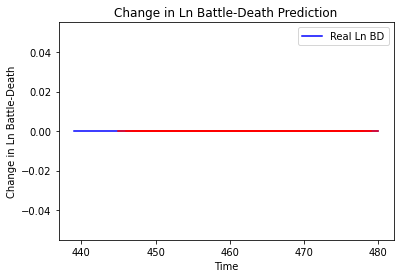

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Madagascar', 'country_id': 172, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mauritius']
Building vanilla Model...
Model: "sequential_861"
_________________________________________________________________
Lay

4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
4/4 [==============================] - 0s 7ms/

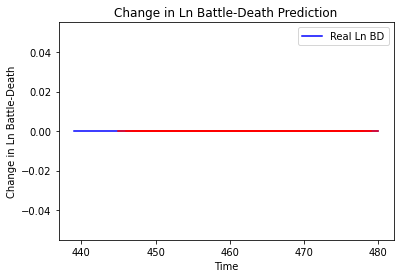

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritius', 'country_id': 173, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Seychelles']
Building vanilla Model...
Model: "sequential_862"
_________________________________________________________________
Layer (ty

4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
4/4 [==============================] - 0s 8ms/

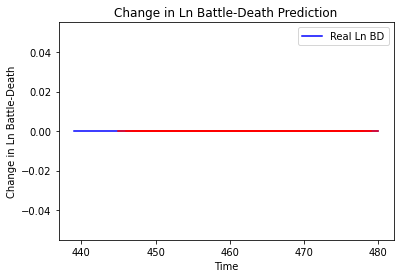

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Seychelles', 'country_id': 174, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Libya']
Building vanilla Model...
Model: "sequential_863"
_________________________________________________________________
Layer (

4/4 [==============================] - 0s 7ms/step - loss: 0.0314 - val_loss: 2.2945
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0314 - val_loss: 2.2946
Epoch 67/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0314 - val_loss: 2.2947
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0314 - val_loss: 2.2947
Epoch 69/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0314 - val_loss: 2.2947
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0314 - val_loss: 2.2947
Epoch 71/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0314 - val_loss: 2.2948
Epoch 72/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0314 - val_loss: 2.2947
Epoch 73/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0314 - val_loss: 2.2947
Epoch 74/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0314 - val_loss: 2.2947
Epoch 75/100
4/4 [===============

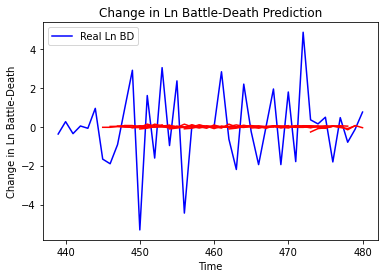

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Libya', 'country_id': 213, 'step': 't+1', 'mse': 4.700516484658435, 'mae': 1.676618455730681, 'r2': 0.029948454805167612, 'tadda_score': 1.6909786357932333}
{'country': 'Libya', 'country_id': 213, 'step': 't+2', 'mse': 5.57866564362524, 'mae': 1.8141057794559967, 'r2': -0.02980059847266614, 'tadda_score': 1.8589218424279463}
{'country': 'Libya', 'country_id': 213, 'step': 't+3', 'mse': 7.569751307287333, 'mae': 2.1362493683105392, 'r2': -0.019832966830166665, 'tadda_score': 2.1827786224415586}
{'country': 'Libya', 'country_id': 213, 'step': 't+4', 'mse': 6.023868835307147, 'mae': 2.002685297774272, 'r2': -0.04096068654104146, 'tadda_score': 2.0407051791096693}
{'country': 'Libya', 'country_id': 213, 'step': 't+5', 'mse': 7.473208385416766, 'mae': 2.293372119554401, 'r2': -0.027078597773178004, 'tadda_score': 2.3360220922415653}
{'country': 'Libya', 'country_id': 213, 'step': 't+6', 'mse': 6.497648025748522, 'mae

4/4 [==============================] - 0s 7ms/step - loss: 5.2068 - val_loss: 0.8418
Epoch 62/100
4/4 [==============================] - 0s 8ms/step - loss: 5.1593 - val_loss: 0.8415
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 5.1694 - val_loss: 0.8412
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 5.1974 - val_loss: 0.8408
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 5.1654 - val_loss: 0.8403
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 5.1601 - val_loss: 0.8401
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 5.1674 - val_loss: 0.8398
Epoch 68/100
4/4 [==============================] - 0s 8ms/step - loss: 5.1372 - val_loss: 0.8396
Epoch 69/100
4/4 [==============================] - 0s 8ms/step - loss: 5.1371 - val_loss: 0.8395
Epoch 70/100
4/4 [==============================] - 0s 8ms/step - loss: 5.1674 - val_loss: 0.8394
Epoch 71/100
4/4 [===============

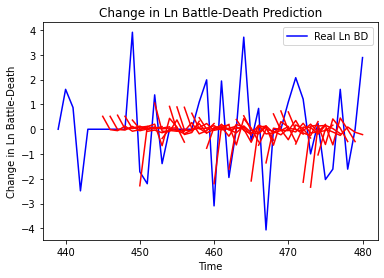

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Chad', 'country_id': 214, 'step': 't+1', 'mse': 2.6544870595234547, 'mae': 1.3056856775952261, 'r2': 0.0957092348388463, 'tadda_score': 1.4781619911067567}
{'country': 'Chad', 'country_id': 214, 'step': 't+2', 'mse': 6.490174766073367, 'mae': 2.000305858985018, 'r2': -0.5289883972878824, 'tadda_score': 2.43964435729924}
{'country': 'Chad', 'country_id': 214, 'step': 't+3', 'mse': 7.980678267402877, 'mae': 2.236582463832699, 'r2': -0.5280802608849642, 'tadda_score': 2.685263162704312}
{'country': 'Chad', 'country_id': 214, 'step': 't+4', 'mse': 11.103013654235497, 'mae': 2.8326335562038594, 'r2': -0.8207834682877764, 'tadda_score': 3.4938028358189444}
{'country': 'Chad', 'country_id': 214, 'step': 't+5', 'mse': 9.576114651092382, 'mae': 2.4963765083403344, 'r2': -1.0156590197441164, 'tadda_score': 3.0777181176991215}
{'country': 'Chad', 'country_id': 214, 'step': 't+6', 'mse': 7.450856413197759, 'mae': 2.15755303

4/4 [==============================] - 0s 7ms/step - loss: 0.5972 - val_loss: 2.2396
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.5919 - val_loss: 2.2380
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.5902 - val_loss: 2.2366
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.5893 - val_loss: 2.2351
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.5893 - val_loss: 2.2337
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.5885 - val_loss: 2.2322
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 0.5839 - val_loss: 2.2308
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 0.5934 - val_loss: 2.2293
Epoch 69/100
4/4 [==============================] - 0s 8ms/step - loss: 0.5895 - val_loss: 2.2281
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 0.5904 - val_loss: 2.2268
Epoch 71/100
4/4 [===============

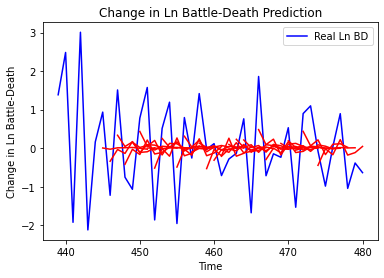

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Egypt', 'country_id': 222, 'step': 't+1', 'mse': 0.8112182084205621, 'mae': 0.7681779850517331, 'r2': 0.28022536559557576, 'tadda_score': 0.8017418631905932}
{'country': 'Egypt', 'country_id': 222, 'step': 't+2', 'mse': 1.339271770024842, 'mae': 0.9721119534686345, 'r2': -0.23839743845179528, 'tadda_score': 1.1241976454695206}
{'country': 'Egypt', 'country_id': 222, 'step': 't+3', 'mse': 1.1993263393440032, 'mae': 0.8827488155148906, 'r2': -0.29318029763590747, 'tadda_score': 1.0474287890873832}
{'country': 'Egypt', 'country_id': 222, 'step': 't+4', 'mse': 1.2414843193203629, 'mae': 0.933109767785053, 'r2': -0.007881278461058017, 'tadda_score': 1.0550244037562415}
{'country': 'Egypt', 'country_id': 222, 'step': 't+5', 'mse': 1.4595448811238856, 'mae': 1.0133472035965823, 'r2': -0.2302732532329279, 'tadda_score': 1.216988005304486}
{'country': 'Egypt', 'country_id': 222, 'step': 't+6', 'mse': 1.2910999802890646, 

4/4 [==============================] - 0s 6ms/step - loss: 2.7071 - val_loss: 7.8353e-04
Epoch 60/100
4/4 [==============================] - 0s 6ms/step - loss: 2.7182 - val_loss: 7.8777e-04
Epoch 61/100
4/4 [==============================] - 0s 6ms/step - loss: 2.7158 - val_loss: 8.0013e-04
Epoch 62/100
4/4 [==============================] - 0s 6ms/step - loss: 2.7241 - val_loss: 8.4514e-04
Epoch 63/100
4/4 [==============================] - 0s 6ms/step - loss: 2.7018 - val_loss: 9.3275e-04
Epoch 64/100
4/4 [==============================] - 0s 6ms/step - loss: 2.6996 - val_loss: 9.8346e-04
Epoch 65/100
4/4 [==============================] - 0s 6ms/step - loss: 2.6949 - val_loss: 0.0010
Epoch 66/100
4/4 [==============================] - 0s 6ms/step - loss: 2.7179 - val_loss: 0.0010
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 2.7144 - val_loss: 9.0532e-04
Epoch 68/100
4/4 [==============================] - 0s 6ms/step - loss: 2.7191 - val_loss: 8.3877e-04
E

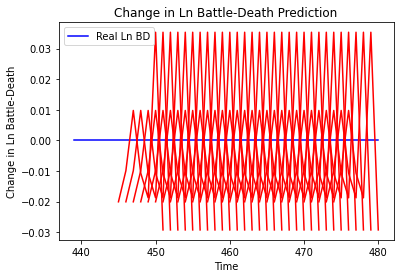

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Uganda', 'country_id': 235, 'step': 't+1', 'mse': 0.0004028168475003792, 'mae': 0.02007029764354229, 'r2': 0.0, 'tadda_score': 0.02007029764354229}
{'country': 'Uganda', 'country_id': 235, 'step': 't+2', 'mse': 0.0008989601220102394, 'mae': 0.029982663691043854, 'r2': 0.0, 'tadda_score': 0.029982663691043854}
{'country': 'Uganda', 'country_id': 235, 'step': 't+3', 'mse': 0.0004085338384620142, 'mae': 0.020212220028042793, 'r2': 0.0, 'tadda_score': 0.020212220028042793}
{'country': 'Uganda', 'country_id': 235, 'step': 't+4', 'mse': 0.0009550489655499629, 'mae': 0.03090386651456356, 'r2': 0.0, 'tadda_score': 0.03090386651456356}
{'country': 'Uganda', 'country_id': 235, 'step': 't+5', 'mse': 0.001580835758496768, 'mae': 0.03975972533226013, 'r2': 0.0, 'tadda_score': 0.03975972533226013}
{'country': 'Uganda', 'country_id': 235, 'step': 't+6', 'mse': 1.966819249688001e-05, 'mae': 0.0044348835945129395, 'r2': 0.0, 'ta

Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1196 - val_loss: 1.6895
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1195 - val_loss: 1.6886
Epoch 64/100
4/4 [==============================] - 0s 8ms/step - loss: 0.1184 - val_loss: 1.6877
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1184 - val_loss: 1.6866
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1185 - val_loss: 1.6858
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1189 - val_loss: 1.6847
Epoch 68/100
4/4 [==============================] - 0s 8ms/step - loss: 0.1193 - val_loss: 1.6837
Epoch 69/100
4/4 [==============================] - 0s 7ms/step - loss: 0.1183 - val_loss: 1.6828
Epoch 70/100
4/4 [==============================] - 0s 8ms/step - loss: 0.1181 - val_loss: 1.6816
Epoch 71/100
4/4 [==============================] - 0s 6ms/step - loss: 0.1187 - val_loss: 1.6805
Epoch 72/100
4/4 [==

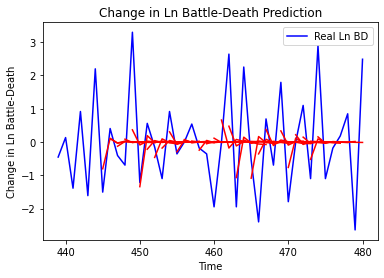

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Kenya', 'country_id': 237, 'step': 't+1', 'mse': 1.4670166593731817, 'mae': 0.9068331695137531, 'r2': 0.29202423544056777, 'tadda_score': 0.9207210187155118}
{'country': 'Kenya', 'country_id': 237, 'step': 't+2', 'mse': 2.3566092890085586, 'mae': 1.2604885057556108, 'r2': -0.23453749190013107, 'tadda_score': 1.4573762378044401}
{'country': 'Kenya', 'country_id': 237, 'step': 't+3', 'mse': 2.43489033218754, 'mae': 1.1961497230021698, 'r2': -0.11509004303295645, 'tadda_score': 1.3283493672995315}
{'country': 'Kenya', 'country_id': 237, 'step': 't+4', 'mse': 3.115216349723338, 'mae': 1.4249615608444985, 'r2': -0.10928530519530222, 'tadda_score': 1.5606862571131366}
{'country': 'Kenya', 'country_id': 237, 'step': 't+5', 'mse': 2.0354865334014023, 'mae': 1.1047597899952701, 'r2': -0.3438858438783532, 'tadda_score': 1.2941378479122294}
{'country': 'Kenya', 'country_id': 237, 'step': 't+6', 'mse': 2.4113183629873225, '

3/3 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
3/3 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
3/3 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
3/3 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
3/3 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
3/3 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
3/3 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
3/3 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
3/3 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
3/3 [==============================] - 0s 8ms/

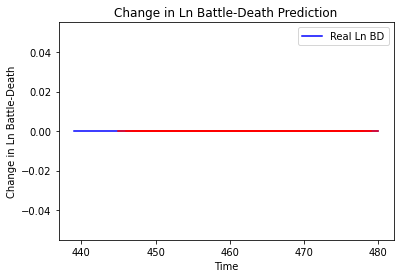

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tanzania', 'country_id': 242, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Morocco']
Building vanilla Model...
Model: "sequential_869"
_________________________________________________________________
Layer (type)       

Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0711 - val_loss: 2.8124e-06
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0714 - val_loss: 4.9149e-06
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0719 - val_loss: 4.1682e-06
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0719 - val_loss: 6.5594e-06
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0710 - val_loss: 5.0384e-06
Epoch 68/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0715 - val_loss: 9.9160e-06
Epoch 69/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0717 - val_loss: 1.6108e-05
Epoch 70/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0717 - val_loss: 1.4802e-05
Epoch 71/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0721 - val_loss: 1.5709e-05
Epoch 72/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0727 - v

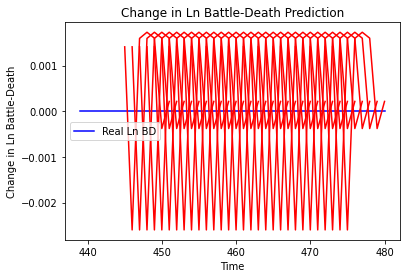

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Morocco', 'country_id': 243, 'step': 't+1', 'mse': 1.994191909078047e-06, 'mae': 0.0014121585991233587, 'r2': 0.0, 'tadda_score': 0.0014121585991233587}
{'country': 'Morocco', 'country_id': 243, 'step': 't+2', 'mse': 1.4091872410421286e-06, 'mae': 0.001187091926112771, 'r2': 0.0, 'tadda_score': 0.001187091926112771}
{'country': 'Morocco', 'country_id': 243, 'step': 't+3', 'mse': 1.6798249114635547e-07, 'mae': 0.00040985667146742344, 'r2': 0.0, 'tadda_score': 0.00040985667146742344}
{'country': 'Morocco', 'country_id': 243, 'step': 't+4', 'mse': 4.585620915804759e-06, 'mae': 0.0021414062939584255, 'r2': 0.0, 'tadda_score': 0.0021414062939584255}
{'country': 'Morocco', 'country_id': 243, 'step': 't+5', 'mse': 4.0226945707933816e-05, 'mae': 0.006342471577227116, 'r2': 0.0, 'tadda_score': 0.006342471577227116}
{'country': 'Morocco', 'country_id': 243, 'step': 't+6', 'mse': 3.557257608301592e-05, 'mae': 0.00596427498

4/4 [==============================] - 0s 7ms/step - loss: 0.0656 - val_loss: 0.1176
Epoch 62/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0657 - val_loss: 0.1175
Epoch 63/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0659 - val_loss: 0.1174
Epoch 64/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0666 - val_loss: 0.1173
Epoch 65/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0659 - val_loss: 0.1173
Epoch 66/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0671 - val_loss: 0.1172
Epoch 67/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0654 - val_loss: 0.1172
Epoch 68/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0655 - val_loss: 0.1171
Epoch 69/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0662 - val_loss: 0.1171
Epoch 70/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0664 - val_loss: 0.1170
Epoch 71/100
4/4 [===============

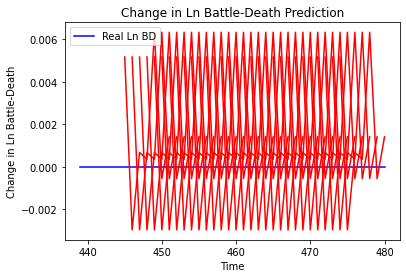

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritania', 'country_id': 244, 'step': 't+1', 'mse': 2.6644308584209547e-05, 'mae': 0.005161812528967857, 'r2': 0.0, 'tadda_score': 0.005161812528967857}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+2', 'mse': 4.832902055331714e-06, 'mae': 0.002198386238887906, 'r2': 0.0, 'tadda_score': 0.002198386238887906}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+3', 'mse': 8.249499312850718e-06, 'mae': 0.0028721941635012627, 'r2': 0.0, 'tadda_score': 0.0028721941635012627}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+4', 'mse': 1.0431038978053894e-05, 'mae': 0.003229711903259158, 'r2': 0.0, 'tadda_score': 0.003229711903259158}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+5', 'mse': 0.00015668451218600957, 'mae': 0.012517368420958519, 'r2': 0.0, 'tadda_score': 0.012517368420958519}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+6', 'mse': 0.0001431167684763958, 'mae': 0

Epoch 61/100
1/1 [==============================] - 0s 16ms/step - loss: 3.2066 - val_loss: 0.9278
Epoch 62/100
1/1 [==============================] - 0s 15ms/step - loss: 3.2080 - val_loss: 0.9278
Epoch 63/100
1/1 [==============================] - 0s 16ms/step - loss: 3.2363 - val_loss: 0.9278
Epoch 64/100
1/1 [==============================] - 0s 16ms/step - loss: 3.2494 - val_loss: 0.9278
Epoch 65/100
1/1 [==============================] - 0s 16ms/step - loss: 3.2143 - val_loss: 0.9278
Epoch 66/100
1/1 [==============================] - 0s 16ms/step - loss: 3.2083 - val_loss: 0.9278
Epoch 67/100
1/1 [==============================] - 0s 16ms/step - loss: 3.2012 - val_loss: 0.9278
Epoch 68/100
1/1 [==============================] - 0s 16ms/step - loss: 3.2159 - val_loss: 0.9278
Epoch 69/100
1/1 [==============================] - 0s 15ms/step - loss: 3.2540 - val_loss: 0.9278
Epoch 70/100
1/1 [==============================] - 0s 16ms/step - loss: 3.2318 - val_loss: 0.9278
Epoch 71/1

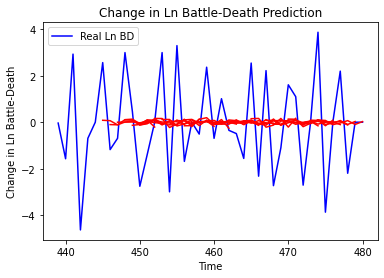

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sudan', 'country_id': 245, 'step': 't+1', 'mse': 3.780058396883817, 'mae': 1.6368645293482669, 'r2': 0.05530290753072442, 'tadda_score': 1.6493623090752492}
{'country': 'Sudan', 'country_id': 245, 'step': 't+2', 'mse': 4.360768032111554, 'mae': 1.7127226264565643, 'r2': -0.022034587823914542, 'tadda_score': 1.7888553660402156}
{'country': 'Sudan', 'country_id': 245, 'step': 't+3', 'mse': 3.9264428206486346, 'mae': 1.6716008959379467, 'r2': -0.012477596696346849, 'tadda_score': 1.6979959672358307}
{'country': 'Sudan', 'country_id': 245, 'step': 't+4', 'mse': 3.33536089376351, 'mae': 1.4415154194163409, 'r2': -0.004599296789850937, 'tadda_score': 1.4552302964356667}
{'country': 'Sudan', 'country_id': 245, 'step': 't+5', 'mse': 5.278021068577445, 'mae': 1.9439176919866183, 'r2': -0.0067180156850805695, 'tadda_score': 1.9613735728893258}
{'country': 'Sudan', 'country_id': 245, 'step': 't+6', 'mse': 4.730321667878919

1/1 [==============================] - 0s 20ms/step - loss: 6.4249 - val_loss: 4.1972
Epoch 61/100
1/1 [==============================] - 0s 20ms/step - loss: 6.5381 - val_loss: 4.1961
Epoch 62/100
1/1 [==============================] - 0s 23ms/step - loss: 6.5269 - val_loss: 4.1951
Epoch 63/100
1/1 [==============================] - 0s 22ms/step - loss: 6.5741 - val_loss: 4.1940
Epoch 64/100
1/1 [==============================] - 0s 21ms/step - loss: 6.5432 - val_loss: 4.1929
Epoch 65/100
1/1 [==============================] - 0s 21ms/step - loss: 6.4739 - val_loss: 4.1919
Epoch 66/100
1/1 [==============================] - 0s 19ms/step - loss: 6.5137 - val_loss: 4.1909
Epoch 67/100
1/1 [==============================] - 0s 20ms/step - loss: 6.5112 - val_loss: 4.1897
Epoch 68/100
1/1 [==============================] - 0s 16ms/step - loss: 6.4916 - val_loss: 4.1887
Epoch 69/100
1/1 [==============================] - 0s 17ms/step - loss: 6.4122 - val_loss: 4.1876
Epoch 70/100
1/1 [=====

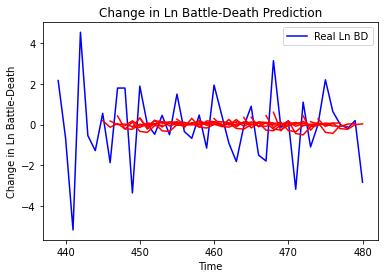

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Sudan', 'country_id': 246, 'step': 't+1', 'mse': 2.050047195458267, 'mae': 1.1283616188282068, 'r2': 0.078465566071235, 'tadda_score': 1.1914595302804605}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+2', 'mse': 2.892223933535206, 'mae': 1.3591716344890978, 'r2': -0.07024731632303194, 'tadda_score': 1.4746039878068353}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+3', 'mse': 2.987672524972317, 'mae': 1.41096989527643, 'r2': -0.14269883806642825, 'tadda_score': 1.5214159182240592}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+4', 'mse': 3.3856521232376537, 'mae': 1.5373033767182178, 'r2': -0.0740577534521849, 'tadda_score': 1.6074692316590296}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+5', 'mse': 2.6321006275810053, 'mae': 1.2751175558753376, 'r2': -0.04349779363762285, 'tadda_score': 1.3092395889200334}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+

In [44]:
np.random.seed(1)
tf.random.set_seed(1)
model = Sequential()
summary_model(dataset=df,
              modelname = "Vanilla",
              pred_africa=True,
              period=period_test, 
              epochs=100, 
              batch_size=64, 
              look_back=6, 
              look_forward=7,
              num_neurons=6, 
              val_split=0.2)

['Cape Verde']
Building vanilla Model...
Model: "sequential_874"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_856 (LSTM)              (None, 6)                 192       
_________________________________________________________________
dropout_1712 (Dropout)       (None, 6)                 0         
_________________________________________________________________
dense_1712 (Dense)           (None, 6)                 42        
_________________________________________________________________
dropout_1713 (Dropout)       (None, 6)                 0         
_________________________________________________________________
dense_1713 (Dense)           (None, 7)                 49        
Total params: 283
Trainable params: 283
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
16/16 [==============================] - 0s 21ms/step - loss: 0.000

16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 69/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 70/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 71/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 72/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 73/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 74/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 75/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 76/100
16/16 [=====================

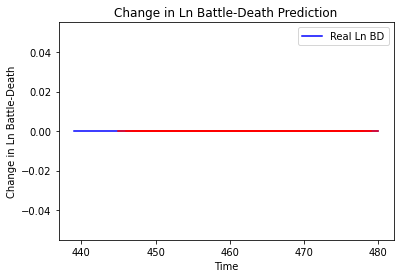

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Cape Verde', 'country_id': 40, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
["Cote d'Ivoire"]
Building vanilla Model...
Model: "sequential_875"
_________________________________________________________________
Layer 

Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5511 - val_loss: 0.2825
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 0.5514 - val_loss: 0.2823
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 0.5501 - val_loss: 0.2821
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5521 - val_loss: 0.2822
Epoch 68/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5487 - val_loss: 0.2822
Epoch 69/100
16/16 [==============================] - 0s 5ms/step - loss: 0.5452 - val_loss: 0.2820
Epoch 70/100
16/16 [==============================] - 0s 5ms/step - loss: 0.5456 - val_loss: 0.2823
Epoch 71/100
16/16 [==============================] - 0s 6ms/step - loss: 0.5462 - val_loss: 0.2825
Epoch 72/100
16/16 [==============================] - 0s 5ms/step - loss: 0.5434 - val_loss: 0.2826
Epoch 73/100
16/16 [==============================] - 0s 5ms/step - loss: 0.5529 - val_loss: 0.2828


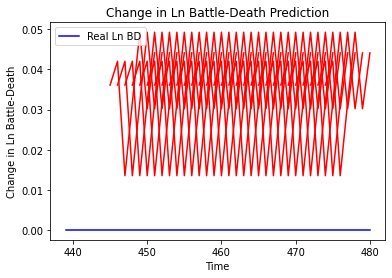

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+1', 'mse': 0.001304254345324607, 'mae': 0.03611446171998978, 'r2': 0.0, 'tadda_score': 0.03611446171998978}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+2', 'mse': 0.006108395566162328, 'mae': 0.07815622538328171, 'r2': 0.0, 'tadda_score': 0.07815622538328171}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+3', 'mse': 0.008405328545140256, 'mae': 0.09168057888746262, 'r2': 0.0, 'tadda_score': 0.09168057888746262}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+4', 'mse': 0.015235262552778295, 'mae': 0.12343120574951172, 'r2': 0.0, 'tadda_score': 0.12343120574951172}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+5', 'mse': 0.017076022596601348, 'mae': 0.13067525625228882, 'r2': 0.0, 'tadda_score': 0.13067525625228882}
{'country': "Cote d'Ivoire", 'country_id': 41, 'step': 't+6', 'mse': 0.025888823342148592, 'mae': 0.16090004

Epoch 56/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
16/16 [========

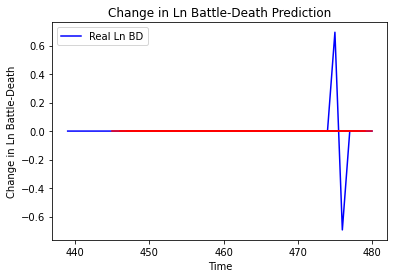

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ghana', 'country_id': 42, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Ghana', 'country_id': 42, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Liberia']
Building vanilla Model...
Model: "sequential_877"
_________________________________________________________________
Layer (type)                 Output Shape      

Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 1.2039 - val_loss: 4.1610e-04
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 1.1955 - val_loss: 8.9499e-04
Epoch 64/100
16/16 [==============================] - 0s 5ms/step - loss: 1.1904 - val_loss: 8.6993e-04
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 1.1979 - val_loss: 4.7744e-04
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 1.2014 - val_loss: 5.2715e-04
Epoch 67/100
16/16 [==============================] - 0s 5ms/step - loss: 1.2144 - val_loss: 4.9307e-04
Epoch 68/100
16/16 [==============================] - 0s 5ms/step - loss: 1.1965 - val_loss: 5.6422e-04
Epoch 69/100
16/16 [==============================] - 0s 4ms/step - loss: 1.1985 - val_loss: 4.0482e-04
Epoch 70/100
16/16 [==============================] - 0s 4ms/step - loss: 1.2061 - val_loss: 3.3007e-04
Epoch 71/100
16/16 [==============================] - 0s 4ms/ste

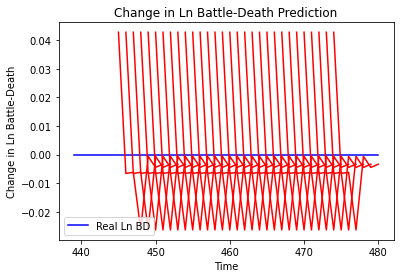

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Liberia', 'country_id': 43, 'step': 't+1', 'mse': 0.001829632223234512, 'mae': 0.042774200439453125, 'r2': 0.0, 'tadda_score': 0.042774200439453125}
{'country': 'Liberia', 'country_id': 43, 'step': 't+2', 'mse': 0.001308692988164717, 'mae': 0.036175861954689026, 'r2': 0.0, 'tadda_score': 0.036175861954689026}
{'country': 'Liberia', 'country_id': 43, 'step': 't+3', 'mse': 0.0008991964823155119, 'mae': 0.029986605048179626, 'r2': 0.0, 'tadda_score': 0.029986605048179626}
{'country': 'Liberia', 'country_id': 43, 'step': 't+4', 'mse': 1.3310580154760054e-05, 'mae': 0.003648366779088974, 'r2': 0.0, 'tadda_score': 0.003648366779088974}
{'country': 'Liberia', 'country_id': 43, 'step': 't+5', 'mse': 9.253160031350363e-05, 'mae': 0.00961933471262455, 'r2': 0.0, 'tadda_score': 0.00961933471262455}
{'country': 'Liberia', 'country_id': 43, 'step': 't+6', 'mse': 2.647393184623901e-05, 'mae': 0.005145282484591007, 'r2': 0.0, 

16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
16/16 [=====================

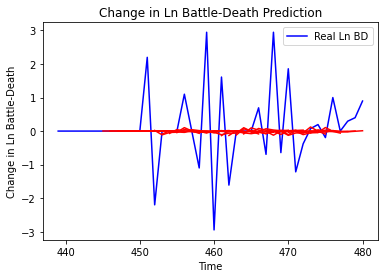

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+1', 'mse': 1.6742776543631133, 'mae': 0.8335248412330749, 'r2': -0.015278527382594831, 'tadda_score': 0.8465746639916477}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+2', 'mse': 1.2153790525381603, 'mae': 0.7374995573037526, 'r2': -0.027045985543387108, 'tadda_score': 0.749499747397866}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+3', 'mse': 2.079107497536221, 'mae': 0.9197378957385883, 'r2': -0.042883405759973625, 'tadda_score': 0.9401895886028871}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+4', 'mse': 2.449831263009633, 'mae': 1.0383192531516663, 'r2': -0.10361105329287468, 'tadda_score': 1.069929188651394}
{'country': 'Burkina Faso', 'country_id': 47, 'step': 't+5', 'mse': 2.3406549435409576, 'mae': 0.950955364773219, 'r2': -0.12284161414109773, 'tadda_score': 0.968839185729171}
{'country': 'Burkina Faso', 'country_id': 47, 'step

16/16 [==============================] - 0s 4ms/step - loss: 0.2623 - val_loss: 1.9051e-05
Epoch 58/100
16/16 [==============================] - 0s 4ms/step - loss: 0.2602 - val_loss: 2.7175e-05
Epoch 59/100
16/16 [==============================] - 0s 5ms/step - loss: 0.2603 - val_loss: 4.5864e-05
Epoch 60/100
16/16 [==============================] - 0s 4ms/step - loss: 0.2651 - val_loss: 2.8853e-05
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 0.2612 - val_loss: 1.3423e-05
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 0.2587 - val_loss: 1.4731e-05
Epoch 63/100
16/16 [==============================] - 0s 4ms/step - loss: 0.2565 - val_loss: 1.1929e-05
Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 0.2605 - val_loss: 1.0898e-05
Epoch 65/100
16/16 [==============================] - 0s 4ms/step - loss: 0.2626 - val_loss: 1.4944e-05
Epoch 66/100
16/16 [==============================] - 0s 4ms/step - loss: 0.2

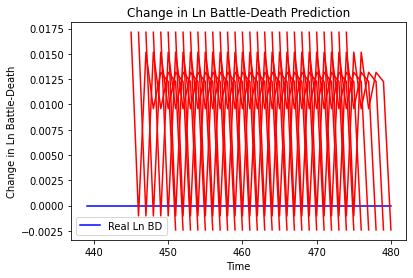

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea', 'country_id': 48, 'step': 't+1', 'mse': 0.0002934678684197167, 'mae': 0.017130903899669647, 'r2': 0.0, 'tadda_score': 0.017130903899669647}
{'country': 'Guinea', 'country_id': 48, 'step': 't+2', 'mse': 0.0002595847117734286, 'mae': 0.01611163280904293, 'r2': 0.0, 'tadda_score': 0.01611163280904293}
{'country': 'Guinea', 'country_id': 48, 'step': 't+3', 'mse': 0.0009780501554482873, 'mae': 0.031273793429136276, 'r2': 0.0, 'tadda_score': 0.031273793429136276}
{'country': 'Guinea', 'country_id': 48, 'step': 't+4', 'mse': 0.0016686146447169592, 'mae': 0.04084867984056473, 'r2': 0.0, 'tadda_score': 0.04084867984056473}
{'country': 'Guinea', 'country_id': 48, 'step': 't+5', 'mse': 0.003028977387859025, 'mae': 0.05503614619374275, 'r2': 0.0, 'tadda_score': 0.05503614619374275}
{'country': 'Guinea', 'country_id': 48, 'step': 't+6', 'mse': 0.004527766707093983, 'mae': 0.06728868186473846, 'r2': 0.0, 'tadda_score

16/16 [==============================] - 0s 4ms/step - loss: 0.6617 - val_loss: 1.9572e-04
Epoch 59/100
16/16 [==============================] - 0s 4ms/step - loss: 0.6568 - val_loss: 5.8653e-05
Epoch 60/100
16/16 [==============================] - 0s 4ms/step - loss: 0.6402 - val_loss: 1.2450e-04
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 0.6377 - val_loss: 2.5934e-04
Epoch 62/100
16/16 [==============================] - 0s 4ms/step - loss: 0.6549 - val_loss: 5.6364e-04
Epoch 63/100
16/16 [==============================] - 0s 4ms/step - loss: 0.6466 - val_loss: 1.2408e-04
Epoch 64/100
16/16 [==============================] - 0s 5ms/step - loss: 0.6357 - val_loss: 2.9313e-04
Epoch 65/100
16/16 [==============================] - 0s 4ms/step - loss: 0.6598 - val_loss: 7.5788e-05
Epoch 66/100
16/16 [==============================] - 0s 4ms/step - loss: 0.6441 - val_loss: 1.0911e-04
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 0.6

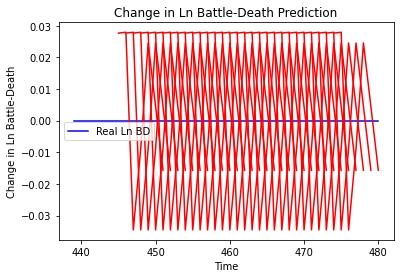

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+1', 'mse': 0.0007659175338692453, 'mae': 0.027675215154886246, 'r2': 0.0, 'tadda_score': 0.027675215154886246}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+2', 'mse': 0.0030941235335779776, 'mae': 0.05562484636902809, 'r2': 0.0, 'tadda_score': 0.05562484636902809}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+3', 'mse': 0.00044457509011253116, 'mae': 0.021084949374198914, 'r2': 0.0, 'tadda_score': 0.021084949374198914}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+4', 'mse': 0.00014883610843043158, 'mae': 0.012199840508401394, 'r2': 0.0, 'tadda_score': 0.012199840508401394}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+5', 'mse': 7.733873419414616e-05, 'mae': 0.00879424437880516, 'r2': 0.0, 'tadda_score': 0.00879424437880516}
{'country': 'Guinea-Bissau', 'country_id': 49, 'step': 't+6', 'mse': 0.00017734933842294964, 'm

16/16 [==============================] - 0s 4ms/step - loss: 1.2771 - val_loss: 3.0038
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 1.2856 - val_loss: 3.0025
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 1.2851 - val_loss: 3.0032
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 1.2683 - val_loss: 3.0047
Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 1.2757 - val_loss: 3.0053
Epoch 65/100
16/16 [==============================] - 0s 4ms/step - loss: 1.2745 - val_loss: 3.0070
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 1.2702 - val_loss: 3.0065
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 1.2913 - val_loss: 3.0061
Epoch 68/100
16/16 [==============================] - 0s 4ms/step - loss: 1.2706 - val_loss: 3.0064
Epoch 69/100
16/16 [==============================] - 0s 4ms/step - loss: 1.2716 - val_loss: 3.0095
Epoch 70/100


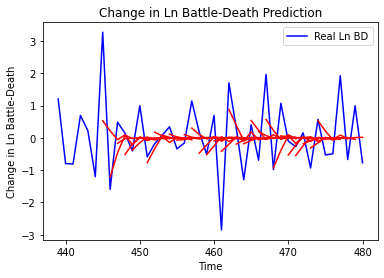

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mali', 'country_id': 50, 'step': 't+1', 'mse': 0.8092125617380584, 'mae': 0.637423647791666, 'r2': 0.35899651869529003, 'tadda_score': 0.70774022946807}
{'country': 'Mali', 'country_id': 50, 'step': 't+2', 'mse': 1.716790860667878, 'mae': 1.019226319338623, 'r2': -0.7732164600227986, 'tadda_score': 1.3588710496470269}
{'country': 'Mali', 'country_id': 50, 'step': 't+3', 'mse': 1.525622348002736, 'mae': 1.031121104087042, 'r2': -0.3438291191392928, 'tadda_score': 1.3405872425691356}
{'country': 'Mali', 'country_id': 50, 'step': 't+4', 'mse': 2.221683316338608, 'mae': 1.2417689830052894, 'r2': -0.48564214100585734, 'tadda_score': 1.616117261411055}
{'country': 'Mali', 'country_id': 50, 'step': 't+5', 'mse': 1.790165453024145, 'mae': 1.096172112992409, 'r2': -0.6533033597631026, 'tadda_score': 1.3680461764544283}
{'country': 'Mali', 'country_id': 50, 'step': 't+6', 'mse': 2.010620004684898, 'mae': 1.164004165359912

16/16 [==============================] - 0s 5ms/step - loss: 1.6252 - val_loss: 0.4296
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 1.6317 - val_loss: 0.4297
Epoch 62/100
16/16 [==============================] - 0s 6ms/step - loss: 1.6371 - val_loss: 0.4298
Epoch 63/100
16/16 [==============================] - 0s 11ms/step - loss: 1.6346 - val_loss: 0.4301
Epoch 64/100
16/16 [==============================] - 0s 8ms/step - loss: 1.6383 - val_loss: 0.4305
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 1.6501 - val_loss: 0.4301
Epoch 66/100
16/16 [==============================] - 0s 4ms/step - loss: 1.6340 - val_loss: 0.4296
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 1.6366 - val_loss: 0.4300
Epoch 68/100
16/16 [==============================] - 0s 5ms/step - loss: 1.6264 - val_loss: 0.4292
Epoch 69/100
16/16 [==============================] - 0s 5ms/step - loss: 1.6231 - val_loss: 0.4299
Epoch 70/100

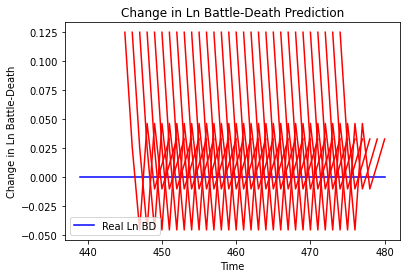

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Senegal', 'country_id': 52, 'step': 't+1', 'mse': 0.015610774493020563, 'mae': 0.1249430850148201, 'r2': 0.0, 'tadda_score': 0.1249430850148201}
{'country': 'Senegal', 'country_id': 52, 'step': 't+2', 'mse': 0.02256572360136233, 'mae': 0.1502189189195633, 'r2': 0.0, 'tadda_score': 0.1502189189195633}
{'country': 'Senegal', 'country_id': 52, 'step': 't+3', 'mse': 0.010883760853119817, 'mae': 0.10432526469230652, 'r2': 0.0, 'tadda_score': 0.10432526469230652}
{'country': 'Senegal', 'country_id': 52, 'step': 't+4', 'mse': 0.022626564963524665, 'mae': 0.15042129158973694, 'r2': 0.0, 'tadda_score': 0.15042129158973694}
{'country': 'Senegal', 'country_id': 52, 'step': 't+5', 'mse': 0.013156978093445348, 'mae': 0.11470387130975723, 'r2': 0.0, 'tadda_score': 0.11470387130975723}
{'country': 'Senegal', 'country_id': 52, 'step': 't+6', 'mse': 0.015718921174362244, 'mae': 0.12537512183189392, 'r2': 0.0, 'tadda_score': 0.12

16/16 [==============================] - 0s 4ms/step - loss: 2.1791 - val_loss: 8.4443e-04
Epoch 59/100
16/16 [==============================] - 0s 4ms/step - loss: 2.1488 - val_loss: 0.0012
Epoch 60/100
16/16 [==============================] - 0s 4ms/step - loss: 2.1668 - val_loss: 9.8300e-04
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 2.1491 - val_loss: 0.0010
Epoch 62/100
16/16 [==============================] - 0s 4ms/step - loss: 2.1595 - val_loss: 0.0013
Epoch 63/100
16/16 [==============================] - 0s 4ms/step - loss: 2.1650 - val_loss: 0.0011
Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 2.1630 - val_loss: 0.0013
Epoch 65/100
16/16 [==============================] - 0s 4ms/step - loss: 2.1752 - val_loss: 0.0014
Epoch 66/100
16/16 [==============================] - 0s 4ms/step - loss: 2.1475 - val_loss: 0.0012
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 2.1472 - val_loss: 0.0010
Epoch

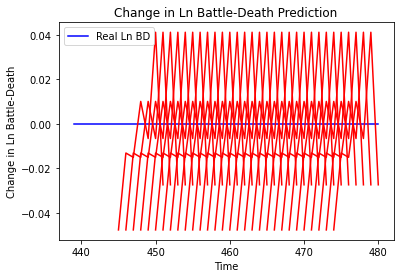

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+1', 'mse': 0.0022812911142438552, 'mae': 0.04776286333799362, 'r2': 0.0, 'tadda_score': 0.04776286333799362}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+2', 'mse': 0.0037079201458479205, 'mae': 0.06089269369840622, 'r2': 0.0, 'tadda_score': 0.06089269369840622}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+3', 'mse': 0.005770352158456282, 'mae': 0.07596283406019211, 'r2': 0.0, 'tadda_score': 0.07596283406019211}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+4', 'mse': 0.00433630944941954, 'mae': 0.06585066020488739, 'r2': 0.0, 'tadda_score': 0.06585066020488739}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+5', 'mse': 0.0035180694428372933, 'mae': 0.05931331589818001, 'r2': 0.0, 'tadda_score': 0.05931331589818001}
{'country': 'Sierra Leone', 'country_id': 53, 'step': 't+6', 'mse': 0.00032553923811079466, 'mae': 0.0180427059

Epoch 56/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
16/16 [========

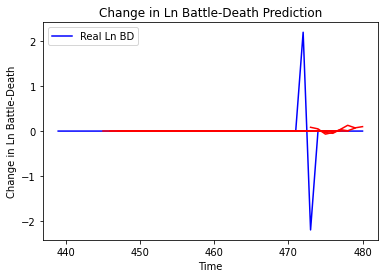

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'The Gambia', 'country_id': 54, 'step': 't+1', 'mse': 0.3344635006101058, 'mae': 0.14996411150983358, 'r2': -0.03918075081110084, 'tadda_score': 0.1527766746410865}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+2', 'mse': 0.3206260668255155, 'mae': 0.15051594397715115, 'r2': 0.00381226577617777, 'tadda_score': 0.15051594397715115}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+3', 'mse': 0.16120023594117155, 'mae': 0.07751101607477359, 'r2': -0.03624223256999781, 'tadda_score': 0.07751101607477359}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+4', 'mse': 0.16098918190446462, 'mae': 0.0752661927729417, 'r2': -0.03488551553473296, 'tadda_score': 0.0752661927729417}
{'country': 'The Gambia', 'country_id': 54, 'step': 't+5', 'mse': 0.16154135505451395, 'mae': 0.07832870462929896, 'r2': -0.0384350459335665, 'tadda_score': 0.07832870462929896}
{'country': 'The Gambia', 'country_id': 54, 'step'

16/16 [==============================] - 0s 5ms/step - loss: 0.6285 - val_loss: 1.6005e-04
Epoch 58/100
16/16 [==============================] - 0s 6ms/step - loss: 0.6306 - val_loss: 1.5252e-04
Epoch 59/100
16/16 [==============================] - 0s 6ms/step - loss: 0.6280 - val_loss: 1.6410e-04
Epoch 60/100
16/16 [==============================] - 0s 6ms/step - loss: 0.6326 - val_loss: 2.1622e-04
Epoch 61/100
16/16 [==============================] - 0s 6ms/step - loss: 0.6277 - val_loss: 2.8763e-04
Epoch 62/100
16/16 [==============================] - 0s 7ms/step - loss: 0.6254 - val_loss: 2.3794e-04
Epoch 63/100
16/16 [==============================] - 0s 6ms/step - loss: 0.6351 - val_loss: 1.8498e-04
Epoch 64/100
16/16 [==============================] - 0s 7ms/step - loss: 0.6289 - val_loss: 1.8658e-04
Epoch 65/100
16/16 [==============================] - 0s 6ms/step - loss: 0.6247 - val_loss: 2.4362e-04
Epoch 66/100
16/16 [==============================] - 0s 7ms/step - loss: 0.6

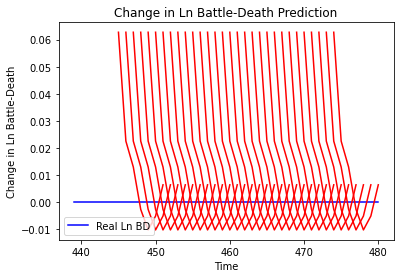

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Djibouti', 'country_id': 55, 'step': 't+1', 'mse': 0.003931878123006938, 'mae': 0.06270468980073929, 'r2': 0.0, 'tadda_score': 0.06270468980073929}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+2', 'mse': 0.007265254108298258, 'mae': 0.08523645997047424, 'r2': 0.0, 'tadda_score': 0.08523645997047424}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+3', 'mse': 0.009647285130366667, 'mae': 0.098220594227314, 'r2': 0.0, 'tadda_score': 0.098220594227314}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+4', 'mse': 0.00913028957570483, 'mae': 0.09555254876613617, 'r2': 0.0, 'tadda_score': 0.09555254876613617}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+5', 'mse': 0.003942761742306067, 'mae': 0.06279141455888748, 'r2': 0.0, 'tadda_score': 0.06279141455888748}
{'country': 'Djibouti', 'country_id': 55, 'step': 't+6', 'mse': 0.0033283207306034207, 'mae': 0.05769160017371178, 'r2': 0.0, 'tadda_score

14/14 [==============================] - 0s 6ms/step - loss: 1.9611 - val_loss: 0.0302
Epoch 61/100
14/14 [==============================] - 0s 6ms/step - loss: 1.9759 - val_loss: 0.0298
Epoch 62/100
14/14 [==============================] - 0s 6ms/step - loss: 1.9777 - val_loss: 0.0301
Epoch 63/100
14/14 [==============================] - 0s 6ms/step - loss: 1.9668 - val_loss: 0.0308
Epoch 64/100
14/14 [==============================] - 0s 6ms/step - loss: 1.9632 - val_loss: 0.0306
Epoch 65/100
14/14 [==============================] - 0s 7ms/step - loss: 1.9488 - val_loss: 0.0305
Epoch 66/100
14/14 [==============================] - 0s 6ms/step - loss: 1.9877 - val_loss: 0.0299
Epoch 67/100
14/14 [==============================] - 0s 7ms/step - loss: 1.9627 - val_loss: 0.0300
Epoch 68/100
14/14 [==============================] - 0s 6ms/step - loss: 1.9631 - val_loss: 0.0302
Epoch 69/100
14/14 [==============================] - 0s 5ms/step - loss: 1.9691 - val_loss: 0.0303
Epoch 70/100


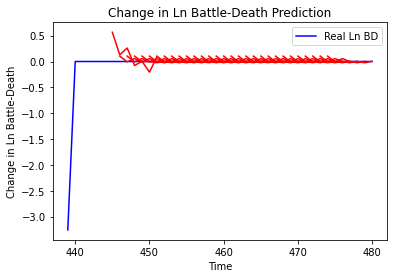

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Eritrea', 'country_id': 56, 'step': 't+1', 'mse': 0.02130407578664491, 'mae': 0.12020109842220943, 'r2': 0.0, 'tadda_score': 0.12020109842220943}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+2', 'mse': 0.025350760220760882, 'mae': 0.11749958743651708, 'r2': 0.0, 'tadda_score': 0.11749958743651708}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+3', 'mse': 0.05345509706293674, 'mae': 0.18086139460404713, 'r2': 0.0, 'tadda_score': 0.18086139460404713}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+4', 'mse': 0.04807529001430877, 'mae': 0.17615502923727036, 'r2': 0.0, 'tadda_score': 0.17615502923727036}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+5', 'mse': 0.043205514461570026, 'mae': 0.178296168645223, 'r2': 0.0, 'tadda_score': 0.178296168645223}
{'country': 'Eritrea', 'country_id': 56, 'step': 't+6', 'mse': 0.027555138979859506, 'mae': 0.14854054898023605, 'r2': 0.0, 'tadda_score': 0.1485

14/14 [==============================] - 0s 5ms/step - loss: 4.6123 - val_loss: 2.6188
Epoch 61/100
14/14 [==============================] - 0s 5ms/step - loss: 4.6072 - val_loss: 2.6187
Epoch 62/100
14/14 [==============================] - 0s 5ms/step - loss: 4.6162 - val_loss: 2.6173
Epoch 63/100
14/14 [==============================] - 0s 5ms/step - loss: 4.5983 - val_loss: 2.6153
Epoch 64/100
14/14 [==============================] - 0s 4ms/step - loss: 4.5632 - val_loss: 2.6148
Epoch 65/100
14/14 [==============================] - 0s 5ms/step - loss: 4.5507 - val_loss: 2.6151
Epoch 66/100
14/14 [==============================] - 0s 5ms/step - loss: 4.6020 - val_loss: 2.6148
Epoch 67/100
14/14 [==============================] - 0s 5ms/step - loss: 4.5865 - val_loss: 2.6133
Epoch 68/100
14/14 [==============================] - 0s 4ms/step - loss: 4.6124 - val_loss: 2.6126
Epoch 69/100
14/14 [==============================] - 0s 5ms/step - loss: 4.5431 - val_loss: 2.6132
Epoch 70/100


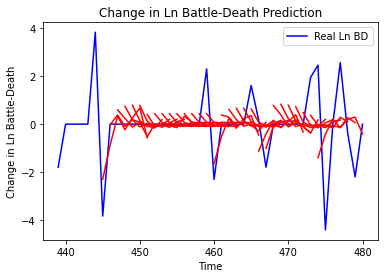

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+1', 'mse': 1.1524196635749662, 'mae': 0.8281711144860591, 'r2': 0.15526686944359802, 'tadda_score': 0.9121318343893692}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+2', 'mse': 3.872872208269691, 'mae': 1.4279996900440959, 'r2': -0.9410601538834038, 'tadda_score': 1.6121502388200866}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+3', 'mse': 3.884310634408762, 'mae': 1.4178532102387855, 'r2': -0.9467930239621738, 'tadda_score': 1.6310494958044794}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+4', 'mse': 4.071626499273544, 'mae': 1.4386223722181428, 'r2': -1.0406746038146837, 'tadda_score': 1.6581010211191287}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+5', 'mse': 3.0779010505306243, 'mae': 1.1688826639137375, 'r2': -0.5426254122260552, 'tadda_score': 1.3043688931745003}
{'country': 'Ethiopia', 'country_id': 57, 'step': 't+6', 'mse': 2.5768931517

Epoch 60/100
16/16 [==============================] - 0s 5ms/step - loss: 0.9137 - val_loss: 0.9997
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 0.9213 - val_loss: 0.9990
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 0.9256 - val_loss: 0.9989
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.9270 - val_loss: 0.9994
Epoch 64/100
16/16 [==============================] - 0s 5ms/step - loss: 0.9291 - val_loss: 0.9986
Epoch 65/100
16/16 [==============================] - 0s 4ms/step - loss: 0.9145 - val_loss: 0.9987
Epoch 66/100
16/16 [==============================] - 0s 4ms/step - loss: 0.9225 - val_loss: 0.9986
Epoch 67/100
16/16 [==============================] - 0s 5ms/step - loss: 0.9119 - val_loss: 0.9988
Epoch 68/100
16/16 [==============================] - 0s 5ms/step - loss: 0.9257 - val_loss: 0.9989
Epoch 69/100
16/16 [==============================] - 0s 5ms/step - loss: 0.9231 - val_loss: 0.9993


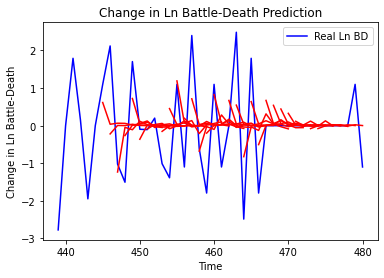

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Algeria', 'country_id': 67, 'step': 't+1', 'mse': 1.0652692941925066, 'mae': 0.7854282754982548, 'r2': 0.3320648586286492, 'tadda_score': 0.8159060935998993}
{'country': 'Algeria', 'country_id': 67, 'step': 't+2', 'mse': 2.2985287297669177, 'mae': 1.1384678714842973, 'r2': -0.36475982414698893, 'tadda_score': 1.3820191024116057}
{'country': 'Algeria', 'country_id': 67, 'step': 't+3', 'mse': 2.6245777567116675, 'mae': 1.2612177590177467, 'r2': -0.4630836453979412, 'tadda_score': 1.5387600542004913}
{'country': 'Algeria', 'country_id': 67, 'step': 't+4', 'mse': 2.7919406383390637, 'mae': 1.2822003963535058, 'r2': -0.36760030811519395, 'tadda_score': 1.524579815114044}
{'country': 'Algeria', 'country_id': 67, 'step': 't+5', 'mse': 2.0225011565554465, 'mae': 1.0380685348021323, 'r2': -0.502857376348494, 'tadda_score': 1.2432266555684144}
{'country': 'Algeria', 'country_id': 67, 'step': 't+6', 'mse': 2.14935271491050

Epoch 60/100
16/16 [==============================] - 0s 6ms/step - loss: 0.1891 - val_loss: 1.4618
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1840 - val_loss: 1.4625
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1828 - val_loss: 1.4633
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1876 - val_loss: 1.4628
Epoch 64/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1903 - val_loss: 1.4613
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1861 - val_loss: 1.4622
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1837 - val_loss: 1.4617
Epoch 67/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1875 - val_loss: 1.4620
Epoch 68/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1871 - val_loss: 1.4627
Epoch 69/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1844 - val_loss: 1.4620


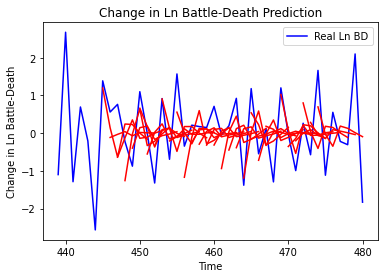

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Cameroon', 'country_id': 69, 'step': 't+1', 'mse': 0.559205371699614, 'mae': 0.6471976472504019, 'r2': 0.24068210930629175, 'tadda_score': 0.7499737551874994}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+2', 'mse': 1.7219753044123807, 'mae': 1.1462428049949664, 'r2': -1.3329027060967125, 'tadda_score': 1.593492728144711}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+3', 'mse': 1.3267423711565636, 'mae': 0.9373368978345246, 'r2': -0.35381459990351183, 'tadda_score': 1.102677306268995}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+4', 'mse': 1.5109399820209788, 'mae': 0.9627092564976724, 'r2': -0.7156328431283934, 'tadda_score': 1.2093178945160419}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+5', 'mse': 1.835674259084436, 'mae': 1.1145270604626005, 'r2': -0.8454826841880587, 'tadda_score': 1.4388302431738045}
{'country': 'Cameroon', 'country_id': 69, 'step': 't+6', 'mse': 2.0919174815

16/16 [==============================] - 0s 5ms/step - loss: 0.7399 - val_loss: 2.3992
Epoch 60/100
16/16 [==============================] - 0s 5ms/step - loss: 0.7418 - val_loss: 2.3983
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 0.7302 - val_loss: 2.3970
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 0.7344 - val_loss: 2.3942
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.7314 - val_loss: 2.3958
Epoch 64/100
16/16 [==============================] - 0s 5ms/step - loss: 0.7249 - val_loss: 2.3961
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 0.7315 - val_loss: 2.3961
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 0.7335 - val_loss: 2.3954
Epoch 67/100
16/16 [==============================] - 0s 5ms/step - loss: 0.7283 - val_loss: 2.3953
Epoch 68/100
16/16 [==============================] - 0s 5ms/step - loss: 0.7280 - val_loss: 2.3951
Epoch 69/100


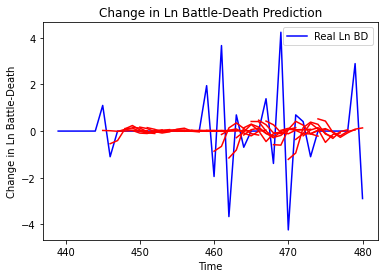

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+1', 'mse': 1.9977042164081922, 'mae': 0.8758021112262135, 'r2': 0.2446486093277176, 'tadda_score': 0.9087335279562995}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+2', 'mse': 1.866444251369255, 'mae': 1.0157527002763522, 'r2': -0.27491695480597955, 'tadda_score': 1.0854887139620157}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+3', 'mse': 2.3731533838823258, 'mae': 1.0054026302916568, 'r2': -0.012515422019677924, 'tadda_score': 1.0717856464011235}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+4', 'mse': 2.8244845880297533, 'mae': 1.047423233670952, 'r2': -0.16827841331214755, 'tadda_score': 1.0793203501234074}
{'country': 'Central African Republic', 'country_id': 70, 'step': 't+5', 'mse': 2.810358678719725, 'mae': 0.9797937696974902, 'r2': -0.10899266703963795, 'tadda_score': 1.0510311251

16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 57/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 58/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 59/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 60/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 62/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.3727
Epoch 65/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0

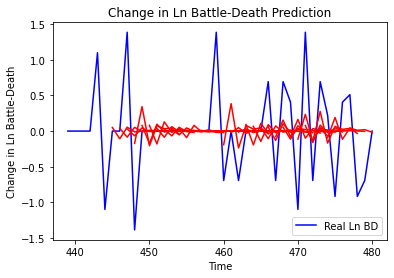

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tunisia', 'country_id': 73, 'step': 't+1', 'mse': 0.3649384011527977, 'mae': 0.39834876279585935, 'r2': 0.11603089817663537, 'tadda_score': 0.4041252351855574}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+2', 'mse': 0.3930873097815621, 'mae': 0.426775848610437, 'r2': 0.044736481344820445, 'tadda_score': 0.4388514028794925}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+3', 'mse': 0.48776451344712574, 'mae': 0.47029963307192185, 'r2': -0.02084588504496665, 'tadda_score': 0.47488972337405144}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+4', 'mse': 0.49442527304955186, 'mae': 0.4590380735742362, 'r2': -0.023931869145592533, 'tadda_score': 0.4608115183546952}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+5', 'mse': 0.5035340868003977, 'mae': 0.5061849248203899, 'r2': -0.1445553108840325, 'tadda_score': 0.5466983739826347}
{'country': 'Tunisia', 'country_id': 73, 'step': 't+6', 'mse': 0.59789

16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [=====================

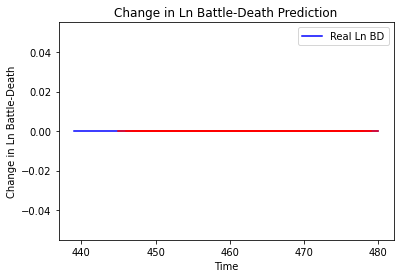

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Benin', 'country_id': 74, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Benin', 'country_id': 74, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Equatorial Guinea']
Building vanilla Model...
Model: "sequential_893"
_________________________________________________________________
Layer (type)                 Output S

16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
16/16 [=====================

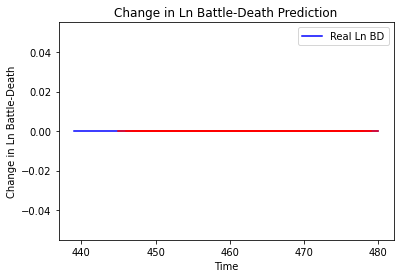

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Equatorial Guinea', 'country_id': 76, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Niger']
Building vanilla Model...
Model: "sequential_894"
_______________________________

16/16 [==============================] - 0s 4ms/step - loss: 0.8466 - val_loss: 1.6345
Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 0.8432 - val_loss: 1.6338
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 0.8597 - val_loss: 1.6338
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 0.8543 - val_loss: 1.6334
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 0.8544 - val_loss: 1.6334
Epoch 68/100
16/16 [==============================] - 0s 4ms/step - loss: 0.8443 - val_loss: 1.6336
Epoch 69/100
16/16 [==============================] - 0s 4ms/step - loss: 0.8499 - val_loss: 1.6333
Epoch 70/100
16/16 [==============================] - 0s 4ms/step - loss: 0.8506 - val_loss: 1.6328
Epoch 71/100
16/16 [==============================] - 0s 4ms/step - loss: 0.8527 - val_loss: 1.6334
Epoch 72/100
16/16 [==============================] - 0s 4ms/step - loss: 0.8480 - val_loss: 1.6329
Epoch 73/100


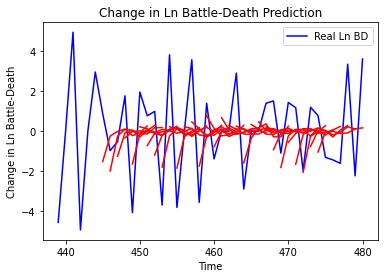

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Niger', 'country_id': 78, 'step': 't+1', 'mse': 3.2613555379704793, 'mae': 1.5498268532185884, 'r2': 0.24712486320501692, 'tadda_score': 1.8409778334129983}
{'country': 'Niger', 'country_id': 78, 'step': 't+2', 'mse': 6.436159957919373, 'mae': 2.114739199509114, 'r2': -0.6390313314704437, 'tadda_score': 2.5748733898300817}
{'country': 'Niger', 'country_id': 78, 'step': 't+3', 'mse': 6.018532987544975, 'mae': 1.9133989441589578, 'r2': -0.5539579711504019, 'tadda_score': 2.41382780454517}
{'country': 'Niger', 'country_id': 78, 'step': 't+4', 'mse': 6.331959612944633, 'mae': 2.09723876373566, 'r2': -0.39555691788531977, 'tadda_score': 2.5221123619039534}
{'country': 'Niger', 'country_id': 78, 'step': 't+5', 'mse': 7.753433551115396, 'mae': 2.2323495488320773, 'r2': -0.40950295601391296, 'tadda_score': 2.698373938695092}
{'country': 'Niger', 'country_id': 78, 'step': 't+6', 'mse': 7.248329648542436, 'mae': 2.1101462

16/16 [==============================] - 0s 4ms/step - loss: 0.5316 - val_loss: 1.1726
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5293 - val_loss: 1.1731
Epoch 62/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5333 - val_loss: 1.1740
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.5332 - val_loss: 1.1752
Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5342 - val_loss: 1.1743
Epoch 65/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5308 - val_loss: 1.1762
Epoch 66/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5318 - val_loss: 1.1770
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5379 - val_loss: 1.1767
Epoch 68/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5354 - val_loss: 1.1787
Epoch 69/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5294 - val_loss: 1.1783
Epoch 70/100


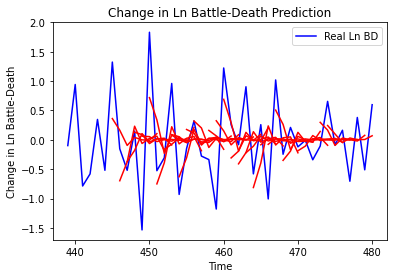

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Nigeria', 'country_id': 79, 'step': 't+1', 'mse': 0.4149654769344225, 'mae': 0.48936609438114853, 'r2': 0.27390914108134534, 'tadda_score': 0.5462976331368435}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+2', 'mse': 1.1899882604133292, 'mae': 0.8718403338737637, 'r2': -1.1993232179371223, 'tadda_score': 1.1567442825036593}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+3', 'mse': 0.9938450523313319, 'mae': 0.808064008566675, 'r2': -0.6221013223257503, 'tadda_score': 1.0199321676050002}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+4', 'mse': 1.1871942776397435, 'mae': 0.8544888275203788, 'r2': -0.5959575084600013, 'tadda_score': 1.1163047345814787}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+5', 'mse': 0.7693180850576271, 'mae': 0.6670335559730702, 'r2': -0.5026827244451348, 'tadda_score': 0.825327089112001}
{'country': 'Nigeria', 'country_id': 79, 'step': 't+6', 'mse': 0.73906166266714

16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [=====================

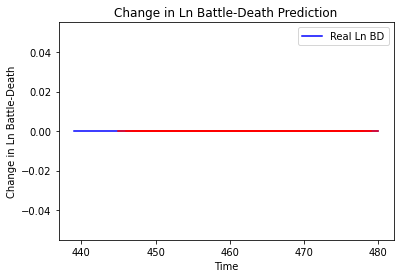

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Sao Tome and Principe', 'country_id': 80, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Togo']
Building vanilla Model...
Model: "sequential_897"
____

16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
16/16 [=====================

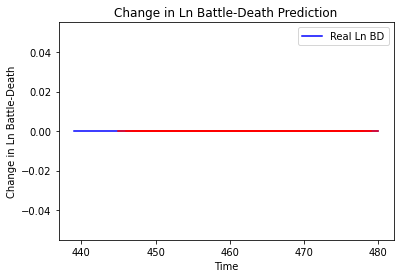

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Togo', 'country_id': 81, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Togo', 'country_id': 81, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Somalia']
Building vanilla Model...
Model: "sequential_898"
_________________________________________________________________
Layer (type)                 Output Shape             

16/16 [==============================] - 0s 5ms/step - loss: 2.5482 - val_loss: 0.3668
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 2.5862 - val_loss: 0.3670
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 2.5872 - val_loss: 0.3677
Epoch 67/100
16/16 [==============================] - 0s 5ms/step - loss: 2.5810 - val_loss: 0.3681
Epoch 68/100
16/16 [==============================] - 0s 5ms/step - loss: 2.5869 - val_loss: 0.3679
Epoch 69/100
16/16 [==============================] - 0s 5ms/step - loss: 2.5778 - val_loss: 0.3673
Epoch 70/100
16/16 [==============================] - 0s 4ms/step - loss: 2.5853 - val_loss: 0.3673
Epoch 71/100
16/16 [==============================] - 0s 4ms/step - loss: 2.5798 - val_loss: 0.3671
Epoch 72/100
16/16 [==============================] - 0s 5ms/step - loss: 2.5764 - val_loss: 0.3672
Epoch 73/100
16/16 [==============================] - 0s 5ms/step - loss: 2.5727 - val_loss: 0.3675
Epoch 74/100


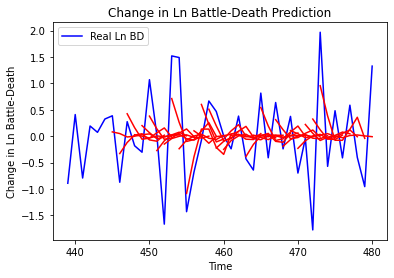

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Somalia', 'country_id': 120, 'step': 't+1', 'mse': 0.5356898290854358, 'mae': 0.5569376060680788, 'r2': 0.29679716606239426, 'tadda_score': 0.6406769838125749}
{'country': 'Somalia', 'country_id': 120, 'step': 't+2', 'mse': 1.4455808471253633, 'mae': 0.9191884064296248, 'r2': -0.47413206785425444, 'tadda_score': 1.139709699389275}
{'country': 'Somalia', 'country_id': 120, 'step': 't+3', 'mse': 1.3830975411357505, 'mae': 0.8755415176438883, 'r2': -0.7330018517444363, 'tadda_score': 1.1055292709507143}
{'country': 'Somalia', 'country_id': 120, 'step': 't+4', 'mse': 1.0522257655180456, 'mae': 0.8454316741141279, 'r2': -0.517972031111195, 'tadda_score': 1.0094116690854331}
{'country': 'Somalia', 'country_id': 120, 'step': 't+5', 'mse': 0.9360635627315941, 'mae': 0.7314041231137423, 'r2': -0.21425495943654327, 'tadda_score': 0.8889405717762222}
{'country': 'Somalia', 'country_id': 120, 'step': 't+6', 'mse': 1.0530227

16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [=====================

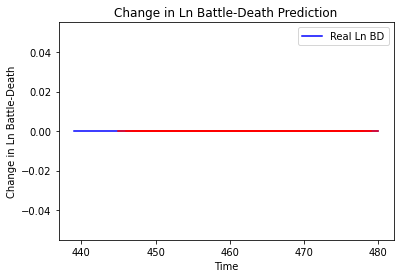

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Botswana', 'country_id': 154, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Botswana', 'country_id': 154, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Burundi']
Building vanilla Model...
Model: "sequential_900"
_________________________________________________________________
Layer (type)       

Epoch 64/100
16/16 [==============================] - 0s 5ms/step - loss: 1.9273 - val_loss: 1.6129
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 1.9303 - val_loss: 1.6123
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 1.9283 - val_loss: 1.6121
Epoch 67/100
16/16 [==============================] - 0s 5ms/step - loss: 1.9384 - val_loss: 1.6121
Epoch 68/100
16/16 [==============================] - 0s 5ms/step - loss: 1.9139 - val_loss: 1.6117
Epoch 69/100
16/16 [==============================] - 0s 4ms/step - loss: 1.9245 - val_loss: 1.6115
Epoch 70/100
16/16 [==============================] - 0s 4ms/step - loss: 1.9173 - val_loss: 1.6129
Epoch 71/100
16/16 [==============================] - 0s 4ms/step - loss: 1.9276 - val_loss: 1.6125
Epoch 72/100
16/16 [==============================] - 0s 4ms/step - loss: 1.9287 - val_loss: 1.6123
Epoch 73/100
16/16 [==============================] - 0s 4ms/step - loss: 1.9164 - val_loss: 1.6119


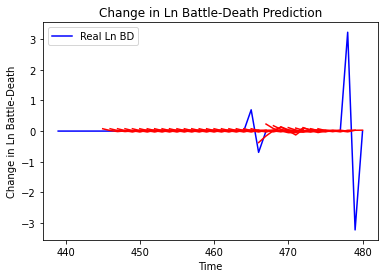

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Burundi', 'country_id': 155, 'step': 't+1', 'mse': 0.024853319609163874, 'mae': 0.1156153392018684, 'r2': 0.22406607235701836, 'tadda_score': 0.1156153392018684}
{'country': 'Burundi', 'country_id': 155, 'step': 't+2', 'mse': 0.06633836328348136, 'mae': 0.16788220517057262, 'r2': -1.0711191738337917, 'tadda_score': 0.17822805357196014}
{'country': 'Burundi', 'country_id': 155, 'step': 't+3', 'mse': 0.05894742778641207, 'mae': 0.15138652759013654, 'r2': -0.8403702155705923, 'tadda_score': 0.15864913798588595}
{'country': 'Burundi', 'country_id': 155, 'step': 't+4', 'mse': 0.050472864750593496, 'mae': 0.1479968909146198, 'r2': -0.5757898261156498, 'tadda_score': 0.15282289224086287}
{'country': 'Burundi', 'country_id': 155, 'step': 't+5', 'mse': 0.037125397421208794, 'mae': 0.09730858007786752, 'r2': -0.15907475900014356, 'tadda_score': 0.09932885020691237}
{'country': 'Burundi', 'country_id': 155, 'step': 't+6', 

16/16 [==============================] - 0s 5ms/step - loss: 2.4133 - val_loss: 0.1839
Epoch 60/100
16/16 [==============================] - 0s 5ms/step - loss: 2.4124 - val_loss: 0.1832
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 2.4320 - val_loss: 0.1834
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 2.4232 - val_loss: 0.1833
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 2.4463 - val_loss: 0.1824
Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 2.4383 - val_loss: 0.1826
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 2.4228 - val_loss: 0.1841
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 2.4336 - val_loss: 0.1822
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 2.4244 - val_loss: 0.1820
Epoch 68/100
16/16 [==============================] - 0s 4ms/step - loss: 2.4235 - val_loss: 0.1817
Epoch 69/100


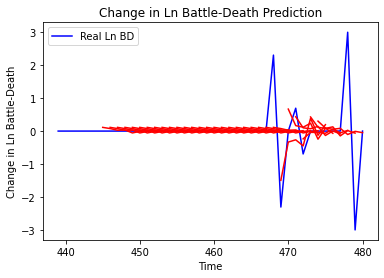

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Rwanda', 'country_id': 156, 'step': 't+1', 'mse': 0.22459166948467052, 'mae': 0.2565013470514075, 'r2': 0.4173866356789935, 'tadda_score': 0.2565013470514075}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+2', 'mse': 0.6740662072804421, 'mae': 0.449105127380635, 'r2': -0.7485954919871343, 'tadda_score': 0.49488776298994386}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+3', 'mse': 0.5788939532485309, 'mae': 0.4777703581791766, 'r2': -1.0742341063257115, 'tadda_score': 0.5128385929804691}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+4', 'mse': 0.6009413851742934, 'mae': 0.4910987098197881, 'r2': -0.6288272669602402, 'tadda_score': 0.4910987098197881}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+5', 'mse': 0.5674769971501268, 'mae': 0.3670985587341142, 'r2': -0.5381233996103629, 'tadda_score': 0.38342500804886737}
{'country': 'Rwanda', 'country_id': 156, 'step': 't+6', 'mse': 0.564831732592

16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [=====================

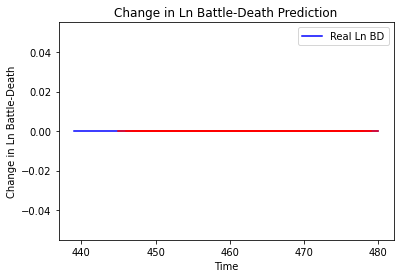

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zambia', 'country_id': 157, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zambia', 'country_id': 157, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Zimbabwe']
Building vanilla Model...
Model: "sequential_903"
_________________________________________________________________
Layer (type)                 Out

16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
16/16 [=====================

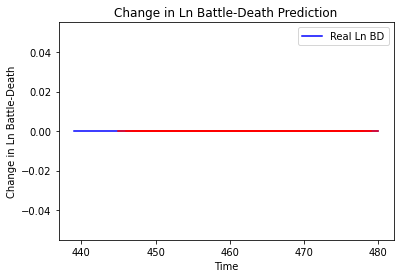

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Zimbabwe', 'country_id': 158, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Comoros']
Building vanilla Model...
Model: "sequential_904"
_________________________________________________________________
Layer (type)       

16/16 [==============================] - 0s 5ms/step - loss: 0.1292 - val_loss: 3.1279e-05
Epoch 62/100
16/16 [==============================] - 0s 4ms/step - loss: 0.1263 - val_loss: 2.9617e-05
Epoch 63/100
16/16 [==============================] - 0s 4ms/step - loss: 0.1278 - val_loss: 2.8691e-04
Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 0.1272 - val_loss: 6.5975e-05
Epoch 65/100
16/16 [==============================] - 0s 4ms/step - loss: 0.1262 - val_loss: 7.0192e-06
Epoch 66/100
16/16 [==============================] - 0s 4ms/step - loss: 0.1263 - val_loss: 4.9167e-06
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 0.1303 - val_loss: 1.8048e-05
Epoch 68/100
16/16 [==============================] - 0s 4ms/step - loss: 0.1259 - val_loss: 1.8644e-05
Epoch 69/100
16/16 [==============================] - 0s 4ms/step - loss: 0.1273 - val_loss: 4.3454e-05
Epoch 70/100
16/16 [==============================] - 0s 4ms/step - loss: 0.1

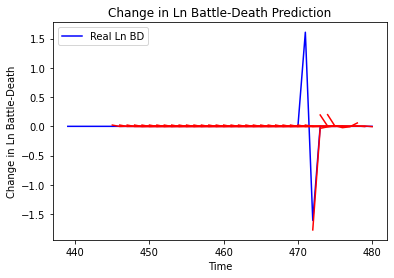

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Comoros', 'country_id': 159, 'step': 't+1', 'mse': 0.08789355963677335, 'mae': 0.09031915031373501, 'r2': 0.49102100767715684, 'tadda_score': 0.09031915031373501}
{'country': 'Comoros', 'country_id': 159, 'step': 't+2', 'mse': 0.3033766078081216, 'mae': 0.19691985098718004, 'r2': -0.7568104053882958, 'tadda_score': 0.20348816859919225}
{'country': 'Comoros', 'country_id': 159, 'step': 't+3', 'mse': 0.3055731349319994, 'mae': 0.19835796894578533, 'r2': -0.7695301787908209, 'tadda_score': 0.20524217826076743}
{'country': 'Comoros', 'country_id': 159, 'step': 't+4', 'mse': 0.1958503343919121, 'mae': 0.1437298657903989, 'r2': -1.3464990026142498, 'tadda_score': 0.1437298657903989}
{'country': 'Comoros', 'country_id': 159, 'step': 't+5', 'mse': 0.19446992627802473, 'mae': 0.14336849015552997, 'r2': -1.3299602191983602, 'tadda_score': 0.14336849015552997}
{'country': 'Comoros', 'country_id': 159, 'step': 't+6', 'mse':

16/16 [==============================] - 0s 5ms/step - loss: 0.1399 - val_loss: 3.4475e-05
Epoch 58/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1424 - val_loss: 4.5131e-05
Epoch 59/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1410 - val_loss: 4.1297e-05
Epoch 60/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1390 - val_loss: 3.0490e-05
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1396 - val_loss: 3.0901e-05
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1424 - val_loss: 2.1459e-05
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1401 - val_loss: 3.2226e-05
Epoch 64/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1405 - val_loss: 8.5363e-06
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1419 - val_loss: 8.3088e-06
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1

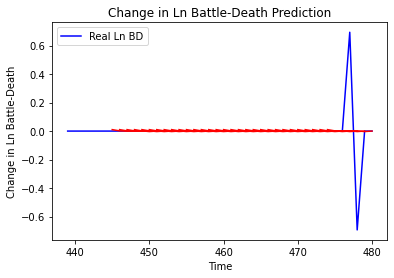

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Lesotho', 'country_id': 160, 'step': 't+1', 'mse': 0.00010451670476866685, 'mae': 0.010223341174423695, 'r2': 0.0, 'tadda_score': 0.010223341174423695}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+2', 'mse': 0.0001339240440142728, 'mae': 0.011572555638849735, 'r2': 0.0, 'tadda_score': 0.011572555638849735}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+3', 'mse': 0.00012609778371683658, 'mae': 0.011229326948523521, 'r2': 0.0, 'tadda_score': 0.011229326948523521}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+4', 'mse': 0.00015673716281666694, 'mae': 0.012519471347332, 'r2': 0.0, 'tadda_score': 0.012519471347332}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+5', 'mse': 0.00016574778358591571, 'mae': 0.012874307110905647, 'r2': 0.0, 'tadda_score': 0.012874307110905647}
{'country': 'Lesotho', 'country_id': 160, 'step': 't+6', 'mse': 9.055217869988544e-05, 'mae': 0.00951589085161686, 'r2':

Epoch 56/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
16/16 [========

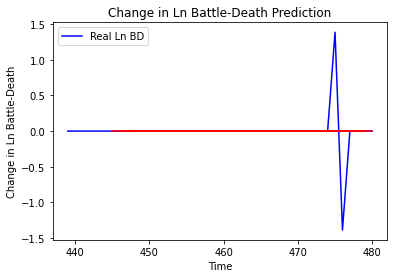

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Malawi', 'country_id': 161, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Malawi', 'country_id': 161, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mozambique']
Building vanilla Model...
Model: "sequential_907"
_________________________________________________________________
Layer (type)                 O

16/16 [==============================] - 0s 5ms/step - loss: 1.0061 - val_loss: 0.6884
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 1.0173 - val_loss: 0.6884
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 0.9949 - val_loss: 0.6888
Epoch 67/100
16/16 [==============================] - 0s 5ms/step - loss: 1.0554 - val_loss: 0.6888
Epoch 68/100
16/16 [==============================] - 0s 5ms/step - loss: 1.0219 - val_loss: 0.6889
Epoch 69/100
16/16 [==============================] - 0s 5ms/step - loss: 1.0326 - val_loss: 0.6891
Epoch 70/100
16/16 [==============================] - 0s 5ms/step - loss: 1.0541 - val_loss: 0.6896
Epoch 71/100
16/16 [==============================] - 0s 5ms/step - loss: 1.0463 - val_loss: 0.6893
Epoch 72/100
16/16 [==============================] - 0s 5ms/step - loss: 1.0340 - val_loss: 0.6893
Epoch 73/100
16/16 [==============================] - 0s 5ms/step - loss: 1.0247 - val_loss: 0.6890
Epoch 74/100


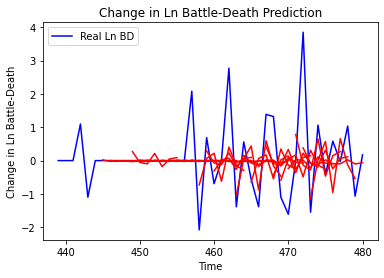

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mozambique', 'country_id': 162, 'step': 't+1', 'mse': 1.2175311573842438, 'mae': 0.6689810071224706, 'r2': 0.22625366661974966, 'tadda_score': 0.6879687544042603}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+2', 'mse': 2.393239886040949, 'mae': 1.011799244828219, 'r2': -0.2508305867450029, 'tadda_score': 1.1443404846796836}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+3', 'mse': 2.2513667234423864, 'mae': 1.0628766149626654, 'r2': -0.17636850561795492, 'tadda_score': 1.1515738935864448}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+4', 'mse': 2.2580701832873147, 'mae': 1.066072559435066, 'r2': -0.498359180007089, 'tadda_score': 1.295599708784517}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+5', 'mse': 1.1775085529694513, 'mae': 0.7425316895350736, 'r2': -0.4377465034618182, 'tadda_score': 0.8394843199903689}
{'country': 'Mozambique', 'country_id': 162, 'step': 't+6', 'm

16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [=====================

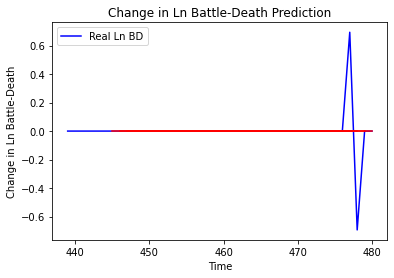

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Africa', 'country_id': 163, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'South Africa', 'country_id': 163, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Swaziland']
Building vanilla Model...
Model: "sequential_909"
_______________________________________________________

16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
16/16 [=====================

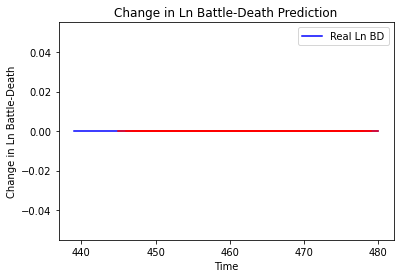

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Swaziland', 'country_id': 164, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Swaziland', 'country_id': 164, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Angola']
Building vanilla Model...
Model: "sequential_910"
_________________________________________________________________
Layer (type) 

Epoch 64/100
16/16 [==============================] - 0s 5ms/step - loss: 3.2942 - val_loss: 0.0861
Epoch 65/100
16/16 [==============================] - 0s 4ms/step - loss: 3.3018 - val_loss: 0.0855
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 3.2919 - val_loss: 0.0851
Epoch 67/100
16/16 [==============================] - 0s 5ms/step - loss: 3.2759 - val_loss: 0.0844
Epoch 68/100
16/16 [==============================] - 0s 5ms/step - loss: 3.3128 - val_loss: 0.0843
Epoch 69/100
16/16 [==============================] - 0s 5ms/step - loss: 3.3060 - val_loss: 0.0843
Epoch 70/100
16/16 [==============================] - 0s 5ms/step - loss: 3.2987 - val_loss: 0.0849
Epoch 71/100
16/16 [==============================] - 0s 4ms/step - loss: 3.2726 - val_loss: 0.0859
Epoch 72/100
16/16 [==============================] - 0s 5ms/step - loss: 3.3120 - val_loss: 0.0855
Epoch 73/100
16/16 [==============================] - 0s 4ms/step - loss: 3.2711 - val_loss: 0.0851


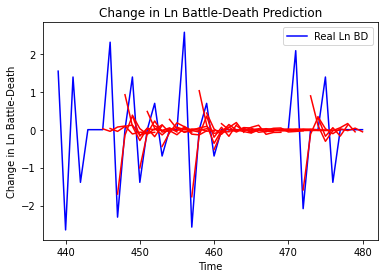

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Angola', 'country_id': 165, 'step': 't+1', 'mse': 0.7271112086617352, 'mae': 0.5286275394819222, 'r2': 0.4286010452616923, 'tadda_score': 0.5293162958633941}
{'country': 'Angola', 'country_id': 165, 'step': 't+2', 'mse': 2.299504300972683, 'mae': 1.0323357018579584, 'r2': -0.8070610634793542, 'tadda_score': 1.1712265076984505}
{'country': 'Angola', 'country_id': 165, 'step': 't+3', 'mse': 1.274378061515699, 'mae': 0.8008291364386487, 'r2': -0.45291139180924866, 'tadda_score': 0.83543087672937}
{'country': 'Angola', 'country_id': 165, 'step': 't+4', 'mse': 1.1358505445705729, 'mae': 0.7784420652604926, 'r2': -0.058204373600712955, 'tadda_score': 0.7919493836640645}
{'country': 'Angola', 'country_id': 165, 'step': 't+5', 'mse': 1.2433811488538509, 'mae': 0.7684368516043537, 'r2': -0.26992618648389954, 'tadda_score': 0.7916947599535895}
{'country': 'Angola', 'country_id': 165, 'step': 't+6', 'mse': 1.56233691778077

Epoch 60/100
16/16 [==============================] - 0s 4ms/step - loss: 1.8855 - val_loss: 0.2216
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 1.8922 - val_loss: 0.2213
Epoch 62/100
16/16 [==============================] - 0s 4ms/step - loss: 1.8811 - val_loss: 0.2214
Epoch 63/100
16/16 [==============================] - 0s 4ms/step - loss: 1.8788 - val_loss: 0.2218
Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 1.9015 - val_loss: 0.2216
Epoch 65/100
16/16 [==============================] - 0s 4ms/step - loss: 1.8941 - val_loss: 0.2214
Epoch 66/100
16/16 [==============================] - 0s 4ms/step - loss: 1.8860 - val_loss: 0.2212
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 1.8674 - val_loss: 0.2213
Epoch 68/100
16/16 [==============================] - 0s 4ms/step - loss: 1.8778 - val_loss: 0.2222
Epoch 69/100
16/16 [==============================] - 0s 4ms/step - loss: 1.8944 - val_loss: 0.2219


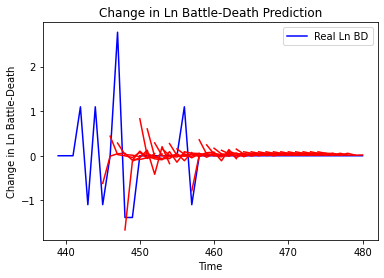

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo', 'country_id': 166, 'step': 't+1', 'mse': 0.369920522774679, 'mae': 0.35727610165655316, 'r2': 0.2656172583126851, 'tadda_score': 0.35727610165655316}
{'country': 'Congo', 'country_id': 166, 'step': 't+2', 'mse': 1.1796497484056325, 'mae': 0.6647670226658585, 'r2': -0.5522567896544446, 'tadda_score': 0.78059821301353}
{'country': 'Congo', 'country_id': 166, 'step': 't+3', 'mse': 1.1025006298123465, 'mae': 0.6184434850037513, 'r2': -0.8588792152126763, 'tadda_score': 0.7322475094616829}
{'country': 'Congo', 'country_id': 166, 'step': 't+4', 'mse': 1.008300732616504, 'mae': 0.6462947412352184, 'r2': -0.4515589395156572, 'tadda_score': 0.7488200777789373}
{'country': 'Congo', 'country_id': 166, 'step': 't+5', 'mse': 1.0481486818345342, 'mae': 0.6604765468856115, 'r2': -0.7672387175383373, 'tadda_score': 0.7500808734715402}
{'country': 'Congo', 'country_id': 166, 'step': 't+6', 'mse': 0.9795166551292407, 'mae

Epoch 60/100
16/16 [==============================] - 0s 4ms/step - loss: 2.9590 - val_loss: 3.2913
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 2.9425 - val_loss: 3.2936
Epoch 62/100
16/16 [==============================] - 0s 4ms/step - loss: 2.9491 - val_loss: 3.2967
Epoch 63/100
16/16 [==============================] - 0s 4ms/step - loss: 2.9500 - val_loss: 3.2946
Epoch 64/100
16/16 [==============================] - 0s 5ms/step - loss: 2.9733 - val_loss: 3.2957
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 2.9604 - val_loss: 3.2949
Epoch 66/100
16/16 [==============================] - 0s 4ms/step - loss: 2.9367 - val_loss: 3.2963
Epoch 67/100
16/16 [==============================] - 0s 5ms/step - loss: 2.9428 - val_loss: 3.2942
Epoch 68/100
16/16 [==============================] - 0s 4ms/step - loss: 2.9352 - val_loss: 3.2970
Epoch 69/100
16/16 [==============================] - 0s 4ms/step - loss: 2.9144 - val_loss: 3.2968


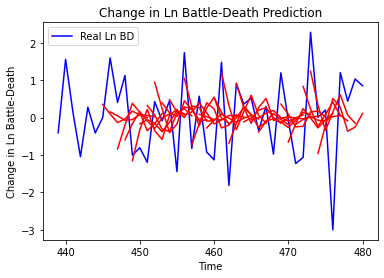

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+1', 'mse': 0.9059089267061871, 'mae': 0.7831012728963845, 'r2': 0.17229339283516432, 'tadda_score': 0.9472183431838506}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+2', 'mse': 2.780294003905843, 'mae': 1.3538889444069677, 'r2': -0.9663671427183103, 'tadda_score': 1.758827017739079}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+3', 'mse': 2.5835928753979127, 'mae': 1.2920344046124785, 'r2': -0.4977906598611319, 'tadda_score': 1.6364690429338782}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+4', 'mse': 3.077227626894053, 'mae': 1.4405229922526155, 'r2': -0.7663101245172554, 'tadda_score': 1.8548330740524406}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+5', 'mse': 3.7321247388661463, 'mae': 1.535466532881155, 'r2': -1.0330488583346429, 'tadda_score': 2.0255821515869044}
{'country': 'Congo, DRC', 'country_id': 167, 'step': 't+6', 'm

16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [=====================

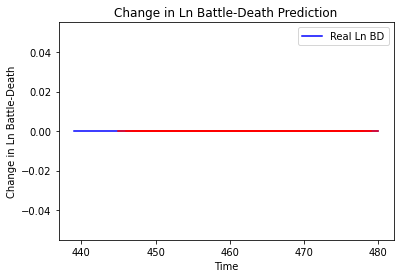

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Gabon', 'country_id': 169, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Gabon', 'country_id': 169, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Namibia']
Building vanilla Model...
Model: "sequential_914"
_________________________________________________________________
Layer (type)                 Output Shap

Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1417 - val_loss: 4.9171e-05
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1420 - val_loss: 1.5145e-05
Epoch 64/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1409 - val_loss: 2.2219e-05
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1404 - val_loss: 2.1651e-05
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1416 - val_loss: 3.5287e-05
Epoch 67/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1401 - val_loss: 9.3850e-05
Epoch 68/100
16/16 [==============================] - 0s 6ms/step - loss: 0.1392 - val_loss: 3.3649e-05
Epoch 69/100
16/16 [==============================] - 0s 6ms/step - loss: 0.1397 - val_loss: 8.8642e-05
Epoch 70/100
16/16 [==============================] - 0s 6ms/step - loss: 0.1398 - val_loss: 1.2497e-04
Epoch 71/100
16/16 [==============================] - 0s 6ms/ste

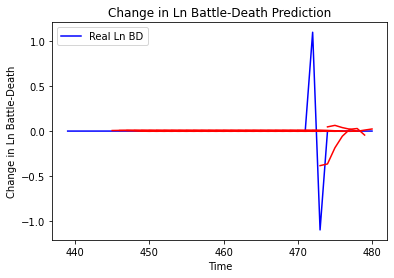

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Namibia', 'country_id': 170, 'step': 't+1', 'mse': 0.05689891718549912, 'mae': 0.0674601886547674, 'r2': 0.29285845094238594, 'tadda_score': 0.0674601886547674}
{'country': 'Namibia', 'country_id': 170, 'step': 't+2', 'mse': 0.10682445559985514, 'mae': 0.11393845855589403, 'r2': -0.3276177253750885, 'tadda_score': 0.11761336902177029}
{'country': 'Namibia', 'country_id': 170, 'step': 't+3', 'mse': 0.06900409232047569, 'mae': 0.09122869480101116, 'r2': -0.7743138963824097, 'tadda_score': 0.09122869480101116}
{'country': 'Namibia', 'country_id': 170, 'step': 't+4', 'mse': 0.07276966833166912, 'mae': 0.09698468529629554, 'r2': -0.8711387892237605, 'tadda_score': 0.09698468529629554}
{'country': 'Namibia', 'country_id': 170, 'step': 't+5', 'mse': 0.05194383803522605, 'mae': 0.07441326698609041, 'r2': -0.33564069257368634, 'tadda_score': 0.07441326698609041}
{'country': 'Namibia', 'country_id': 170, 'step': 't+6', 'm

16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [=====================

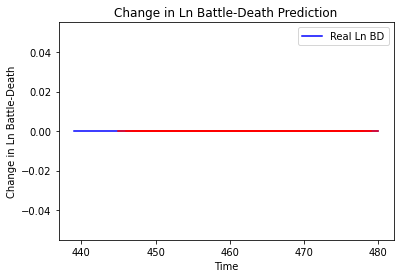

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Madagascar', 'country_id': 172, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Madagascar', 'country_id': 172, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Mauritius']
Building vanilla Model...
Model: "sequential_916"
_________________________________________________________________
Lay

16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
16/16 [==============================] - 0s 6ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
16/16 [=====================

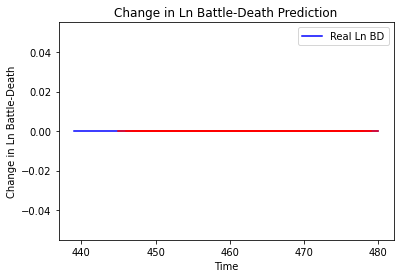

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritius', 'country_id': 173, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Mauritius', 'country_id': 173, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Seychelles']
Building vanilla Model...
Model: "sequential_917"
_________________________________________________________________
Layer (ty

16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 68/100
16/16 [=====================

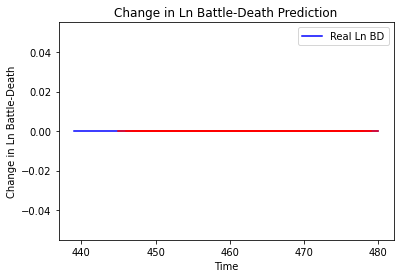

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Seychelles', 'country_id': 174, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Seychelles', 'country_id': 174, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Libya']
Building vanilla Model...
Model: "sequential_918"
_________________________________________________________________
Layer (

Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3020
Epoch 65/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3020
Epoch 66/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0315 - val_loss: 2.3022
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3022
Epoch 68/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0315 - val_loss: 2.3021
Epoch 69/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3022
Epoch 70/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.3024
Epoch 71/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 2.3025
Epoch 72/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.3026
Epoch 73/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0314 - val_loss: 2.3027


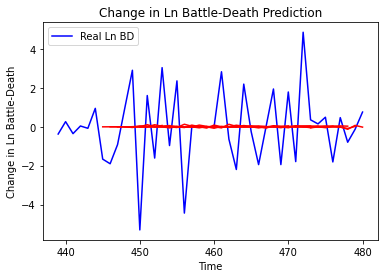

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Libya', 'country_id': 213, 'step': 't+1', 'mse': 4.823943266241596, 'mae': 1.6871076734193209, 'r2': 0.004476713437182478, 'tadda_score': 1.6894423053289374}
{'country': 'Libya', 'country_id': 213, 'step': 't+2', 'mse': 5.442956665082373, 'mae': 1.787499479432697, 'r2': -0.004749233818601484, 'tadda_score': 1.7928384571484737}
{'country': 'Libya', 'country_id': 213, 'step': 't+3', 'mse': 7.433690456845861, 'mae': 2.1112152522106404, 'r2': -0.0015022007135072624, 'tadda_score': 2.1167640690717593}
{'country': 'Libya', 'country_id': 213, 'step': 't+4', 'mse': 5.847927073368795, 'mae': 1.9793435923453697, 'r2': -0.010556894176719567, 'tadda_score': 1.9857338369638937}
{'country': 'Libya', 'country_id': 213, 'step': 't+5', 'mse': 7.439877133128907, 'mae': 2.2876328204861736, 'r2': -0.022497725128352464, 'tadda_score': 2.3131580024595264}
{'country': 'Libya', 'country_id': 213, 'step': 't+6', 'mse': 6.376317666298108

Epoch 60/100
16/16 [==============================] - 0s 5ms/step - loss: 4.9840 - val_loss: 0.8491
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 4.9625 - val_loss: 0.8489
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 4.9886 - val_loss: 0.8490
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 4.9407 - val_loss: 0.8513
Epoch 64/100
16/16 [==============================] - 0s 5ms/step - loss: 4.9669 - val_loss: 0.8509
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 4.9222 - val_loss: 0.8530
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 4.9844 - val_loss: 0.8529
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 4.9628 - val_loss: 0.8525
Epoch 68/100
16/16 [==============================] - 0s 5ms/step - loss: 4.9073 - val_loss: 0.8513
Epoch 69/100
16/16 [==============================] - 0s 4ms/step - loss: 4.9766 - val_loss: 0.8507


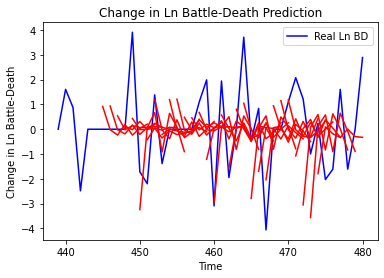

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Chad', 'country_id': 214, 'step': 't+1', 'mse': 3.3829708343830944, 'mae': 1.467563809502454, 'r2': -0.1524596713955555, 'tadda_score': 1.7617609635475588}
{'country': 'Chad', 'country_id': 214, 'step': 't+2', 'mse': 8.28578841642365, 'mae': 2.2453068137829253, 'r2': -0.9520081981950876, 'tadda_score': 2.9424744368259854}
{'country': 'Chad', 'country_id': 214, 'step': 't+3', 'mse': 9.333613244236691, 'mae': 2.3965887291749355, 'r2': -0.78713007633798, 'tadda_score': 2.9978325251261433}
{'country': 'Chad', 'country_id': 214, 'step': 't+4', 'mse': 13.61935669733602, 'mae': 3.093757263597665, 'r2': -1.2334386226539595, 'tadda_score': 3.980461515761234}
{'country': 'Chad', 'country_id': 214, 'step': 't+5', 'mse': 11.403652149080193, 'mae': 2.7143178491444346, 'r2': -1.4003340759601062, 'tadda_score': 3.46430927104264}
{'country': 'Chad', 'country_id': 214, 'step': 't+6', 'mse': 9.391237025759466, 'mae': 2.3989102453

16/16 [==============================] - 0s 4ms/step - loss: 0.5792 - val_loss: 2.1388
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5837 - val_loss: 2.1394
Epoch 62/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5652 - val_loss: 2.1372
Epoch 63/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5770 - val_loss: 2.1361
Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5705 - val_loss: 2.1368
Epoch 65/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5694 - val_loss: 2.1343
Epoch 66/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5770 - val_loss: 2.1324
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5705 - val_loss: 2.1323
Epoch 68/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5622 - val_loss: 2.1286
Epoch 69/100
16/16 [==============================] - 0s 4ms/step - loss: 0.5715 - val_loss: 2.1281
Epoch 70/100


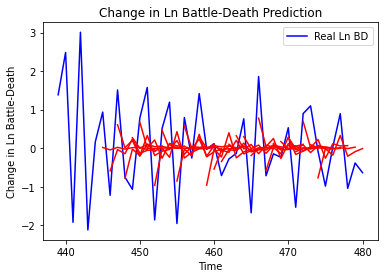

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Egypt', 'country_id': 222, 'step': 't+1', 'mse': 0.6766917080156641, 'mae': 0.6805390564680104, 'r2': 0.3995875318309309, 'tadda_score': 0.7318288310696686}
{'country': 'Egypt', 'country_id': 222, 'step': 't+2', 'mse': 1.5899836072117322, 'mae': 1.0713484143134164, 'r2': -0.4702255885785087, 'tadda_score': 1.3096850349174152}
{'country': 'Egypt', 'country_id': 222, 'step': 't+3', 'mse': 1.4659816147607374, 'mae': 0.982126146039542, 'r2': -0.5807028318430785, 'tadda_score': 1.2205885420366391}
{'country': 'Egypt', 'country_id': 222, 'step': 't+4', 'mse': 1.3096413387010648, 'mae': 0.9589768250297823, 'r2': -0.06321357928876625, 'tadda_score': 1.1336571194987815}
{'country': 'Egypt', 'country_id': 222, 'step': 't+5', 'mse': 1.6579704651700582, 'mae': 1.101304541397927, 'r2': -0.39752928760793926, 'tadda_score': 1.3877354546078424}
{'country': 'Egypt', 'country_id': 222, 'step': 't+6', 'mse': 1.4202914441645864, 'm

16/16 [==============================] - 0s 4ms/step - loss: 2.6525 - val_loss: 4.1969e-04
Epoch 59/100
16/16 [==============================] - 0s 4ms/step - loss: 2.6458 - val_loss: 4.5391e-04
Epoch 60/100
16/16 [==============================] - 0s 4ms/step - loss: 2.6494 - val_loss: 3.5420e-04
Epoch 61/100
16/16 [==============================] - 0s 4ms/step - loss: 2.6552 - val_loss: 4.3351e-04
Epoch 62/100
16/16 [==============================] - 0s 4ms/step - loss: 2.6645 - val_loss: 4.7596e-04
Epoch 63/100
16/16 [==============================] - 0s 4ms/step - loss: 2.6488 - val_loss: 4.8520e-04
Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 2.6505 - val_loss: 6.6999e-04
Epoch 65/100
16/16 [==============================] - 0s 4ms/step - loss: 2.6438 - val_loss: 8.8747e-04
Epoch 66/100
16/16 [==============================] - 0s 4ms/step - loss: 2.6789 - val_loss: 8.1018e-04
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 2.6

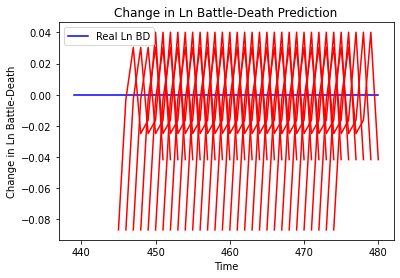

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Uganda', 'country_id': 235, 'step': 't+1', 'mse': 0.007547501077476648, 'mae': 0.08687635511159897, 'r2': 0.0, 'tadda_score': 0.08687635511159897}
{'country': 'Uganda', 'country_id': 235, 'step': 't+2', 'mse': 0.008057245133026802, 'mae': 0.08976215869188309, 'r2': 0.0, 'tadda_score': 0.08976215869188309}
{'country': 'Uganda', 'country_id': 235, 'step': 't+3', 'mse': 0.0035244399298255957, 'mae': 0.059366993606090546, 'r2': 0.0, 'tadda_score': 0.059366993606090546}
{'country': 'Uganda', 'country_id': 235, 'step': 't+4', 'mse': 0.007109206759841558, 'mae': 0.08431611210107803, 'r2': 0.0, 'tadda_score': 0.08431611210107803}
{'country': 'Uganda', 'country_id': 235, 'step': 't+5', 'mse': 0.009562084674486437, 'mae': 0.09778591245412827, 'r2': 0.0, 'tadda_score': 0.09778591245412827}
{'country': 'Uganda', 'country_id': 235, 'step': 't+6', 'mse': 0.0033258767025792224, 'mae': 0.057670414447784424, 'r2': 0.0, 'tadda_sc

16/16 [==============================] - 0s 4ms/step - loss: 0.1156 - val_loss: 1.6509
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 0.1142 - val_loss: 1.6484
Epoch 62/100
16/16 [==============================] - 0s 4ms/step - loss: 0.1174 - val_loss: 1.6486
Epoch 63/100
16/16 [==============================] - 0s 4ms/step - loss: 0.1145 - val_loss: 1.6491
Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 0.1142 - val_loss: 1.6480
Epoch 65/100
16/16 [==============================] - 0s 4ms/step - loss: 0.1156 - val_loss: 1.6477
Epoch 66/100
16/16 [==============================] - 0s 4ms/step - loss: 0.1179 - val_loss: 1.6494
Epoch 67/100
16/16 [==============================] - 0s 4ms/step - loss: 0.1163 - val_loss: 1.6483
Epoch 68/100
16/16 [==============================] - 0s 4ms/step - loss: 0.1165 - val_loss: 1.6475
Epoch 69/100
16/16 [==============================] - 0s 4ms/step - loss: 0.1141 - val_loss: 1.6490
Epoch 70/100


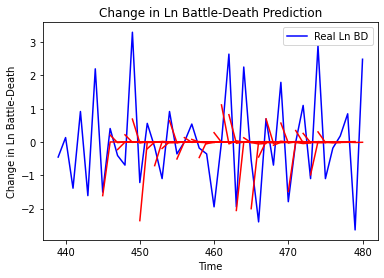

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Kenya', 'country_id': 237, 'step': 't+1', 'mse': 1.354630111952127, 'mae': 0.8593522421635513, 'r2': 0.346261487163812, 'tadda_score': 0.8826670042790299}
{'country': 'Kenya', 'country_id': 237, 'step': 't+2', 'mse': 3.3654118442138357, 'mae': 1.4919595153080896, 'r2': -0.7630105748733025, 'tadda_score': 1.9289699311998958}
{'country': 'Kenya', 'country_id': 237, 'step': 't+3', 'mse': 3.090575716987642, 'mae': 1.3604217564460535, 'r2': -0.4153697863493435, 'tadda_score': 1.63376949632137}
{'country': 'Kenya', 'country_id': 237, 'step': 't+4', 'mse': 3.8617345497598587, 'mae': 1.6201322941254832, 'r2': -0.375110075097689, 'tadda_score': 1.8939302556982893}
{'country': 'Kenya', 'country_id': 237, 'step': 't+5', 'mse': 2.6723723610413646, 'mae': 1.2047220661770024, 'r2': -0.7643759006225943, 'tadda_score': 1.516729410691134}
{'country': 'Kenya', 'country_id': 237, 'step': 't+6', 'mse': 2.558499157801284, 'mae': 1.2

12/12 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 56/100
12/12 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 57/100
12/12 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 58/100
12/12 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 59/100
12/12 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 60/100
12/12 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 61/100
12/12 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 62/100
12/12 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 63/100
12/12 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 64/100
12/12 [=====================

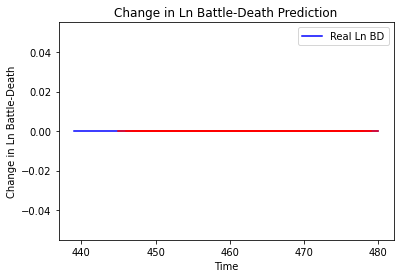

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Tanzania', 'country_id': 242, 'step': 't+1', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+2', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+3', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+4', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+5', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+6', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
{'country': 'Tanzania', 'country_id': 242, 'step': 't+7', 'mse': 0.0, 'mae': 0.0, 'r2': 1.0, 'tadda_score': 0.0}
['Morocco']
Building vanilla Model...
Model: "sequential_924"
_________________________________________________________________
Layer (type)       

16/16 [==============================] - 0s 5ms/step - loss: 0.0691 - val_loss: 2.5569e-05
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0691 - val_loss: 7.2705e-06
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0699 - val_loss: 4.7819e-06
Epoch 64/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0705 - val_loss: 1.5961e-05
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0694 - val_loss: 1.0493e-05
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0698 - val_loss: 3.1083e-06
Epoch 67/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0696 - val_loss: 7.7937e-06
Epoch 68/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0706 - val_loss: 1.8653e-05
Epoch 69/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0713 - val_loss: 2.1399e-06
Epoch 70/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0

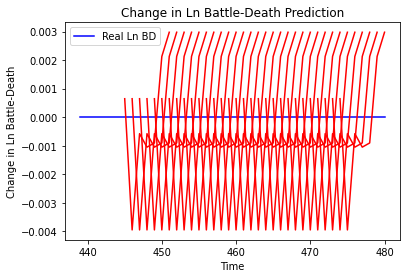

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Morocco', 'country_id': 243, 'step': 't+1', 'mse': 4.178314970840289e-07, 'mae': 0.0006463988684117794, 'r2': 0.0, 'tadda_score': 0.0006463988684117794}
{'country': 'Morocco', 'country_id': 243, 'step': 't+2', 'mse': 1.0936641922976165e-05, 'mae': 0.003307059407234192, 'r2': 0.0, 'tadda_score': 0.003307059407234192}
{'country': 'Morocco', 'country_id': 243, 'step': 't+3', 'mse': 1.5109985579587907e-05, 'mae': 0.0038871564902365208, 'r2': 0.0, 'tadda_score': 0.0038871564902365208}
{'country': 'Morocco', 'country_id': 243, 'step': 't+4', 'mse': 2.43923698844406e-05, 'mae': 0.004938863217830658, 'r2': 0.0, 'tadda_score': 0.004938863217830658}
{'country': 'Morocco', 'country_id': 243, 'step': 't+5', 'mse': 3.5715519921473814e-06, 'mae': 0.0018898550188168883, 'r2': 0.0, 'tadda_score': 0.0018898550188168883}
{'country': 'Morocco', 'country_id': 243, 'step': 't+6', 'mse': 5.662452747913027e-08, 'mae': 0.00023795908782

16/16 [==============================] - 0s 5ms/step - loss: 0.0633 - val_loss: 0.1143
Epoch 61/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0638 - val_loss: 0.1141
Epoch 62/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0633 - val_loss: 0.1141
Epoch 63/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0646 - val_loss: 0.1141
Epoch 64/100
16/16 [==============================] - 0s 4ms/step - loss: 0.0645 - val_loss: 0.1139
Epoch 65/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0643 - val_loss: 0.1139
Epoch 66/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0664 - val_loss: 0.1139
Epoch 67/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0634 - val_loss: 0.1138
Epoch 68/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0643 - val_loss: 0.1137
Epoch 69/100
16/16 [==============================] - 0s 5ms/step - loss: 0.0627 - val_loss: 0.1136
Epoch 70/100


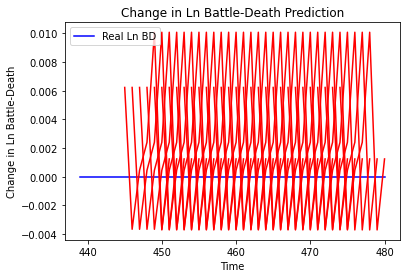

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Mauritania', 'country_id': 244, 'step': 't+1', 'mse': 3.882971568452639e-05, 'mae': 0.006231349427253008, 'r2': 0.0, 'tadda_score': 0.006231349427253008}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+2', 'mse': 6.556339384561913e-06, 'mae': 0.002560534980148077, 'r2': 0.0, 'tadda_score': 0.002560534980148077}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+3', 'mse': 9.058711642857267e-06, 'mae': 0.003009769367054105, 'r2': 0.0, 'tadda_score': 0.003009769367054105}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+4', 'mse': 2.9275252344190296e-05, 'mae': 0.005410660989582539, 'r2': 0.0, 'tadda_score': 0.005410660989582539}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+5', 'mse': 0.0003673845444713969, 'mae': 0.019167277961969376, 'r2': 0.0, 'tadda_score': 0.019167277961969376}
{'country': 'Mauritania', 'country_id': 244, 'step': 't+6', 'mse': 0.00023875708953241537, 'mae': 0.01

3/3 [==============================] - 0s 9ms/step - loss: 3.1726 - val_loss: 0.9241
Epoch 62/100
3/3 [==============================] - 0s 8ms/step - loss: 3.1753 - val_loss: 0.9241
Epoch 63/100
3/3 [==============================] - 0s 8ms/step - loss: 3.1769 - val_loss: 0.9240
Epoch 64/100
3/3 [==============================] - 0s 10ms/step - loss: 3.2019 - val_loss: 0.9238
Epoch 65/100
3/3 [==============================] - 0s 9ms/step - loss: 3.1677 - val_loss: 0.9237
Epoch 66/100
3/3 [==============================] - 0s 9ms/step - loss: 3.1828 - val_loss: 0.9235
Epoch 67/100
3/3 [==============================] - 0s 9ms/step - loss: 3.1991 - val_loss: 0.9233
Epoch 68/100
3/3 [==============================] - 0s 12ms/step - loss: 3.1664 - val_loss: 0.9231
Epoch 69/100
3/3 [==============================] - 0s 9ms/step - loss: 3.2065 - val_loss: 0.9230
Epoch 70/100
3/3 [==============================] - 0s 8ms/step - loss: 3.1844 - val_loss: 0.9230
Epoch 71/100
3/3 [=============

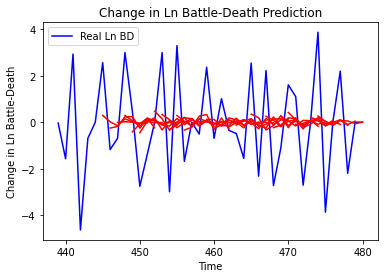

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'Sudan', 'country_id': 245, 'step': 't+1', 'mse': 3.3425036998773097, 'mae': 1.5559118131641079, 'r2': 0.16465482928915098, 'tadda_score': 1.5907811902307996}
{'country': 'Sudan', 'country_id': 245, 'step': 't+2', 'mse': 4.494837510418051, 'mae': 1.729225111539556, 'r2': -0.05345649400918795, 'tadda_score': 1.8805045009010966}
{'country': 'Sudan', 'country_id': 245, 'step': 't+3', 'mse': 3.98727970691605, 'mae': 1.68587851175596, 'r2': -0.02816507444964489, 'tadda_score': 1.7537003040207397}
{'country': 'Sudan', 'country_id': 245, 'step': 't+4', 'mse': 3.4549287169316005, 'mae': 1.4716917815632748, 'r2': -0.04061271629655394, 'tadda_score': 1.5430571993517008}
{'country': 'Sudan', 'country_id': 245, 'step': 't+5', 'mse': 5.224073129148672, 'mae': 1.9361599349678087, 'r2': 0.0035718944585845236, 'tadda_score': 2.0189853200018932}
{'country': 'Sudan', 'country_id': 245, 'step': 't+6', 'mse': 4.92029426328313, 'mae'

3/3 [==============================] - 0s 8ms/step - loss: 6.4038 - val_loss: 4.1216
Epoch 62/100
3/3 [==============================] - 0s 8ms/step - loss: 6.3983 - val_loss: 4.1188
Epoch 63/100
3/3 [==============================] - 0s 9ms/step - loss: 6.4137 - val_loss: 4.1162
Epoch 64/100
3/3 [==============================] - 0s 9ms/step - loss: 6.4326 - val_loss: 4.1140
Epoch 65/100
3/3 [==============================] - 0s 8ms/step - loss: 6.3659 - val_loss: 4.1118
Epoch 66/100
3/3 [==============================] - 0s 8ms/step - loss: 6.4264 - val_loss: 4.1097
Epoch 67/100
3/3 [==============================] - 0s 8ms/step - loss: 6.3342 - val_loss: 4.1077
Epoch 68/100
3/3 [==============================] - 0s 8ms/step - loss: 6.3989 - val_loss: 4.1061
Epoch 69/100
3/3 [==============================] - 0s 8ms/step - loss: 6.3109 - val_loss: 4.1046
Epoch 70/100
3/3 [==============================] - 0s 8ms/step - loss: 6.4463 - val_loss: 4.1032
Epoch 71/100
3/3 [===============

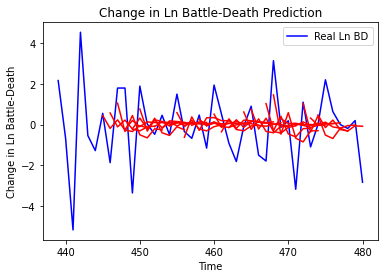

Storing forecasts...
Evaluating delta multi-step forecasts...
{'country': 'South Sudan', 'country_id': 246, 'step': 't+1', 'mse': 1.9545447541944456, 'mae': 1.0745631855147166, 'r2': 0.12139569389651039, 'tadda_score': 1.2140517996169211}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+2', 'mse': 3.2194862810862985, 'mae': 1.4006750301815962, 'r2': -0.19134846797971372, 'tadda_score': 1.5872638852693532}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+3', 'mse': 3.7403294777399196, 'mae': 1.6100558086102386, 'r2': -0.4305684818113118, 'tadda_score': 1.90462680994125}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+4', 'mse': 3.837383230358253, 'mae': 1.6178622910010294, 'r2': -0.2173640591261543, 'tadda_score': 1.7949251777060307}
{'country': 'South Sudan', 'country_id': 246, 'step': 't+5', 'mse': 2.910599239036862, 'mae': 1.2843225927961435, 'r2': -0.15390872684438683, 'tadda_score': 1.3592998583428626}
{'country': 'South Sudan', 'country_id': 246, 'step': '

In [45]:
np.random.seed(1)
tf.random.set_seed(1)
model = Sequential()
summary_model(dataset=df,
              modelname = "Vanilla",
              pred_africa=True,
              period=period_test, 
              epochs=100, 
              batch_size=16, 
              look_back=6, 
              look_forward=7,
              num_neurons=6, 
              val_split=0.2)

In [ ]:
np.random.seed(1)
tf.random.set_seed(1)
model = Sequential()
summary_model(dataset=df,
              modelname = "Vanilla",
              pred_africa=True,
              period=period_test, 
              epochs=10, 
              batch_size=128, 
              look_back=6, 
              look_forward=7,
              num_neurons=6, 
              val_split=0.2)